# **Animal Classification With Customize Dataset**

In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/animal-classification-dataset/Animal Classification/validation/kangaru/kangaru_010.jpg
/kaggle/input/animal-classification-dataset/Animal Classification/validation/kangaru/kangaru_005.jpg
/kaggle/input/animal-classification-dataset/Animal Classification/validation/kangaru/kangaru_033.jpg
/kaggle/input/animal-classification-dataset/Animal Classification/validation/kangaru/kangaru_067.jpg
/kaggle/input/animal-classification-dataset/Animal Classification/validation/kangaru/kangaru_097.jpg
/kaggle/input/animal-classification-dataset/Animal Classification/validation/kangaru/kangaru_058.jpg
/kaggle/input/animal-classification-dataset/Animal Classification/validation/kangaru/kangaru_095.jpg
/kaggle/input/animal-classification-dataset/Animal Classification/validation/kangaru/kangaru_028.jpg
/kaggle/input/animal-classification-dataset/Animal Classification/validation/kangaru/kangaru_078.jpg
/kaggle/input/animal-classification-dataset/Animal Classification/validation/kangaru/kangar

###  **Count All The Folders And Their Images**    

In [2]:
import os
from collections import defaultdict

base_path = '/kaggle/input/animal-classification-dataset/Animal Classification'  
train_path = os.path.join(base_path, 'train')
test_path = os.path.join(base_path, 'test')
val_path = os.path.join(base_path, 'validation')

def count_images_in_folders(root_dir):
    counts = defaultdict(int)
    for animal_folder in os.listdir(root_dir):
        folder_path = os.path.join(root_dir, animal_folder)
        if os.path.isdir(folder_path):
            num_images = len([f for f in os.listdir(folder_path) 
                            if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
            counts[animal_folder] = num_images
    return counts

# Count images in each set
train_counts = count_images_in_folders(train_path)
test_counts = count_images_in_folders(test_path)
val_counts = count_images_in_folders(val_path)

# Print results
print("Training set counts:")
for animal, count in train_counts.items():
    print(f"{animal}: {count} images")
    
print("\nTest set counts:")
for animal, count in test_counts.items():
    print(f"{animal}: {count} images")
    
print("\nValidation set counts:")
for animal, count in val_counts.items():
    print(f"{animal}: {count} images")

# Calculate totals
total_train = sum(train_counts.values())
total_test = sum(test_counts.values())
total_val = sum(val_counts.values())

print("\nSummary:")
print(f"Total training images: {total_train}")
print(f"Total test images: {total_test}")
print(f"Total validation images: {total_val}")
print(f"Overall total: {total_train + total_test + total_val}")

Training set counts:
kangaru: 69 images
horse: 69 images
lion: 69 images
dog: 64 images
hippopotamus: 69 images
bear: 69 images
camel bird: 69 images
gayal: 69 images
Lama: 67 images
ass: 69 images
tiger: 69 images
porcupine: 68 images
Hargila Bok: 69 images
elephant: 69 images
sheep: 69 images
zebra: 69 images
cow: 67 images
panda: 69 images
goat: 69 images
Rabbit: 69 images
giraffe: 69 images
monkey: 69 images
kalo bok: 69 images
rhinoceros: 69 images
camel: 69 images
squirrel: 69 images
crocodile: 67 images
cat: 67 images
deer: 69 images
peacock: 69 images

Test set counts:
kangaru: 16 images
horse: 16 images
lion: 16 images
dog: 14 images
hippopotamus: 16 images
bear: 16 images
camel bird: 16 images
gayal: 16 images
Lama: 15 images
ass: 16 images
tiger: 16 images
porcupine: 15 images
Hargila Bok: 16 images
elephant: 15 images
sheep: 16 images
zebra: 16 images
cow: 15 images
panda: 16 images
goat: 15 images
Rabbit: 16 images
giraffe: 16 images
monkey: 16 images
kalo bok: 15 images
r

#   **Data Pre-Proccessing**

## **Convert All Images Into ".jpg" Formet** 

In [3]:
import os
from PIL import Image
from tqdm import tqdm

def convert_to_jpg(input_path, output_path):
    # Create output directory structure
    os.makedirs(output_path, exist_ok=True)
    
    # Supported image extensions
    img_extensions = ('.png', '.jpg', '.jpeg', '.bmp', '.tiff', '.webp')
    
    # Counters
    converted = 0
    skipped = 0
    
    # Walk through directory
    for root, dirs, files in os.walk(input_path):
        # Create corresponding directories in output path
        rel_path = os.path.relpath(root, input_path)
        current_out_path = os.path.join(output_path, rel_path)
        os.makedirs(current_out_path, exist_ok=True)
        
        for file in tqdm(files, desc=f"Processing {rel_path}"):
            # Check if file is an image
            if file.lower().endswith(img_extensions):
                input_file = os.path.join(root, file)
                filename, ext = os.path.splitext(file)
                output_file = os.path.join(current_out_path, f"{filename}.jpg")
                
                # Skip if already JPG and not converting existing JPGs
                if ext.lower() == '.jpg' or ext.lower() == '.jpeg':
                    skipped += 1
                    continue
                
                try:
                    # Open and convert image
                    with Image.open(input_file) as img:
                        # Convert to RGB if needed (JPG doesn't support alpha channel)
                        if img.mode in ('RGBA', 'LA', 'P'):
                            img = img.convert('RGB')
                        img.save(output_file, 'JPEG', quality=95)
                    converted += 1
                except Exception as e:
                    print(f"Error converting {input_file}: {str(e)}")
    
    print(f"\nConversion complete! Converted: {converted}, Skipped: {skipped}")

# Define paths
input_base_path = '/kaggle/input/your-dataset-name/'  # Change to your input path
output_base_path = '/kaggle/working/converted_dataset/'  # Output will be saved here

# Convert each set
for dataset in ['train', 'test', 'validation']:
    print(f"\nConverting {dataset} set...")
    convert_to_jpg(
        os.path.join(input_base_path, dataset),
        os.path.join(output_base_path, dataset)
    )


Converting train set...

Conversion complete! Converted: 0, Skipped: 0

Converting test set...

Conversion complete! Converted: 0, Skipped: 0

Converting validation set...

Conversion complete! Converted: 0, Skipped: 0


## **Resize All Images Into 512x512**

In [4]:
from PIL import Image
import os
from tqdm import tqdm

def resize_images_kaggle(dataset_path, target_size=(512, 512)):

    # Supported image formats
    img_extensions = ('.jpg')
    
    # Counters
    resized_count = 0
    correct_size_count = 0
    error_count = 0
    
    # Walk through all directories
    for root, _, files in tqdm(os.walk(dataset_path), desc="Processing folders"):
        for file in tqdm(files, desc=f"Resizing images in {os.path.basename(root)}", leave=False):
            if file.lower().endswith(img_extensions):
                file_path = os.path.join(root, file)
                
                try:
                    with Image.open(file_path) as img:
                        if img.size != target_size:
                            # Preserve transparency if needed
                            if img.mode in ('RGBA', 'LA', 'P'):
                                img = img.convert('RGBA')
                            else:
                                img = img.convert('RGB')
                            
                            img = img.resize(target_size, Image.LANCZOS)
                            img.save(file_path)
                            resized_count += 1
                        else:
                            correct_size_count += 1
                except Exception as e:
                    print(f"\nError processing {file_path}: {str(e)}")
                    error_count += 1
    
    # Print summary
    print("\nResizing complete!")
    print(f"Resized images: {resized_count}")
    print(f"Already correct size: {correct_size_count}")
    print(f"Errors encountered: {error_count}")

# Example usage in Kaggle:
resize_images_kaggle(base_path)

Processing folders: 0it [00:00, ?it/s]
Resizing images in Animal Classification: 0it [00:00, ?it/s]
                                                            
Resizing images in validation: 0it [00:00, ?it/s]
                                                 
Resizing images in kangaru:   7%|▋         | 1/15 [00:00<00:01,  8.22it/s]
Processing folders: 3it [00:00, 15.14it/s]                                
Resizing images in horse:   0%|          | 0/15 [00:00<?, ?it/s]
                                                                
Resizing images in lion:   0%|          | 0/15 [00:00<?, ?it/s]
Processing folders: 5it [00:00, 15.93it/s]                     
Resizing images in dog:   0%|          | 0/14 [00:00<?, ?it/s]
                                                              
Resizing images in hippopotamus:   0%|          | 0/15 [00:00<?, ?it/s]
Processing folders: 7it [00:00, 16.16it/s]                             
Resizing images in bear:   0%|          | 0/15 [00:00<?, ?it/


Resizing complete!
Resized images: 0
Already correct size: 2972
Errors encountered: 0


## **Checking For Duplicate Values**

In [5]:
import os
import hashlib
from collections import defaultdict
from tqdm import tqdm
from PIL import Image
import numpy as np

def calculate_image_hash(filepath):
    """Calculate perceptual hash of an image using average hashing"""
    try:
        with Image.open(filepath) as img:
            # Convert to grayscale and resize to 8x8 for hash calculation
            img = img.convert("L").resize((8, 8), Image.LANCZOS)
            pixels = np.array(img)
            avg = pixels.mean()
            bits = (pixels > avg).flatten()
            return hash(bits.tobytes())
    except Exception as e:
        print(f"Error processing {filepath}: {str(e)}")
        return None

def find_duplicates(directory):
    """Find duplicate images within a directory"""
    hashes = defaultdict(list)
    duplicates = defaultdict(list)
    
    for root, _, files in os.walk(directory):
        for filename in tqdm(files, desc=f"Processing {os.path.basename(root)}"):
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                filepath = os.path.join(root, filename)
                img_hash = calculate_image_hash(filepath)
                if img_hash is not None:
                    hashes[img_hash].append(filepath)
    
    for hash_val, files in hashes.items():
        if len(files) > 1:
            duplicates[hash_val] = files
    
    return duplicates

def check_dataset_duplicates(dataset_path):
    """Check for duplicates in train/test/validation directories"""
    results = {}
    
    for subset in ['train', 'test', 'validation']:
        subset_path = os.path.join(dataset_path, subset)
        if os.path.exists(subset_path):
            print(f"\nChecking duplicates in {subset} set...")
            subset_duplicates = {}
            
            # Check each animal class folder
            for animal_class in tqdm(os.listdir(subset_path), desc="Processing classes"):
                class_path = os.path.join(subset_path, animal_class)
                if os.path.isdir(class_path):
                    duplicates = find_duplicates(class_path)
                    if duplicates:
                        subset_duplicates[animal_class] = duplicates
            
            results[subset] = subset_duplicates
    
    return results

def print_duplicate_report(duplicate_results):
    """Print a summary of duplicate findings"""
    total_duplicates = 0
    
    for subset, subset_results in duplicate_results.items():
        print(f"\n{subset.upper()} SET DUPLICATE REPORT")
        print("=" * 40)
        
        subset_duplicate_count = 0
        subset_class_count = 0
        
        for animal_class, duplicates in subset_results.items():
            if duplicates:
                subset_class_count += 1
                class_duplicate_count = sum(len(files) for files in duplicates.values())
                subset_duplicate_count += class_duplicate_count
                print(f"\n{animal_class}:")
                for hash_val, files in duplicates.items():
                    print(f"  - Duplicate group ({len(files)} images):")
                    for file in files:
                        print(f"    {os.path.basename(file)}")
        
        total_duplicates += subset_duplicate_count
        print(f"\n{subset} summary:")
        print(f"Classes with duplicates: {subset_class_count}")
        print(f"Total duplicate images: {subset_duplicate_count}")
    
    print("\nOVERALL SUMMARY:")
    print(f"Total duplicate images found: {total_duplicates}")

# Usage in Kaggle:
duplicate_results = check_dataset_duplicates(base_path)
print_duplicate_report(duplicate_results)


Checking duplicates in train set...


Processing classes: 100%|██████████| 30/30 [00:11<00:00,  2.55it/s]



Checking duplicates in test set...


Processing kangaru: 100%|██████████| 16/16 [00:00<00:00, 214.26it/s]

Processing lion: 100%|██████████| 16/16 [00:00<00:00, 190.04it/s]

Processing hippopotamus: 100%|██████████| 16/16 [00:00<00:00, 196.73it/s]

Processing camel bird: 100%|██████████| 16/16 [00:00<00:00, 211.15it/s]

Processing Lama: 100%|██████████| 15/15 [00:00<00:00, 208.34it/s]

Processing tiger: 100%|██████████| 16/16 [00:00<00:00, 204.56it/s]

Processing Hargila Bok: 100%|██████████| 16/16 [00:00<00:00, 166.22it/s]

Processing sheep: 100%|██████████| 16/16 [00:00<00:00, 186.22it/s]

Processing cow: 100%|██████████| 15/15 [00:00<00:00, 167.75it/s]

Processing goat: 100%|██████████| 15/15 [00:00<00:00, 186.69it/s]

Processing giraffe: 100%|██████████| 16/16 [00:00<00:00, 204.51it/s]

Processing kalo bok: 100%|██████████| 15/15 [00:00<00:00, 205.96it/s]

Processing camel: 100%|██████████| 16/16 [00:00<00:00, 200.35it/s]

Processing crocodile: 100%|██████████| 15/15 [00:00<00:00, 172.54it/s]

Processing deer: 100%|██


Checking duplicates in validation set...


Processing kangaru: 100%|██████████| 15/15 [00:00<00:00, 208.81it/s]

Processing lion: 100%|██████████| 15/15 [00:00<00:00, 176.89it/s]

Processing hippopotamus: 100%|██████████| 15/15 [00:00<00:00, 201.02it/s]

Processing camel bird: 100%|██████████| 15/15 [00:00<00:00, 219.07it/s]

Processing Lama: 100%|██████████| 15/15 [00:00<00:00, 206.60it/s]

Processing tiger: 100%|██████████| 15/15 [00:00<00:00, 210.92it/s]

Processing Hargila Bok: 100%|██████████| 15/15 [00:00<00:00, 216.06it/s]

Processing sheep: 100%|██████████| 15/15 [00:00<00:00, 208.02it/s]

Processing cow: 100%|██████████| 15/15 [00:00<00:00, 190.32it/s]

Processing goat: 100%|██████████| 15/15 [00:00<00:00, 189.54it/s]

Processing giraffe: 100%|██████████| 15/15 [00:00<00:00, 210.44it/s]

Processing kalo bok: 100%|██████████| 15/15 [00:00<00:00, 213.46it/s]

Processing camel: 100%|██████████| 15/15 [00:00<00:00, 211.64it/s]

Processing crocodile: 100%|██████████| 14/14 [00:00<00:00, 185.36it/s]

Processing deer: 100%|██


TRAIN SET DUPLICATE REPORT

train summary:
Classes with duplicates: 0
Total duplicate images: 0

TEST SET DUPLICATE REPORT

test summary:
Classes with duplicates: 0
Total duplicate images: 0

VALIDATION SET DUPLICATE REPORT

validation summary:
Classes with duplicates: 0
Total duplicate images: 0

OVERALL SUMMARY:
Total duplicate images found: 0


##  **Remove All Duplicate Values**

In [7]:
import os
import hashlib
from collections import defaultdict
from tqdm import tqdm
from PIL import Image
import numpy as np
import shutil

def calculate_image_hash(filepath):
    """Calculate perceptual hash of an image using average hashing"""
    try:
        with Image.open(filepath) as img:
            # Convert to grayscale and resize to 8x8 for hash calculation
            img = img.convert("L").resize((8, 8), Image.LANCZOS)
            pixels = np.array(img)
            avg = pixels.mean()
            bits = (pixels > avg).flatten()
            return hash(bits.tobytes())
    except Exception as e:
        print(f"Error processing {filepath}: {str(e)}")
        return None

def remove_duplicates(directory, move_to_folder=None):
    """Remove duplicate images within a directory"""
    hashes = defaultdict(list)
    duplicates_found = 0
    
    # Create duplicates folder if specified
    if move_to_folder:
        os.makedirs(move_to_folder, exist_ok=True)
    
    for root, _, files in os.walk(directory):
        for filename in tqdm(files, desc=f"Processing {os.path.basename(root)}"):
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                filepath = os.path.join(root, filename)
                img_hash = calculate_image_hash(filepath)
                if img_hash is not None:
                    hashes[img_hash].append(filepath)
    
    # Process duplicates
    for hash_val, files in hashes.items():
        if len(files) > 1:
            duplicates_found += len(files) - 1  # Keep one, others are duplicates
            # Keep the first file, remove others
            if move_to_folder:
                # Move duplicates instead of deleting
                for file_to_move in files[1:]:
                    new_path = os.path.join(move_to_folder, os.path.relpath(file_to_move, directory))
                    os.makedirs(os.path.dirname(new_path), exist_ok=True)
                    shutil.move(file_to_move, new_path)
            else:
                # Delete duplicates
                for file_to_remove in files[1:]:
                    os.remove(file_to_remove)
    
    return duplicates_found

def clean_dataset(dataset_path, output_path=None, move_duplicates=False):
    """Clean duplicates from entire dataset"""
    results = {}
    total_duplicates = 0
    
    # Create output directory structure if specified
    if output_path:
        os.makedirs(output_path, exist_ok=True)
        for subset in ['train', 'test', 'validation']:
            os.makedirs(os.path.join(output_path, subset), exist_ok=True)
    
    for subset in ['train', 'test', 'validation']:
        subset_path = os.path.join(dataset_path, subset)
        if os.path.exists(subset_path):
            print(f"\nProcessing {subset} set...")
            subset_duplicates = 0
            
            # Prepare duplicates folder if moving
            dup_folder = os.path.join(output_path or dataset_path, f"{subset}_duplicates") if move_duplicates else None
            
            # Process each animal class folder
            for animal_class in tqdm(os.listdir(subset_path), desc="Processing classes"):
                class_path = os.path.join(subset_path, animal_class)
                if os.path.isdir(class_path):
                    # Create output directory if needed
                    if output_path:
                        out_class_path = os.path.join(output_path, subset, animal_class)
                        os.makedirs(out_class_path, exist_ok=True)
                        # Copy non-duplicate structure
                        for item in os.listdir(class_path):
                            s = os.path.join(class_path, item)
                            d = os.path.join(out_class_path, item)
                            if os.path.isdir(s):
                                shutil.copytree(s, d, dirs_exist_ok=True)
                            else:
                                shutil.copy2(s, d)
                        # Process duplicates in output folder
                        duplicates = remove_duplicates(out_class_path, 
                                                    os.path.join(output_path, f"{subset}_duplicates", animal_class) if move_duplicates else None)
                    else:
                        # Process in-place
                        duplicates = remove_duplicates(class_path, 
                                                      os.path.join(dataset_path, f"{subset}_duplicates", animal_class) if move_duplicates else None)
                    
                    subset_duplicates += duplicates
            
            total_duplicates += subset_duplicates
            print(f"Removed {subset_duplicates} duplicates from {subset} set")
    
    print("\nCLEANING COMPLETE!")
    print(f"Total duplicates removed: {total_duplicates}")

# Usage in Kaggle:
# Option 2: Clean in-place (modifies original - be careful)
clean_dataset(base_path, output_path=None, move_duplicates=True)

## **Find Corrupted photos**

In [8]:
### **Find Corrupted photos**

import PIL
from pathlib import Path
from PIL import UnidentifiedImageError

# dataset_path = "/content/drive/MyDrive/Copy_Own_Animal_Classification_Dataset"
path = Path(base_path).rglob("*.jpg")

for img_p in path:
    try:
        img = PIL.Image.open(img_p)
        img.verify()  # Optional but recommended to fully check image integrity
    except UnidentifiedImageError:
        print(f"Corrupted image: {img_p}")
    except Exception as e:
        print(f"Error with image {img_p}: {e}")


## **Delete Corrupted photos**

In [9]:
import os
from PIL import Image
from tqdm import tqdm

def is_image_corrupted(filepath):
    """Check if an image file is corrupted"""
    try:
        with Image.open(filepath) as img:
            img.verify()  # Verify the file is a valid image
            img.load()    # Attempt to load the image data
        return False
    except (IOError, OSError, Image.DecompressionBombError) as e:
        return True
    except Exception as e:
        print(f"Unexpected error with {filepath}: {str(e)}")
        return True

def remove_corrupted_images(dataset_path):
    """
    Scan and remove corrupted images from dataset in-place
    Returns count of deleted images and list of corrupted files
    """
    corrupted_count = 0
    corrupted_files = []
    processed_count = 0
    
    print(f"Scanning dataset at: {dataset_path}")
    
    # Process each subset (train/test/validation)
    for subset in ['train', 'test', 'validation']:
        subset_path = os.path.join(dataset_path, subset)
        if not os.path.exists(subset_path):
            continue
            
        print(f"\nChecking {subset} set...")
        
        # Process each animal class
        for animal_class in tqdm(os.listdir(subset_path), desc=f"Classes in {subset}"):
            class_path = os.path.join(subset_path, animal_class)
            if not os.path.isdir(class_path):
                continue
                
            # Process each image in class folder
            for filename in os.listdir(class_path):
                if not filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                    continue
                    
                filepath = os.path.join(class_path, filename)
                processed_count += 1
                
                if is_image_corrupted(filepath):
                    try:
                        os.remove(filepath)
                        corrupted_count += 1
                        corrupted_files.append(filepath)
                        print(f"Deleted corrupted: {filepath}")
                    except Exception as e:
                        print(f"Failed to delete {filepath}: {str(e)}")
    
    # Print summary
    print("\n" + "="*50)
    print("CLEANING SUMMARY")
    print("="*50)
    print(f"Total images scanned: {processed_count}")
    print(f"Corrupted images found and deleted: {corrupted_count}")
    
    if corrupted_files:
        print("\nDeleted files:")
        for i, filepath in enumerate(corrupted_files[:20]):  # Show first 20
            print(f"  {i+1}. {os.path.relpath(filepath, dataset_path)}")
        if len(corrupted_files) > 20:
            print(f"  (and {len(corrupted_files)-20} more...)")
    
    return corrupted_count, corrupted_files

# Usage Example:
dataset_path = "/kaggle/input/animal-classification-dataset/Animal Classification"  # Change to your dataset path

# First make dataset writable by copying to working directory
if not dataset_path.startswith('/kaggle/working'):
    print("Copying dataset to working directory...")
    new_path = "/kaggle/working/dataset"
    shutil.copytree(dataset_path, new_path, dirs_exist_ok=True)
    dataset_path = new_path

# Run the cleaning
corrupted_count, corrupted_files = remove_corrupted_images(dataset_path)

if corrupted_count > 0:
    print("\nOperation complete. Corrupted images have been removed.")
else:
    print("\nNo corrupted images found.")

Copying dataset to working directory...
Scanning dataset at: /kaggle/working/dataset

Checking train set...


Classes in train:  33%|███▎      | 10/30 [00:00<00:00, 96.45it/s]

Unexpected error with /kaggle/working/dataset/train/zebra/zebra_069.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/train/zebra/zebra_069.jpg
Unexpected error with /kaggle/working/dataset/train/zebra/zebra_071.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/train/zebra/zebra_071.jpg
Unexpected error with /kaggle/working/dataset/train/zebra/zebra_099.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/train/zebra/zebra_099.jpg
Unexpected error with /kaggle/working/dataset/train/zebra/zebra_022.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/train/zebra/zebra_022.jpg
Unexpected error with /kaggle/working/dataset/train/zebra/zebra_016.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/train/zebra/zebra_016.jpg
Unexpected error with /kaggle/working/dataset/train/zebra/zebra_005.jpg: 'NoneTy

Classes in train: 100%|██████████| 30/30 [00:00<00:00, 101.23it/s]


Unexpected error with /kaggle/working/dataset/train/squirrel/sq_010.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/train/squirrel/sq_010.jpg
Unexpected error with /kaggle/working/dataset/train/squirrel/sq_096.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/train/squirrel/sq_096.jpg
Unexpected error with /kaggle/working/dataset/train/squirrel/sq_076.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/train/squirrel/sq_076.jpg
Unexpected error with /kaggle/working/dataset/train/squirrel/sq_023.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/train/squirrel/sq_023.jpg
Unexpected error with /kaggle/working/dataset/train/squirrel/sq_081.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/train/squirrel/sq_081.jpg
Unexpected error with /kaggle/working/dataset/train/squirrel/sq_054.jpg: 'NoneTy

Classes in test: 100%|██████████| 30/30 [00:00<00:00, 450.40it/s]


Unexpected error with /kaggle/working/dataset/test/zebra/zebra_027.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/test/zebra/zebra_027.jpg
Unexpected error with /kaggle/working/dataset/test/zebra/zebra_026.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/test/zebra/zebra_026.jpg
Unexpected error with /kaggle/working/dataset/test/zebra/zebra_021.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/test/zebra/zebra_021.jpg
Unexpected error with /kaggle/working/dataset/test/zebra/zebra_059.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/test/zebra/zebra_059.jpg
Unexpected error with /kaggle/working/dataset/test/zebra/zebra_077.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/test/zebra/zebra_077.jpg
Unexpected error with /kaggle/working/dataset/test/zebra/zebra_072.jpg: 'NoneType' object 

Classes in validation:   0%|          | 0/30 [00:00<?, ?it/s]

Unexpected error with /kaggle/working/dataset/validation/zebra/zebra_058.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/validation/zebra/zebra_058.jpg
Unexpected error with /kaggle/working/dataset/validation/zebra/zebra_060.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/validation/zebra/zebra_060.jpg
Unexpected error with /kaggle/working/dataset/validation/zebra/zebra_039.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/validation/zebra/zebra_039.jpg
Unexpected error with /kaggle/working/dataset/validation/zebra/zebra_061.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/validation/zebra/zebra_061.jpg
Unexpected error with /kaggle/working/dataset/validation/zebra/zebra_031.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/validation/zebra/zebra_031.jpg
Unexpected error with /kaggle/

Classes in validation: 100%|██████████| 30/30 [00:00<00:00, 451.75it/s]

Unexpected error with /kaggle/working/dataset/validation/dog/dog_053.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/validation/dog/dog_053.jpg
Unexpected error with /kaggle/working/dataset/validation/dog/dog_084.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/validation/dog/dog_084.jpg
Unexpected error with /kaggle/working/dataset/validation/dog/dog_087.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/validation/dog/dog_087.jpg
Unexpected error with /kaggle/working/dataset/validation/dog/dog_072.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/validation/dog/dog_072.jpg
Unexpected error with /kaggle/working/dataset/validation/dog/dog_035.jpg: 'NoneType' object has no attribute 'seek'
Deleted corrupted: /kaggle/working/dataset/validation/dog/dog_035.jpg
Unexpected error with /kaggle/working/dataset/validation/dog/dog_057.j

## **Counting Photos**

In [12]:
import os
from tqdm import tqdm

def count_images(dataset_path):
    """Count images in each folder after cleaning"""
    counts = {
        'train': {},
        'test': {},
        'validation': {}
    }
    
    for subset in counts.keys():
        subset_path = os.path.join(dataset_path, subset)
        if not os.path.exists(subset_path):
            continue
            
        print(f"\nCounting {subset} images...")
        
        for animal_class in tqdm(os.listdir(subset_path), desc="Processing classes"):
            class_path = os.path.join(subset_path, animal_class)
            if not os.path.isdir(class_path):
                continue
                
            # Count image files
            image_files = [f for f in os.listdir(class_path) 
                         if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
            counts[subset][animal_class] = len(image_files)
    
    # Print results
    print("\nFINAL IMAGE COUNTS:")
    for subset, classes in counts.items():
        print(f"\n{subset.upper()}:")
        for animal, count in classes.items():
            print(f"  {animal}: {count} images")
        print(f"  TOTAL: {sum(classes.values())} images")
    
    return counts

# Usage:
dataset_path = "/kaggle/input/animal-classification-dataset/Animal Classification"  # Change this
count_results = count_images(dataset_path)


Counting train images...


Processing classes: 100%|██████████| 30/30 [00:00<00:00, 999.79it/s]



Counting test images...


Processing classes: 100%|██████████| 30/30 [00:00<00:00, 1023.58it/s]



Counting validation images...


Processing classes: 100%|██████████| 30/30 [00:00<00:00, 863.80it/s]


FINAL IMAGE COUNTS:

TRAIN:
  kangaru: 69 images
  horse: 69 images
  lion: 69 images
  dog: 64 images
  hippopotamus: 69 images
  bear: 69 images
  camel bird: 69 images
  gayal: 69 images
  Lama: 67 images
  ass: 69 images
  tiger: 69 images
  porcupine: 68 images
  Hargila Bok: 69 images
  elephant: 69 images
  sheep: 69 images
  zebra: 69 images
  cow: 67 images
  panda: 69 images
  goat: 69 images
  Rabbit: 69 images
  giraffe: 69 images
  monkey: 69 images
  kalo bok: 69 images
  rhinoceros: 69 images
  camel: 69 images
  squirrel: 69 images
  crocodile: 67 images
  cat: 67 images
  deer: 69 images
  peacock: 69 images
  TOTAL: 2056 images

TEST:
  kangaru: 16 images
  horse: 16 images
  lion: 16 images
  dog: 14 images
  hippopotamus: 16 images
  bear: 16 images
  camel bird: 16 images
  gayal: 16 images
  Lama: 15 images
  ass: 16 images
  tiger: 16 images
  porcupine: 15 images
  Hargila Bok: 16 images
  elephant: 15 images
  sheep: 16 images
  zebra: 16 images
  cow: 15 imag

## **Auto Orientation**

In [31]:
from PIL import Image, ImageOps, ImageFile
import os
from tqdm import tqdm

# Allow loading of truncated images (will skip them if too corrupted)
ImageFile.LOAD_TRUNCATED_IMAGES = False

def is_image_valid(image_path):
    """Check if an image is not corrupted"""
    try:
        with Image.open(image_path) as img:
            img.verify()
        return True
    except (IOError, OSError, Image.DecompressionBombError) as e:
        print(f"Skipping corrupted image: {image_path} - {str(e)}")
        return False
    except Exception as e:
        print(f"Skipping {image_path} due to unexpected error: {str(e)}")
        return False

def correct_image_orientation(image_path):
    """
    Corrects image orientation based on EXIF data
    Returns corrected PIL Image object or None if corrupted
    """
    if not is_image_valid(image_path):
        return None
        
    try:
        img = Image.open(image_path)
        # Apply EXIF orientation if it exists
        img = ImageOps.exif_transpose(img)
        return img
    except Exception as e:
        print(f"Error correcting orientation for {image_path}: {e}")
        return None

def batch_orientation_correction(dataset_path):
    """
    Processes all images in dataset to correct orientation
    Skips corrupted files and shows progress
    """
    processed = 0
    skipped = 0
    corrected = 0
    
    # Get total number of images for progress bar
    total_images = sum([1 for root, _, files in os.walk(dataset_path) 
                      for f in files if f.lower().endswith('.jpg')])
    
    with tqdm(total=total_images, desc="Processing images") as pbar:
        for root, _, files in os.walk(dataset_path):
            for file in files:
                if file.lower().endswith('.jpg'):
                    file_path = os.path.join(root, file)
                    pbar.set_postfix(file=os.path.basename(file)[:15]+"...")
                    
                    corrected_img = correct_image_orientation(file_path)
                    pbar.update(1)
                    
                    if corrected_img is None:
                        skipped += 1
                        continue
                        
                    # Only save if orientation actually changed
                    original_img = Image.open(file_path)
                    if list(original_img.getdata()) != list(corrected_img.getdata()):
                        corrected_img.save(file_path)
                        corrected += 1
                    processed += 1

    print("\nOrientation correction complete!")
    print(f"Processed: {processed} images")
    print(f"Corrected: {corrected} images")
    print(f"Skipped (corrupted): {skipped} images")

# Usage
print("Starting orientation correction in test set...")
batch_orientation_correction("/kaggle/input/animal-classification-dataset/Animal Classification/test")

Starting orientation correction in test set...


Processing images: 100%|██████████| 468/468 [00:51<00:00,  9.10it/s, file=peacock_089.jpg...]


Orientation correction complete!
Processed: 468 images
Corrected: 0 images
Skipped (corrupted): 0 images


In [33]:
print("Starting orientation correction in validation set...")
batch_orientation_correction("/kaggle/input/animal-classification-dataset/Animal Classification/validation")
print("Orientation correction complete in validation set!")

Starting orientation correction in validation set...


Processing images: 100%|██████████| 448/448 [00:47<00:00,  9.47it/s, file=peacock_040.jpg...]


Orientation correction complete!
Processed: 448 images
Corrected: 0 images
Skipped (corrupted): 0 images
Orientation correction complete in validation set!


In [ ]:
print("Starting orientation correction in train set...")
batch_orientation_correction(/kaggle/input/animal-classification-dataset/Animal Classification/train)
print("Orientation correction complete in train set!")

# **Visualization**

## **Visualize class distrubuition**

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


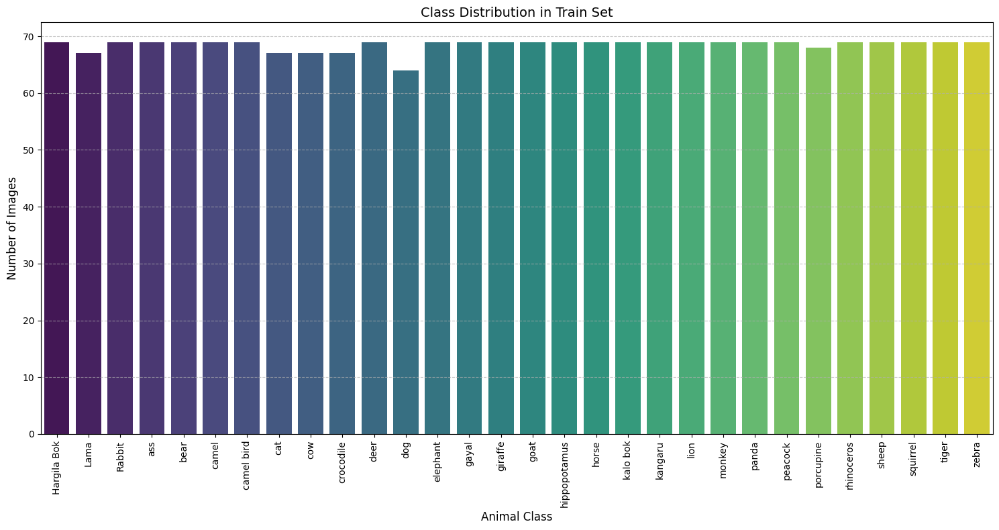

 

Imbalance Ratio (Max/Min): 1.08
 Most frequent class: 69 samples
 Least frequent class: 64 samples


In [19]:
### **Visualize class distrubuition**

import os
import matplotlib.pyplot as plt
import seaborn as sns

def plot_class_distribution(data_dir, subset):
    """
    Plots the distribution of images per class in a bar chart.
    Args:
        data_dir (str): Root directory of the dataset (contains 'train', 'val', 'test')
        subset (str): 'train', 'validation', or 'test'
    """
    subset_path = os.path.join(data_dir, subset)
    if not os.path.exists(subset_path):
        print(f"Error: {subset} directory not found!")
        return

    # Get class names and counts
    class_names = sorted(os.listdir(subset_path))
    class_counts = []

    for class_name in class_names:
        class_dir = os.path.join(subset_path, class_name)
        if os.path.isdir(class_dir):
            num_images = len([f for f in os.listdir(class_dir) if f.endswith(('.jpg', '.png', '.jpeg'))])
            class_counts.append(num_images)

    # Plotting
    plt.figure(figsize=(15, 8))
    sns.barplot(x=class_names, y=class_counts, palette="viridis")
    plt.xticks(rotation=90)
    plt.title(f"Class Distribution in {subset.capitalize()} Set", fontsize=14)
    plt.xlabel("Animal Class", fontsize=12)
    plt.ylabel("Number of Images", fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

    # Print imbalance ratio
    max_count = max(class_counts)
    min_count = min(class_counts)
    imbalance_ratio = max_count / min_count
    print(f" \n\nImbalance Ratio (Max/Min): {imbalance_ratio:.2f}")
    print(f" Most frequent class: {max_count} samples")
    print(f" Least frequent class: {min_count} samples")

# Run analysis on training set
plot_class_distribution(dataset_path, subset="train")

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


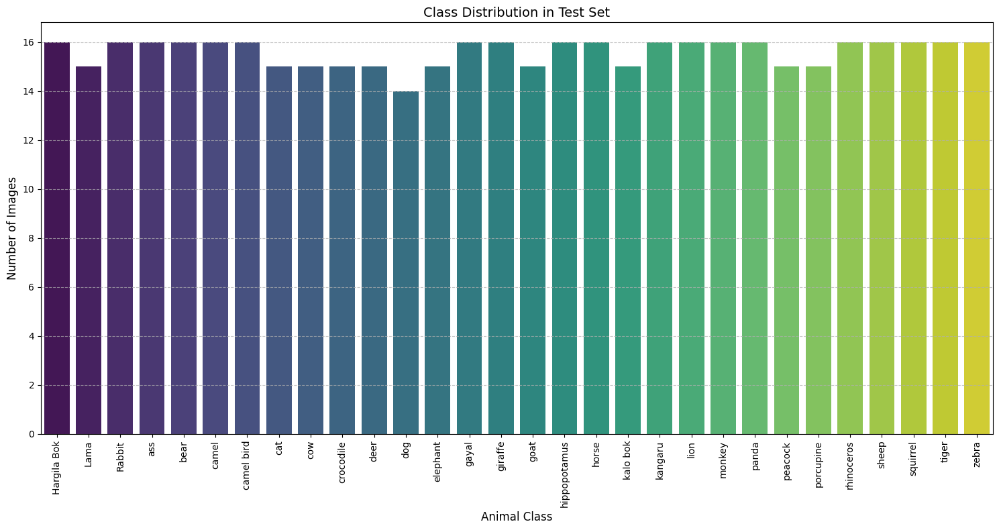

 

Imbalance Ratio (Max/Min): 1.14
 Most frequent class: 16 samples
 Least frequent class: 14 samples


In [20]:
plot_class_distribution(dataset_path, subset="test")

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


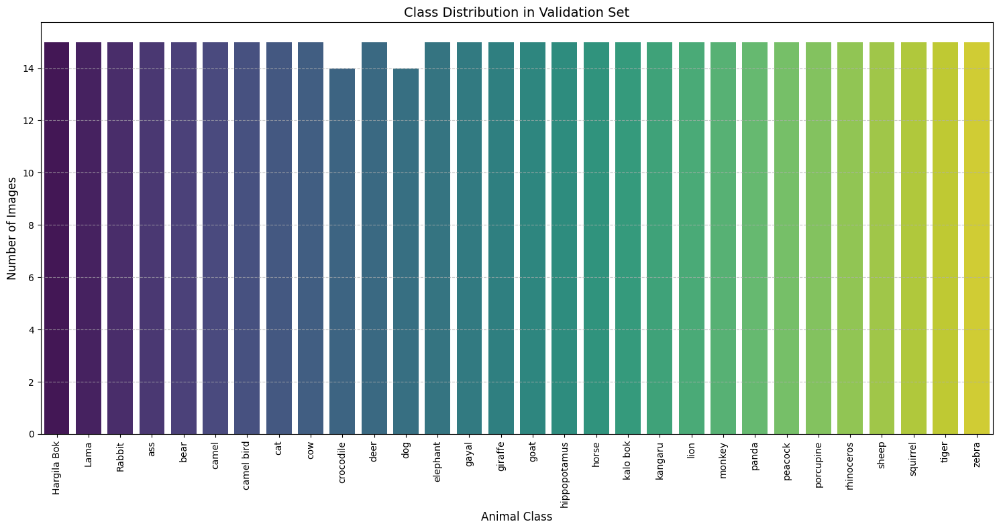

 

Imbalance Ratio (Max/Min): 1.07
 Most frequent class: 15 samples
 Least frequent class: 14 samples


In [22]:
plot_class_distribution(dataset_path, "validation")

## **Display random preprocessed images**

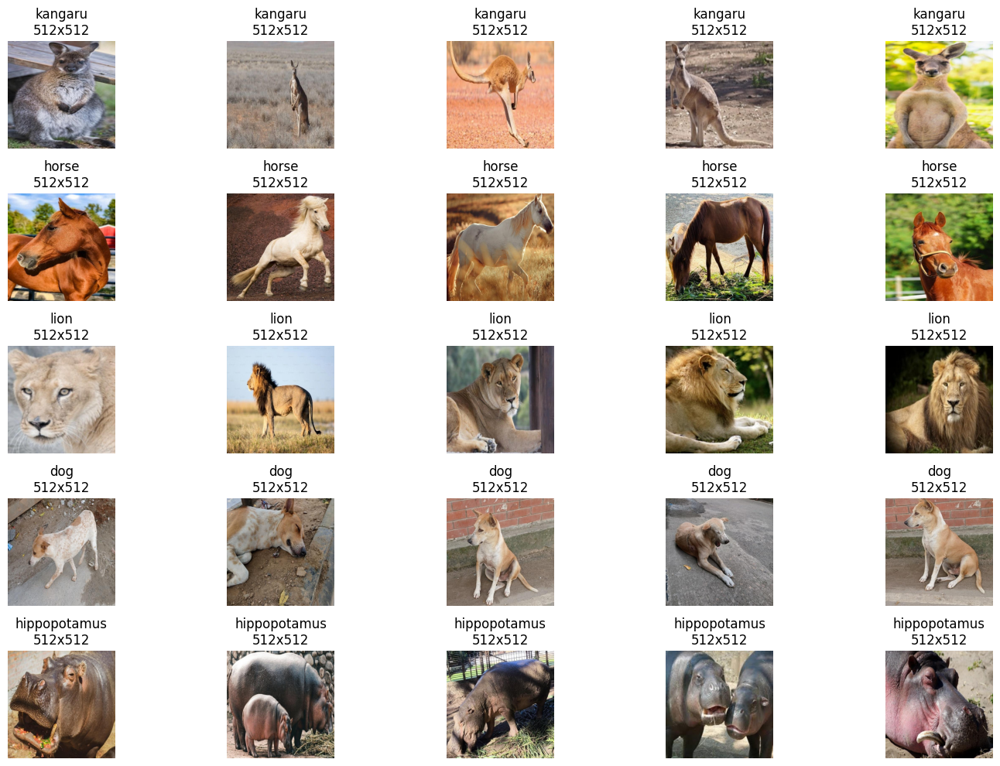

In [23]:
import matplotlib.pyplot as plt
import random

def display_random_samples(dataset_path, subset, n_samples=5):
    """Display random preprocessed images from each class"""
    subset_path = os.path.join(dataset_path, subset)
    classes = os.listdir(subset_path)

    plt.figure(figsize=(15, 10))
    for i, class_name in enumerate(classes[:min(5, len(classes))]):  # Show first 5 classes
        class_path = os.path.join(subset_path, class_name)
        images = os.listdir(class_path)
        sample_images = random.sample(images, min(n_samples, len(images)))

        for j, img_name in enumerate(sample_images):
            img_path = os.path.join(class_path, img_name)
            img = plt.imread(img_path)

            plt.subplot(len(classes[:5]), n_samples, i * n_samples + j + 1)
            plt.imshow(img)
            plt.title(f"{class_name}\n{img.shape[0]}x{img.shape[1]}")
            plt.axis('off')

    plt.tight_layout()
    plt.show()

display_random_samples(dataset_path, "test")

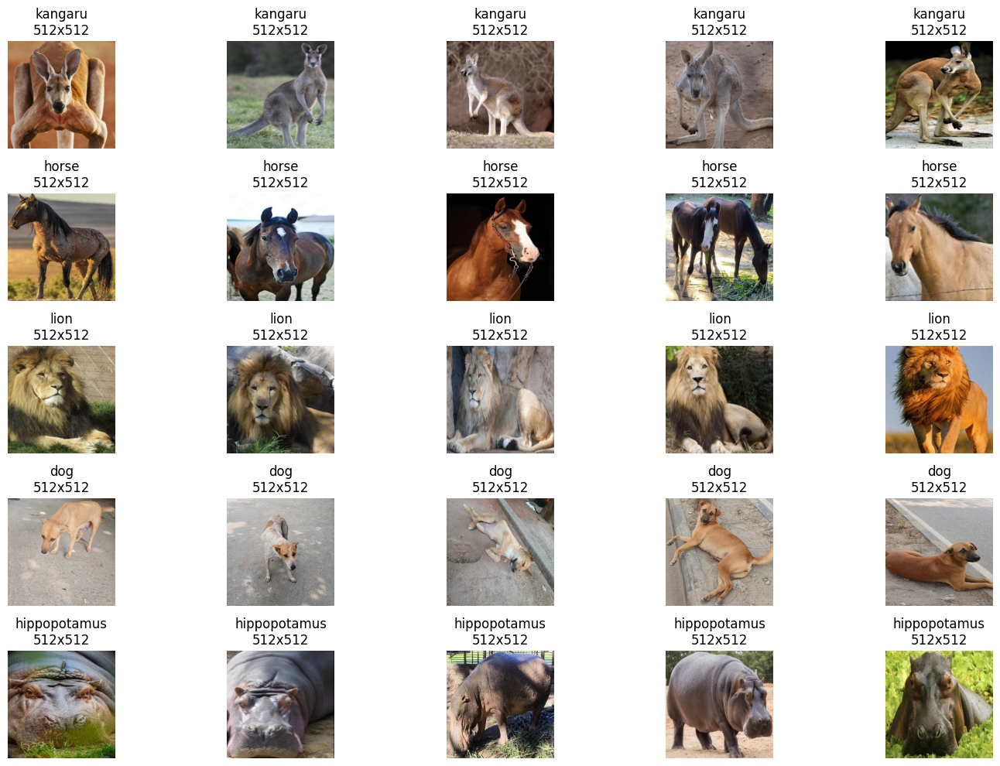

In [24]:
display_random_samples(dataset_path, "train")

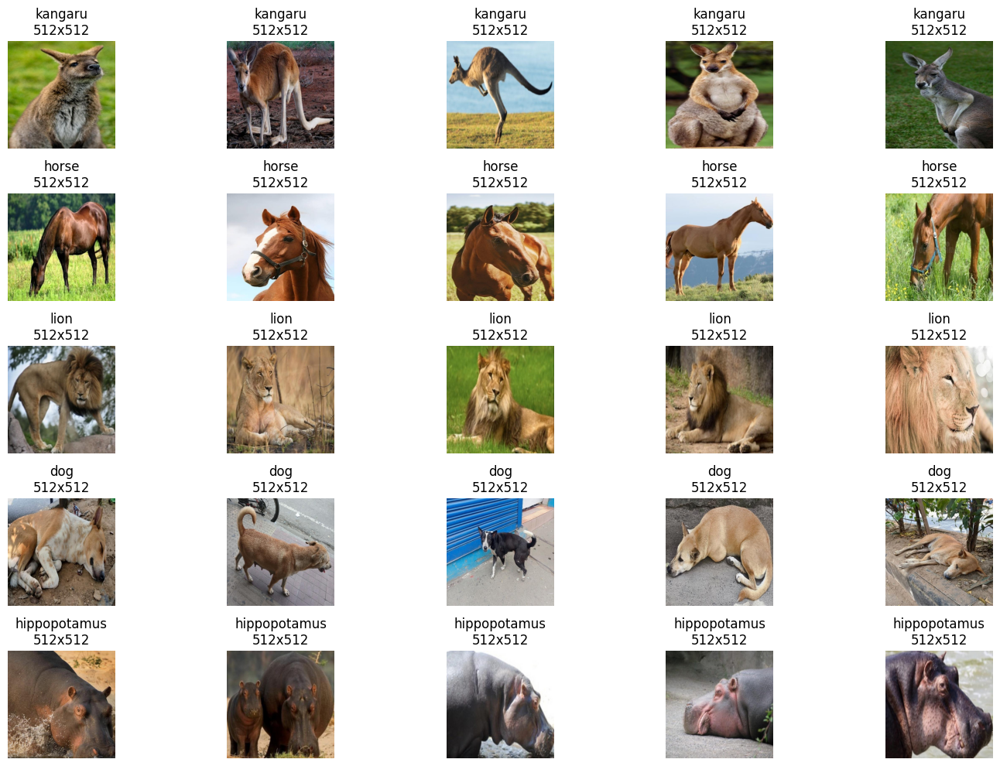

In [25]:
display_random_samples(dataset_path, "validation")

## **Plot RGB channel distributions for random samples**

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


KeyboardInterrupt: 

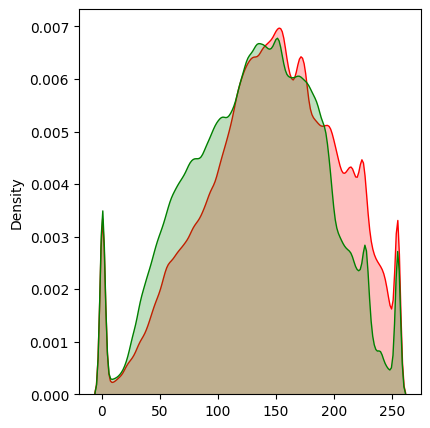

In [26]:
import cv2
import seaborn as sns

def plot_pixel_distribution(dataset_path, class_names=None, n_samples=50):
    """Plot RGB channel distributions for random samples"""
    if class_names is None:
        class_names = os.listdir(os.path.join(dataset_path, 'train'))[:3]  # First 3 classes

    plt.figure(figsize=(15, 5))
    for i, class_name in enumerate(class_names):
        class_path = os.path.join(dataset_path, 'train', class_name)
        images = random.sample(os.listdir(class_path), min(n_samples, len(os.listdir(class_path))))

        # Collect pixel values
        pixels = []
        for img_name in images:
            img = cv2.imread(os.path.join(class_path, img_name))
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB
            pixels.extend(img.reshape(-1, 3))

        # Plot distributions
        plt.subplot(1, len(class_names), i+1)
        sns.kdeplot(x=[p[0] for p in pixels], color='red', label='Red', fill=True)
        sns.kdeplot(x=[p[1] for p in pixels], color='green', label='Green', fill=True)
        sns.kdeplot(x=[p[2] for p in pixels], color='blue', label='Blue', fill=True)
        plt.title(f"{class_name} Pixel Distribution")
        plt.xlabel("Pixel Intensity (0-255)")
        plt.legend()

    plt.tight_layout()
    plt.show()

plot_pixel_distribution(dataset_path)

# **Data Augmentation**

In [2]:
import os
import numpy as np
from PIL import Image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tqdm import tqdm
import shutil # Import the shutil module

# Set paths
original_train_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/train"
augmented_train_dir = "/kaggle/working/Animal Classification/train_augmented"

# Create augmented directory structure
os.makedirs(augmented_train_dir, exist_ok=True)
for class_name in os.listdir(original_train_dir):
    os.makedirs(os.path.join(augmented_train_dir, class_name), exist_ok=True)

# Define augmentation with more transformations
datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    brightness_range=[0.8, 1.2],
    fill_mode='nearest'
)

# Target number of augmented images per class
TARGET_AUGMENTED = 500

print("🚀 Starting augmentation with structured naming...")
for class_name in tqdm(os.listdir(original_train_dir)):
    class_path = os.path.join(original_train_dir, class_name)
    augmented_class_path = os.path.join(augmented_train_dir, class_name)

    # Copy original images first
    original_images = sorted([f for f in os.listdir(class_path) if f.endswith('.jpg')])
    for img_name in original_images:
        src = os.path.join(class_path, img_name)
        dst = os.path.join(augmented_class_path, img_name)
        shutil.copy2(src, dst)

    # Calculate needed augmentations
    num_existing = len(original_images)
    if num_existing == 0:
        continue

    augmentations_needed = max(0, TARGET_AUGMENTED - num_existing)
    if augmentations_needed <= 0:
        continue

    augmentations_per_image = max(1, augmentations_needed // num_existing)

    # Process each image for augmentation
    for img_name in original_images:
        base_name = os.path.splitext(img_name)[0]  # Remove .jpg
        img_path = os.path.join(class_path, img_name)

        img = Image.open(img_path)
        img_array = np.array(img)
        img_array = img_array.reshape((1,) + img_array.shape)

        # Generate augmented images
        i = 0
        for batch in datagen.flow(
            img_array,
            batch_size=1,
            save_to_dir=augmented_class_path,
            save_prefix=f'{base_name}_aug_',
            save_format='jpg'
        ):
            i += 1
            if i >= augmentations_per_image:
                break

print("\n✅ Augmentation complete with structured naming!")
print(f"Original training images: {sum(len(files) for _, _, files in os.walk(original_train_dir))}")
print(f"Augmented training images: {sum(len(files) for _, _, files in os.walk(augmented_train_dir))}")

🚀 Starting augmentation with structured naming...


100%|██████████| 30/30 [12:36<00:00, 25.22s/it]



✅ Augmentation complete with structured naming!
Original training images: 2056
Augmented training images: 14389


In [36]:
# Verify augmentation
def show_augmented_samples(class_name, n_samples=5):
    class_path = os.path.join(augmented_train_dir, class_name)
    sample_images = [f for f in os.listdir(class_path) if f.startswith('aug')][:n_samples]

    plt.figure(figsize=(15, 3))
    for i, img_name in enumerate(sample_images):
        img = plt.imread(os.path.join(class_path, img_name))
        plt.subplot(1, n_samples, i+1)
        plt.imshow(img)
        plt.axis('off')
    plt.suptitle(f"Augmented samples for {class_name}", y=1.05)
    plt.show()

# Show samples from first 3 classes
for class_name in os.listdir(augmented_train_dir)[:3]:
    show_augmented_samples(class_name)

<Figure size 1500x300 with 0 Axes>

<Figure size 1500x300 with 0 Axes>

<Figure size 1500x300 with 0 Axes>

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

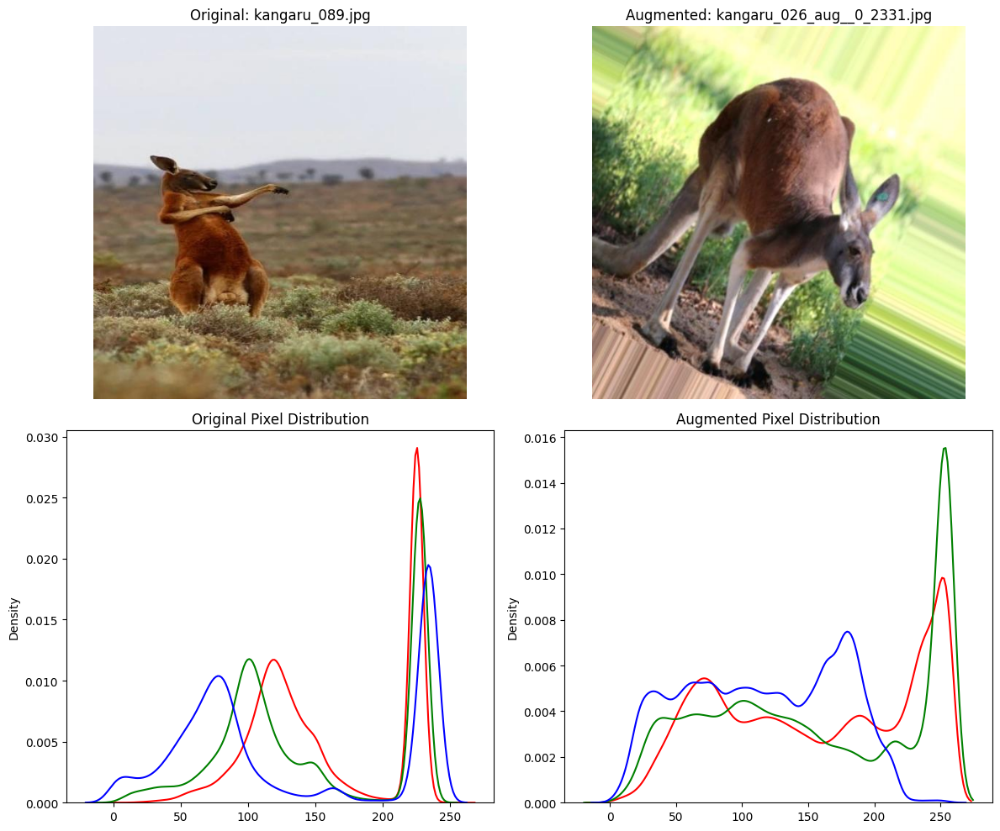

In [37]:
def compare_pixel_distributions(class_name):
    original_images = [f for f in os.listdir(os.path.join(original_train_dir, class_name))
                      if f.endswith('.jpg') and '_aug_' not in f]
    augmented_images = [f for f in os.listdir(os.path.join(augmented_train_dir, class_name))
                       if '_aug_' in f][:len(original_images)]

    # Sample images
    orig_sample = random.choice(original_images)
    aug_sample = random.choice(augmented_images)

    # Load images
    orig_img = plt.imread(os.path.join(original_train_dir, class_name, orig_sample))
    aug_img = plt.imread(os.path.join(augmented_train_dir, class_name, aug_sample))

    # Plot
    fig, axes = plt.subplots(2, 2, figsize=(12, 10))

    # Original image
    axes[0,0].imshow(orig_img)
    axes[0,0].set_title(f"Original: {orig_sample}")
    axes[0,0].axis('off')

    # Augmented image
    axes[0,1].imshow(aug_img)
    axes[0,1].set_title(f"Augmented: {aug_sample}")
    axes[0,1].axis('off')

    # Pixel distribution
    for i, channel in enumerate(['Red', 'Green', 'Blue']):
        sns.kdeplot(orig_img[:,:,i].flatten(), ax=axes[1,0], label=channel, color=channel.lower())
        sns.kdeplot(aug_img[:,:,i].flatten(), ax=axes[1,1], label=channel, color=channel.lower())

    axes[1,0].set_title("Original Pixel Distribution")
    axes[1,1].set_title("Augmented Pixel Distribution")
    plt.tight_layout()
    plt.show()

compare_pixel_distributions(os.listdir(original_train_dir)[0])

# **Model Training**

## **EfficientNetV2B0**

In [4]:
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras import layers, models, optimizers, callbacks
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import numpy as np
import os
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

# Enable mixed precision (if supported by GPU)
from tensorflow.keras.mixed_precision import set_global_policy
set_global_policy('mixed_float16')

# ==============================================
# 1. Configuration
# ==============================================
train_dir = "/kaggle/working/Animal Classification/train_augmented"
val_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/validation"
test_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/test"

# Model parameters
IMG_SIZE = (512, 512)
BATCH_SIZE = 64
NUM_CLASSES = 30  # Update with your actual number of classes
EPOCHS = 50

In [5]:
# ==============================================
# 2. Data Loading (Using Pre-Augmented Data)
# ==============================================
# Only rescaling for pre-augmented data (augmentation already done)
train_datagen = ImageDataGenerator(
    rescale=1./255  # Only normalization needed
)

# Validation and test data (only rescaling)
val_test_datagen = ImageDataGenerator(rescale=1./255)

# Data generators
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=True
)

val_generator = val_test_datagen.flow_from_directory(
    val_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

test_generator = val_test_datagen.flow_from_directory(
    test_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

# Get class names
class_names = list(train_generator.class_indices.keys())

Found 14385 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.


In [6]:

# ================================================
# 3. Model Definition (EfficientNetV2B0)
# ================================================
def build_efficientnet():
    """Build EfficientNetV2 model with fine-tuning"""
    # Load pre-trained base model
    base_model = EfficientNetV2B0(
        include_top=False,
        weights='imagenet',
        input_shape=(*IMG_SIZE, 3),
        pooling='avg'
    )

    # Fine-tune from this layer onwards
    base_model.trainable = True

    # Create new model on top
    model = models.Sequential([
        base_model,
        layers.Dense(1024, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.5),
        layers.Dense(NUM_CLASSES, activation='softmax')
    ])

    # Compile with custom learning rate
    optimizer = optimizers.Adam(learning_rate=1e-4)

    model.compile(
        optimizer=optimizer,
        loss='categorical_crossentropy',
        metrics=[
            'accuracy',
            tf.keras.metrics.Precision(name='precision'),
            tf.keras.metrics.Recall(name='recall'),
            tf.keras.metrics.AUC(name='auc')
        ]
    )

    return model

# Build model
model = build_efficientnet()
model.summary()

I0000 00:00:1746654905.121696      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1746654905.122571      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


24274472/24274472 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ efficientnetv2-b0 (Functional)       │ (None, 1280)                │       5,919,312 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1024)                │       1,311,744 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 1024)                │           4,096 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 30)                  │          30,750 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 7,265,902 (27.72 MB)

 Trainable params: 7,203,246 (27.48 MB)

 Non-trainable params: 62,656 (244.75 KB)

In [8]:
# ==============================================
# 4. Callbacks
# ==============================================
callbacks = [
    callbacks.EarlyStopping(
        monitor='val_loss',
        patience=7,
        restore_best_weights=True
    ),
    callbacks.ModelCheckpoint(
        filepath='best_model.keras',
        monitor='val_accuracy',
        save_best_only=True,
        mode='max'
    ),
    callbacks.ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.2,
        patience=3,
        min_lr=1e-6
    ),
    callbacks.TensorBoard(log_dir='./logs')
]

In [9]:
# ==============================================
# 5. Training with Pre-Augmented Data
# ==============================================
print("\nTraining with augmented data...")
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // BATCH_SIZE,
    validation_data=val_generator,
    validation_steps=val_generator.samples // BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=callbacks
)


Training with augmented data...
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1746655249.184038     126 service.cc:148] XLA service 0x7f29540306c0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1746655249.184951     126 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1746655249.184973     126 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1746655256.383406     126 cuda_dnn.cc:529] Loaded cuDNN version 90300
2025-05-07 22:01:11.218516: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f16[64,64,64,192]{3,2,

  7/224 ━━━━━━━━━━━━━━━━━━━━ 1:57 541ms/step - accuracy: 0.0356 - auc: 0.5139 - loss: 4.7030 - precision: 0.0981 - recall: 0.0116

2025-05-07 22:04:42.985368: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f16[49,64,64,48]{3,2,1,0}, u8[0]{0}) custom-call(f16[49,64,64,192]{3,2,1,0}, f16[192,3,3,48]{3,2,1,0}), window={size=3x3 pad=1_1x1_1}, dim_labels=b01f_o01i->b01f, custom_call_target="__cudnn$convBackwardInput", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kNone","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]} is taking a while...
2025-05-07 22:04:43.824917: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.839652908s
Trying algorithm eng0{} for conv (f16[49,64,64,48]{3,2,1,0}, u8[0]{0}) custom-call(f16[49,64,64,192]{3,2,1,0}, f16[192,3,3,48]{3,2,1,0}), window={size=3x3 pad=1_1x1_1}, dim_labels=b01f_o01i->b01f, custom_call_target="__cudnn$convBackwardInput", backend_config={"cudnn_conv_backend_config":{"activatio

224/224 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.2901 - auc: 0.7614 - loss: 3.0339 - precision: 0.5082 - recall: 0.2018

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


224/224 ━━━━━━━━━━━━━━━━━━━━ 576s 1s/step - accuracy: 0.2911 - auc: 0.7621 - loss: 3.0288 - precision: 0.5093 - recall: 0.2028 - val_accuracy: 0.5223 - val_auc: 0.8804 - val_loss: 2.2753 - val_precision: 0.9655 - val_recall: 0.0625 - learning_rate: 1.0000e-04
Epoch 2/50
224/224 ━━━━━━━━━━━━━━━━━━━━ 1s 463us/step - accuracy: 0.7969 - auc: 0.9904 - loss: 0.7140 - precision: 0.9000 - recall: 0.7031 - learning_rate: 1.0000e-04
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_loss` which is not available. Available metrics are: accuracy,auc,loss,precision,recall
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/callback_list.py:96: UserWarning: Learning rate reduction is conditioned on metric `val_loss` which is not available. Available metrics are: 

224/224 ━━━━━━━━━━━━━━━━━━━━ 131s 566ms/step - accuracy: 0.8836 - auc: 0.9952 - loss: 0.3958 - precision: 0.9373 - recall: 0.8366 - val_accuracy: 0.6406 - val_auc: 0.9443 - val_loss: 1.3746 - val_precision: 0.8972 - val_recall: 0.5067 - learning_rate: 1.0000e-04
Epoch 4/50
224/224 ━━━━━━━━━━━━━━━━━━━━ 0s 253us/step - accuracy: 0.9688 - auc: 0.9993 - loss: 0.2033 - precision: 1.0000 - recall: 0.9219 - learning_rate: 1.0000e-04
Epoch 5/50
224/224 ━━━━━━━━━━━━━━━━━━━━ 130s 564ms/step - accuracy: 0.9622 - auc: 0.9995 - loss: 0.1283 - precision: 0.9753 - recall: 0.9484 - val_accuracy: 0.8862 - val_auc: 0.9919 - val_loss: 0.4318 - val_precision: 0.9009 - val_recall: 0.8527 - learning_rate: 1.0000e-04
Epoch 6/50
224/224 ━━━━━━━━━━━━━━━━━━━━ 0s 262us/step - accuracy: 0.9531 - auc: 0.9998 - loss: 0.1114 - precision: 0.9524 - recall: 0.9375 - learning_rate: 1.0000e-04
Epoch 7/50
224/224 ━━━━━━━━━━━━━━━━━━━━ 130s 562ms/step - accuracy: 0.9847 - auc: 0.9999 - loss: 0.0585 - precision: 0.9881 - rec


Validation Set Evaluation:

Validation Evaluation:
7/7 ━━━━━━━━━━━━━━━━━━━━ 17s 512ms/step - accuracy: 0.9640 - auc: 0.9944 - loss: 0.1535 - precision: 0.9736 - recall: 0.9552
Loss: 0.1001
Accuracy: 0.9754
Precision: 0.9819
Recall: 0.9710
AUC: 0.9976
7/7 ━━━━━━━━━━━━━━━━━━━━ 12s 502ms/step

Classification Report:
              precision    recall  f1-score   support

 Hargila Bok       0.94      1.00      0.97        15
        Lama       1.00      0.87      0.93        15
      Rabbit       1.00      0.93      0.97        15
         ass       1.00      1.00      1.00        15
        bear       0.88      0.93      0.90        15
       camel       1.00      1.00      1.00        15
  camel bird       1.00      0.93      0.97        15
         cat       0.94      1.00      0.97        15
         cow       1.00      0.80      0.89        15
   crocodile       1.00      1.00      1.00        14
        deer       1.00      1.00      1.00        15
         dog       1.00      1.00  

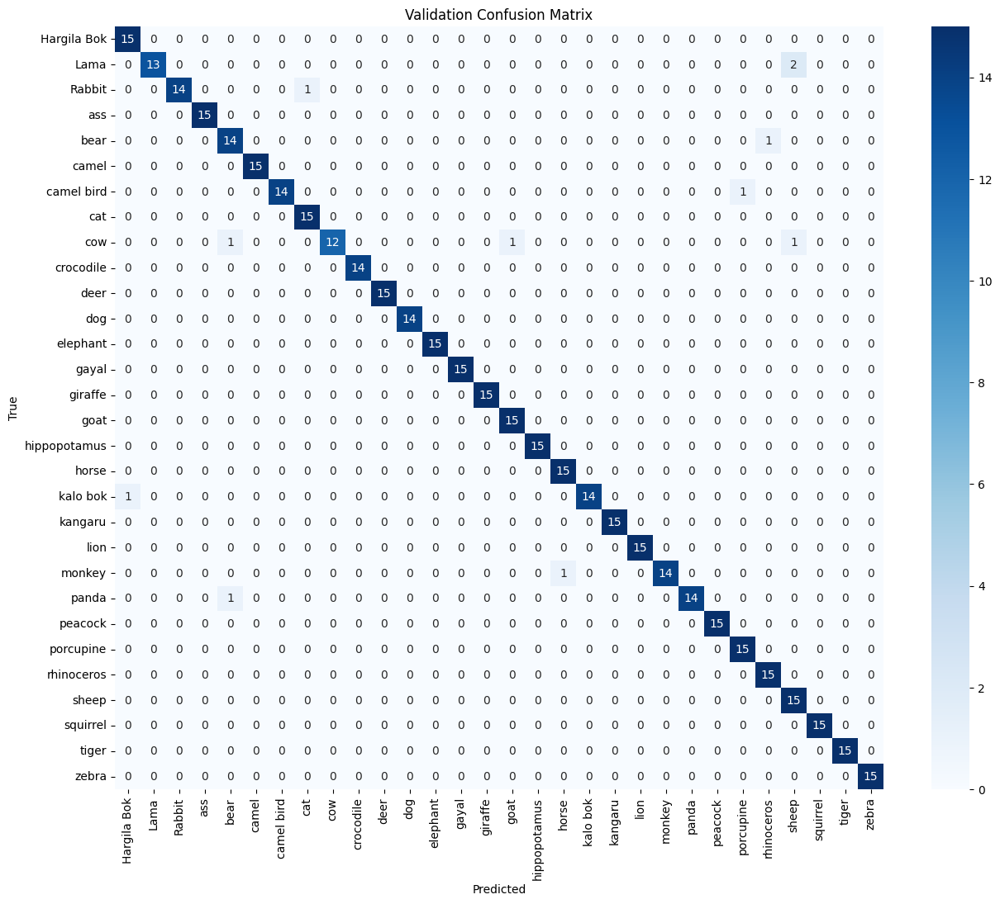


Test Set Evaluation:

Test Evaluation:


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


8/8 ━━━━━━━━━━━━━━━━━━━━ 28s 2s/step - accuracy: 0.9733 - auc: 0.9981 - loss: 0.0744 - precision: 0.9830 - recall: 0.9715
Loss: 0.0595
Accuracy: 0.9850
Precision: 0.9892
Recall: 0.9829
AUC: 0.9978
8/8 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step 

Classification Report:
              precision    recall  f1-score   support

 Hargila Bok       1.00      1.00      1.00        16
        Lama       1.00      0.80      0.89        15
      Rabbit       1.00      1.00      1.00        16
         ass       0.94      0.94      0.94        16
        bear       1.00      0.94      0.97        16
       camel       0.94      1.00      0.97        16
  camel bird       1.00      1.00      1.00        16
         cat       1.00      1.00      1.00        15
         cow       1.00      1.00      1.00        15
   crocodile       1.00      1.00      1.00        15
        deer       1.00      1.00      1.00        15
         dog       1.00      1.00      1.00        14
    elephant       1.00      1.00     

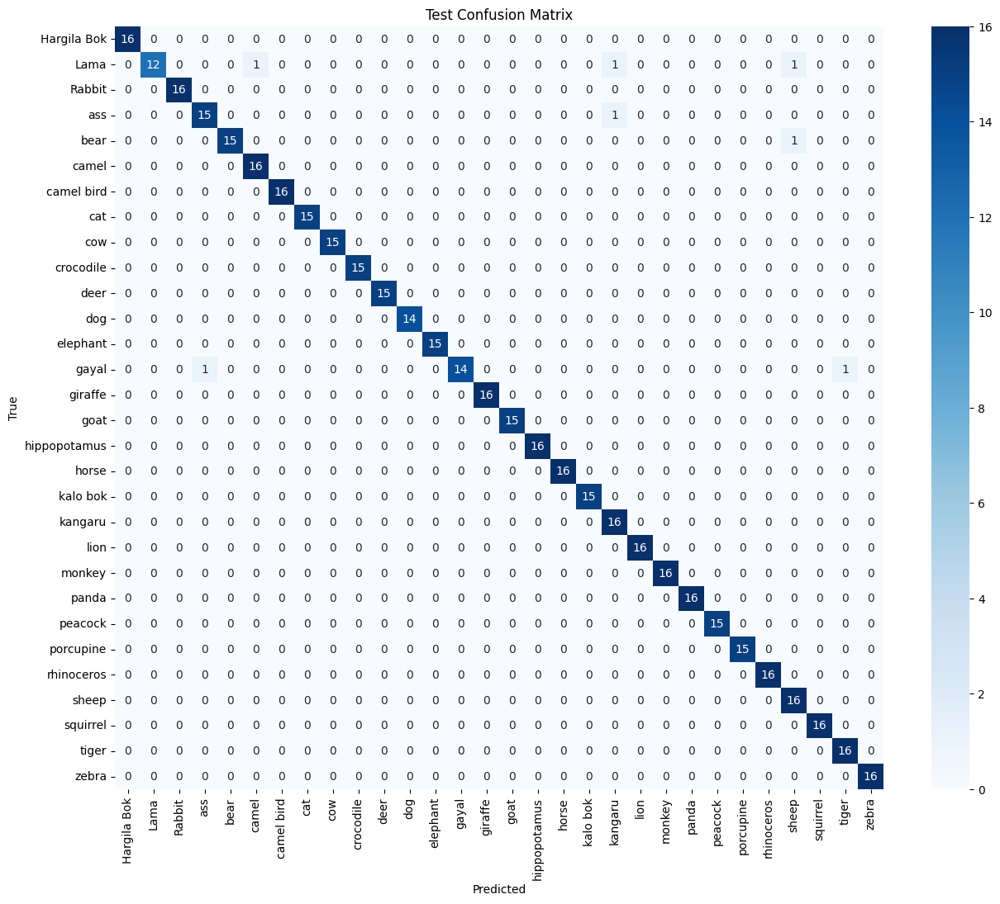

In [10]:
# ==============================================
# 6. Comprehensive Evaluation
# ==============================================
def evaluate_model(generator, dataset_type='Test'):
    """Evaluate model and generate reports"""
    print(f"\n{dataset_type} Evaluation:")

    # Load best model
    model = models.load_model('best_model.keras')

    # Standard evaluation
    results = model.evaluate(generator)
    print(f"Loss: {results[0]:.4f}")
    print(f"Accuracy: {results[1]:.4f}")
    print(f"Precision: {results[2]:.4f}")
    print(f"Recall: {results[3]:.4f}")
    print(f"AUC: {results[4]:.4f}")

    # Predictions for classification report
    y_pred = model.predict(generator)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = generator.classes

    # Classification report
    print("\nClassification Report:")
    print(classification_report(y_true, y_pred_classes, target_names=class_names))

    # Confusion matrix
    plt.figure(figsize=(15, 12))
    cm = confusion_matrix(y_true, y_pred_classes)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f'{dataset_type} Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.show()

# Evaluate on both validation and test sets
print("\nValidation Set Evaluation:")
evaluate_model(val_generator, 'Validation')

print("\nTest Set Evaluation:")
evaluate_model(test_generator, 'Test')

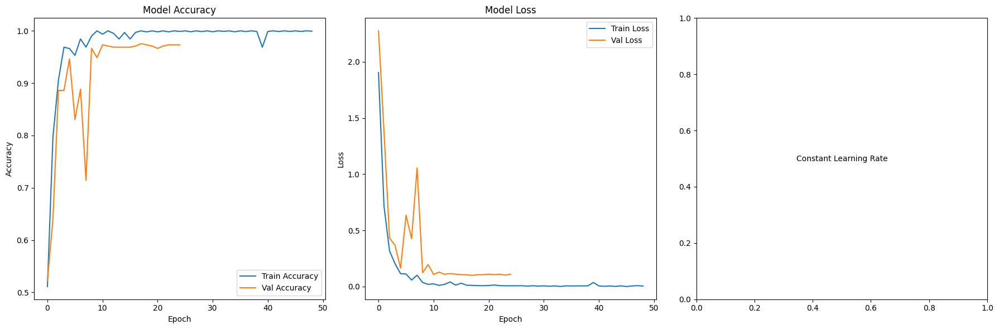

In [11]:
# ==============================================
# 7. Training Visualization
# ==============================================
def plot_training_history(history):
    plt.figure(figsize=(18, 6))

    # Plot accuracy
    plt.subplot(1, 3, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Val Accuracy')
    plt.title('Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()

    # Plot loss
    plt.subplot(1, 3, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Val Loss')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()

    # Plot learning rate
    plt.subplot(1, 3, 3)
    if 'lr' in history.history:
        plt.plot(history.history['lr'], label='Learning Rate')
        plt.title('Learning Rate')
        plt.ylabel('LR')
        plt.xlabel('Epoch')
        plt.legend()
    else:
        plt.text(0.5, 0.5, 'Constant Learning Rate',
                ha='center', va='center')

    plt.tight_layout()
    plt.show()

plot_training_history(history)

1/1 ━━━━━━━━━━━━━━━━━━━━ 10s 10s/step


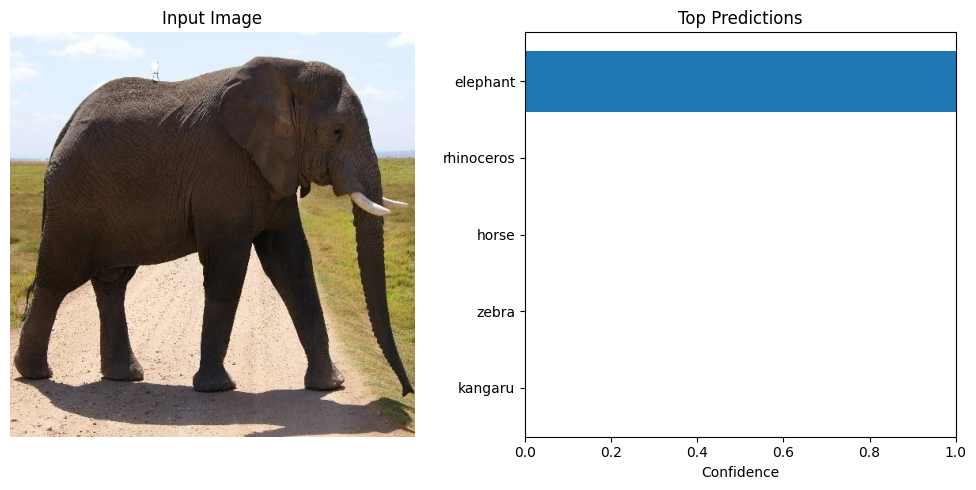

In [12]:
# ==============================================
# 9. Prediction Visualization
# ==============================================
def predict_and_visualize(image_path):
    img = tf.keras.preprocessing.image.load_img(
        image_path, target_size=IMG_SIZE
    )
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0) / 255.0

    model = models.load_model('best_model.keras')
    pred = model.predict(img_array)
    top_k = 5  # Show top 5 predictions

    # Get top predictions
    top_indices = np.argsort(pred[0])[-top_k:][::-1]
    top_classes = [class_names[i] for i in top_indices]
    top_confidences = pred[0][top_indices]

    # Plot
    plt.figure(figsize=(10, 5))

    # Image
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title('Input Image')

    # Predictions
    plt.subplot(1, 2, 2)
    plt.barh(range(top_k), top_confidences[::-1], align='center')
    plt.yticks(range(top_k), top_classes[::-1])
    plt.xlabel('Confidence')
    plt.title('Top Predictions')
    plt.xlim(0, 1)

    plt.tight_layout()
    plt.show()

# Example usage:
predict_and_visualize("/kaggle/input/animal-classification-dataset/Animal Classification/test/elephant/elephant_001.jpg")

1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step


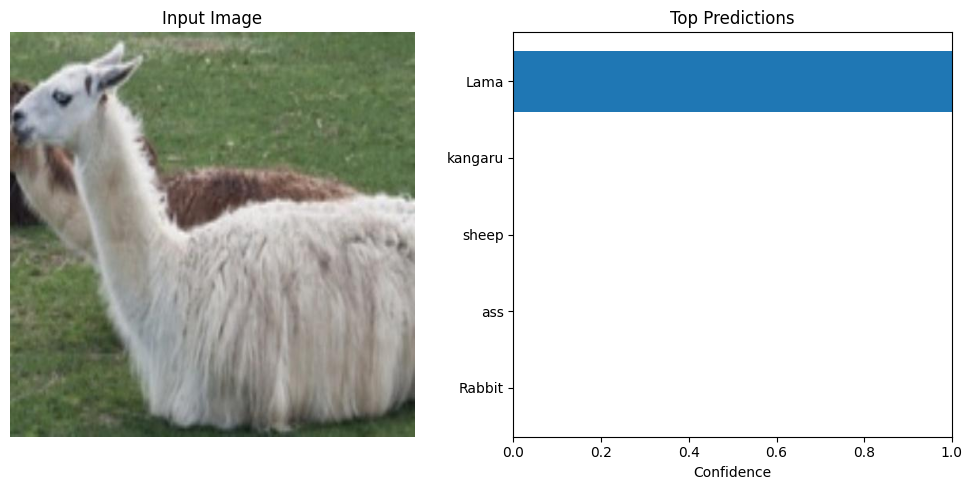

In [13]:
# Example usage:
predict_and_visualize("/kaggle/input/animal-classification-dataset/Animal Classification/validation/Lama/Lama_036.jpg")


Training Fold 1/5
Found 1644 validated image filenames belonging to 30 classes.
Found 412 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


102/102 ━━━━━━━━━━━━━━━━━━━━ 298s 2s/step - accuracy: 0.0795 - auc: 0.5849 - loss: 4.1935 - precision: 0.1417 - recall: 0.0240 - top3_accuracy: 0.1755 - val_accuracy: 0.1300 - val_auc: 0.5696 - val_loss: 3.3456 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 0.2225 - learning_rate: 1.0000e-04
Epoch 2/50
  1/102 ━━━━━━━━━━━━━━━━━━━━ 16s 167ms/step - accuracy: 0.4375 - auc: 0.8627 - loss: 2.0893 - precision: 0.7143 - recall: 0.3125 - top3_accuracy: 0.6875

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


102/102 ━━━━━━━━━━━━━━━━━━━━ 7s 67ms/step - accuracy: 0.4375 - auc: 0.8627 - loss: 2.0893 - precision: 0.7143 - recall: 0.3125 - top3_accuracy: 0.6875 - val_accuracy: 1.0000 - val_auc: 0.9984 - val_loss: 2.4301 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 1.0000 - learning_rate: 1.0000e-04
Epoch 3/50
102/102 ━━━━━━━━━━━━━━━━━━━━ 124s 1s/step - accuracy: 0.3848 - auc: 0.8620 - loss: 2.3382 - precision: 0.6400 - recall: 0.2146 - top3_accuracy: 0.5672 - val_accuracy: 0.2125 - val_auc: 0.7009 - val_loss: 3.0772 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 0.3625 - learning_rate: 1.0000e-04
Epoch 4/50
102/102 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - accuracy: 0.6875 - auc: 0.9499 - loss: 1.3324 - precision: 1.0000 - recall: 0.5000 - top3_accuracy: 0.7500 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 1.2451 - val_precision: 1.0000 - val_recall: 0.0833 - val_top3_accuracy: 1.0000 - learning_rate: 1.0000e-04
Epoch 5/50
102/102 ━━━━━━━

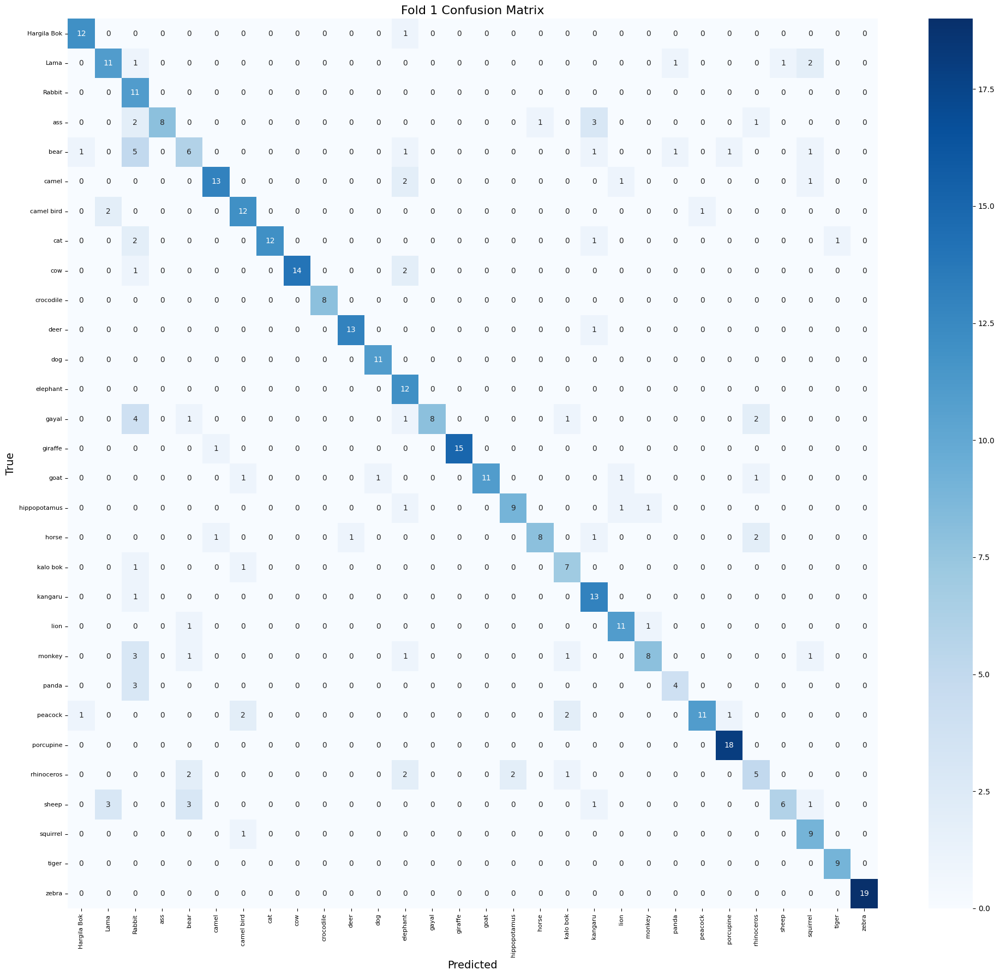


Training Fold 2/5
Found 1645 validated image filenames belonging to 30 classes.
Found 411 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


102/102 ━━━━━━━━━━━━━━━━━━━━ 319s 2s/step - accuracy: 0.0850 - auc: 0.6031 - loss: 4.1172 - precision: 0.1514 - recall: 0.0255 - top3_accuracy: 0.1839 - val_accuracy: 0.1625 - val_auc: 0.6795 - val_loss: 3.2474 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 0.3250 - learning_rate: 1.0000e-04
Epoch 2/50
  1/102 ━━━━━━━━━━━━━━━━━━━━ 15s 157ms/step - accuracy: 0.2500 - auc: 0.7722 - loss: 3.0619 - precision: 0.4286 - recall: 0.1875 - top3_accuracy: 0.4375

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


102/102 ━━━━━━━━━━━━━━━━━━━━ 11s 110ms/step - accuracy: 0.2500 - auc: 0.7722 - loss: 3.0619 - precision: 0.4286 - recall: 0.1875 - top3_accuracy: 0.4375 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 2.1743 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 1.0000 - learning_rate: 1.0000e-04
Epoch 3/50
102/102 ━━━━━━━━━━━━━━━━━━━━ 120s 1s/step - accuracy: 0.3489 - auc: 0.8621 - loss: 2.3949 - precision: 0.5840 - recall: 0.2070 - top3_accuracy: 0.5652 - val_accuracy: 0.5375 - val_auc: 0.9294 - val_loss: 2.4119 - val_precision: 1.0000 - val_recall: 0.0100 - val_top3_accuracy: 0.7700 - learning_rate: 1.0000e-04
Epoch 4/50
102/102 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.3750 - auc: 0.9049 - loss: 1.9656 - precision: 0.6667 - recall: 0.2500 - top3_accuracy: 0.6875 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 0.8793 - val_precision: 1.0000 - val_recall: 0.3636 - val_top3_accuracy: 1.0000 - learning_rate: 1.0000e-04
Epoch 5/50
102/102 ━━━━━━━━━━━━━

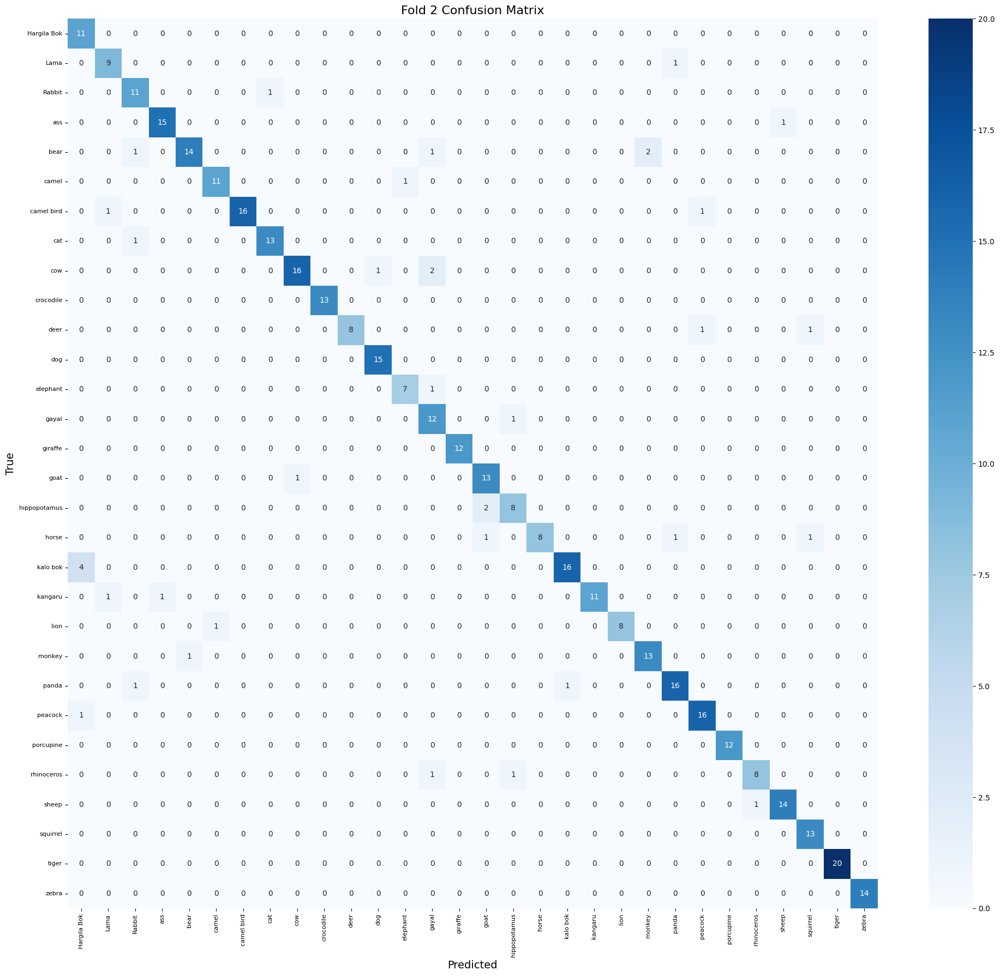


Training Fold 3/5
Found 1645 validated image filenames belonging to 30 classes.
Found 411 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


102/102 ━━━━━━━━━━━━━━━━━━━━ 306s 2s/step - accuracy: 0.0697 - auc: 0.5685 - loss: 4.3270 - precision: 0.1117 - recall: 0.0169 - top3_accuracy: 0.1680 - val_accuracy: 0.1475 - val_auc: 0.7026 - val_loss: 3.2294 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 0.3200 - learning_rate: 1.0000e-04
Epoch 2/50
  1/102 ━━━━━━━━━━━━━━━━━━━━ 15s 157ms/step - accuracy: 0.2500 - auc: 0.7980 - loss: 2.8205 - precision: 0.5000 - recall: 0.1250 - top3_accuracy: 0.5000

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


102/102 ━━━━━━━━━━━━━━━━━━━━ 7s 68ms/step - accuracy: 0.2500 - auc: 0.7980 - loss: 2.8205 - precision: 0.5000 - recall: 0.1250 - top3_accuracy: 0.5000 - val_accuracy: 0.9091 - val_auc: 0.9949 - val_loss: 2.4209 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 1.0000 - learning_rate: 1.0000e-04
Epoch 3/50
102/102 ━━━━━━━━━━━━━━━━━━━━ 115s 1s/step - accuracy: 0.3231 - auc: 0.8361 - loss: 2.5752 - precision: 0.5663 - recall: 0.1862 - top3_accuracy: 0.5192 - val_accuracy: 0.3100 - val_auc: 0.7892 - val_loss: 2.8811 - val_precision: 1.0000 - val_recall: 0.0025 - val_top3_accuracy: 0.4650 - learning_rate: 1.0000e-04
Epoch 4/50
102/102 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - accuracy: 0.3750 - auc: 0.9605 - loss: 1.5962 - precision: 0.6250 - recall: 0.3125 - top3_accuracy: 0.8125 - val_accuracy: 1.0000 - val_auc: 0.9997 - val_loss: 1.1937 - val_precision: 1.0000 - val_recall: 0.0909 - val_top3_accuracy: 1.0000 - learning_rate: 1.0000e-04
Epoch 5/50
102/102 ━━━━━━━━━━━━━━━

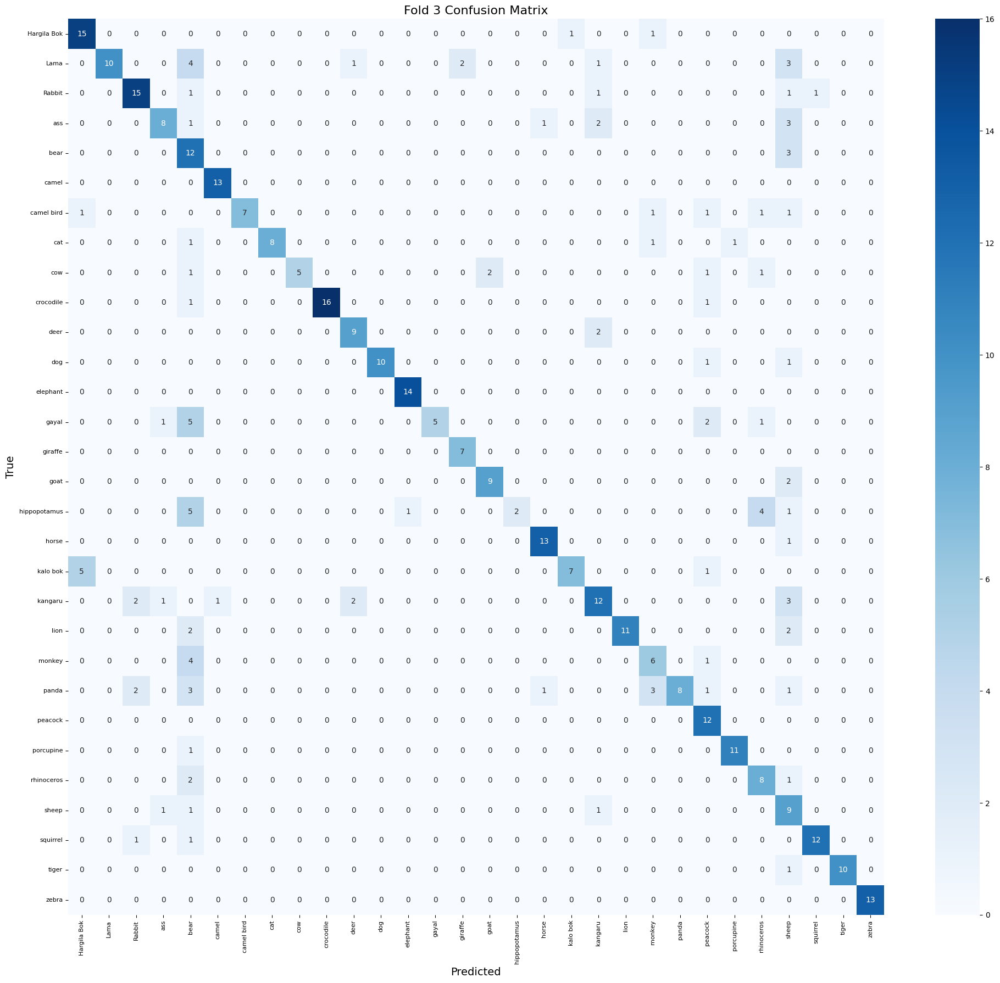


Training Fold 4/5
Found 1645 validated image filenames belonging to 30 classes.
Found 411 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


102/102 ━━━━━━━━━━━━━━━━━━━━ 305s 2s/step - accuracy: 0.0888 - auc: 0.5997 - loss: 4.1395 - precision: 0.1460 - recall: 0.0261 - top3_accuracy: 0.1956 - val_accuracy: 0.1275 - val_auc: 0.5990 - val_loss: 3.3269 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 0.2300 - learning_rate: 1.0000e-04
Epoch 2/50
  1/102 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - accuracy: 0.3125 - auc: 0.8721 - loss: 2.4204 - precision: 0.5000 - recall: 0.1875 - top3_accuracy: 0.5625

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


102/102 ━━━━━━━━━━━━━━━━━━━━ 7s 67ms/step - accuracy: 0.3125 - auc: 0.8721 - loss: 2.4204 - precision: 0.5000 - recall: 0.1875 - top3_accuracy: 0.5625 - val_accuracy: 0.8182 - val_auc: 0.9933 - val_loss: 2.7053 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 1.0000 - learning_rate: 1.0000e-04
Epoch 3/50
102/102 ━━━━━━━━━━━━━━━━━━━━ 126s 1s/step - accuracy: 0.4003 - auc: 0.8731 - loss: 2.2739 - precision: 0.6311 - recall: 0.2423 - top3_accuracy: 0.5908 - val_accuracy: 0.3975 - val_auc: 0.8576 - val_loss: 2.6643 - val_precision: 1.0000 - val_recall: 0.0075 - val_top3_accuracy: 0.5975 - learning_rate: 1.0000e-04
Epoch 4/50
102/102 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - accuracy: 0.3125 - auc: 0.8060 - loss: 2.8544 - precision: 0.5000 - recall: 0.1250 - top3_accuracy: 0.5000 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 0.9591 - val_precision: 1.0000 - val_recall: 0.0909 - val_top3_accuracy: 1.0000 - learning_rate: 1.0000e-04
Epoch 5/50
102/102 ━━━━━━━━━━━━━━━

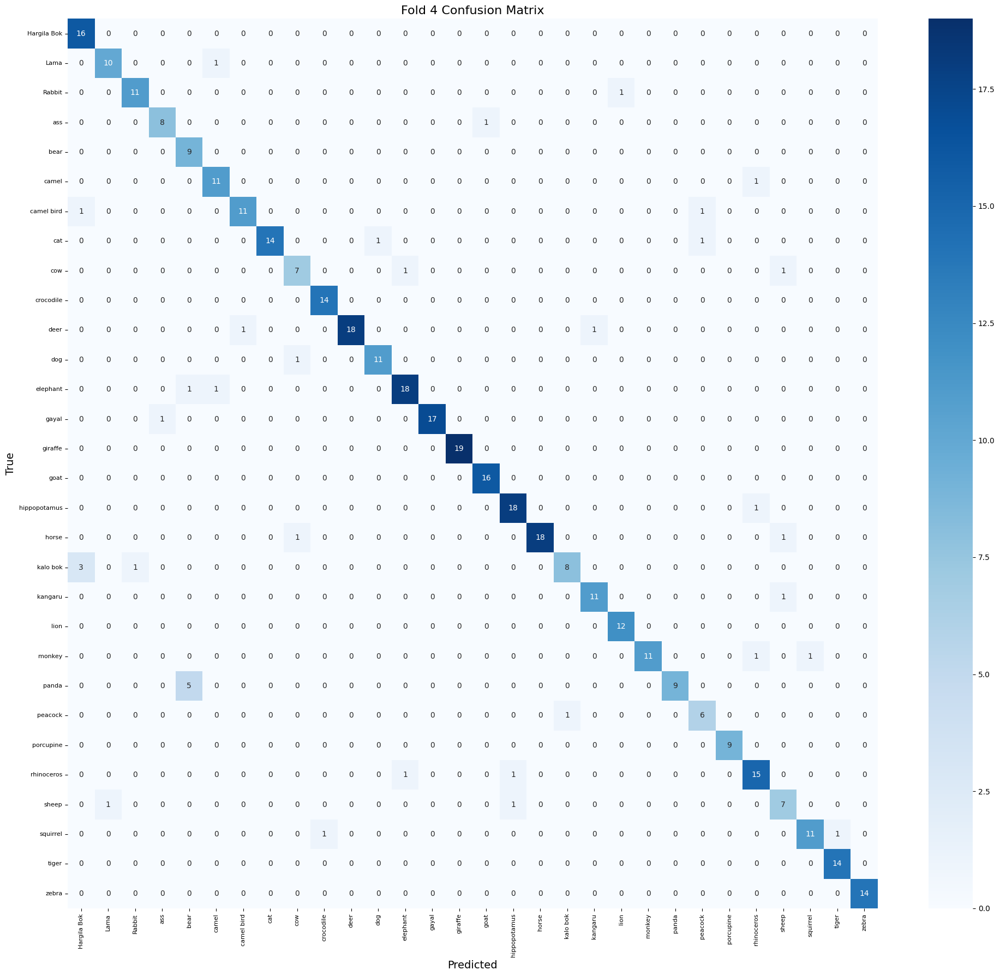


Training Fold 5/5
Found 1645 validated image filenames belonging to 30 classes.
Found 411 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


102/102 ━━━━━━━━━━━━━━━━━━━━ 306s 2s/step - accuracy: 0.0723 - auc: 0.5764 - loss: 4.2489 - precision: 0.1295 - recall: 0.0220 - top3_accuracy: 0.1792 - val_accuracy: 0.2575 - val_auc: 0.7395 - val_loss: 3.1879 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 0.4150 - learning_rate: 1.0000e-04
Epoch 2/50
  1/102 ━━━━━━━━━━━━━━━━━━━━ 15s 156ms/step - accuracy: 0.2500 - auc: 0.7113 - loss: 3.5341 - precision: 0.4000 - recall: 0.1250 - top3_accuracy: 0.4375

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


102/102 ━━━━━━━━━━━━━━━━━━━━ 7s 72ms/step - accuracy: 0.2500 - auc: 0.7113 - loss: 3.5341 - precision: 0.4000 - recall: 0.1250 - top3_accuracy: 0.4375 - val_accuracy: 0.7273 - val_auc: 0.9849 - val_loss: 2.4078 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 0.9091 - learning_rate: 1.0000e-04
Epoch 3/50
102/102 ━━━━━━━━━━━━━━━━━━━━ 118s 1s/step - accuracy: 0.3665 - auc: 0.8518 - loss: 2.4134 - precision: 0.6065 - recall: 0.2109 - top3_accuracy: 0.5614 - val_accuracy: 0.5800 - val_auc: 0.9409 - val_loss: 2.3344 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_top3_accuracy: 0.7825 - learning_rate: 1.0000e-04
Epoch 4/50
102/102 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - accuracy: 0.5625 - auc: 0.9632 - loss: 1.4995 - precision: 0.6364 - recall: 0.4375 - top3_accuracy: 0.8125 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 0.7707 - val_precision: 1.0000 - val_recall: 0.6364 - val_top3_accuracy: 1.0000 - learning_rate: 1.0000e-04
Epoch 5/50
102/102 ━━━━━━━

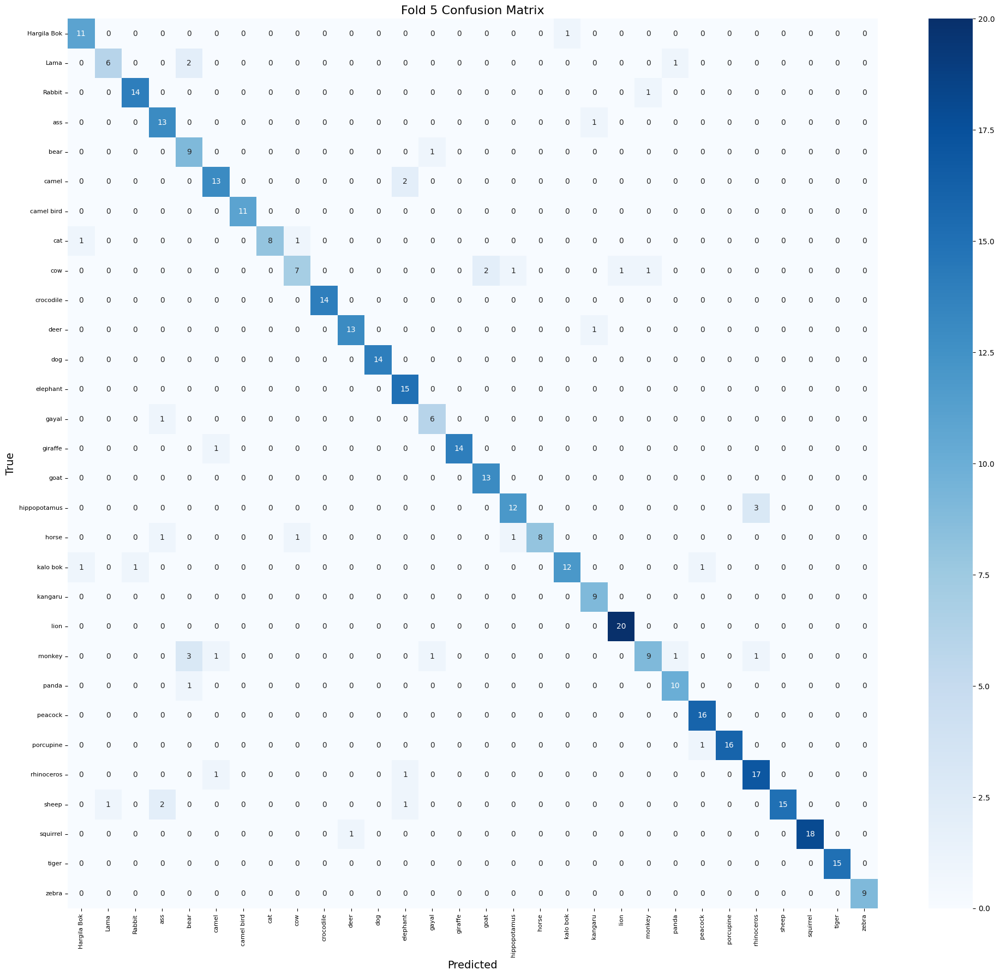


Cross-Validation Results:
   fold  val_loss  val_accuracy  val_precision  val_recall   val_auc  \
0     1  0.732087      0.762136       0.932660    0.672330  0.989257   
1     2  0.268081      0.907543       0.933162    0.883212  0.997605   
2     3  0.999780      0.722628       0.847134    0.647202  0.964750   
3     4  0.327421      0.907543       0.954787    0.873479  0.995802   
4     5  0.348216      0.892944       0.946950    0.868613  0.996718   

   val_top3_accuracy  
0           0.912621  
1           0.975669  
2           0.871046  
3           0.963504  
4           0.970803  

Mean Metrics Across Folds:
val_loss             0.535117
val_accuracy         0.838559
val_precision        0.922939
val_recall           0.788967
val_auc              0.988826
val_top3_accuracy    0.938729
dtype: float64

Standard Deviation Across Folds:
val_loss             0.317839
val_accuracy         0.089101
val_precision        0.043406
val_recall           0.118395
val_auc              0.01

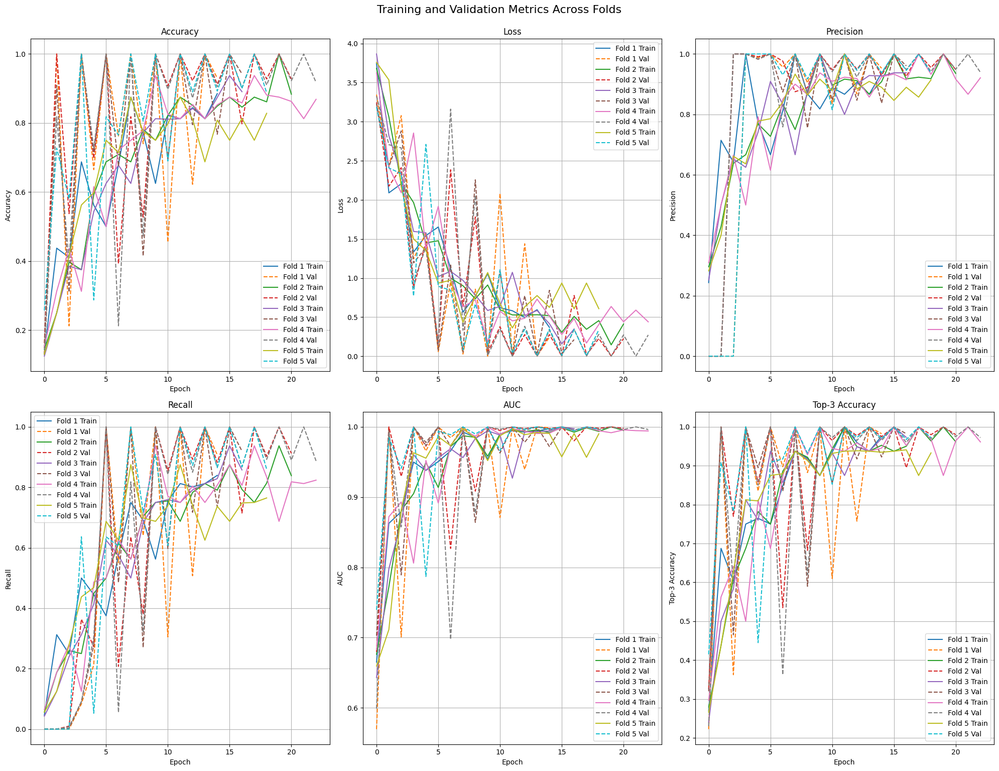

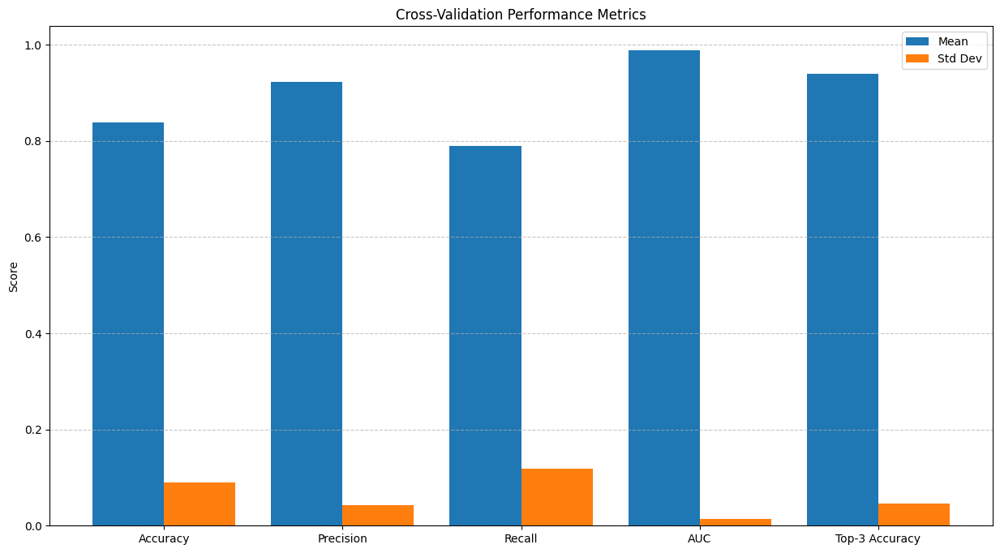

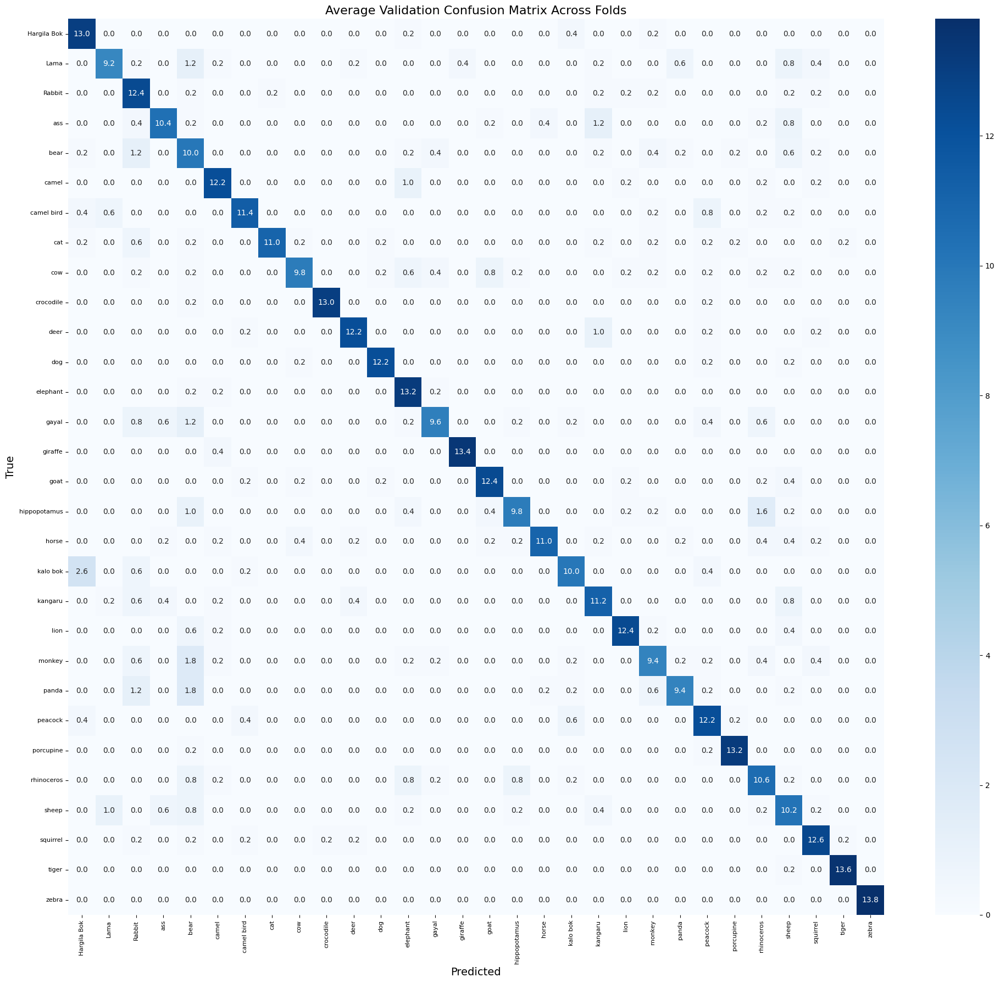


Evaluating on Test Set...
Found 468 images belonging to 30 classes.


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


30/30 ━━━━━━━━━━━━━━━━━━━━ 29s 705ms/step
30/30 ━━━━━━━━━━━━━━━━━━━━ 21s 465ms/step
30/30 ━━━━━━━━━━━━━━━━━━━━ 25s 424ms/step
30/30 ━━━━━━━━━━━━━━━━━━━━ 21s 456ms/step
30/30 ━━━━━━━━━━━━━━━━━━━━ 21s 443ms/step

Voting Ensemble Classification Report:
              precision    recall  f1-score   support

 Hargila Bok     0.8421    1.0000    0.9143        16
        Lama     0.8235    0.9333    0.8750        15
      Rabbit     0.8000    1.0000    0.8889        16
         ass     0.8235    0.8750    0.8485        16
        bear     0.7273    1.0000    0.8421        16
       camel     0.8889    1.0000    0.9412        16
  camel bird     0.9375    0.9375    0.9375        16
         cat     1.0000    0.9333    0.9655        15
         cow     1.0000    0.6667    0.8000        15
   crocodile     0.9375    1.0000    0.9677        15
        deer     1.0000    1.0000    1.0000        15
         dog     0.8750    1.0000    0.9333        14
    elephant     0.8667    0.8667    0.8667    

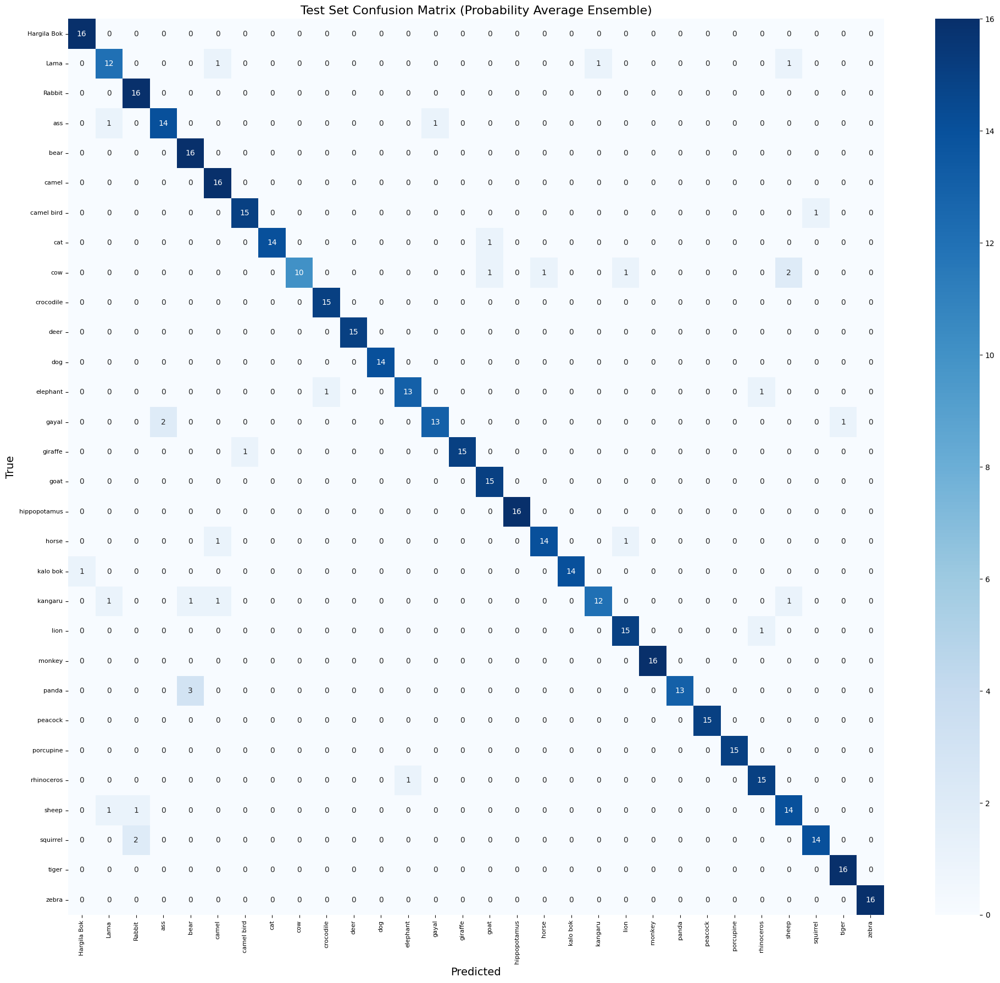

<Figure size 1500x800 with 0 Axes>

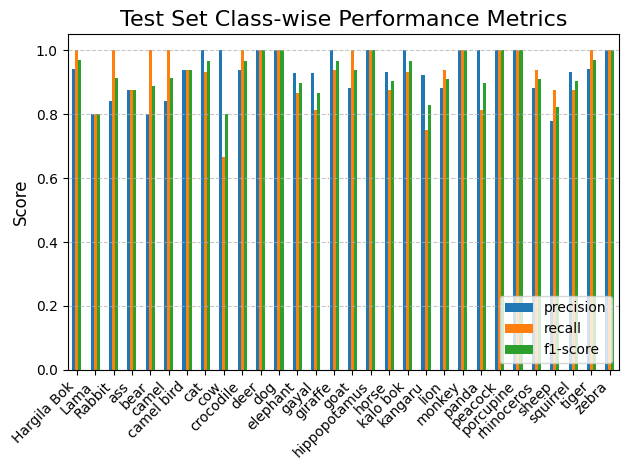


All models saved in /kaggle/working/


In [2]:
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras import layers, models, optimizers, callbacks
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import KFold
import matplotlib.pyplot as plt
import numpy as np
import os
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import pandas as pd

# Enable mixed precision
policy = tf.keras.mixed_precision.Policy('mixed_float16')
tf.keras.mixed_precision.set_global_policy(policy)

# Configuration
IMG_SIZE = (512, 512)
BATCH_SIZE = 16
NUM_CLASSES = 30
EPOCHS = 50
K_FOLDS = 5

# Data paths
data_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/train"
test_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/test"

# ===================================================
# 1. Prepare Cross-Validation
# ===================================================
def get_file_paths_and_labels(directory):
    file_paths = []
    labels = []
    class_names = sorted(os.listdir(directory))
    class_indices = {name: i for i, name in enumerate(class_names)}
    
    for class_name in class_names:
        class_dir = os.path.join(directory, class_name)
        if os.path.isdir(class_dir):
            for fname in os.listdir(class_dir):
                if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
                    file_paths.append(os.path.join(class_dir, fname))
                    labels.append(class_indices[class_name])
    
    return np.array(file_paths), np.array(labels), class_names

file_paths, labels, class_names = get_file_paths_and_labels(data_dir)
kfold = KFold(n_splits=K_FOLDS, shuffle=True, random_state=42)

# Store results
fold_results = []
all_histories = []
all_confusion_matrices = []

# ==============================================
# 2. Cross-Validation Training
# ==============================================
for fold, (train_idx, val_idx) in enumerate(kfold.split(file_paths, labels)):
    print(f"\n{'='*40}")
    print(f"Training Fold {fold+1}/{K_FOLDS}")
    print(f"{'='*40}")
    
    # Create dataframes for this fold
    train_df = pd.DataFrame({
        'filename': file_paths[train_idx],
        'class': labels[train_idx]
    })
    val_df = pd.DataFrame({
        'filename': file_paths[val_idx],
        'class': labels[val_idx]
    })
    
    # Map class indices to names
    train_df['class_name'] = train_df['class'].map(lambda x: class_names[x])
    val_df['class_name'] = val_df['class'].map(lambda x: class_names[x])
    
    # Create data generators
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        brightness_range=[0.8, 1.2],
        zoom_range=0.2
    )
    
    val_datagen = ImageDataGenerator(rescale=1./255)
    
    train_generator = train_datagen.flow_from_dataframe(
        dataframe=train_df,
        x_col='filename',
        y_col='class_name',
        target_size=IMG_SIZE,
        class_mode='categorical',
        batch_size=BATCH_SIZE,
        shuffle=True
    )
    
    val_generator = val_datagen.flow_from_dataframe(
        dataframe=val_df,
        x_col='filename',
        y_col='class_name',
        target_size=IMG_SIZE,
        class_mode='categorical',
        batch_size=BATCH_SIZE,
        shuffle=False
    )
    
    # Build model
    def build_model():
        base_model = EfficientNetV2B0(
            include_top=False,
            weights='imagenet',
            input_shape=(*IMG_SIZE, 3),
            pooling='avg'
        )
        base_model.trainable = True
        
        model = models.Sequential([
            base_model,
            layers.Dense(1024, activation='relu'),
            layers.BatchNormalization(),
            layers.Dropout(0.5),
            layers.Dense(NUM_CLASSES, activation='softmax', dtype='float32')
        ])
        
        model.compile(
            optimizer=optimizers.Adam(1e-4),
            loss='categorical_crossentropy',
            metrics=['accuracy',
                   tf.keras.metrics.Precision(name='precision'),
                   tf.keras.metrics.Recall(name='recall'),
                   tf.keras.metrics.AUC(name='auc'),
                   tf.keras.metrics.TopKCategoricalAccuracy(k=3, name='top3_accuracy')]
        )
        return model
    
    model = build_model()
    
    # Callbacks
    callbacks_list = [
        callbacks.EarlyStopping(patience=5, restore_best_weights=True, monitor='val_loss'),
        callbacks.ModelCheckpoint(f'best_fold_{fold+1}.keras', save_best_only=True, monitor='val_loss'),
        callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3)
    ]
    
    # Train
    history = model.fit(
        train_generator,
        steps_per_epoch=train_generator.samples // BATCH_SIZE,
        validation_data=val_generator,
        validation_steps=val_generator.samples // BATCH_SIZE,
        epochs=EPOCHS,
        callbacks=callbacks_list,
        verbose=1
    )
    all_histories.append(history.history)
    
    # Evaluate
    model = models.load_model(f'best_fold_{fold+1}.keras')
    val_results = model.evaluate(val_generator, verbose=0)
    
    # Store metrics
    fold_results.append({
        'fold': fold+1,
        'val_loss': val_results[0],
        'val_accuracy': val_results[1],
        'val_precision': val_results[2],
        'val_recall': val_results[3],
        'val_auc': val_results[4],
        'val_top3_accuracy': val_results[5]
    })
    
    # Confusion matrix
    y_pred = model.predict(val_generator)
    y_pred_classes = np.argmax(y_pred, axis=1)
    cm = confusion_matrix(val_generator.classes, y_pred_classes)
    all_confusion_matrices.append(cm)
    
    # Plot confusion matrix
    plt.figure(figsize=(20, 18))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,
                yticklabels=class_names)
    plt.title(f'Fold {fold+1} Confusion Matrix', fontsize=16)
    plt.xlabel('Predicted', fontsize=14)
    plt.ylabel('True', fontsize=14)
    plt.xticks(rotation=90, fontsize=8)
    plt.yticks(rotation=0, fontsize=8)
    plt.tight_layout()
    plt.show()

# ==============================================
# 3. Cross-Validation Results Analysis
# ==============================================
results_df = pd.DataFrame(fold_results)
print("\nCross-Validation Results:")
print(results_df)
print("\nMean Metrics Across Folds:")
print(results_df.mean()[1:])
print("\nStandard Deviation Across Folds:")
print(results_df.std()[1:])

# Plot training histories
plt.figure(figsize=(20, 15))
metrics = ['accuracy', 'loss', 'precision', 'recall', 'auc', 'top3_accuracy']
titles = ['Accuracy', 'Loss', 'Precision', 'Recall', 'AUC', 'Top-3 Accuracy']

for i, metric in enumerate(metrics):
    plt.subplot(2, 3, i+1)
    for fold in range(K_FOLDS):
        if metric in all_histories[fold]:
            plt.plot(all_histories[fold][metric], label=f'Fold {fold+1} Train')
            plt.plot(all_histories[fold][f'val_{metric}'], '--', label=f'Fold {fold+1} Val')
    plt.title(titles[i])
    plt.ylabel(titles[i])
    plt.xlabel('Epoch')
    plt.legend()
    plt.grid(True)

plt.tight_layout()
plt.suptitle('Training and Validation Metrics Across Folds', y=1.02, fontsize=16)
plt.show()

# Plot metrics comparison across folds
plt.figure(figsize=(15, 8))
metrics_to_compare = ['val_accuracy', 'val_precision', 'val_recall', 'val_auc', 'val_top3_accuracy']
metric_names = ['Accuracy', 'Precision', 'Recall', 'AUC', 'Top-3 Accuracy']

plt.bar(np.arange(len(metrics_to_compare)) - 0.2, results_df[metrics_to_compare].mean(), 
        width=0.4, label='Mean')
plt.bar(np.arange(len(metrics_to_compare)) + 0.2, results_df[metrics_to_compare].std(), 
        width=0.4, label='Std Dev')
plt.xticks(np.arange(len(metrics_to_compare)), metric_names)
plt.ylabel('Score')
plt.title('Cross-Validation Performance Metrics')
plt.legend()
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.show()

# Average confusion matrix
avg_cm = np.mean(all_confusion_matrices, axis=0)
plt.figure(figsize=(20, 18))
sns.heatmap(avg_cm, annot=True, fmt='.1f', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)
plt.title('Average Validation Confusion Matrix Across Folds', fontsize=16)
plt.xlabel('Predicted', fontsize=14)
plt.ylabel('True', fontsize=14)
plt.xticks(rotation=90, fontsize=8)
plt.yticks(rotation=0, fontsize=8)
plt.tight_layout()
plt.show()

# ==============================================
# 4. Final Evaluation on Test Set
# ==============================================
print("\nEvaluating on Test Set...")

# Load test data
test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

# Ensemble predictions
all_test_preds = []
all_test_probs = []

for fold in range(K_FOLDS):
    model = models.load_model(f'best_fold_{fold+1}.keras')
    preds = model.predict(test_generator)
    all_test_preds.append(np.argmax(preds, axis=1))
    all_test_probs.append(preds)
    test_generator.reset()

# Voting ensemble
ensemble_preds_vote = np.array(all_test_preds)
y_pred_vote = np.apply_along_axis(lambda x: np.bincount(x).argmax(), axis=0, arr=ensemble_preds_vote)

# Average probabilities ensemble
ensemble_probs = np.mean(all_test_probs, axis=0)
y_pred_prob = np.argmax(ensemble_probs, axis=1)
y_true = test_generator.classes

# Classification reports
print("\nVoting Ensemble Classification Report:")
print(classification_report(y_true, y_pred_vote, target_names=class_names, digits=4))

print("\nProbability Average Ensemble Classification Report:")
print(classification_report(y_true, y_pred_prob, target_names=class_names, digits=4))

# Confusion matrix for probability average (usually better)
plt.figure(figsize=(20, 18))
cm = confusion_matrix(y_true, y_pred_prob)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)
plt.title('Test Set Confusion Matrix (Probability Average Ensemble)', fontsize=16)
plt.xlabel('Predicted', fontsize=14)
plt.ylabel('True', fontsize=14)
plt.xticks(rotation=90, fontsize=8)
plt.yticks(rotation=0, fontsize=8)
plt.tight_layout()
plt.show()

# Class-wise metrics visualization
class_report = classification_report(y_true, y_pred_prob, 
                                   target_names=class_names, output_dict=True)
class_metrics = pd.DataFrame(class_report).transpose().iloc[:-3, :]

plt.figure(figsize=(15, 8))
class_metrics[['precision', 'recall', 'f1-score']].plot(kind='bar')
plt.title('Test Set Class-wise Performance Metrics', fontsize=16)
plt.ylabel('Score', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(loc='lower right', fontsize=10)
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Save all models
for fold in range(K_FOLDS):
    os.rename(f'best_fold_{fold+1}.keras', f'/kaggle/working/best_fold_{fold+1}.keras')

print("\nAll models saved in /kaggle/working/")

## **MobileNet Model**

### **Model Training**

In [5]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNet
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import os

# ==============================================
# Data Generators (Updated for Kaggle paths)
# ==============================================
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    brightness_range=[0.8, 1.2]
)

val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

# Update these paths to match your Kaggle dataset structure
train_generator = train_datagen.flow_from_directory(
    '/kaggle/working/Animal Classification/train_augmented',
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    shuffle=True
)

val_generator = val_datagen.flow_from_directory(
    '/kaggle/input/animal-classification-dataset/Animal Classification/validation',
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    shuffle=False
)

test_generator = val_datagen.flow_from_directory(
    '/kaggle/input/animal-classification-dataset/Animal Classification/test',
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    shuffle=False
)


Found 14388 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.


In [6]:
# ==============================================
# MobileNet Model (Unchanged)
# ==============================================
base_model = MobileNet(
    weights='imagenet',
    include_top=False,
    input_shape=(224, 224, 3),
    alpha=1.0  # Width multiplier (1.0 for full MobileNet)
)

# Freeze base model
base_model.trainable = False

model = tf.keras.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(30, activation='softmax')  # 30 animal classes
])

# Compile
model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)


I0000 00:00:1746786450.506470      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1746786450.507148      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


17225924/17225924 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [8]:
# ==============================================
# Callbacks (Updated for .keras format)
# ==============================================
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    ModelCheckpoint('best_model.keras', save_best_only=True, monitor='val_accuracy')  # Changed to .keras
]

# ==============================================
# Training (Unchanged)
# ==============================================
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    validation_data=val_generator,
    validation_steps=val_generator.samples // val_generator.batch_size,
    epochs=50,
    callbacks=callbacks
)

Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1746674697.004448     127 service.cc:148] XLA service 0x7a292802b080 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1746674697.005251     127 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1746674697.005273     127 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1746674697.555261     127 cuda_dnn.cc:529] Loaded cuDNN version 90300


  1/834 ━━━━━━━━━━━━━━━━━━━━ 2:40:57 12s/step - accuracy: 0.0312 - loss: 4.1799

I0000 00:00:1746674701.554719     127 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


834/834 ━━━━━━━━━━━━━━━━━━━━ 339s 393ms/step - accuracy: 0.6596 - loss: 1.2206 - val_accuracy: 0.9621 - val_loss: 0.1172
Epoch 2/50
834/834 ━━━━━━━━━━━━━━━━━━━━ 0s 37us/step - accuracy: 0.9688 - loss: 0.1728 
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_loss` which is not available. Available metrics are: accuracy,loss
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)


834/834 ━━━━━━━━━━━━━━━━━━━━ 324s 386ms/step - accuracy: 0.9142 - loss: 0.2786 - val_accuracy: 0.9554 - val_loss: 0.1363
Epoch 4/50
834/834 ━━━━━━━━━━━━━━━━━━━━ 0s 26us/step - accuracy: 0.9688 - loss: 0.2129 
Epoch 5/50
834/834 ━━━━━━━━━━━━━━━━━━━━ 325s 386ms/step - accuracy: 0.9276 - loss: 0.2223 - val_accuracy: 0.9732 - val_loss: 0.1100
Epoch 6/50
834/834 ━━━━━━━━━━━━━━━━━━━━ 0s 27us/step - accuracy: 0.9062 - loss: 0.2848 
Epoch 7/50
834/834 ━━━━━━━━━━━━━━━━━━━━ 322s 383ms/step - accuracy: 0.9381 - loss: 0.1901 - val_accuracy: 0.9732 - val_loss: 0.0900
Epoch 8/50
834/834 ━━━━━━━━━━━━━━━━━━━━ 0s 20us/step - accuracy: 0.9688 - loss: 0.1175 
Epoch 9/50
834/834 ━━━━━━━━━━━━━━━━━━━━ 323s 384ms/step - accuracy: 0.9433 - loss: 0.1760 - val_accuracy: 0.9643 - val_loss: 0.1162
Epoch 10/50
834/834 ━━━━━━━━━━━━━━━━━━━━ 0s 29us/step - accuracy: 0.9062 - loss: 0.2606 
Epoch 11/50
834/834 ━━━━━━━━━━━━━━━━━━━━ 326s 388ms/step - accuracy: 0.9446 - loss: 0.1641 - val_accuracy: 0.9777 - val_loss: 0.09

In [23]:
# ==============================================
# Evaluation Functions (Unchanged)
# ==============================================
def plot_training_history(history):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Accuracy Over Epochs')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Loss Over Epochs')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()

    plt.tight_layout()
    plt.show()

def generate_classification_report(model, generator):
    y_true = generator.classes
    y_pred = model.predict(generator)
    y_pred_classes = np.argmax(y_pred, axis=1)

    print("\nClassification Report:")
    print(classification_report(y_true, y_pred_classes, target_names=list(generator.class_indices.keys())))

    return y_true, y_pred_classes

def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(15, 12))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,
                yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.show()



Validation Set Evaluation:
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 93ms/step

Classification Report:
              precision    recall  f1-score   support

 Hargila Bok       0.94      1.00      0.97        15
        Lama       1.00      1.00      1.00        15
      Rabbit       1.00      0.93      0.97        15
         ass       1.00      1.00      1.00        15
        bear       1.00      0.87      0.93        15
       camel       0.79      1.00      0.88        15
  camel bird       0.94      1.00      0.97        15
         cat       0.94      1.00      0.97        15
         cow       1.00      0.87      0.93        15
   crocodile       1.00      1.00      1.00        14
        deer       1.00      1.00      1.00        15
         dog       1.00      1.00      1.00        14
    elephant       0.94      1.00      0.97        15
       gayal       0.94      1.00      0.97        15
     giraffe       1.00      1.00      1.00        15
        goat       1.00      1.00      1.00

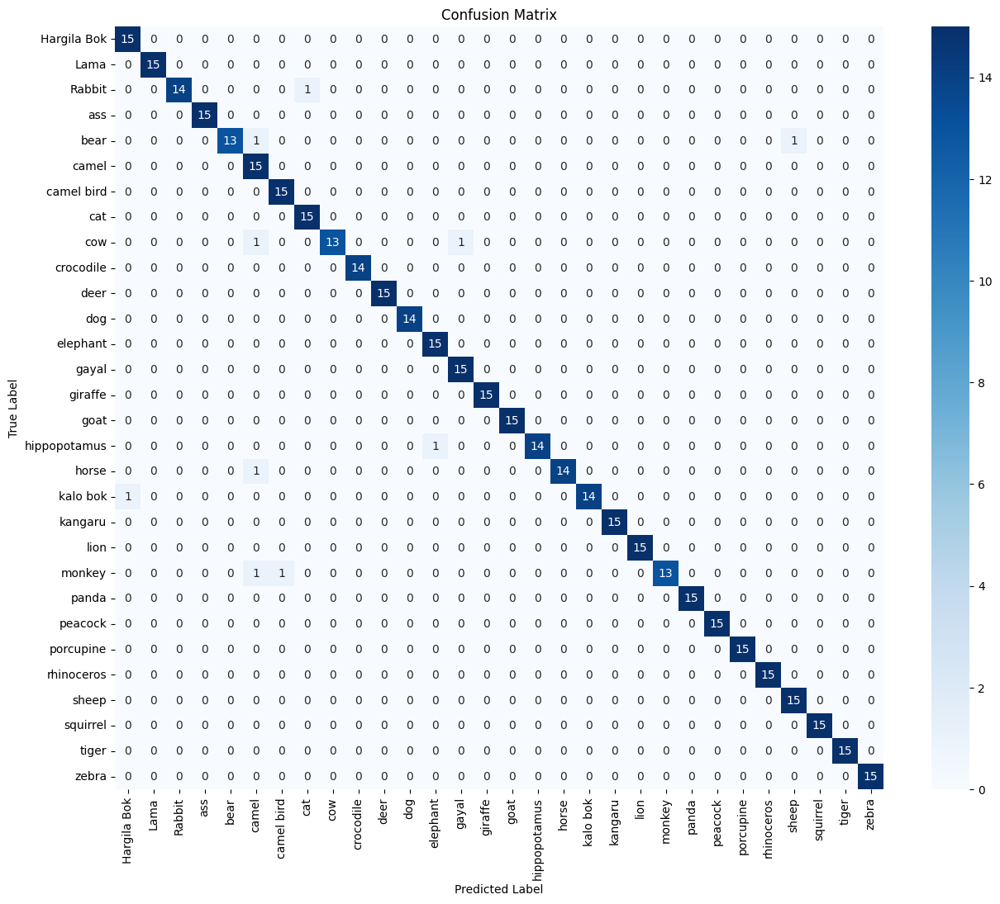


Test Set Evaluation:
15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 199ms/step

Classification Report:
              precision    recall  f1-score   support

 Hargila Bok       1.00      1.00      1.00        16
        Lama       0.93      0.87      0.90        15
      Rabbit       1.00      1.00      1.00        16
         ass       0.94      0.94      0.94        16
        bear       1.00      0.94      0.97        16
       camel       0.89      1.00      0.94        16
  camel bird       1.00      1.00      1.00        16
         cat       1.00      1.00      1.00        15
         cow       0.93      0.87      0.90        15
   crocodile       1.00      1.00      1.00        15
        deer       0.79      1.00      0.88        15
         dog       1.00      1.00      1.00        14
    elephant       1.00      1.00      1.00        15
       gayal       0.93      0.88      0.90        16
     giraffe       1.00      0.94      0.97        16
        goat       1.00      1.00      1.00     

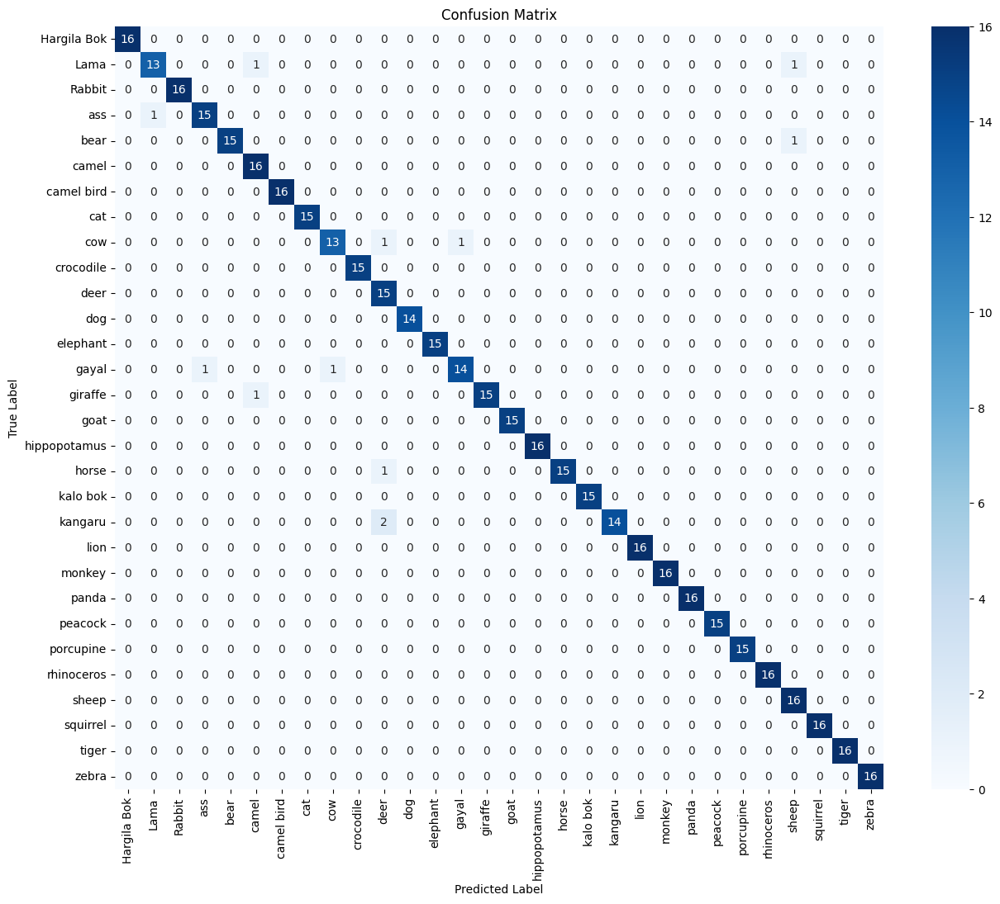

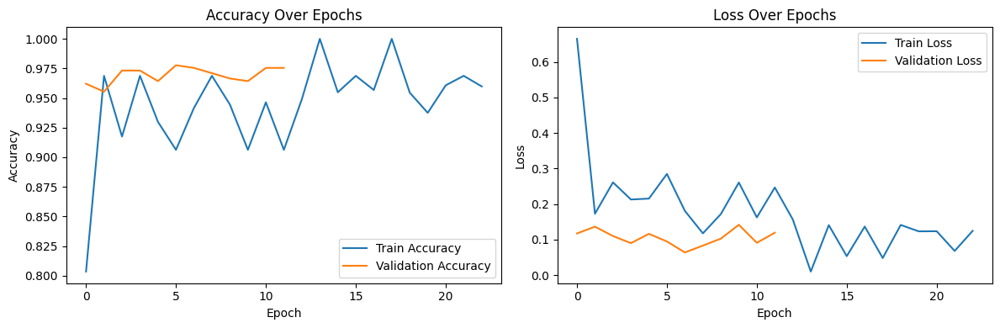

In [19]:
# ==============================================
# Evaluation (Unchanged except model loading)
# ==============================================
print("\nValidation Set Evaluation:")
model = tf.keras.models.load_model('best_model.keras')  # Changed to .keras
y_true_val, y_pred_val = generate_classification_report(model, val_generator)
plot_confusion_matrix(y_true_val, y_pred_val, list(val_generator.class_indices.keys()))

print("\nTest Set Evaluation:")
y_true_test, y_pred_test = generate_classification_report(model, test_generator)
plot_confusion_matrix(y_true_test, y_pred_test, list(test_generator.class_indices.keys()))

plot_training_history(history)


In [20]:
# ==============================================
# Additional Metrics (Unchanged)
# ==============================================
def calculate_class_weights(generator):
    class_counts = np.bincount(generator.classes)
    total_samples = np.sum(class_counts)
    return {i: total_samples / (len(class_counts) * count) for i, count in enumerate(class_counts)}

class_weights = calculate_class_weights(train_generator)
print("\nClass Weights (for handling imbalance):")
print(class_weights)

# Save the model (Updated for .keras format)
model.save('animal_classifier_mobilenet.keras')
print("\nModel saved as 'animal_classifier_mobilenet.keras'")



Class Weights (for handling imbalance):
{0: 0.9927536231884058, 1: 1.0235632183908046, 2: 0.9927536231884058, 3: 0.9927536231884058, 4: 0.9927536231884058, 5: 0.9927536231884058, 6: 0.9938616071428571, 7: 1.0235632183908046, 8: 1.0223880597014925, 9: 1.0235632183908046, 10: 0.9938616071428571, 11: 1.0716004813477737, 12: 0.9927536231884058, 13: 0.9927536231884058, 14: 0.9927536231884058, 15: 0.9927536231884058, 16: 0.9938616071428571, 17: 0.9938616071428571, 18: 0.9927536231884058, 19: 0.9938616071428571, 20: 0.9938616071428571, 21: 0.9927536231884058, 22: 0.9927536231884058, 23: 0.9938616071428571, 24: 1.0096371882086168, 25: 0.9927536231884058, 26: 0.9927536231884058, 27: 0.9927536231884058, 28: 0.9927536231884058, 29: 0.9927536231884058}

Model saved as 'animal_classifier_mobilenet.keras'


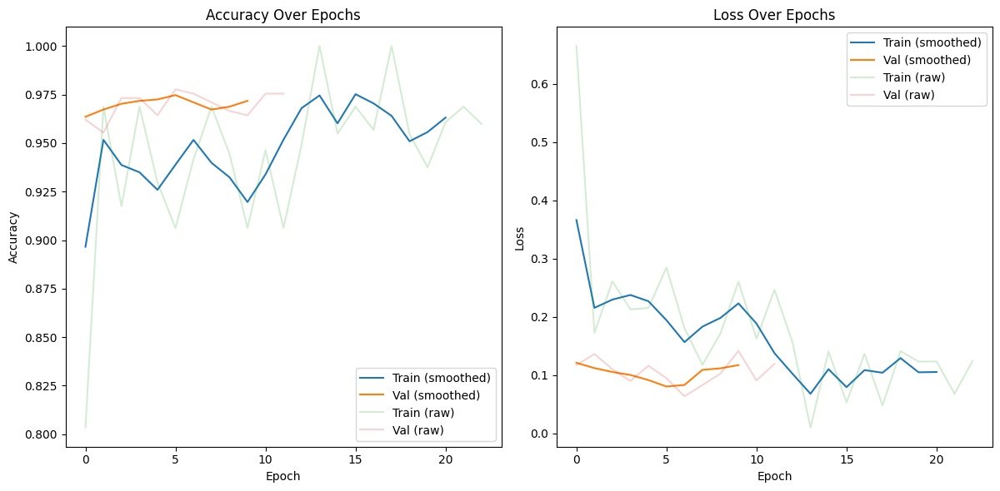

In [21]:
# ==============================================
# Enhanced Training History Visualization (Unchanged)
# ==============================================
def plot_enhanced_training_history(history):
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    smooth = lambda x: np.convolve(x, np.ones(3)/3, mode='valid')
    plt.plot(smooth(history.history['accuracy']), label='Train (smoothed)')
    plt.plot(smooth(history.history['val_accuracy']), label='Val (smoothed)')
    plt.plot(history.history['accuracy'], alpha=0.2, label='Train (raw)')
    plt.plot(history.history['val_accuracy'], alpha=0.2, label='Val (raw)')
    plt.title('Accuracy Over Epochs')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()

    plt.subplot(1, 3, 2)
    plt.plot(smooth(history.history['loss']), label='Train (smoothed)')
    plt.plot(smooth(history.history['val_loss']), label='Val (smoothed)')
    plt.plot(history.history['loss'], alpha=0.2, label='Train (raw)')
    plt.plot(history.history['val_loss'], alpha=0.2, label='Val (raw)')
    plt.title('Loss Over Epochs')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()

    if 'lr' in history.history:
        plt.subplot(1, 3, 3)
        plt.plot(history.history['lr'])
        plt.title('Learning Rate Over Epochs')
        plt.ylabel('Learning Rate')
        plt.xlabel('Epoch')

    plt.tight_layout()
    plt.show()

plot_enhanced_training_history(history)


Total samples: 14388
Number of classes: 30

===== Fold 1 / 5 =====
Found 11510 validated image filenames belonging to 30 classes.
Found 2878 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 161s 418ms/step - accuracy: 0.5455 - loss: 1.6796 - val_accuracy: 0.9579 - val_loss: 0.1621
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step - accuracy: 0.8125 - loss: 0.5948

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.8125 - loss: 0.5948 - val_accuracy: 1.0000 - val_loss: 0.0083
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 153s 419ms/step - accuracy: 0.8693 - loss: 0.4123 - val_accuracy: 0.9695 - val_loss: 0.1124
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 281us/step - accuracy: 0.8750 - loss: 0.3978 - val_accuracy: 1.0000 - val_loss: 2.9650e-04
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 148s 404ms/step - accuracy: 0.8961 - loss: 0.3125 - val_accuracy: 0.9796 - val_loss: 0.0747
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 263us/step - accuracy: 0.8750 - loss: 0.3471 - val_accuracy: 1.0000 - val_loss: 1.6082e-04
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 148s 404ms/step - accuracy: 0.9245 - loss: 0.2462 - val_accuracy: 0.9779 - val_loss: 0.0702
Epoch 8/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 174us/step - accuracy: 0.9062 - loss: 0.3159 - val_accuracy: 1.0000 - val_loss: 0.0010
Epoch 9/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 148s 406ms/step - accuracy: 0.9292 - loss: 0.2054

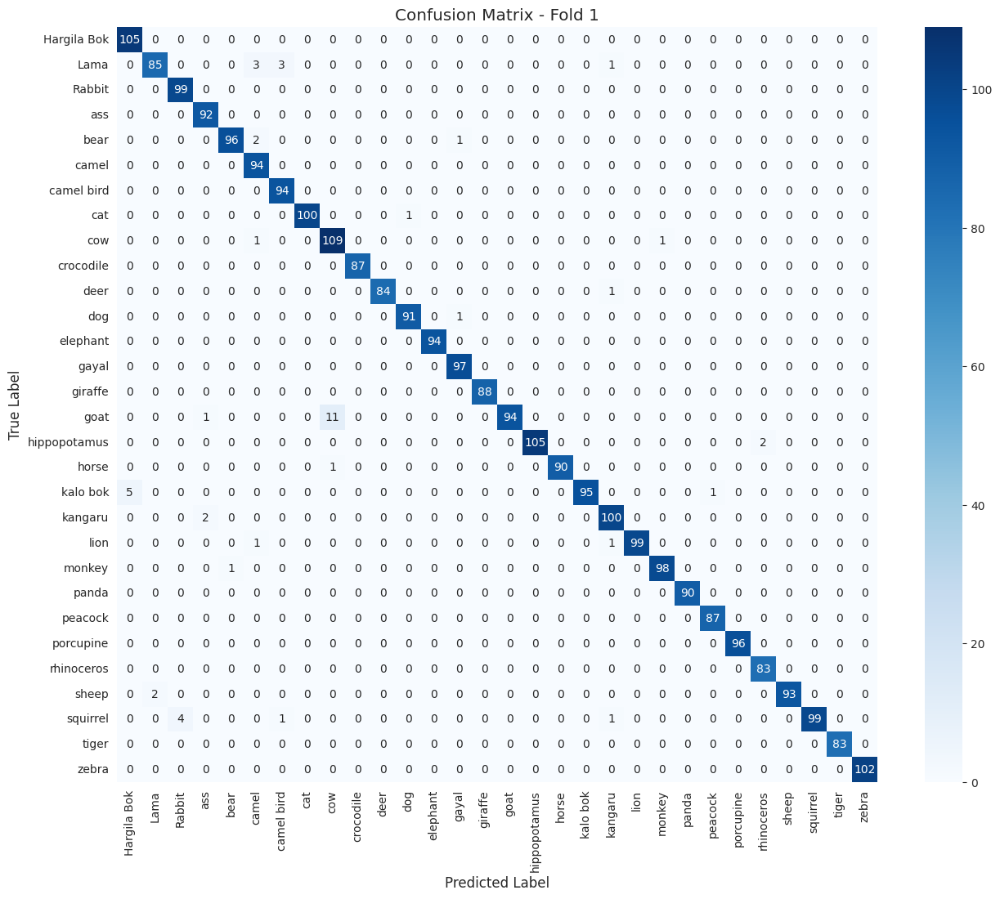

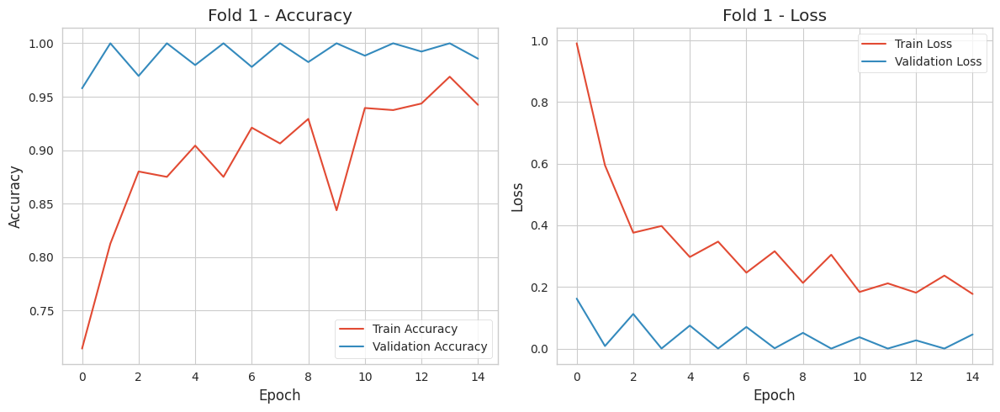


===== Fold 2 / 5 =====
Found 11510 validated image filenames belonging to 30 classes.
Found 2878 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 155s 409ms/step - accuracy: 0.5421 - loss: 1.6982 - val_accuracy: 0.9435 - val_loss: 0.1833
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 9s 27ms/step - accuracy: 0.9688 - loss: 0.1953

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9688 - loss: 0.1953 - val_accuracy: 1.0000 - val_loss: 0.0023
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 147s 401ms/step - accuracy: 0.8693 - loss: 0.4074 - val_accuracy: 0.9663 - val_loss: 0.1138
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 127us/step - accuracy: 1.0000 - loss: 0.1012 - val_accuracy: 1.0000 - val_loss: 0.0041
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 147s 401ms/step - accuracy: 0.9048 - loss: 0.3053 - val_accuracy: 0.9740 - val_loss: 0.0820
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 151us/step - accuracy: 0.9375 - loss: 0.1852 - val_accuracy: 1.0000 - val_loss: 0.0023
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 146s 399ms/step - accuracy: 0.9142 - loss: 0.2504 - val_accuracy: 0.9824 - val_loss: 0.0630
90/90 ━━━━━━━━━━━━━━━━━━━━ 6s 71ms/step - accuracy: 0.9349 - loss: 0.1912
90/90 ━━━━━━━━━━━━━━━━━━━━ 9s 83ms/step

Classification Report:
              precision    recall  f1-score   support

 Hargila Bok       0.91      0.92 

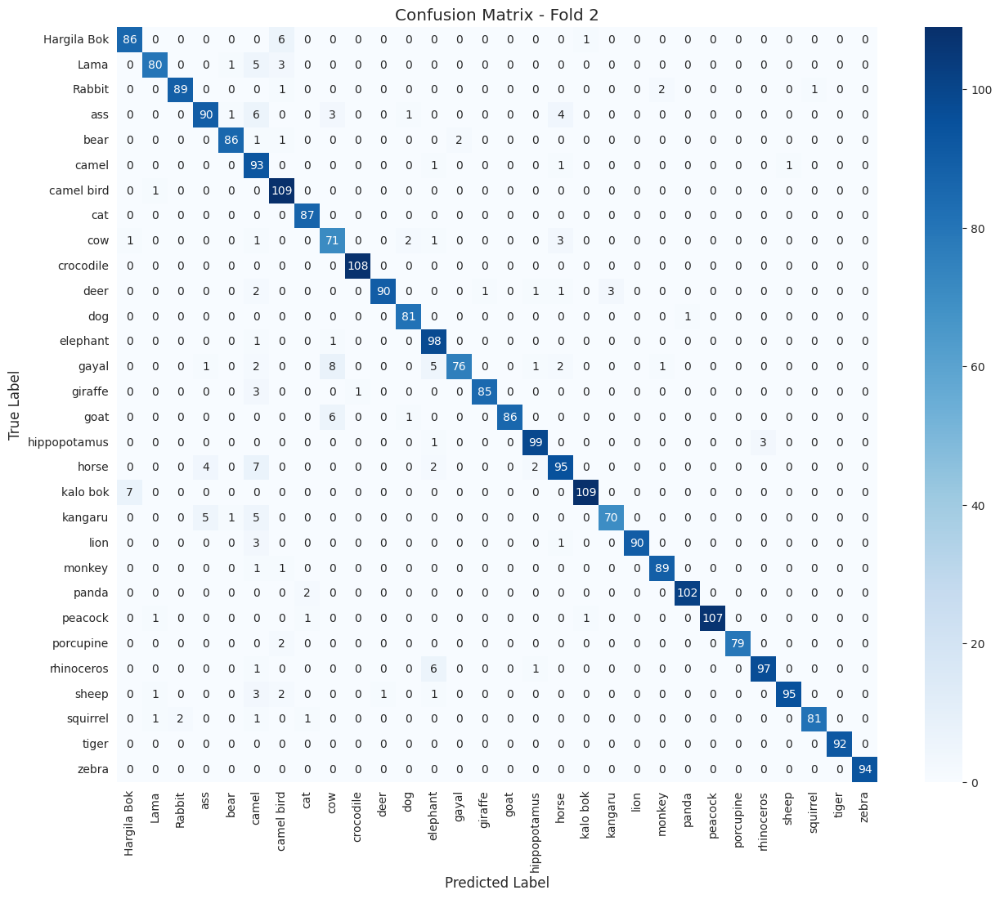

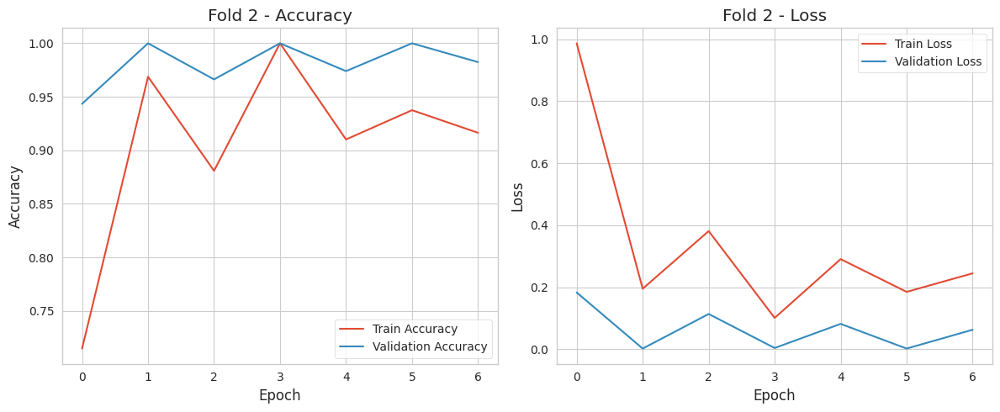


===== Fold 3 / 5 =====
Found 11510 validated image filenames belonging to 30 classes.
Found 2878 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 156s 411ms/step - accuracy: 0.5575 - loss: 1.6329 - val_accuracy: 0.9505 - val_loss: 0.1792
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - accuracy: 0.7500 - loss: 0.5173

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7500 - loss: 0.5173 - val_accuracy: 1.0000 - val_loss: 0.0017
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 146s 399ms/step - accuracy: 0.8773 - loss: 0.4011 - val_accuracy: 0.9716 - val_loss: 0.0990
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 276us/step - accuracy: 0.9375 - loss: 0.1748 - val_accuracy: 1.0000 - val_loss: 3.0668e-04
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 148s 403ms/step - accuracy: 0.9044 - loss: 0.3005 - val_accuracy: 0.9821 - val_loss: 0.0669
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 270us/step - accuracy: 0.9062 - loss: 0.2354 - val_accuracy: 1.0000 - val_loss: 1.5286e-05
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 148s 405ms/step - accuracy: 0.9271 - loss: 0.2373 - val_accuracy: 0.9898 - val_loss: 0.0465
Epoch 8/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 125us/step - accuracy: 0.9062 - loss: 0.3825 - val_accuracy: 1.0000 - val_loss: 8.5252e-05
Epoch 9/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 147s 403ms/step - accuracy: 0.9285 - loss: 0.

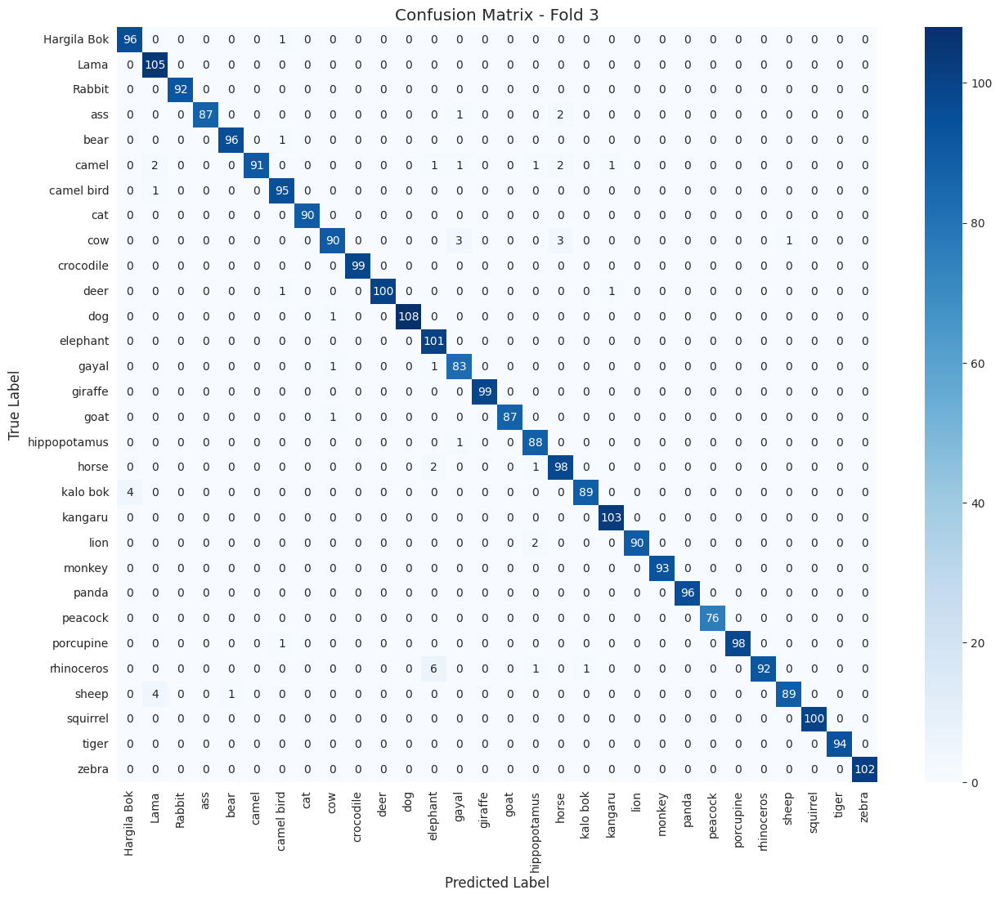

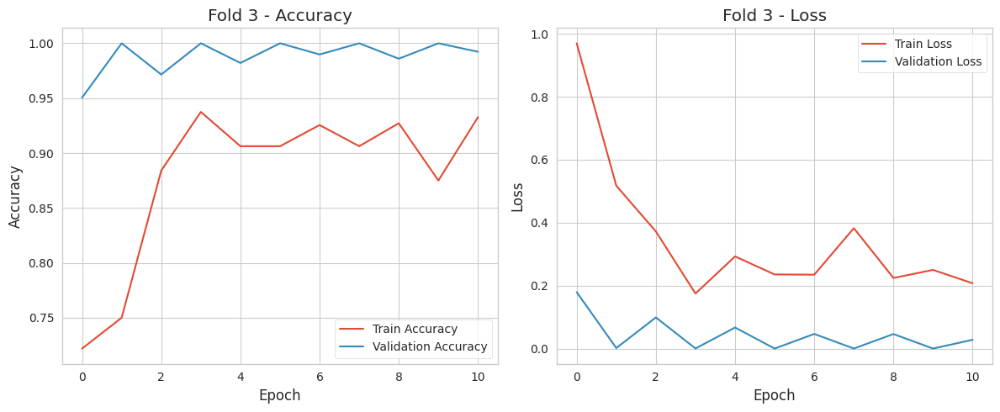


===== Fold 4 / 5 =====
Found 11511 validated image filenames belonging to 30 classes.
Found 2877 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 157s 413ms/step - accuracy: 0.5274 - loss: 1.7614 - val_accuracy: 0.9494 - val_loss: 0.1927
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step - accuracy: 0.7188 - loss: 1.0107

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.7188 - loss: 1.0107 - val_accuracy: 1.0000 - val_loss: 0.0181
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 146s 399ms/step - accuracy: 0.8705 - loss: 0.4257 - val_accuracy: 0.9656 - val_loss: 0.1107
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 130us/step - accuracy: 0.9375 - loss: 0.3339 - val_accuracy: 1.0000 - val_loss: 0.0192
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 145s 398ms/step - accuracy: 0.9060 - loss: 0.2966 - val_accuracy: 0.9765 - val_loss: 0.0738
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 256us/step - accuracy: 0.8750 - loss: 0.3728 - val_accuracy: 1.0000 - val_loss: 0.0099
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 147s 401ms/step - accuracy: 0.9179 - loss: 0.2479 - val_accuracy: 0.9786 - val_loss: 0.0666
Epoch 8/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 259us/step - accuracy: 0.9375 - loss: 0.2481 - val_accuracy: 1.0000 - val_loss: 0.0031
Epoch 9/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 146s 398ms/step - accuracy: 0.9277 - loss: 0.2235 - val_a

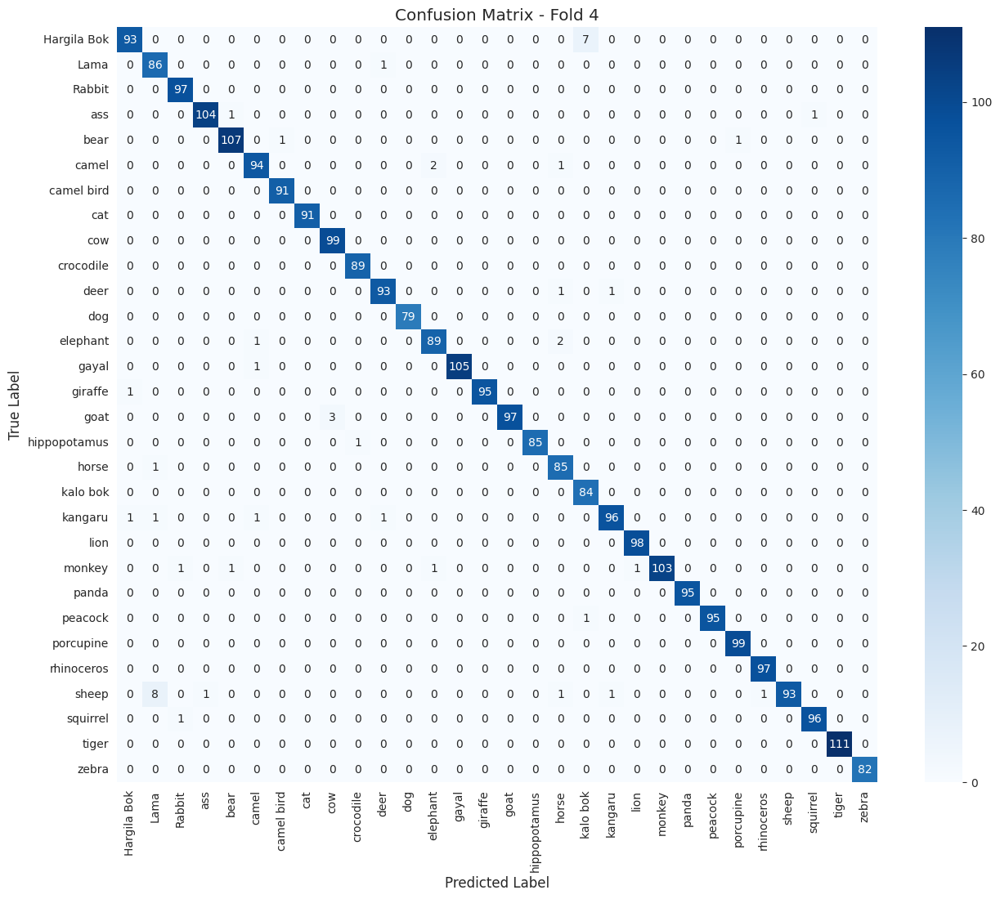

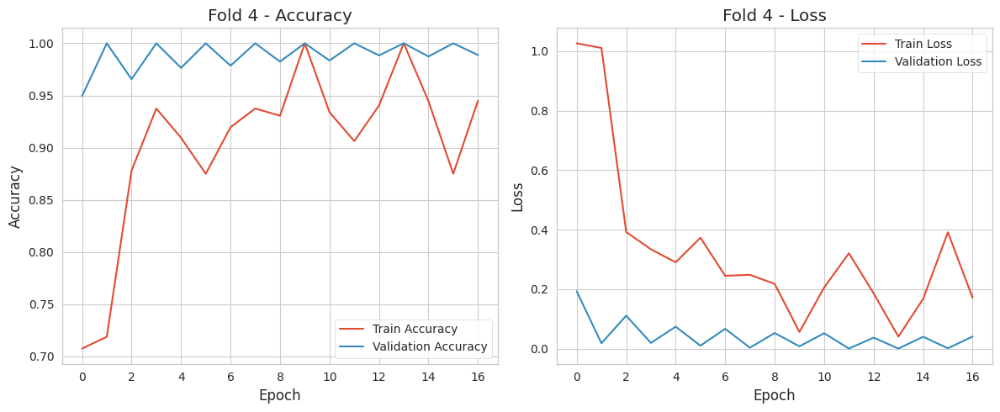


===== Fold 5 / 5 =====
Found 11511 validated image filenames belonging to 30 classes.
Found 2877 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 155s 407ms/step - accuracy: 0.5363 - loss: 1.7467 - val_accuracy: 0.9554 - val_loss: 0.1677
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - accuracy: 0.9062 - loss: 0.2451

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9062 - loss: 0.2451 - val_accuracy: 1.0000 - val_loss: 0.0059
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 146s 398ms/step - accuracy: 0.8721 - loss: 0.4127 - val_accuracy: 0.9758 - val_loss: 0.0900
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 279us/step - accuracy: 0.8750 - loss: 0.3458 - val_accuracy: 1.0000 - val_loss: 0.0026
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 146s 400ms/step - accuracy: 0.9054 - loss: 0.2973 - val_accuracy: 0.9775 - val_loss: 0.0746
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 276us/step - accuracy: 0.9062 - loss: 0.2760 - val_accuracy: 1.0000 - val_loss: 0.0012
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 146s 399ms/step - accuracy: 0.9167 - loss: 0.2587 - val_accuracy: 0.9877 - val_loss: 0.0442
Epoch 8/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 125us/step - accuracy: 0.9062 - loss: 0.2398 - val_accuracy: 1.0000 - val_loss: 0.0023
Epoch 9/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 144s 394ms/step - accuracy: 0.9295 - loss: 0.2210 - val_a

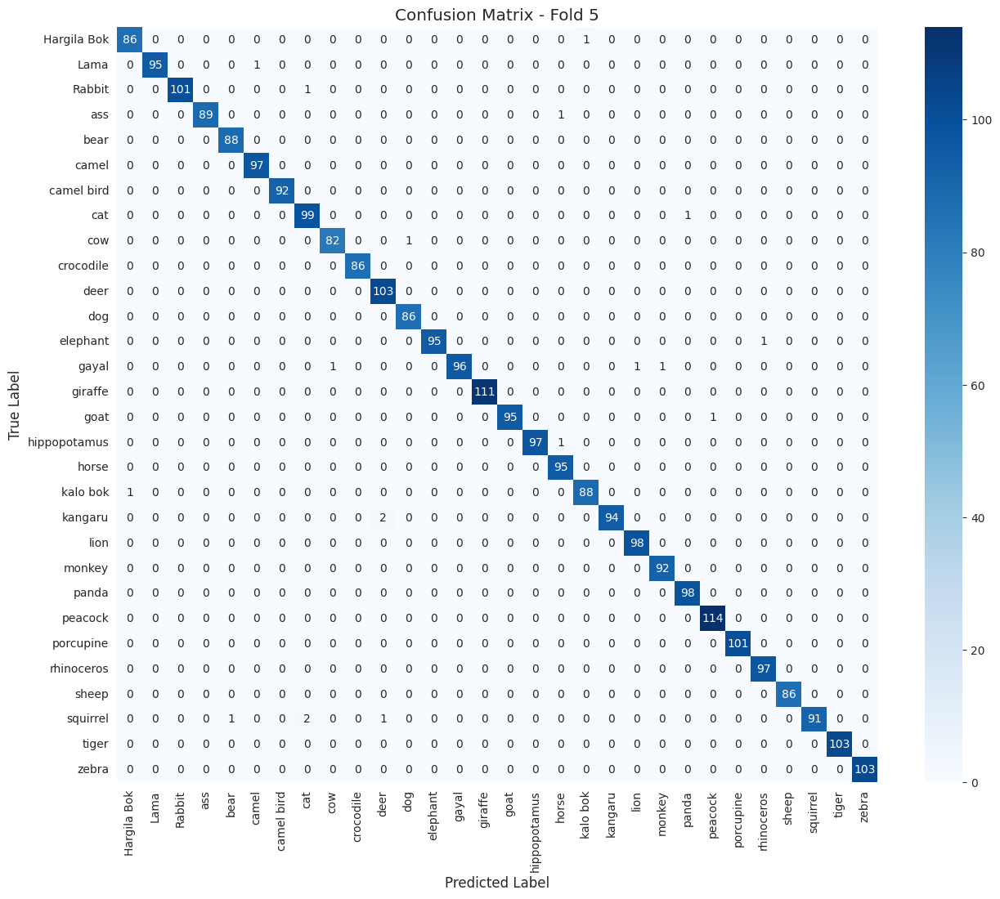

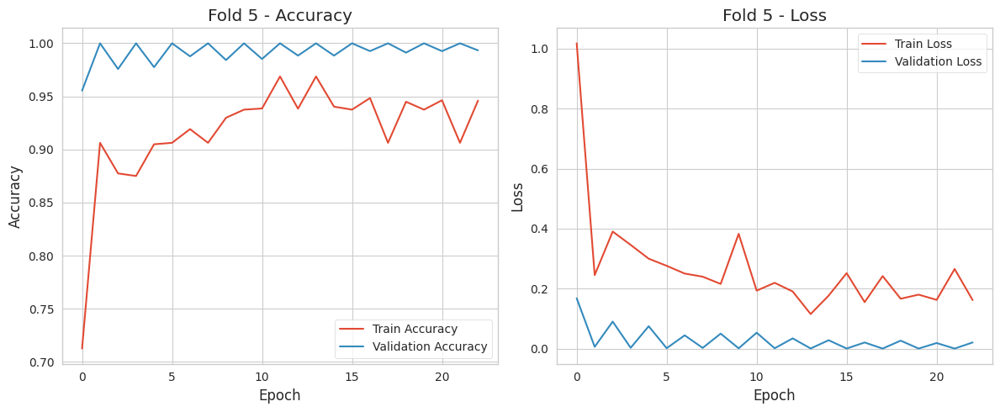


==== Cross-validation results ====
   fold  val_loss   val_acc
0     1  0.049360  0.982974
1     2  0.185126  0.943016
2     3  0.066965  0.982279
3     4  0.051619  0.982968
4     5  0.019691  0.993396

Average Validation Accuracy across 5 folds: 0.9769


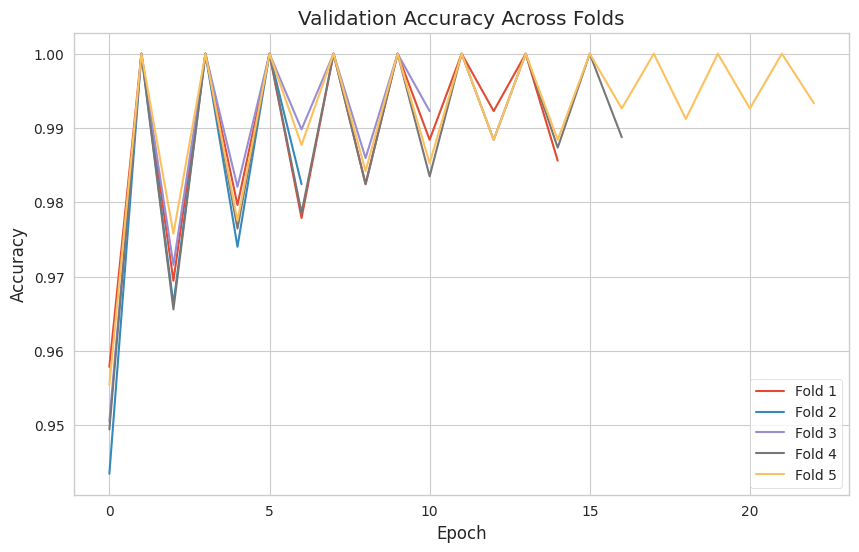

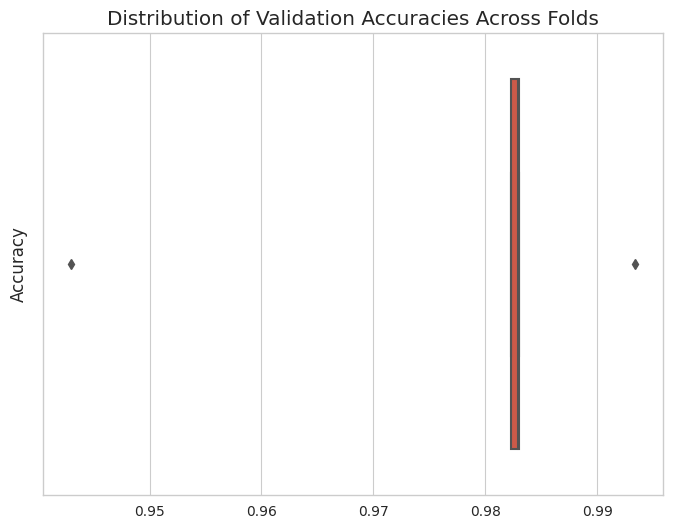

In [8]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNet
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.model_selection import KFold
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import os

# PARAMETERS
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 32
EPOCHS = 50
K_FOLDS = 5
DATA_DIR = '/kaggle/working/Animal Classification/train_augmented'

# Load filenames and labels
file_paths = []
labels = []
class_indices = {}

for i, class_name in enumerate(sorted(os.listdir(DATA_DIR))):
    class_dir = os.path.join(DATA_DIR, class_name)
    if os.path.isdir(class_dir):
        class_indices[class_name] = i
        for fname in os.listdir(class_dir):
            if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
                file_paths.append(os.path.join(class_dir, fname))
                labels.append(i)

file_paths = np.array(file_paths)
labels = np.array(labels)

print(f"Total samples: {len(file_paths)}")
print(f"Number of classes: {len(class_indices)}")
inv_class_indices = {v: k for k, v in class_indices.items()}

# Initialize KFold
kf = KFold(n_splits=K_FOLDS, shuffle=True, random_state=42)
fold_no = 1
all_scores = []
all_histories = []

for train_index, val_index in kf.split(file_paths):
    print(f"\n===== Fold {fold_no} / {K_FOLDS} =====")

    # Split data
    train_files, val_files = file_paths[train_index], file_paths[val_index]
    train_labels, val_labels = labels[train_index], labels[val_index]

    # Create DataFrames
    train_df = pd.DataFrame({'filename': train_files, 'class': train_labels})
    val_df = pd.DataFrame({'filename': val_files, 'class': val_labels})

    # Map numeric class index to class name
    train_df['class'] = train_df['class'].map(inv_class_indices)
    val_df['class'] = val_df['class'].map(inv_class_indices)

    # Data generators
    train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
        rescale=1./255,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        brightness_range=[0.8, 1.2]
    )
    val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

    train_generator = train_datagen.flow_from_dataframe(
        dataframe=train_df,
        x_col='filename',
        y_col='class',
        target_size=IMAGE_SIZE,
        class_mode='sparse',
        batch_size=BATCH_SIZE,
        shuffle=True
    )

    val_generator = val_datagen.flow_from_dataframe(
        dataframe=val_df,
        x_col='filename',
        y_col='class',
        target_size=IMAGE_SIZE,
        class_mode='sparse',
        batch_size=BATCH_SIZE,
        shuffle=False
    )

    # Build MobileNet model
    base_model = MobileNet(
        weights='imagenet',
        include_top=False,
        input_shape=(224, 224, 3),
        alpha=1.0
    )
    base_model.trainable = False

    model = tf.keras.Sequential([
        base_model,
        layers.GlobalAveragePooling2D(),
        layers.Dense(512, activation='relu'),
        layers.Dropout(0.5),
        layers.Dense(len(class_indices), activation='softmax')
    ])

    model.compile(
        optimizer=Adam(learning_rate=0.001),
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy']
    )

    callbacks = [
        EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
        ModelCheckpoint(f'best_model_fold_{fold_no}.keras', save_best_only=True, monitor='val_accuracy')
    ]

    # Train model
    history = model.fit(
        train_generator,
        steps_per_epoch=train_generator.samples // train_generator.batch_size,
        validation_data=val_generator,
        validation_steps=val_generator.samples // val_generator.batch_size,
        epochs=EPOCHS,
        callbacks=callbacks
    )
    all_histories.append(history.history)

    # Evaluate
    val_loss, val_acc = model.evaluate(val_generator)
    all_scores.append({'fold': fold_no, 'val_loss': val_loss, 'val_acc': val_acc})

    # Generate predictions
    y_true = val_generator.classes
    y_pred = model.predict(val_generator)
    y_pred_classes = np.argmax(y_pred, axis=1)

    # Classification Report
    print("\nClassification Report:")
    print(classification_report(y_true, y_pred_classes, target_names=list(class_indices.keys())))

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred_classes)
    plt.figure(figsize=(15, 12))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=list(class_indices.keys()),
                yticklabels=list(class_indices.keys()))
    plt.title(f'Confusion Matrix - Fold {fold_no}')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.xticks(rotation=90)
    plt.show()

    # Training History Plots
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title(f'Fold {fold_no} - Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f'Fold {fold_no} - Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.tight_layout()
    plt.show()

    fold_no += 1

# Cross-validation summary
print("\n==== Cross-validation results ====")
results_df = pd.DataFrame(all_scores)
print(results_df)

# Average metrics
mean_val_acc = results_df['val_acc'].mean()
print(f"\nAverage Validation Accuracy across {K_FOLDS} folds: {mean_val_acc:.4f}")

# Plot all folds' validation accuracy
plt.figure(figsize=(10, 6))
for i, history in enumerate(all_histories):
    plt.plot(history['val_accuracy'], label=f'Fold {i+1}')
plt.title('Validation Accuracy Across Folds')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Boxplot of final fold accuracies
plt.figure(figsize=(8, 6))
sns.boxplot(x=[s['val_acc'] for s in all_scores])
plt.title('Distribution of Validation Accuracies Across Folds')
plt.ylabel('Accuracy')
plt.show()

##  **MobileNetV3**

In [74]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV3Small
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, TerminateOnNaN
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import cv2

# Configuration
IMG_SIZE = (224, 224)
BATCH_SIZE = 16
EPOCHS = 50
SEED = 42

# Set Kaggle dataset paths (update these with your actual dataset paths)
INPUT_DIR = "/kaggle/input/animal-classification-dataset"
train_dir = '/kaggle/working/Animal Classification/train_augmented'
val_dir = os.path.join(INPUT_DIR, "Animal Classification/validation")
test_dir = os.path.join(INPUT_DIR, "Animal Classification/test")

# Check if directories exist
print("Available directories:")
print("Train:", os.path.exists(train_dir), train_dir)
print("Validation:", os.path.exists(val_dir), val_dir)
print("Test:", os.path.exists(test_dir), test_dir)

Available directories:
Train: True /kaggle/working/Animal Classification/train_augmented
Validation: True /kaggle/input/animal-classification-dataset/Animal Classification/validation
Test: True /kaggle/input/animal-classification-dataset/Animal Classification/test


In [75]:
# Data Augmentation
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=10,
    width_shift_range=0.05,
    height_shift_range=0.05,
    horizontal_flip=True,
    brightness_range=[0.95, 1.05],
    zoom_range=0.05,
    fill_mode='constant',
    cval=0,
    validation_split=0.05
)

val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

# Create data generators
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=True,
    seed=SEED,
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False,
    seed=SEED,
    # subset='validation'
)

test_generator = val_datagen.flow_from_directory(
    test_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

Found 13677 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.


In [76]:
# Model Architecture
def build_model():
    base_model = MobileNetV3Small(
        input_shape=(*IMG_SIZE, 3),
        include_top=False,
        weights='imagenet',
        include_preprocessing=False,
        pooling='avg'
    )
    base_model.trainable = False

    inputs = tf.keras.Input(shape=(*IMG_SIZE, 3))
    x = tf.keras.applications.mobilenet_v3.preprocess_input(inputs)
    x = base_model(x)
    x = layers.Dense(256, activation='relu')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.2)(x)
    outputs = layers.Dense(train_generator.num_classes, activation='softmax')(x)
    
    model = tf.keras.Model(inputs, outputs)
    return model

model = build_model()

# Learning Rate Schedule
def lr_schedule(epoch):
    initial_lr = 0.0001
    decay_factor = 0.9
    return initial_lr * (decay_factor ** epoch)

# Callbacks
callbacks = [
    TerminateOnNaN(),
    EarlyStopping(
        monitor='val_accuracy',
        patience=8,
        mode='max',
        restore_best_weights=True,
        min_delta=0.001
    ),
    ModelCheckpoint(
        'best_model.keras',
        monitor='val_accuracy',
        save_best_only=True,
        mode='max'
    ),
    tf.keras.callbacks.LearningRateScheduler(lr_schedule),
    tf.keras.callbacks.CSVLogger('training_log.csv')
]

# Model Compilation
model.compile(
    optimizer=Adam(learning_rate=0.0001),
    loss='categorical_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall'),
        tf.keras.metrics.AUC(name='auc')
    ]
)

# Training
history = model.fit(
    train_generator,
    steps_per_epoch=max(1, train_generator.samples // BATCH_SIZE),
    validation_data=validation_generator,
    validation_steps=max(1, validation_generator.samples // BATCH_SIZE),
    epochs=EPOCHS,
    callbacks=callbacks,
    verbose=1
)

Epoch 1/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 230s 246ms/step - accuracy: 0.3446 - auc: 0.8033 - loss: 2.5784 - precision: 0.6768 - recall: 0.1627 - val_accuracy: 0.8192 - val_auc: 0.9886 - val_loss: 0.6738 - val_precision: 0.9288 - val_recall: 0.6987 - learning_rate: 1.0000e-04
Epoch 2/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 0s 66us/step - accuracy: 0.8750 - auc: 0.9915 - loss: 0.7215 - precision: 0.9167 - recall: 0.6875 - learning_rate: 9.0000e-05
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_accuracy` which is not available. Available metrics are: accuracy,auc,loss,precision,recall
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)


854/854 ━━━━━━━━━━━━━━━━━━━━ 198s 230ms/step - accuracy: 0.7949 - auc: 0.9895 - loss: 0.7515 - precision: 0.9250 - recall: 0.6483 - val_accuracy: 0.8705 - val_auc: 0.9921 - val_loss: 0.4577 - val_precision: 0.9488 - val_recall: 0.8281 - learning_rate: 8.1000e-05
Epoch 4/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 0s 48us/step - accuracy: 0.8125 - auc: 0.9976 - loss: 0.4948 - precision: 1.0000 - recall: 0.7500 - learning_rate: 7.2900e-05
Epoch 5/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 191s 221ms/step - accuracy: 0.8592 - auc: 0.9949 - loss: 0.5170 - precision: 0.9460 - recall: 0.7680 - val_accuracy: 0.8951 - val_auc: 0.9951 - val_loss: 0.3876 - val_precision: 0.9475 - val_recall: 0.8460 - learning_rate: 6.5610e-05
Epoch 6/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 0s 46us/step - accuracy: 0.9375 - auc: 0.9989 - loss: 0.4018 - precision: 1.0000 - recall: 0.7500 - learning_rate: 5.9049e-05
Epoch 7/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 197s 229ms/step - accuracy: 0.8905 - auc: 0.9965 - loss: 0.4198 - precision: 0.9552 - recal


Training history:


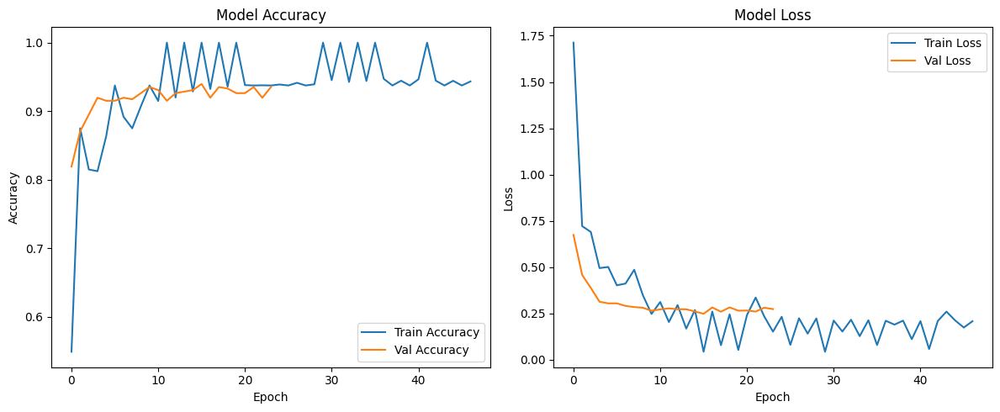

In [77]:
# Visualization
def plot_training_history(history):
    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Val Accuracy')
    plt.title('Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Val Loss')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()
    
    plt.tight_layout()
    plt.show()




Training history:


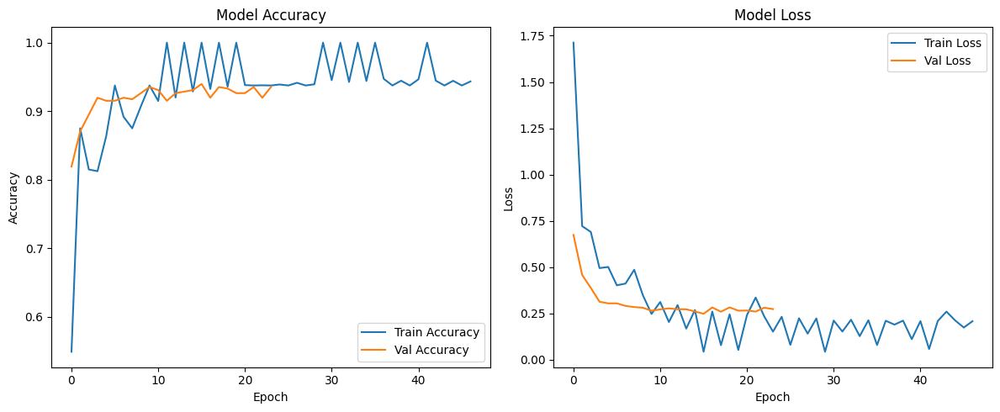

In [79]:
print("\nTraining history:")
plot_training_history(history)


In [82]:
# Evaluation
def evaluate_model(model, generator, name):
    generator.reset()
    y_true = generator.classes
    y_pred = model.predict(generator, verbose=1)
    y_pred_classes = np.argmax(y_pred, axis=1)
    
    print(f"\n{name} Evaluation:")
    print(classification_report(
        y_true, y_pred_classes,
        target_names=list(generator.class_indices.keys()),
        digits=4
    ))
    
    plt.figure(figsize=(15, 12))
    cm = confusion_matrix(y_true, y_pred_classes)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=generator.class_indices.keys(),
                yticklabels=generator.class_indices.keys())
    plt.title(f'{name} Confusion Matrix')
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.savefig(f'{name.lower()}_confusion.png', bbox_inches='tight')
    plt.show()



28/28 ━━━━━━━━━━━━━━━━━━━━ 6s 230ms/step

Validation Evaluation:
              precision    recall  f1-score   support

 Hargila Bok     0.9375    1.0000    0.9677        15
        Lama     0.8462    0.7333    0.7857        15
      Rabbit     0.9375    1.0000    0.9677        15
         ass     0.9333    0.9333    0.9333        15
        bear     0.7778    0.9333    0.8485        15
       camel     0.8750    0.9333    0.9032        15
  camel bird     1.0000    0.9333    0.9655        15
         cat     1.0000    0.8000    0.8889        15
         cow     1.0000    0.7333    0.8462        15
   crocodile     1.0000    1.0000    1.0000        14
        deer     0.9375    1.0000    0.9677        15
         dog     0.9333    1.0000    0.9655        14
    elephant     1.0000    1.0000    1.0000        15
       gayal     0.8125    0.8667    0.8387        15
     giraffe     1.0000    0.9333    0.9655        15
        goat     0.9375    1.0000    0.9677        15
hippopotamus    

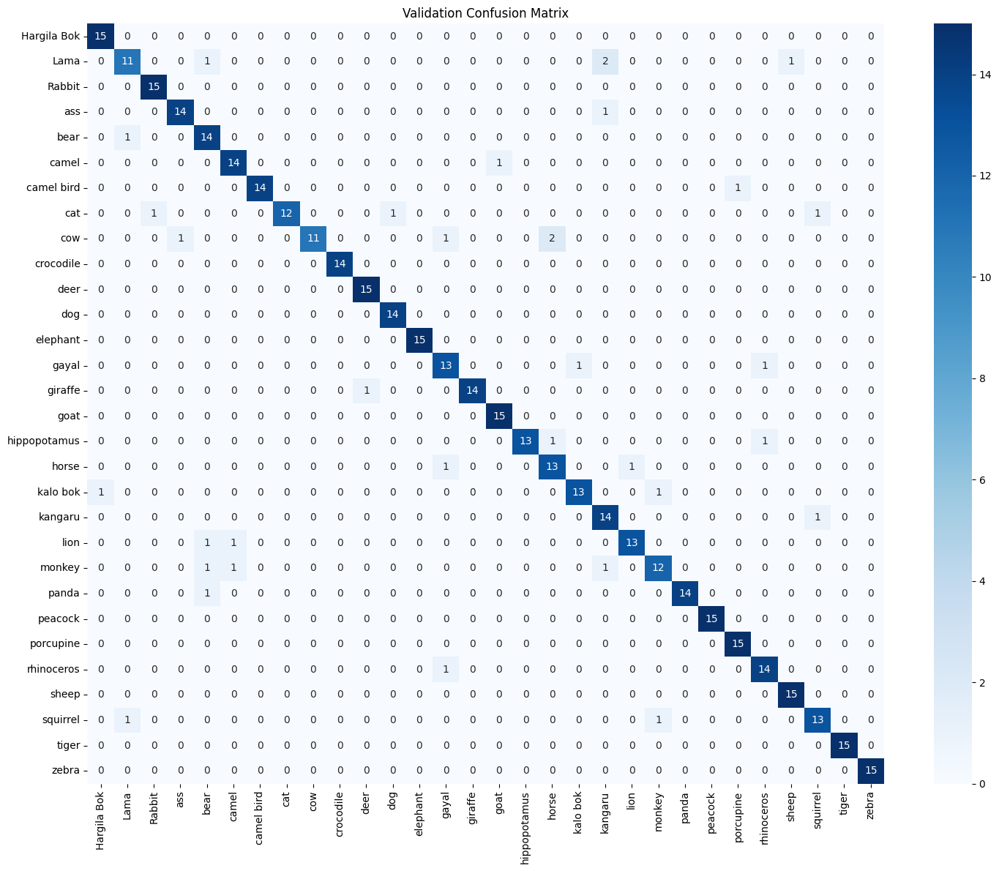

In [83]:
evaluate_model(model, validation_generator, "Validation")
# evaluate_model(model, test_generator, "Test")


30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step

Test Evaluation:
              precision    recall  f1-score   support

 Hargila Bok     1.0000    1.0000    1.0000        16
        Lama     0.9286    0.8667    0.8966        15
      Rabbit     0.9412    1.0000    0.9697        16
         ass     0.8889    1.0000    0.9412        16
        bear     0.9412    1.0000    0.9697        16
       camel     0.8421    1.0000    0.9143        16
  camel bird     0.9412    1.0000    0.9697        16
         cat     1.0000    1.0000    1.0000        15
         cow     0.8571    0.8000    0.8276        15
   crocodile     1.0000    1.0000    1.0000        15
        deer     0.9375    1.0000    0.9677        15
         dog     0.8667    0.9286    0.8966        14
    elephant     0.9375    1.0000    0.9677        15
       gayal     0.9375    0.9375    0.9375        16
     giraffe     1.0000    0.9375    0.9677        16
        goat     1.0000    0.7333    0.8462        15
hippopotamus     1.0000

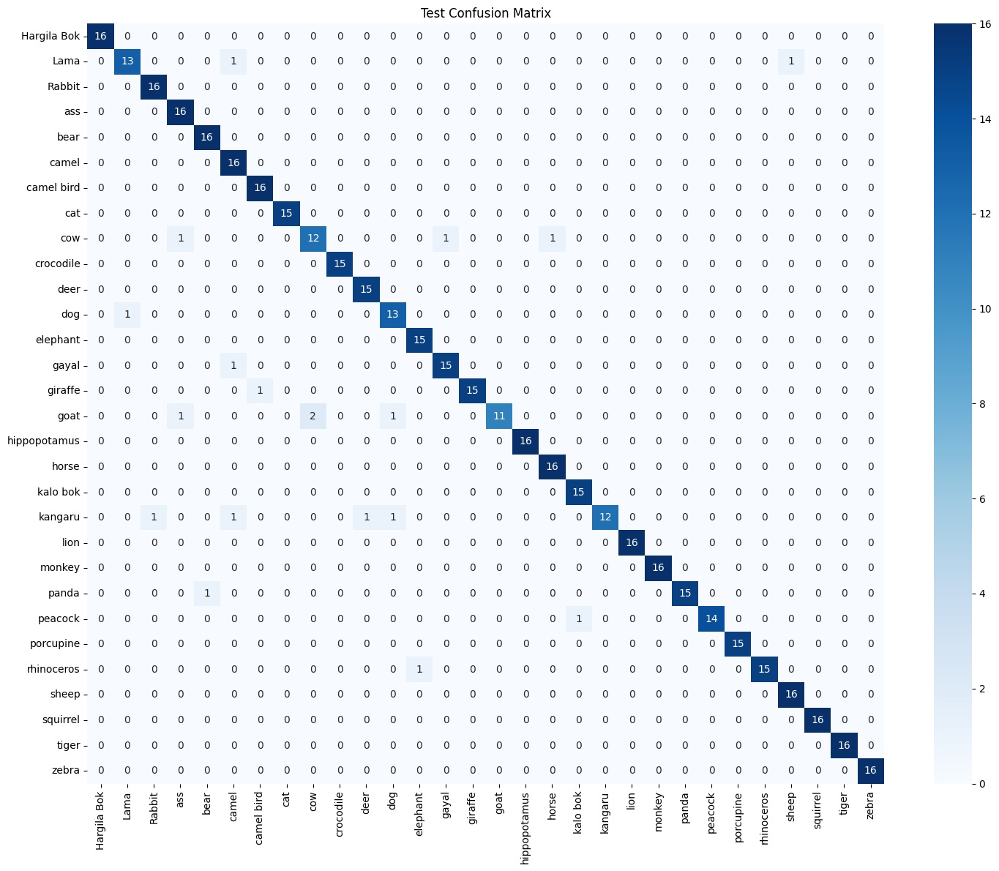

In [85]:
evaluate_model(model, test_generator, "Test")


### **K-Cross Validation**

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV3Small
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from sklearn.model_selection import KFold
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import os

# Configuration
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
EPOCHS = 50
K_FOLDS = 5
SEED = 42
DATA_DIR = '/kaggle/working/Animal Classification/train_augmented'

# Data augmentation
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    brightness_range=[0.8, 1.2],
    zoom_range=0.2,
    fill_mode='nearest'
)

val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

# Load filenames and labels
file_paths = []
labels = []
class_indices = {}

for i, class_name in enumerate(sorted(os.listdir(DATA_DIR))):
    class_dir = os.path.join(DATA_DIR, class_name)
    if os.path.isdir(class_dir):
        class_indices[class_name] = i
        for fname in os.listdir(class_dir):
            if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
                file_paths.append(os.path.join(class_dir, fname))
                labels.append(i)

file_paths = np.array(file_paths)
labels = np.array(labels)

print(f"Total samples: {len(file_paths)}")
print(f"Number of classes: {len(class_indices)}")

def build_model():
    base_model = MobileNetV3Small(
        input_shape=(*IMG_SIZE, 3),
        include_top=False,
        weights='imagenet',
        include_preprocessing=True,
        pooling='avg'
    )
    base_model.trainable = False

    model = models.Sequential([
        base_model,
        layers.Dense(1024, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.5),
        layers.Dense(len(class_indices), activation='softmax')
    ])
    
    return model

def run_kfold_cross_validation(file_paths, labels, class_indices, k_folds=5):
    kfold = KFold(n_splits=k_folds, shuffle=True, random_state=SEED)
    fold_no = 1
    results = []
    
    # Create inverse mapping for class indices to names
    inv_class_indices = {v: k for k, v in class_indices.items()}
    
    for train_idx, val_idx in kfold.split(file_paths):
        print(f"\n{'='*40}")
        print(f"Training Fold {fold_no}/{k_folds}")
        print(f"{'='*40}")
        
        # Create DataFrames with string class labels
        train_df = pd.DataFrame({
            'filename': file_paths[train_idx],
            'class': [inv_class_indices[label] for label in labels[train_idx]]
        })
        val_df = pd.DataFrame({
            'filename': file_paths[val_idx],
            'class': [inv_class_indices[label] for label in labels[val_idx]]
        })
        
        # Create generators
        train_generator = train_datagen.flow_from_dataframe(
            dataframe=train_df,
            x_col='filename',
            y_col='class',
            target_size=IMG_SIZE,
            class_mode='categorical',
            batch_size=BATCH_SIZE,
            shuffle=True,
            seed=SEED
        )
        
        val_generator = val_datagen.flow_from_dataframe(
            dataframe=val_df,
            x_col='filename',
            y_col='class',
            target_size=IMG_SIZE,
            class_mode='categorical',
            batch_size=BATCH_SIZE,
            shuffle=False
        )
        
        # Build and compile model
        model = build_model()
        model.compile(
            optimizer=Adam(learning_rate=0.0001),
            loss='categorical_crossentropy',
            metrics=['accuracy']
        )
        
        # Train model
        history = model.fit(
            train_generator,
            steps_per_epoch=len(train_generator),
            validation_data=val_generator,
            validation_steps=len(val_generator),
            epochs=EPOCHS,
            callbacks=[
                EarlyStopping(monitor='val_accuracy', patience=5, restore_best_weights=True),
                ModelCheckpoint(f'best_model_fold_{fold_no}.keras', 
                              monitor='val_accuracy',
                              save_best_only=True)
            ],
            verbose=1
        )
        
        # Evaluate
        val_loss, val_acc = model.evaluate(val_generator)
        results.append({
            'fold': fold_no,
            'val_accuracy': val_acc,
            'val_loss': val_loss,
            'history': history.history
        })
        
        # Generate classification report and confusion matrix
        val_generator.reset()
        y_pred = model.predict(val_generator)
        y_pred_classes = np.argmax(y_pred, axis=1)
        y_true = val_generator.classes
        
        print("\nClassification Report:")
        print(classification_report(y_true, y_pred_classes, 
                                  target_names=list(class_indices.keys())))
        
        plt.figure(figsize=(15, 12))
        cm = confusion_matrix(y_true, y_pred_classes)
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                   xticklabels=list(class_indices.keys()),
                   yticklabels=list(class_indices.keys()))
        plt.title(f'Confusion Matrix - Fold {fold_no}')
        plt.ylabel('True Label')
        plt.xlabel('Predicted Label')
        plt.xticks(rotation=90)
        plt.show()
        
        fold_no += 1
    
    return results

# Run K-Fold Cross Validation
kfold_results = run_kfold_cross_validation(file_paths, labels, class_indices)

# Print final results
print("\nFinal K-Fold Cross Validation Results:")
for result in kfold_results:
    print(f"Fold {result['fold']} - Val Accuracy: {result['val_accuracy']:.4f} - Val Loss: {result['val_loss']:.4f}")

mean_acc = np.mean([r['val_accuracy'] for r in kfold_results])
print(f"\nAverage Validation Accuracy: {mean_acc:.4f}")

# Plot training history for all folds
plt.figure(figsize=(12, 6))
for i, result in enumerate(kfold_results):
    plt.plot(result['history']['val_accuracy'], label=f'Fold {i+1}')
plt.title('Validation Accuracy Across Folds')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


Training Fold 1/5
Found 11512 validated image filenames belonging to 30 classes.
Found 2878 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


360/360 ━━━━━━━━━━━━━━━━━━━━ 195s 490ms/step - accuracy: 0.2408 - loss: 2.9598 - val_accuracy: 0.7717 - val_loss: 0.9194
Epoch 2/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 106us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_accuracy` which is not available. Available metrics are: accuracy,loss
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)


360/360 ━━━━━━━━━━━━━━━━━━━━ 159s 435ms/step - accuracy: 0.7266 - loss: 1.0170 - val_accuracy: 0.8631 - val_loss: 0.5319
Epoch 4/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 56us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 5/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 161s 439ms/step - accuracy: 0.8294 - loss: 0.6418 - val_accuracy: 0.9048 - val_loss: 0.3743
Epoch 6/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 58us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 7/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 154s 419ms/step - accuracy: 0.8777 - loss: 0.4712 - val_accuracy: 0.9229 - val_loss: 0.3020
Epoch 8/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 101us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 9/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 159s 433ms/step - accuracy: 0.9007 - loss: 0.3903 - val_accuracy: 0.9371 - val_loss: 0.2461
Epoch 10/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 58us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 11/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 161s 440ms/step - accuracy: 0.9231 - loss: 0.3111 - val_accu

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


360/360 ━━━━━━━━━━━━━━━━━━━━ 189s 474ms/step - accuracy: 0.2341 - loss: 3.0739 - val_accuracy: 0.7488 - val_loss: 0.9701
Epoch 2/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 163us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_accuracy` which is not available. Available metrics are: accuracy,loss
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)


360/360 ━━━━━━━━━━━━━━━━━━━━ 162s 440ms/step - accuracy: 0.7351 - loss: 0.9953 - val_accuracy: 0.8544 - val_loss: 0.5427
Epoch 4/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 62us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 5/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 160s 436ms/step - accuracy: 0.8323 - loss: 0.6441 - val_accuracy: 0.8975 - val_loss: 0.3797
Epoch 6/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 62us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 7/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 153s 416ms/step - accuracy: 0.8681 - loss: 0.4868 - val_accuracy: 0.9218 - val_loss: 0.3000
Epoch 8/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 65us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 9/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 161s 439ms/step - accuracy: 0.8894 - loss: 0.4094 - val_accuracy: 0.9340 - val_loss: 0.2483
Epoch 10/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 58us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 11/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 159s 432ms/step - accuracy: 0.9136 - loss: 0.3335 - val_accur

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


360/360 ━━━━━━━━━━━━━━━━━━━━ 186s 466ms/step - accuracy: 0.2530 - loss: 2.9785 - val_accuracy: 0.7651 - val_loss: 0.9528
Epoch 2/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 104us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_accuracy` which is not available. Available metrics are: accuracy,loss
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)


360/360 ━━━━━━━━━━━━━━━━━━━━ 158s 430ms/step - accuracy: 0.7402 - loss: 0.9974 - val_accuracy: 0.8534 - val_loss: 0.5512
Epoch 4/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 88us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 5/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 158s 430ms/step - accuracy: 0.8301 - loss: 0.6570 - val_accuracy: 0.8912 - val_loss: 0.4022
Epoch 6/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 58us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 7/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 158s 432ms/step - accuracy: 0.8705 - loss: 0.4929 - val_accuracy: 0.9079 - val_loss: 0.3260
Epoch 8/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 79us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 9/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 154s 420ms/step - accuracy: 0.8934 - loss: 0.3979 - val_accuracy: 0.9298 - val_loss: 0.2669
Epoch 10/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 74us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 11/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 156s 425ms/step - accuracy: 0.9178 - loss: 0.3164 - val_accur

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


360/360 ━━━━━━━━━━━━━━━━━━━━ 187s 473ms/step - accuracy: 0.2475 - loss: 2.9439 - val_accuracy: 0.7592 - val_loss: 0.9553
Epoch 2/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 99us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_accuracy` which is not available. Available metrics are: accuracy,loss
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)


360/360 ━━━━━━━━━━━━━━━━━━━━ 159s 434ms/step - accuracy: 0.7314 - loss: 1.0079 - val_accuracy: 0.8610 - val_loss: 0.5546
Epoch 4/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 61us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 5/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 159s 435ms/step - accuracy: 0.8330 - loss: 0.6459 - val_accuracy: 0.8958 - val_loss: 0.4056
Epoch 6/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 57us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 7/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 160s 435ms/step - accuracy: 0.8717 - loss: 0.4893 - val_accuracy: 0.9135 - val_loss: 0.3284
Epoch 8/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 71us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 9/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 152s 415ms/step - accuracy: 0.9001 - loss: 0.3960 - val_accuracy: 0.9298 - val_loss: 0.2631
Epoch 10/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 55us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 11/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 160s 437ms/step - accuracy: 0.9083 - loss: 0.3446 - val_accur

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


360/360 ━━━━━━━━━━━━━━━━━━━━ 188s 470ms/step - accuracy: 0.2465 - loss: 2.9916 - val_accuracy: 0.7714 - val_loss: 0.9136
Epoch 2/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 95us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_accuracy` which is not available. Available metrics are: accuracy,loss
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)


360/360 ━━━━━━━━━━━━━━━━━━━━ 155s 422ms/step - accuracy: 0.7341 - loss: 1.0020 - val_accuracy: 0.8614 - val_loss: 0.5311
Epoch 4/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 56us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 5/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 159s 433ms/step - accuracy: 0.8191 - loss: 0.6670 - val_accuracy: 0.9003 - val_loss: 0.3807
Epoch 6/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 61us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 7/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 161s 437ms/step - accuracy: 0.8788 - loss: 0.4780 - val_accuracy: 0.9263 - val_loss: 0.3048
Epoch 8/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 81us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 9/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 160s 436ms/step - accuracy: 0.8908 - loss: 0.4112 - val_accuracy: 0.9441 - val_loss: 0.2436
Epoch 10/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 0s 60us/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 11/50
360/360 ━━━━━━━━━━━━━━━━━━━━ 157s 429ms/step - accuracy: 0.9156 - loss: 0.3332 - val_accur

In [4]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV3Small
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, TerminateOnNaN
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import cv2

# Configuration
IMG_SIZE = (224, 224)
BATCH_SIZE = 16
EPOCHS = 50
SEED = 42

# Set Kaggle dataset paths (update these with your actual dataset paths)
INPUT_DIR = "/kaggle/input/animal-classification-dataset"
train_dir = '/kaggle/working/Animal Classification/train_augmented'
val_dir = os.path.join(INPUT_DIR, "Animal Classification/validation")
test_dir = os.path.join(INPUT_DIR, "Animal Classification/test")

# Check if directories exist
print("Available directories:")
print("Train:", os.path.exists(train_dir), train_dir)
print("Validation:", os.path.exists(val_dir), val_dir)
print("Test:", os.path.exists(test_dir), test_dir)

Available directories:
Train: True /kaggle/working/Animal Classification/train_augmented
Validation: True /kaggle/input/animal-classification-dataset/Animal Classification/validation
Test: True /kaggle/input/animal-classification-dataset/Animal Classification/test


In [5]:
# Data Augmentation
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=10,
    width_shift_range=0.05,
    height_shift_range=0.05,
    horizontal_flip=True,
    brightness_range=[0.95, 1.05],
    zoom_range=0.05,
    fill_mode='constant',
    cval=0,
    validation_split=0.05
)

val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

# Create data generators
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=True,
    seed=SEED,
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False,
    seed=SEED,
    # subset='validation'
)

test_generator = val_datagen.flow_from_directory(
    test_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

Found 13674 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.


In [6]:
# Model Architecture
def build_model():
    base_model = MobileNetV3Small(
        input_shape=(*IMG_SIZE, 3),
        include_top=False,
        weights='imagenet',
        include_preprocessing=False,
        pooling='avg'
    )
    base_model.trainable = False

    inputs = tf.keras.Input(shape=(*IMG_SIZE, 3))
    x = tf.keras.applications.mobilenet_v3.preprocess_input(inputs)
    x = base_model(x)
    x = layers.Dense(256, activation='relu')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.2)(x)
    outputs = layers.Dense(train_generator.num_classes, activation='softmax')(x)
    
    model = tf.keras.Model(inputs, outputs)
    return model

model = build_model()

# Learning Rate Schedule
def lr_schedule(epoch):
    initial_lr = 0.0001
    decay_factor = 0.9
    return initial_lr * (decay_factor ** epoch)

# Callbacks
callbacks = [
    TerminateOnNaN(),
    EarlyStopping(
        monitor='val_accuracy',
        patience=8,
        mode='max',
        restore_best_weights=True,
        min_delta=0.001
    ),
    ModelCheckpoint(
        'best_model.keras',
        monitor='val_accuracy',
        save_best_only=True,
        mode='max'
    ),
    tf.keras.callbacks.LearningRateScheduler(lr_schedule),
    tf.keras.callbacks.CSVLogger('training_log.csv')
]

# Model Compilation
model.compile(
    optimizer=Adam(learning_rate=0.0001),
    loss='categorical_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall'),
        tf.keras.metrics.AUC(name='auc')
    ]
)

# Training
history = model.fit(
    train_generator,
    steps_per_epoch=max(1, train_generator.samples // BATCH_SIZE),
    validation_data=validation_generator,
    validation_steps=max(1, validation_generator.samples // BATCH_SIZE),
    epochs=EPOCHS,
    callbacks=callbacks,
    verbose=1
)

Epoch 1/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 215s 233ms/step - accuracy: 0.3425 - auc: 0.8073 - loss: 2.5483 - precision: 0.6906 - recall: 0.1585 - val_accuracy: 0.8415 - val_auc: 0.9874 - val_loss: 0.6471 - val_precision: 0.9456 - val_recall: 0.7366 - learning_rate: 1.0000e-04
Epoch 2/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 0s 66us/step - accuracy: 0.8125 - auc: 0.9977 - loss: 0.6923 - precision: 0.9091 - recall: 0.6250 - learning_rate: 9.0000e-05
Epoch 3/50


/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_accuracy` which is not available. Available metrics are: accuracy,auc,loss,precision,recall
  current = self.get_monitor_value(logs)


854/854 ━━━━━━━━━━━━━━━━━━━━ 186s 216ms/step - accuracy: 0.8002 - auc: 0.9886 - loss: 0.7576 - precision: 0.9293 - recall: 0.6524 - val_accuracy: 0.8728 - val_auc: 0.9916 - val_loss: 0.4700 - val_precision: 0.9386 - val_recall: 0.8192 - learning_rate: 8.1000e-05
Epoch 4/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 0s 43us/step - accuracy: 0.8125 - auc: 0.9593 - loss: 0.8006 - precision: 0.9167 - recall: 0.6875 - learning_rate: 7.2900e-05
Epoch 5/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 188s 218ms/step - accuracy: 0.8637 - auc: 0.9950 - loss: 0.5086 - precision: 0.9467 - recall: 0.7722 - val_accuracy: 0.8973 - val_auc: 0.9932 - val_loss: 0.3751 - val_precision: 0.9552 - val_recall: 0.8571 - learning_rate: 6.5610e-05
Epoch 6/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 0s 51us/step - accuracy: 1.0000 - auc: 1.0000 - loss: 0.2306 - precision: 1.0000 - recall: 0.8750 - learning_rate: 5.9049e-05
Epoch 7/50
854/854 ━━━━━━━━━━━━━━━━━━━━ 187s 218ms/step - accuracy: 0.8975 - auc: 0.9972 - loss: 0.3988 - precision: 0.9570 - recal

In [9]:
# Visualization
def plot_training_history(history):
    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Val Accuracy')
    plt.title('Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Val Loss')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()
    
    plt.tight_layout()
    plt.show()




Training history:


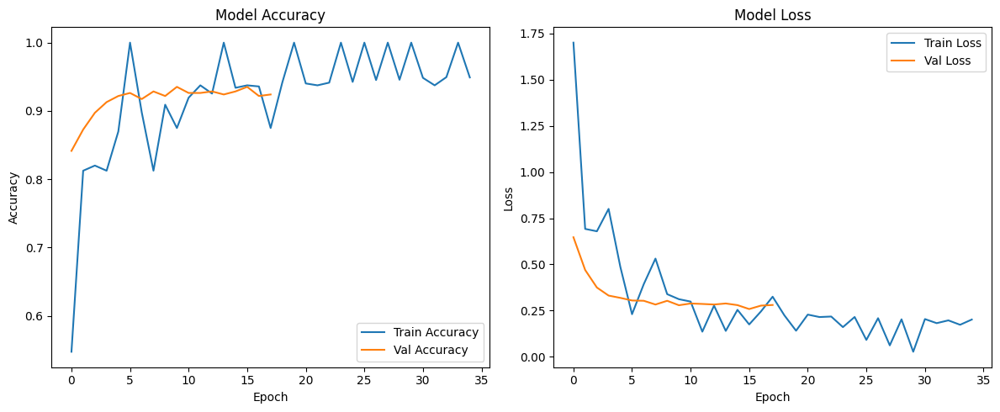

In [10]:
print("\nTraining history:")
plot_training_history(history)


In [11]:
# Evaluation
def evaluate_model(model, generator, name):
    generator.reset()
    y_true = generator.classes
    y_pred = model.predict(generator, verbose=1)
    y_pred_classes = np.argmax(y_pred, axis=1)
    
    print(f"\n{name} Evaluation:")
    print(classification_report(
        y_true, y_pred_classes,
        target_names=list(generator.class_indices.keys()),
        digits=4
    ))
    
    plt.figure(figsize=(15, 12))
    cm = confusion_matrix(y_true, y_pred_classes)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=generator.class_indices.keys(),
                yticklabels=generator.class_indices.keys())
    plt.title(f'{name} Confusion Matrix')
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.savefig(f'{name.lower()}_confusion.png', bbox_inches='tight')
    plt.show()



28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 217ms/step

Validation Evaluation:
              precision    recall  f1-score   support

 Hargila Bok     0.9333    0.9333    0.9333        15
        Lama     0.9333    0.9333    0.9333        15
      Rabbit     0.9375    1.0000    0.9677        15
         ass     1.0000    0.9333    0.9655        15
        bear     0.8125    0.8667    0.8387        15
       camel     0.8750    0.9333    0.9032        15
  camel bird     1.0000    0.9333    0.9655        15
         cat     0.8750    0.9333    0.9032        15
         cow     1.0000    0.6667    0.8000        15
   crocodile     0.9333    1.0000    0.9655        14
        deer     1.0000    1.0000    1.0000        15
         dog     1.0000    1.0000    1.0000        14
    elephant     1.0000    1.0000    1.0000        15
       gayal     0.7778    0.9333    0.8485        15
     giraffe     1.0000    0.9333    0.9655        15
        goat     0.9375    1.0000    0.9677        15
hippopotamus   

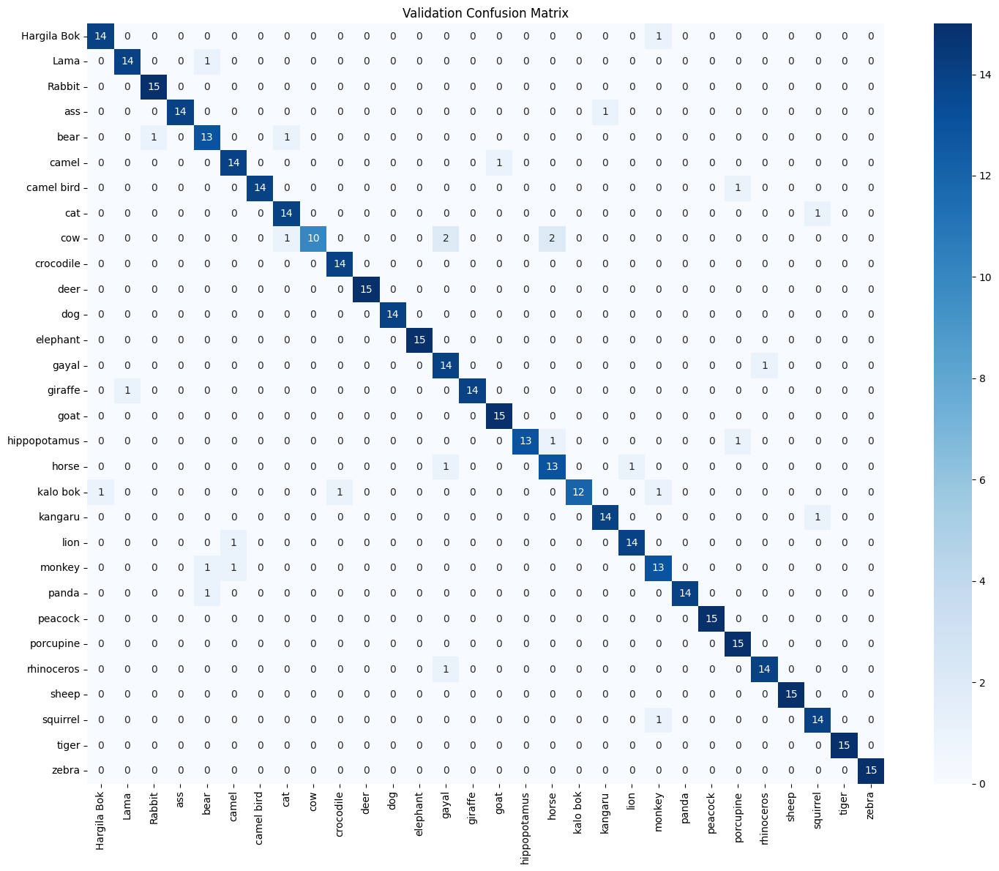

In [12]:
evaluate_model(model, validation_generator, "Validation")
# evaluate_model(model, test_generator, "Test")


 2/30 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


30/30 ━━━━━━━━━━━━━━━━━━━━ 10s 341ms/step

Test Evaluation:
              precision    recall  f1-score   support

 Hargila Bok     0.9412    1.0000    0.9697        16
        Lama     1.0000    0.8000    0.8889        15
      Rabbit     0.9412    1.0000    0.9697        16
         ass     1.0000    0.9375    0.9677        16
        bear     0.9412    1.0000    0.9697        16
       camel     0.8000    1.0000    0.8889        16
  camel bird     1.0000    0.9375    0.9677        16
         cat     1.0000    1.0000    1.0000        15
         cow     0.8571    0.8000    0.8276        15
   crocodile     0.9375    1.0000    0.9677        15
        deer     0.7500    1.0000    0.8571        15
         dog     0.9333    1.0000    0.9655        14
    elephant     0.8125    0.8667    0.8387        15
       gayal     0.8824    0.9375    0.9091        16
     giraffe     1.0000    1.0000    1.0000        16
        goat     1.0000    0.8000    0.8889        15
hippopotamus     0.93

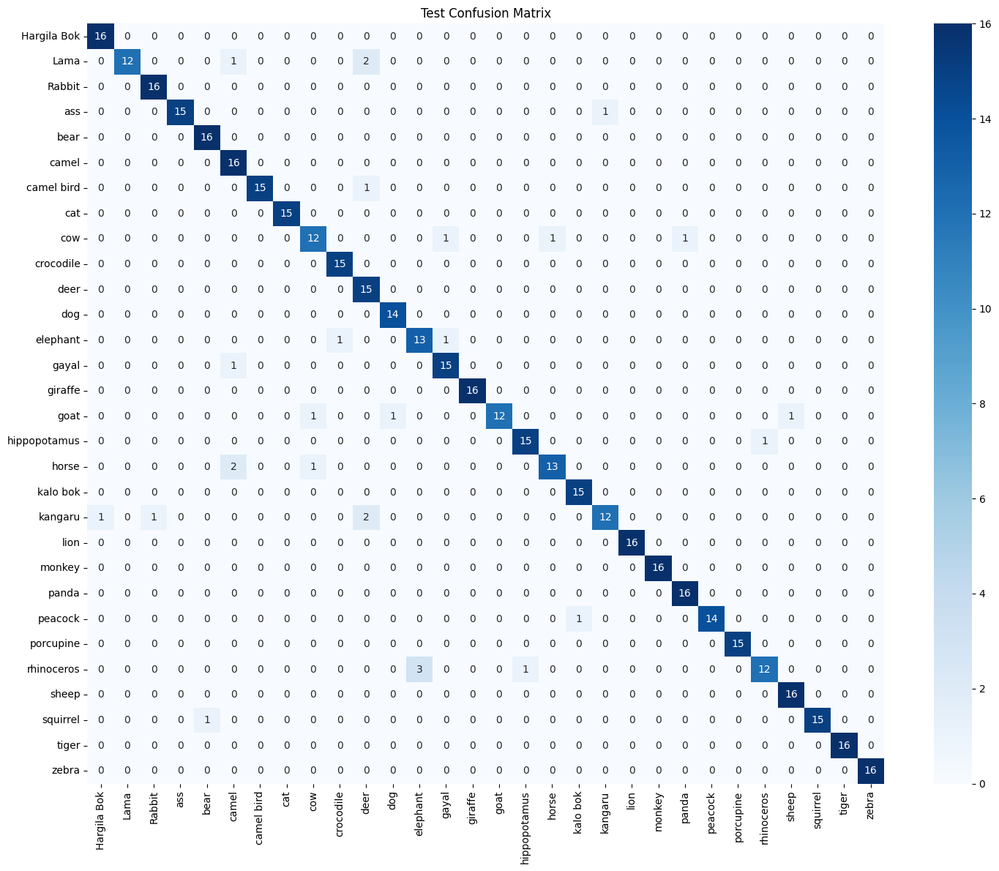

In [13]:
# evaluate_model(model, validation_generator, "Validation")
evaluate_model(model, test_generator, "Test")


## **RestNet**

In [6]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras import layers, models, optimizers, callbacks
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import numpy as np
import os
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns


# Dataset paths (updated with your specific paths)
train_dir = "/kaggle/working/Animal Classification/train_augmented"
val_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/validation"
test_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/test"

# Model parameters
IMG_SIZE = (512, 512)  # Standard size for ResNet
BATCH_SIZE = 16
NUM_CLASSES = 30  # Number of animal classes
EPOCHS = 50

# ==============================================
# 2. Data Loading and Augmentation
# ==============================================
# Training data with augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.1,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Validation and test data (only rescaling)
val_test_datagen = ImageDataGenerator(rescale=1./255)

# Data generators
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=True
)

val_generator = val_test_datagen.flow_from_directory(
    val_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

test_generator = val_test_datagen.flow_from_directory(
    test_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)
# Get class information
class_names = list(train_generator.class_indices.keys())
num_classes = len(class_names)
print(f"\nFound {num_classes} classes: {class_names}\n")


Found 14389 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.

Found 30 classes: ['Hargila Bok', 'Lama', 'Rabbit', 'ass', 'bear', 'camel', 'camel bird', 'cat', 'cow', 'crocodile', 'deer', 'dog', 'elephant', 'gayal', 'giraffe', 'goat', 'hippopotamus', 'horse', 'kalo bok', 'kangaru', 'lion', 'monkey', 'panda', 'peacock', 'porcupine', 'rhinoceros', 'sheep', 'squirrel', 'tiger', 'zebra']



In [7]:

# ==============================================
# 3. ResNet50 Model Definition
# ==============================================
def build_resnet50():
    """Build ResNet50 model with custom head"""
    # Load pre-trained ResNet50 without top
    base_model = ResNet50(
        include_top=False,
        weights='imagenet',
        input_shape=(*IMG_SIZE, 3),
        pooling='avg'
    )

    # Freeze base model layers
    base_model.trainable = False

    # Create new model on top
    model = models.Sequential([
        base_model,
        layers.Dense(1024, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.5),
        layers.Dense(NUM_CLASSES, activation='softmax')
    ])

    # Compile model
    model.compile(
        optimizer=optimizers.Adam(learning_rate=1e-4),
        loss='categorical_crossentropy',
        metrics=[
            'accuracy',
            tf.keras.metrics.Precision(name='precision'),
            tf.keras.metrics.Recall(name='recall'),
            tf.keras.metrics.AUC(name='auc')
        ]
    )

    return model

# Build model
model = build_resnet50()
model.summary()

# ==============================================
# 4. Callbacks
# ==============================================
callbacks = [
    callbacks.EarlyStopping(
        monitor='val_accuracy',
        patience=7,
        restore_best_weights=True
    ),
    callbacks.ModelCheckpoint(
        filepath='best_resnet_model.keras',
        monitor='val_accuracy',
        save_best_only=True,
        mode='max'
    ),
    callbacks.ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.2,
        patience=3,
        min_lr=1e-6,
        verbose=1
    )
]

# ==============================================
# 5. Training
# ==============================================
print("\nTraining ResNet50 model...")
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // BATCH_SIZE,
    validation_data=val_generator,
    validation_steps=val_generator.samples // BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=callbacks,
    verbose=1
)


I0000 00:00:1746953642.593057      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1746953642.593800      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)                │ (None, 2048)                │      23,587,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1024)                │       2,098,176 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 1024)                │           4,096 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 30)                  │          30,750 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 25,720,734 (98.12 MB)

 Trainable params: 2,130,974 (8.13 MB)

 Non-trainable params: 23,589,760 (89.99 MB)


Training ResNet50 model...
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1746953664.959368     123 service.cc:148] XLA service 0x7953d00029f0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1746953664.961899     123 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1746953664.961922     123 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1746953666.458118     123 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1746953674.991121     123 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of th

899/899 ━━━━━━━━━━━━━━━━━━━━ 812s 873ms/step - accuracy: 0.1357 - auc: 0.6876 - loss: 3.2539 - precision: 0.4218 - recall: 0.0343 - val_accuracy: 0.1116 - val_auc: 0.6115 - val_loss: 5.6805 - val_precision: 0.1204 - val_recall: 0.0871 - learning_rate: 1.0000e-04
Epoch 2/50
899/899 ━━━━━━━━━━━━━━━━━━━━ 0s 79us/step - accuracy: 0.3125 - auc: 0.7797 - loss: 2.7264 - precision: 0.5000 - recall: 0.0625 - learning_rate: 1.0000e-04
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_accuracy` which is not available. Available metrics are: accuracy,auc,loss,precision,recall
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/callback_list.py:96: UserWarning: Learning rate reduction is conditioned on metric `val_loss` which is not available. Available metrics a

899/899 ━━━━━━━━━━━━━━━━━━━━ 782s 863ms/step - accuracy: 0.2092 - auc: 0.7760 - loss: 2.8854 - precision: 0.5559 - recall: 0.0582 - val_accuracy: 0.1205 - val_auc: 0.6175 - val_loss: 5.5902 - val_precision: 0.1541 - val_recall: 0.1004 - learning_rate: 1.0000e-04
Epoch 4/50
899/899 ━━━━━━━━━━━━━━━━━━━━ 0s 45us/step - accuracy: 0.1250 - auc: 0.7486 - loss: 3.3070 - precision: 0.5000 - recall: 0.0625 - learning_rate: 1.0000e-04
Epoch 5/50
899/899 ━━━━━━━━━━━━━━━━━━━━ 776s 856ms/step - accuracy: 0.2457 - auc: 0.8083 - loss: 2.7160 - precision: 0.6009 - recall: 0.0750 - val_accuracy: 0.2031 - val_auc: 0.6779 - val_loss: 4.4375 - val_precision: 0.4065 - val_recall: 0.1406 - learning_rate: 1.0000e-04
Epoch 6/50
899/899 ━━━━━━━━━━━━━━━━━━━━ 0s 44us/step - accuracy: 0.2500 - auc: 0.7216 - loss: 3.0841 - precision: 0.5000 - recall: 0.0625 - learning_rate: 1.0000e-04
Epoch 7/50
899/899 ━━━━━━━━━━━━━━━━━━━━ 779s 860ms/step - accuracy: 0.2595 - auc: 0.8235 - loss: 2.6251 - precision: 0.6206 - recal

In [1]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, models, transforms
from torch.utils.data import DataLoader

# Define dataset directories
base_dir = '/kaggle/input/animal-classification-dataset/Animal Classification'
train_dir = os.path.join(base_dir, 'train')
val_dir = os.path.join(base_dir, 'validation')
test_dir = os.path.join(base_dir, 'test')

# Image transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),    # resize all images to 224x224
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],  # ImageNet mean
        std=[0.229, 0.224, 0.225]    # ImageNet std
    )
])

# Load datasets
train_dataset = datasets.ImageFolder(root=train_dir, transform=transform)
val_dataset = datasets.ImageFolder(root=val_dir, transform=transform)
test_dataset = datasets.ImageFolder(root=test_dir, transform=transform)

# Create dataloaders
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

# Use pretrained model, e.g., ResNet18, and adjust output layer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = models.resnet18(pretrained=True)
num_features = model.fc.in_features
num_classes = len(train_dataset.classes)  # should be 30 for your dataset
model.fc = nn.Linear(num_features, num_classes)
model = model.to(device)

# Loss and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training function
def train_one_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    for inputs, labels in loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * inputs.size(0)
        _, preds = torch.max(outputs, 1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

    epoch_loss = running_loss / total
    epoch_acc = correct / total
    return epoch_loss, epoch_acc

# Validation function
def validate(model, loader, criterion, device):
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for inputs, labels in loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)

            running_loss += loss.item() * inputs.size(0)
            _, preds = torch.max(outputs, 1)
            correct += (preds == labels).sum().item()
            total += labels.size(0)

    val_loss = running_loss / total
    val_acc = correct / total
    return val_loss, val_acc

# Training loop
num_epochs = 10

best_val_acc = 0.0
for epoch in range(num_epochs):
    train_loss, train_acc = train_one_epoch(model, train_loader, criterion, optimizer, device)
    val_loss, val_acc = validate(model, val_loader, criterion, device)

    print(f"Epoch {epoch+1}/{num_epochs}")
    print(f"Train Loss: {train_loss:.4f}  Train Acc: {train_acc:.4f}")
    print(f"Val   Loss: {val_loss:.4f}  Val   Acc: {val_acc:.4f}")

    # Save best model
    if val_acc > best_val_acc:
        best_val_acc = val_acc
        torch.save(model.state_dict(), 'best_model.pth')
        print("Saved Best Model")

print("Training complete.")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 187MB/s]


Epoch 1/10
Train Loss: 1.0582  Train Acc: 0.7053
Val   Loss: 1.1077  Val   Acc: 0.7098
Saved Best Model
Epoch 2/10
Train Loss: 0.4297  Train Acc: 0.8721
Val   Loss: 0.9926  Val   Acc: 0.7299
Saved Best Model
Epoch 3/10
Train Loss: 0.1749  Train Acc: 0.9553
Val   Loss: 0.6622  Val   Acc: 0.8192
Saved Best Model
Epoch 4/10
Train Loss: 0.1233  Train Acc: 0.9718
Val   Loss: 0.8289  Val   Acc: 0.7656
Epoch 5/10
Train Loss: 0.1640  Train Acc: 0.9470
Val   Loss: 1.3764  Val   Acc: 0.6987
Epoch 6/10
Train Loss: 0.4144  Train Acc: 0.8774
Val   Loss: 1.4827  Val   Acc: 0.6540
Epoch 7/10
Train Loss: 0.1500  Train Acc: 0.9582
Val   Loss: 0.6210  Val   Acc: 0.8281
Saved Best Model
Epoch 8/10
Train Loss: 0.0614  Train Acc: 0.9830
Val   Loss: 0.4100  Val   Acc: 0.8884
Saved Best Model
Epoch 9/10
Train Loss: 0.0636  Train Acc: 0.9839
Val   Loss: 0.8017  Val   Acc: 0.8147
Epoch 10/10
Train Loss: 0.0271  Train Acc: 0.9946
Val   Loss: 0.4391  Val   Acc: 0.8839
Training complete.


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms, models
from torch.utils.data import DataLoader
import copy

# Data augmentation + normalization for training
train_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Validation data just resized + normalized
val_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Load your datasets (adjust paths accordingly)
train_dataset = datasets.ImageFolder(root=train_dir, transform=train_transform)
val_dataset = datasets.ImageFolder(root=val_dir, transform=val_transform)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

# Define model, loss, optimizer
model = models.resnet18(pretrained=True)
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, num_classes)  # Set output classes

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-4)

# Learning rate scheduler
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', patience=3, factor=0.1, verbose=True)

# Early stopping params
best_acc = 0.0
best_model_wts = copy.deepcopy(model.state_dict())
patience = 5
counter = 0

num_epochs = 25

for epoch in range(num_epochs):
    print(f"Epoch {epoch+1}/{num_epochs}")
    
    # Training phase
    model.train()
    running_loss = 0.0
    running_corrects = 0
    
    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        _, preds = torch.max(outputs, 1)
        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)
    
    epoch_loss = running_loss / len(train_dataset)
    epoch_acc = running_corrects.double() / len(train_dataset)
    
    # Validation phase
    model.eval()
    val_loss = 0.0
    val_corrects = 0
    
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            
            _, preds = torch.max(outputs, 1)
            val_loss += loss.item() * inputs.size(0)
            val_corrects += torch.sum(preds == labels.data)
    
    val_loss = val_loss / len(val_dataset)
    val_acc = val_corrects.double() / len(val_dataset)
    
    print(f"Train Loss: {epoch_loss:.4f}  Train Acc: {epoch_acc:.4f}")
    print(f"Val   Loss: {val_loss:.4f}  Val   Acc: {val_acc:.4f}")
    
    # Step scheduler
    scheduler.step(val_acc)
    
    # Early stopping check
    if val_acc > best_acc:
        best_acc = val_acc
        best_model_wts = copy.deepcopy(model.state_dict())
        counter = 0
        print("Saved Best Model")
    else:
        counter += 1
        if counter >= patience:
            print("Early stopping triggered")
            break

# Load best model weights
model.load_state_dict(best_model_wts)

# Save the best model
torch.save(model.state_dict(), "best_model.pth")
print(f"Training complete. Best val Acc: {best_acc:.4f}")

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch 1/25
Train Loss: 1.9781  Train Acc: 0.4514
Val   Loss: 2.4468  Val   Acc: 0.4263
Saved Best Model
Epoch 2/25
Train Loss: 1.4709  Train Acc: 0.5768
Val   Loss: 1.4694  Val   Acc: 0.5982
Saved Best Model
Epoch 3/25
Train Loss: 1.2574  Train Acc: 0.6338
Val   Loss: 1.9466  Val   Acc: 0.5424
Epoch 4/25
Train Loss: 1.1486  Train Acc: 0.6741
Val   Loss: 1.0102  Val   Acc: 0.7277
Saved Best Model
Epoch 5/25
Train Loss: 0.9958  Train Acc: 0.7150
Val   Loss: 1.2684  Val   Acc: 0.6763
Epoch 6/25
Train Loss: 0.8910  Train Acc: 0.7456
Val   Loss: 0.8205  Val   Acc: 0.7857
Saved Best Model
Epoch 7/25
Train Loss: 0.8144  Train Acc: 0.7481
Val   Loss: 0.7759  Val   Acc: 0.8036
Saved Best Model
Epoch 8/25
Train Loss: 0.7769  Train Acc: 0.7636
Val   Loss: 0.8316  Val   Acc: 0.7500
Epoch 9/25
Train Loss: 0.7897  Train Acc: 0.7661
Val   Loss: 1.3153  Val   Acc: 0.6763
Epoch 10/25
Train Loss: 0.7056  Train Acc: 0.7894
Val   Loss: 0.7242  Val   Acc: 0.7835
Epoch 11/25
Train Loss: 0.7202  Train Acc: 0

## **EfficientNetV2B3** 

In [3]:
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetV2B3
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, TensorBoard
from sklearn.metrics import classification_report, confusion_matrix, precision_recall_fscore_support
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import os
import datetime

# Configuration
IMG_SIZE = (300, 300)  # EfficientNetV2B3 optimal size
BATCH_SIZE = 32
EPOCHS = 50
NUM_CLASSES = 30

# Dataset paths
TRAIN_AUG_DIR = "/kaggle/working/Animal Classification/train_augmented"
VAL_DIR = "/kaggle/input/animal-classification-dataset/Animal Classification/validation"
TEST_DIR = "/kaggle/input/animal-classification-dataset/Animal Classification/test"

# Enable mixed precision training
policy = tf.keras.mixed_precision.Policy('mixed_float16')
tf.keras.mixed_precision.set_global_policy(policy)

# Data generators - minimal augmentation since data is pre-augmented
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=10,  # Light augmentation only
    horizontal_flip=True
)

val_test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

# Create generators
train_generator = train_datagen.flow_from_directory(
    TRAIN_AUG_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=True,
    seed=42
)

val_generator = val_test_datagen.flow_from_directory(
    VAL_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

test_generator = val_test_datagen.flow_from_directory(
    TEST_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

# Get class information
class_names = list(train_generator.class_indices.keys())
print(f"\nFound {len(class_names)} classes: {class_names}\n")

Found 14389 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.

Found 30 classes: ['Hargila Bok', 'Lama', 'Rabbit', 'ass', 'bear', 'camel', 'camel bird', 'cat', 'cow', 'crocodile', 'deer', 'dog', 'elephant', 'gayal', 'giraffe', 'goat', 'hippopotamus', 'horse', 'kalo bok', 'kangaru', 'lion', 'monkey', 'panda', 'peacock', 'porcupine', 'rhinoceros', 'sheep', 'squirrel', 'tiger', 'zebra']



In [5]:
# Model building with EfficientNetV2B3
def build_model():
    base_model = EfficientNetV2B3(
        include_top=False,
        weights='imagenet',
        input_shape=(*IMG_SIZE, 3),
        pooling='avg'
    )
    
    # Gradual unfreezing approach
    for layer in base_model.layers[:100]:
        layer.trainable = False
    for layer in base_model.layers[100:]:
        layer.trainable = True

    inputs = tf.keras.Input(shape=(*IMG_SIZE, 3))
    x = base_model(inputs)
    x = layers.Dense(1024, activation='relu')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.3)(x)  # Adding dropout for regularization
    outputs = layers.Dense(NUM_CLASSES, activation='softmax', dtype='float32')(x)
    
    return tf.keras.Model(inputs, outputs)

# Build and compile model
model = build_model()
optimizer = Adam(learning_rate=1e-4, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
model.compile(
    optimizer=optimizer,
    loss='categorical_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall'),
        tf.keras.metrics.AUC(name='auc'),
        tf.keras.metrics.TopKCategoricalAccuracy(k=3, name='top3_accuracy')
    ]
)

# Enhanced callbacks
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
callbacks = [
    EarlyStopping(monitor='val_auc', patience=10, mode='max', restore_best_weights=True),
    ModelCheckpoint('best_model.keras', 
                  save_best_only=True, 
                  monitor='val_auc',
                  mode='max'),
    ReduceLROnPlateau(monitor='val_loss', 
                     factor=0.5, 
                     patience=5, 
                     min_lr=1e-6,
                     verbose=1),
    TensorBoard(log_dir=log_dir, histogram_freq=1)
]

# Training
print("Starting training...")
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // BATCH_SIZE,
    validation_data=val_generator,
    validation_steps=val_generator.samples // BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=callbacks,
    verbose=1
)


I0000 00:00:1746986898.609367      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1746986898.610000      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


52606240/52606240 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step
Starting training...
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1746986989.211431     128 service.cc:148] XLA service 0x7972fc030420 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1746986989.212131     128 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1746986989.212153     128 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1746986997.678801     128 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1746987049.877003     128 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of th

449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 733ms/step - accuracy: 0.0687 - auc: 0.5707 - loss: 3.9399 - precision: 0.2151 - recall: 0.0153 - top3_accuracy: 0.1586

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


449/449 ━━━━━━━━━━━━━━━━━━━━ 508s 785ms/step - accuracy: 0.0687 - auc: 0.5708 - loss: 3.9393 - precision: 0.2154 - recall: 0.0154 - top3_accuracy: 0.1587 - val_accuracy: 0.2768 - val_auc: 0.8246 - val_loss: 2.6058 - val_precision: 0.8431 - val_recall: 0.0960 - val_top3_accuracy: 0.4531 - learning_rate: 1.0000e-04
Epoch 2/50
  1/449 ━━━━━━━━━━━━━━━━━━━━ 1:10 157ms/step - accuracy: 0.2500 - auc: 0.6991 - loss: 3.1475 - precision: 0.8000 - recall: 0.1250 - top3_accuracy: 0.3750

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_auc` which is not available. Available metrics are: accuracy,auc,loss,precision,recall,top3_accuracy
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_auc available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/callback_list.py:96: UserWarning: Learning rate reduction is conditioned on metric `val_loss` which is not available. Available metri

449/449 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.2500 - auc: 0.6991 - loss: 3.1475 - precision: 0.8000 - recall: 0.1250 - top3_accuracy: 0.3750 - learning_rate: 1.0000e-04
Epoch 3/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 293s 643ms/step - accuracy: 0.1834 - auc: 0.7306 - loss: 3.1029 - precision: 0.5846 - recall: 0.0822 - top3_accuracy: 0.3381 - val_accuracy: 0.4487 - val_auc: 0.8986 - val_loss: 2.0278 - val_precision: 0.7453 - val_recall: 0.2679 - val_top3_accuracy: 0.6429 - learning_rate: 1.0000e-04
Epoch 4/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.3438 - auc: 0.7931 - loss: 2.6895 - precision: 0.7143 - recall: 0.1562 - top3_accuracy: 0.4688 - learning_rate: 1.0000e-04
Epoch 5/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 288s 632ms/step - accuracy: 0.3462 - auc: 0.8580 - loss: 2.3771 - precision: 0.6431 - recall: 0.2057 - top3_accuracy: 0.5541 - val_accuracy: 0.5625 - val_auc: 0.9222 - val_loss: 1.7427 - val_precision: 0.6787 - val_recall: 0.4621 - val_top3_accuracy: 0.7321 - learn

In [ ]:
# Enhanced evaluation function
def extended_evaluation(model, generator, dataset_name):
    generator.reset()
    y_true = generator.classes
    y_pred = model.predict(generator)
    y_pred_classes = np.argmax(y_pred, axis=1)
    
    print(f"\n{'='*60}")
    print(f"COMPREHENSIVE EVALUATION: {dataset_name}")
    print(f"{'='*60}")
    
    # Classification report
    print("\nClassification Report:")
    print(classification_report(y_true, y_pred_classes, 
                              target_names=class_names,
                              digits=4))
    
    # Confusion matrix
    plt.figure(figsize=(15, 12))
    cm = confusion_matrix(y_true, y_pred_classes)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
               xticklabels=class_names,
               yticklabels=class_names)
    plt.title(f'Confusion Matrix ({dataset_name})\nTotal Samples: {len(y_true)}', pad=20)
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.show()
    
    return y_true, y_pred

# Run evaluation
print("\nRunning extended evaluation...")
val_true, val_pred = extended_evaluation(model, val_generator, "Test Set")
# test_true, test_pred = extended_evaluation(model, test_generator, "Test Set")



 1/15 ━━━━━━━━━━━━━━━━━━━━ 2s 172ms/step

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


15/15 ━━━━━━━━━━━━━━━━━━━━ 20s 1s/step 

COMPREHENSIVE EVALUATION: Validation Set

Classification Report:
              precision    recall  f1-score   support

 Hargila Bok     0.9412    1.0000    0.9697        16
        Lama     0.7857    0.7333    0.7586        15
      Rabbit     0.7368    0.8750    0.8000        16
         ass     0.9231    0.7500    0.8276        16
        bear     0.7778    0.8750    0.8235        16
       camel     0.7500    0.9375    0.8333        16
  camel bird     0.8750    0.8750    0.8750        16
         cat     0.6667    0.8000    0.7273        15
         cow     0.8000    0.8000    0.8000        15
   crocodile     0.7000    0.9333    0.8000        15
        deer     0.6875    0.7333    0.7097        15
         dog     0.6471    0.7857    0.7097        14
    elephant     0.9286    0.8667    0.8966        15
       gayal     0.9167    0.6875    0.7857        16
     giraffe     0.9375    0.9375    0.9375        16
        goat     0.9091    0.

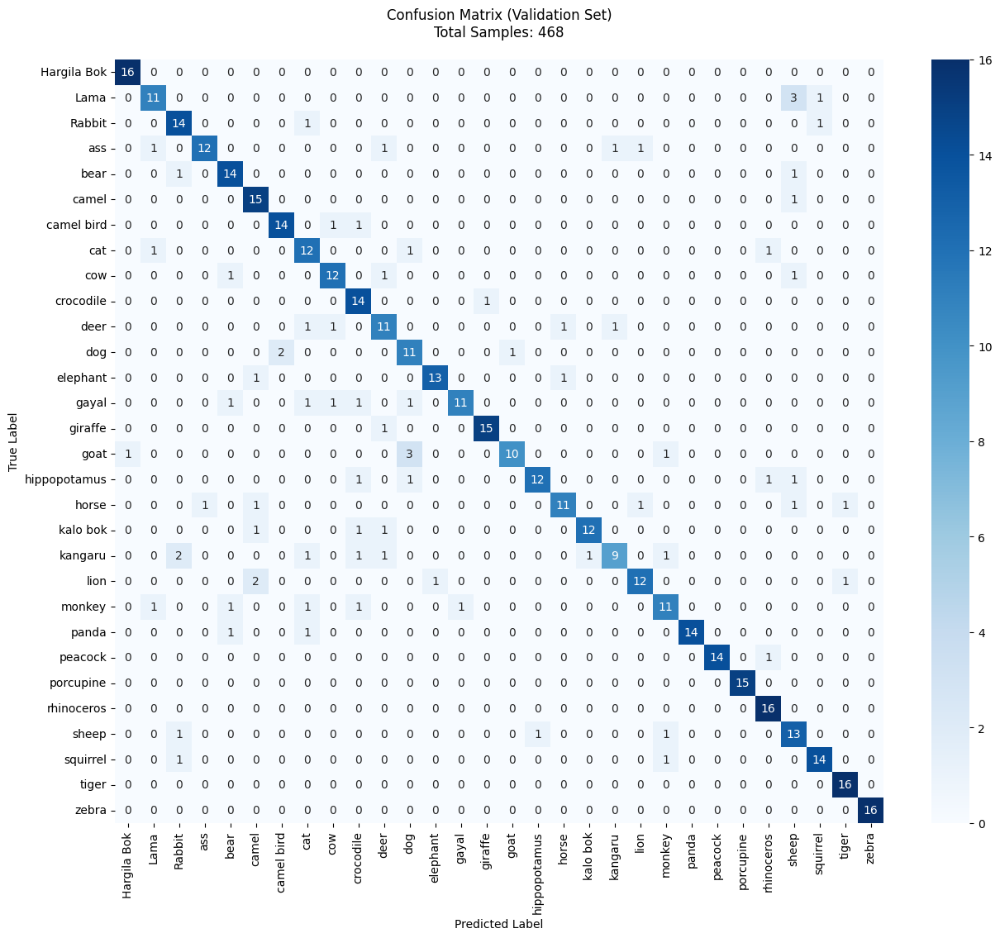

In [7]:
test_true, test_pred = extended_evaluation(model, test_generator, "Validation Set")


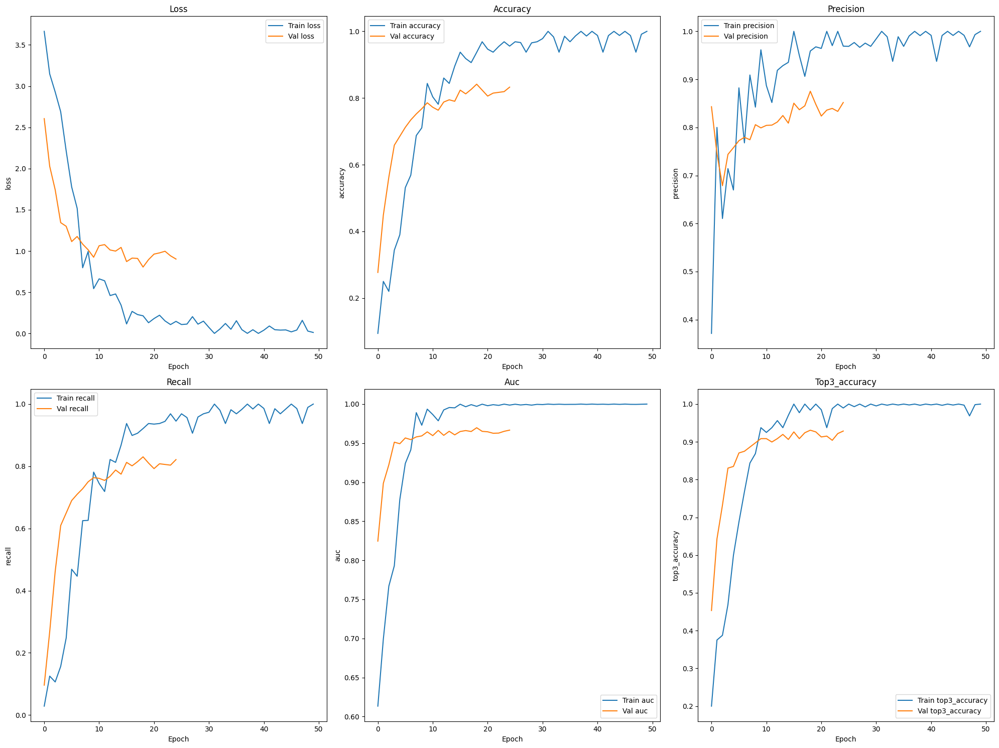

In [8]:
# Enhanced training history visualization
def plot_enhanced_history(history):
    metrics = ['loss', 'accuracy', 'precision', 'recall', 'auc', 'top3_accuracy']
    
    plt.figure(figsize=(20, 15))
    for i, metric in enumerate(metrics):
        plt.subplot(2, 3, i+1)
        plt.plot(history.history[metric], label=f'Train {metric}')
        if f'val_{metric}' in history.history:
            plt.plot(history.history[f'val_{metric}'], label=f'Val {metric}')
        plt.title(metric.capitalize())
        plt.ylabel(metric)
        plt.xlabel('Epoch')
        plt.legend()
    
    plt.tight_layout()
    plt.show()

plot_enhanced_history(history)




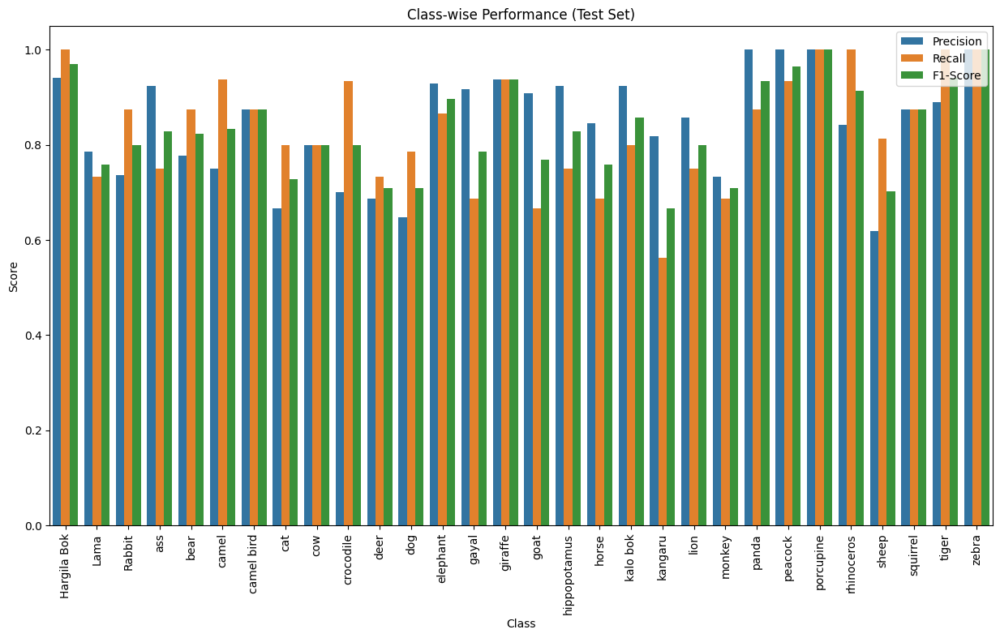


Model saved successfully as 'animal_classifier_effnetv2b3_final.keras'


In [9]:
# Class-wise performance analysis
def plot_class_performance(y_true, y_pred, class_names, dataset_name):
    precision, recall, f1, _ = precision_recall_fscore_support(y_true, np.argmax(y_pred, axis=1))
    
    perf_df = pd.DataFrame({
        'Class': class_names,
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1
    }).melt(id_vars='Class', var_name='Metric', value_name='Score')
    
    plt.figure(figsize=(15, 8))
    sns.barplot(data=perf_df, x='Class', y='Score', hue='Metric')
    plt.title(f'Class-wise Performance ({dataset_name})')
    plt.ylabel('Score')
    plt.xlabel('Class')
    plt.xticks(rotation=90)
    plt.legend(loc='upper right')
    plt.show()

plot_class_performance(test_true, test_pred, class_names, "Test Set")
# plot_class_performance(test_true, test_pred, class_names, "Test Set")

# Save the final model
model.save('animal_classifier_effnetv2b3_final.keras')
print("\nModel saved successfully as 'animal_classifier_effnetv2b3_final.keras'")

### **Fine-Tunning**

Number of classes: 30


Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 300, 300, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ cast_17 (Cast)            │ (None, 300, 300, 3)    │              0 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ rescaling (Rescaling)     │ (None, 300, 300, 3)    │              0 │ cast_17[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ normalization             │ (None, 300, 300, 3)    │              0 │ rescaling[0][0]        │
│ (Normalization)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_conv (Conv2D)        │ (None, 150, 150, 40)   │          1,080 │ normalization[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_bn                   │ (None, 150, 150, 40)   │            160 │ stem_conv[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_activation           │ (None, 150, 150, 40)   │              0 │ stem_bn[0][0]          │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_project_conv      │ (None, 150, 150, 16)   │          5,760 │ stem_activation[0][0]  │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_project_bn        │ (None, 150, 150, 16)   │             64 │ block1a_project_conv[… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_project_activati… │ (None, 150, 150, 16)   │              0 │ block1a_project_bn[0]… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1b_project_conv      │ (None, 150, 150, 16)   │          2,304 │ block1a_project_activ… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1b_project_bn        │ (None, 150, 150, 16)   │             64 │ block1b_project_conv[… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1b_project_activati… │ (None, 150, 150, 16)   │              0 │ block1b_project_bn[0]… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1b_drop (Dropout)    │ (None, 150, 150, 16)   │              0 │ block1b_project_activ… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1b_add (Add)         │ (None, 150, 150, 16)   │              0 │ block1b_drop[0][0],    │
│                      

 Total params: 13,735,004 (52.39 MB)

 Trainable params: 12,788,494 (48.78 MB)

 Non-trainable params: 946,510 (3.61 MB)

Starting fine-tuning...
Epoch 1/30
449/449 ━━━━━━━━━━━━━━━━━━━━ 479s 745ms/step - accuracy: 0.1670 - auc: 0.6800 - loss: 3.5542 - precision: 0.3563 - recall: 0.0683 - top3_accuracy: 0.3070 - val_accuracy: 0.6763 - val_auc: 0.9604 - val_loss: 1.3539 - val_precision: 0.9548 - val_recall: 0.4241 - val_top3_accuracy: 0.8147 - learning_rate: 1.0000e-05
Epoch 2/30
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 262us/step - accuracy: 0.6250 - auc: 0.9679 - loss: 1.3234 - precision: 0.8462 - recall: 0.3438 - top3_accuracy: 0.8125 - learning_rate: 1.0000e-05
Epoch 3/30


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_accuracy` which is not available. Available metrics are: accuracy,auc,loss,precision,recall,top3_accuracy
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/callback_list.py:96: UserWarning: Learning rate reduction is conditioned on metric `val_loss` which is not available. Avail

449/449 ━━━━━━━━━━━━━━━━━━━━ 282s 619ms/step - accuracy: 0.6938 - auc: 0.9720 - loss: 1.1073 - precision: 0.9030 - recall: 0.5166 - top3_accuracy: 0.8610 - val_accuracy: 0.7656 - val_auc: 0.9751 - val_loss: 0.8347 - val_precision: 0.8802 - val_recall: 0.7054 - val_top3_accuracy: 0.8839 - learning_rate: 1.0000e-05
Epoch 4/30
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 148us/step - accuracy: 0.7500 - auc: 0.9906 - loss: 0.8452 - precision: 0.8261 - recall: 0.5938 - top3_accuracy: 0.9375 - learning_rate: 1.0000e-05
Epoch 5/30
449/449 ━━━━━━━━━━━━━━━━━━━━ 281s 617ms/step - accuracy: 0.8614 - auc: 0.9947 - loss: 0.5432 - precision: 0.9518 - recall: 0.7488 - top3_accuracy: 0.9556 - val_accuracy: 0.7857 - val_auc: 0.9771 - val_loss: 0.7615 - val_precision: 0.8695 - val_recall: 0.7433 - val_top3_accuracy: 0.9018 - learning_rate: 1.0000e-05
Epoch 6/30
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 146us/step - accuracy: 0.7812 - auc: 0.9879 - loss: 0.7264 - precision: 0.8519 - recall: 0.7188 - top3_accuracy: 0.8750 - lea

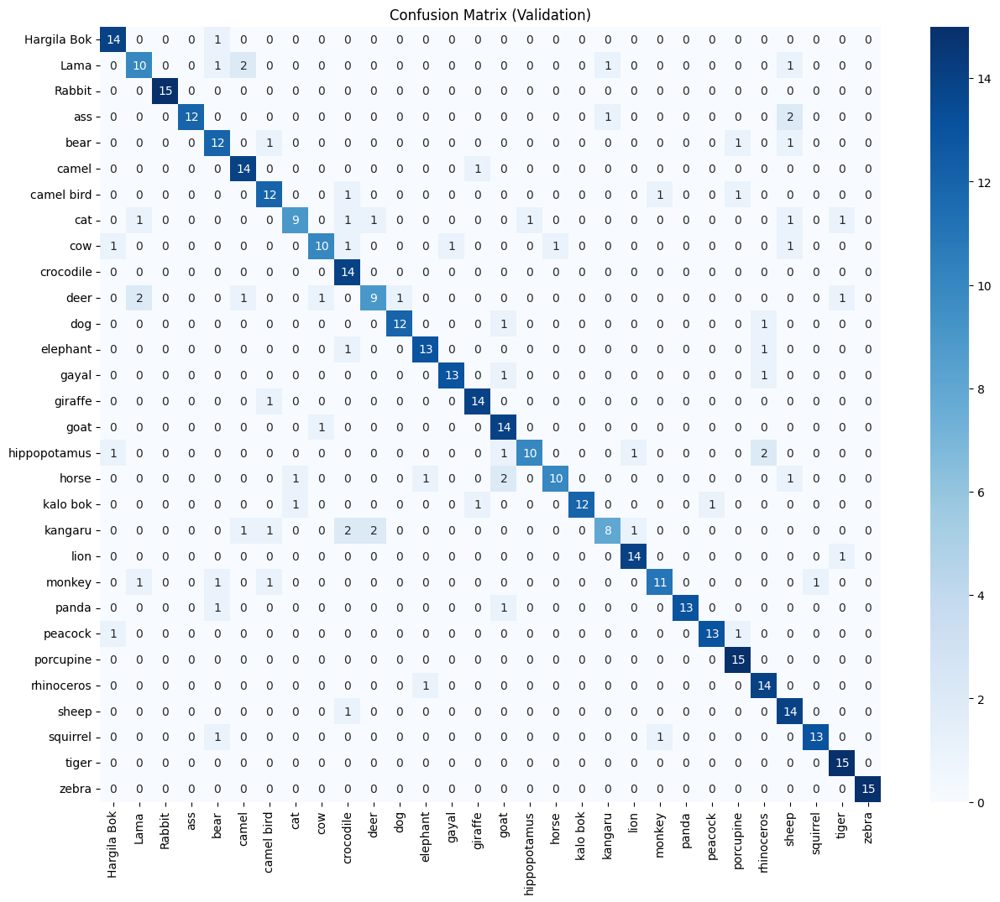

15/15 ━━━━━━━━━━━━━━━━━━━━ 13s 925ms/step

EVALUATION: Test
              precision    recall  f1-score   support

 Hargila Bok     0.8824    0.9375    0.9091        16
        Lama     0.7857    0.7333    0.7586        15
      Rabbit     0.7895    0.9375    0.8571        16
         ass     0.9231    0.7500    0.8276        16
        bear     0.9333    0.8750    0.9032        16
       camel     0.9333    0.8750    0.9032        16
  camel bird     0.8462    0.6875    0.7586        16
         cat     0.7059    0.8000    0.7500        15
         cow     0.7857    0.7333    0.7586        15
   crocodile     0.6818    1.0000    0.8108        15
        deer     0.8000    0.8000    0.8000        15
         dog     0.5789    0.7857    0.6667        14
    elephant     0.8571    0.8000    0.8276        15
       gayal     0.7692    0.6250    0.6897        16
     giraffe     0.8824    0.9375    0.9091        16
        goat     0.6875    0.7333    0.7097        15
hippopotamus     0.86

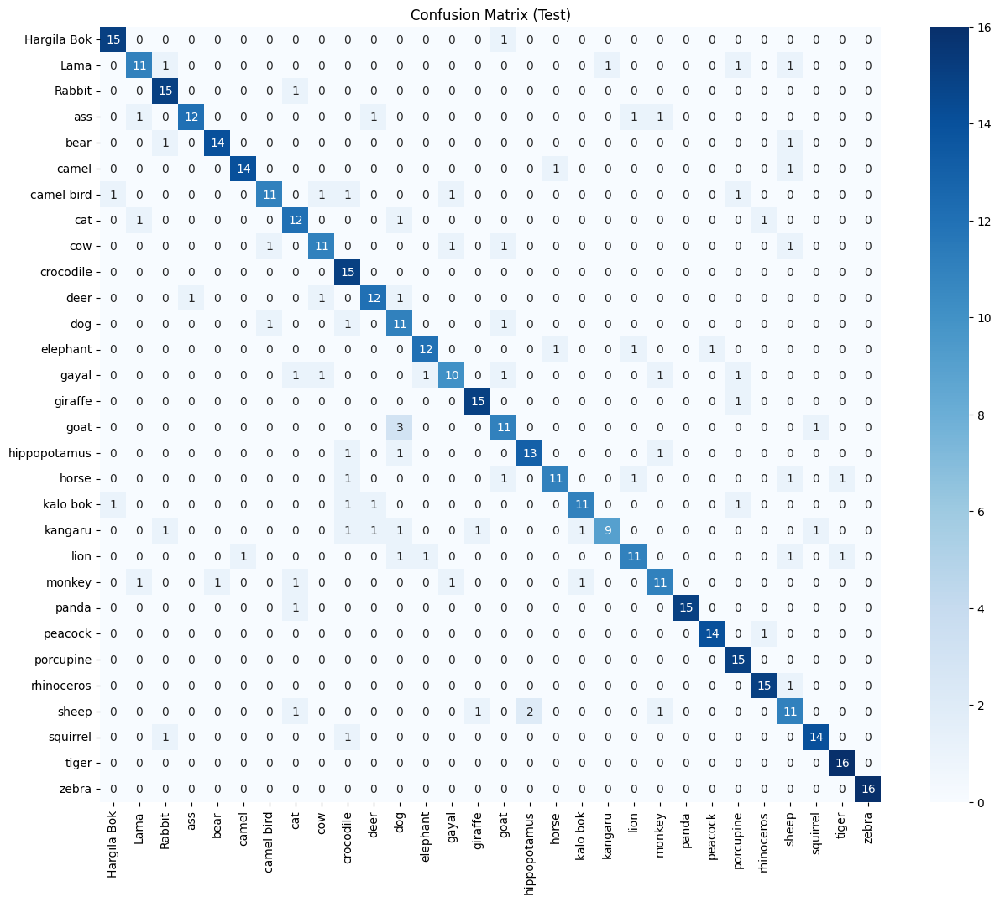


Model saved successfully!


In [20]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, TensorBoard
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
from sklearn.utils import class_weight

# Configuration
IMG_SIZE = (300, 300)
BATCH_SIZE = 32
EPOCHS = 50

# Get number of classes from your generator
num_classes = len(train_generator.class_indices)
print(f"Number of classes: {num_classes}")

# Corrected TopKAccuracy metric
class TopKAccuracy(tf.keras.metrics.Metric):
    def __init__(self, k=3, name='top_k_accuracy', dtype=None):
        super().__init__(name=name, dtype=dtype)
        self.k = k
        self.correct = self.add_weight(name='correct', initializer='zeros')
        self.total = self.add_weight(name='total', initializer='zeros')

    def update_state(self, y_true, y_pred, sample_weight=None):
        # Convert one-hot encoded y_true to class indices
        y_true = tf.argmax(y_true, axis=1)
        y_true = tf.cast(y_true, tf.int32)
        y_pred = tf.cast(y_pred, tf.float32)  # Ensure float32 for TopK
        
        # Calculate top-k accuracy
        top_k = tf.math.in_top_k(predictions=y_pred, targets=y_true, k=self.k)
        self.correct.assign_add(tf.reduce_sum(tf.cast(top_k, tf.float32)))
        self.total.assign_add(tf.cast(tf.shape(y_true)[0], tf.float32))

    def result(self):
        return self.correct / self.total

    def reset_state(self):
        self.correct.assign(0.)
        self.total.assign(0.)

def fine_tune_model(model, num_classes):
    # Get the base model
    base_model = None
    for layer in model.layers:
        if isinstance(layer, tf.keras.Model):
            base_model = layer
            break
    
    if base_model is None:
        raise ValueError("Base model not found in architecture")
    
    # Unfreeze top layers
    for layer in base_model.layers[-100:]:
        if not isinstance(layer, layers.BatchNormalization):
            layer.trainable = True
    
    # Rebuild model with proper precision handling
    x = base_model.output
    x = layers.Dense(512, activation='relu')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.4)(x)
    outputs = layers.Dense(num_classes, activation='softmax', dtype='float32')(x)
    fine_tuned_model = tf.keras.Model(inputs=base_model.input, outputs=outputs)
    
    # Compile with custom metrics
    optimizer = Adam(learning_rate=1e-5)
    fine_tuned_model.compile(
        optimizer=optimizer,
        loss='categorical_crossentropy',
        metrics=[
            'accuracy',
            tf.keras.metrics.Precision(name='precision'),
            tf.keras.metrics.Recall(name='recall'),
            tf.keras.metrics.AUC(name='auc'),
            TopKAccuracy(k=3, name='top3_accuracy')
        ]
    )
    
    return fine_tuned_model

# Load model and fine-tune
model = tf.keras.models.load_model('best_model.keras')
fine_tuned_model = fine_tune_model(model, num_classes)
fine_tuned_model.summary()

# Callbacks
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
callbacks = [
    EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True),
    ModelCheckpoint('fine_tuned_best_model.keras', monitor='val_accuracy', save_best_only=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-7),
    TensorBoard(log_dir=log_dir)
]

# Class weights
class_weights = class_weight.compute_class_weight(
    'balanced',
    classes=np.unique(train_generator.classes),
    y=train_generator.classes
)
class_weights = dict(enumerate(class_weights))

# Train
print("Starting fine-tuning...")
history = fine_tuned_model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // BATCH_SIZE,
    validation_data=val_generator,
    validation_steps=val_generator.samples // BATCH_SIZE,
    epochs=30,
    callbacks=callbacks,
    class_weight=class_weights
)

# Evaluation function
def extended_evaluation(model, generator, dataset_name):
    generator.reset()
    y_true = generator.classes
    y_pred = model.predict(generator)
    y_pred_classes = np.argmax(y_pred, axis=1)
    
    print(f"\n{'='*60}")
    print(f"EVALUATION: {dataset_name}")
    print(f"{'='*60}")
    print(classification_report(y_true, y_pred_classes, 
                              target_names=list(generator.class_indices.keys()),
                              digits=4))
    
    plt.figure(figsize=(15, 12))
    cm = confusion_matrix(y_true, y_pred_classes)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
               xticklabels=list(generator.class_indices.keys()),
               yticklabels=list(generator.class_indices.keys()))
    plt.title(f'Confusion Matrix ({dataset_name})')
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.show()
    
    return y_true, y_pred

# Evaluate
print("\nEvaluating fine-tuned model...")
val_true, val_pred = extended_evaluation(fine_tuned_model, val_generator, "Validation")
test_true, test_pred = extended_evaluation(fine_tuned_model, test_generator, "Test")

# Save final model
fine_tuned_model.save('final_model.keras')
print("\nModel saved successfully!")

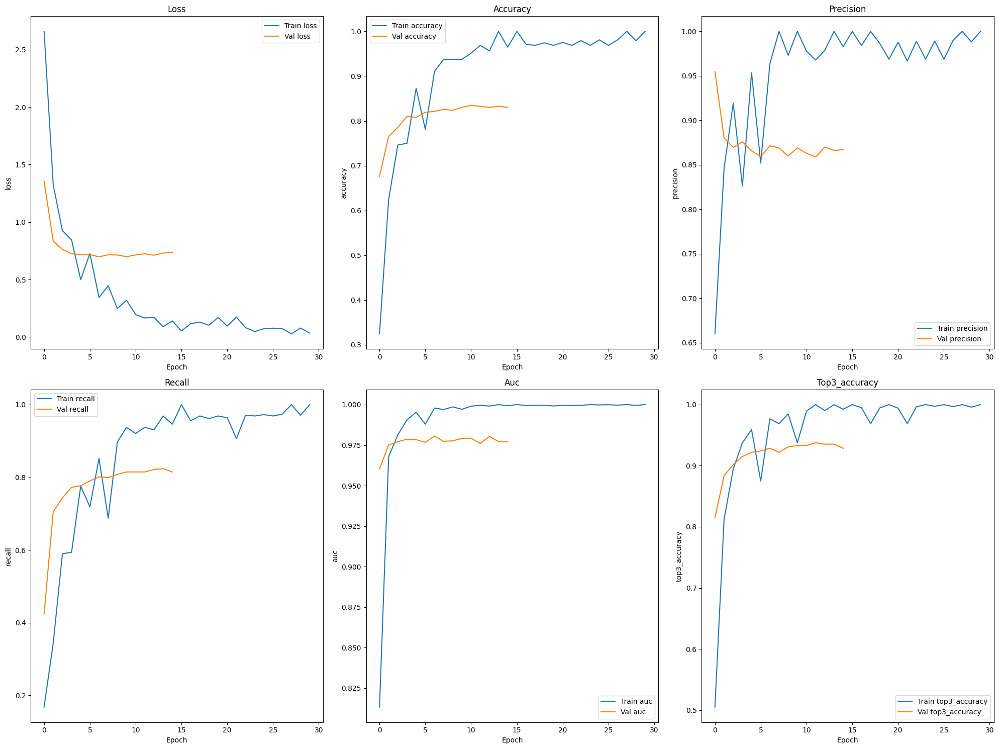

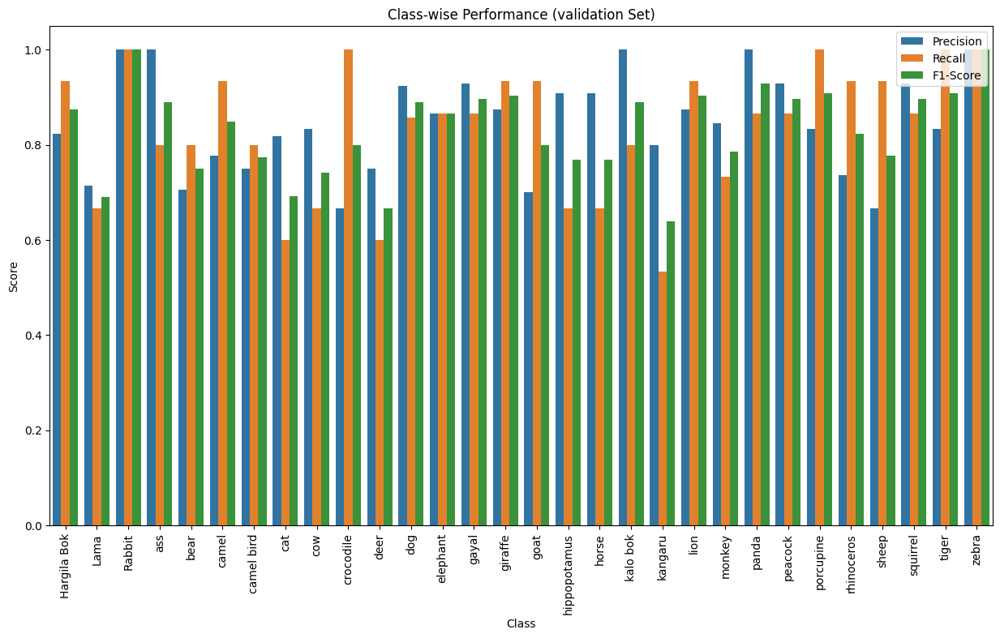

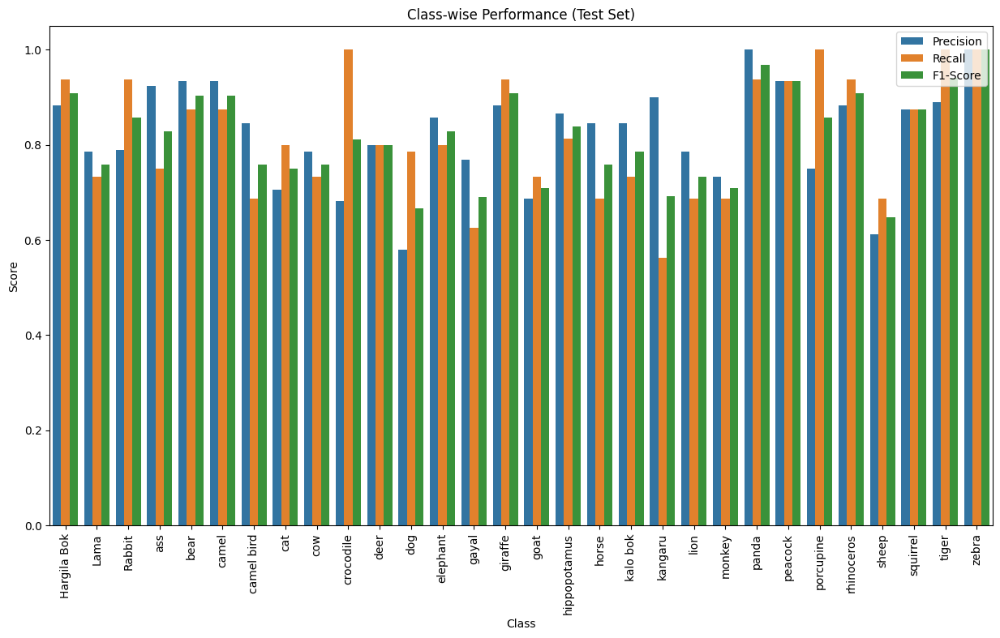

In [23]:
plot_enhanced_history(history)
plot_class_performance(val_true, val_pred, class_names, "validation Set")
plot_class_performance(test_true, test_pred, class_names, "Test Set")

## **DenseNet121**

In [29]:
# # Kaggle Directory Setup
# input_dir = "/kaggle/input/animal-classification-dataset/Animal Classification"
# train_dir = "/kaggle/working/Animal Classification/train_augmented"
# val_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/validation"
# test_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/test"

import tensorflow as tf
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Data Generators
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    brightness_range=[0.8, 1.2]
)

val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    "/kaggle/working/Animal Classification/train_augmented",
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    shuffle=True
)

val_generator = val_datagen.flow_from_directory(
    "/kaggle/input/animal-classification-dataset/Animal Classification/validation",
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    shuffle=False
)

test_generator = val_datagen.flow_from_directory(
    "/kaggle/input/animal-classification-dataset/Animal Classification/test",
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',
    shuffle=False
)


Found 14389 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.


In [30]:
# Build DenseNet121 Model
base_model = DenseNet121(
    weights='imagenet',
    include_top=False,
    input_shape=(224, 224, 3)
)

base_model.trainable = False  # Freeze base model

model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(30, activation='softmax')  # 30 classes
])

# Compile
model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# Callbacks
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    ModelCheckpoint('best_densenet_model.keras', save_best_only=True, monitor='val_accuracy')
]

# Training
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    validation_data=val_generator,
    validation_steps=val_generator.samples // val_generator.batch_size,
    epochs=50,
    callbacks=callbacks
)

Epoch 1/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 251s 469ms/step - accuracy: 0.5948 - loss: 1.5270 - val_accuracy: 0.9487 - val_loss: 0.1830
Epoch 2/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 161us/step - accuracy: 0.8438 - loss: 0.5252
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_loss` which is not available. Available metrics are: accuracy,loss
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_accuracy available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)


449/449 ━━━━━━━━━━━━━━━━━━━━ 184s 404ms/step - accuracy: 0.8858 - loss: 0.3699 - val_accuracy: 0.9665 - val_loss: 0.1123
Epoch 4/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 78us/step - accuracy: 0.8750 - loss: 0.4198 
Epoch 5/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 187s 410ms/step - accuracy: 0.9134 - loss: 0.2711 - val_accuracy: 0.9643 - val_loss: 0.1145
Epoch 6/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 76us/step - accuracy: 0.9688 - loss: 0.1430 
Epoch 7/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 184s 404ms/step - accuracy: 0.9195 - loss: 0.2461 - val_accuracy: 0.9777 - val_loss: 0.0754
Epoch 8/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 77us/step - accuracy: 0.8438 - loss: 0.4485 
Epoch 9/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 184s 403ms/step - accuracy: 0.9358 - loss: 0.1990 - val_accuracy: 0.9554 - val_loss: 0.1194
Epoch 10/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 75us/step - accuracy: 0.9688 - loss: 0.0424 
Epoch 11/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 183s 402ms/step - accuracy: 0.9380 - loss: 0.1895 - val_accuracy: 0.9554 - val_loss: 0.09

14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 85ms/step

📊 Classification Report for Validation Set:
              precision    recall  f1-score   support

 Hargila Bok     1.0000    1.0000    1.0000        15
        Lama     0.9333    0.9333    0.9333        15
      Rabbit     1.0000    1.0000    1.0000        15
         ass     0.9375    1.0000    0.9677        15
        bear     0.8750    0.9333    0.9032        15
       camel     1.0000    1.0000    1.0000        15
  camel bird     1.0000    1.0000    1.0000        15
         cat     1.0000    0.9333    0.9655        15
         cow     0.8125    0.8667    0.8387        15
   crocodile     1.0000    1.0000    1.0000        14
        deer     1.0000    1.0000    1.0000        15
         dog     0.9286    0.9286    0.9286        14
    elephant     1.0000    1.0000    1.0000        15
       gayal     0.9333    0.9333    0.9333        15
     giraffe     1.0000    1.0000    1.0000        15
        goat     1.0000    0.9333    0.9655       

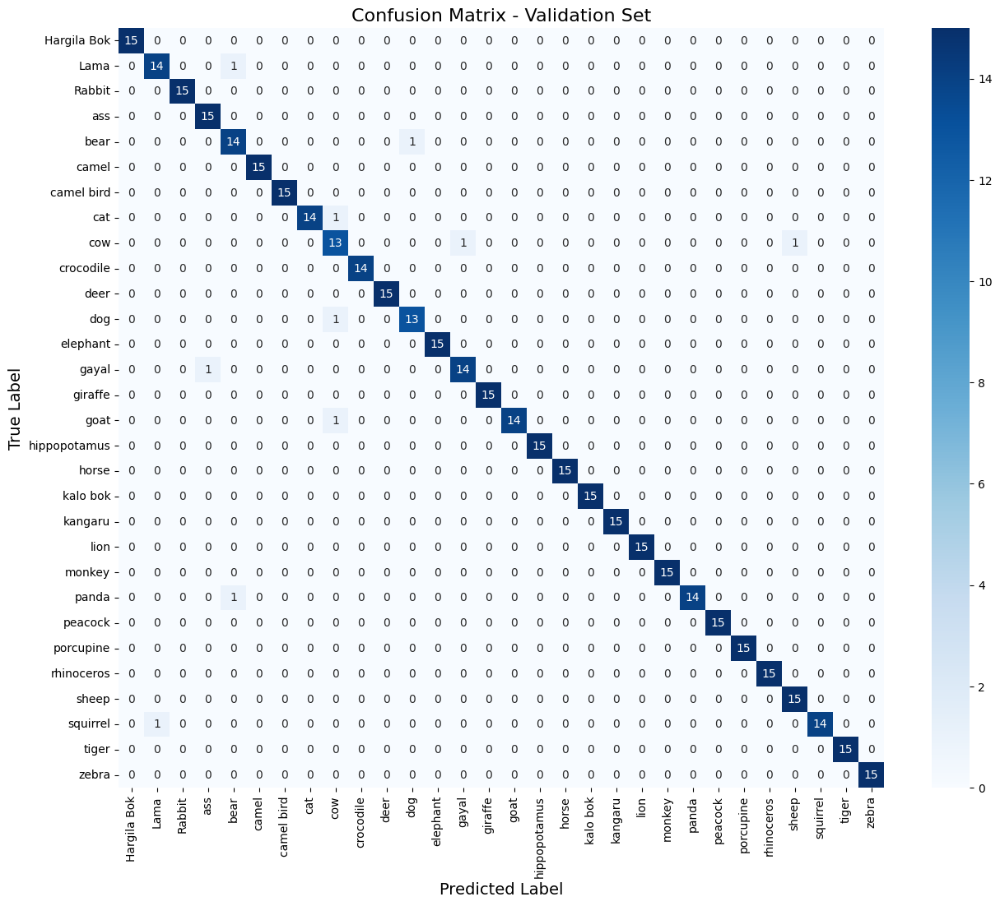

<Figure size 1500x1200 with 0 Axes>

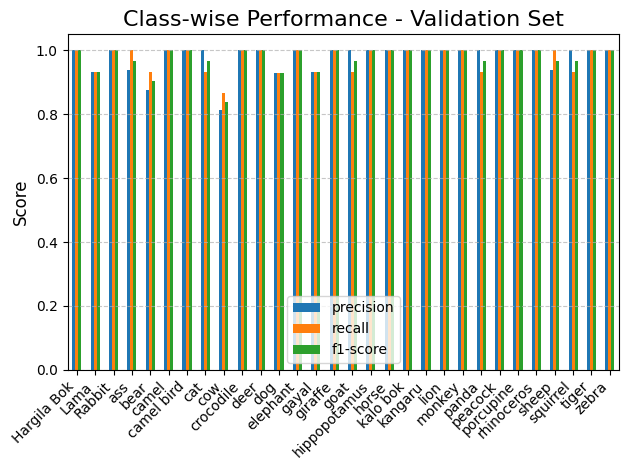

15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 83ms/step

📊 Classification Report for Test Set:
              precision    recall  f1-score   support

 Hargila Bok     1.0000    1.0000    1.0000        16
        Lama     0.9375    1.0000    0.9677        15
      Rabbit     1.0000    0.9375    0.9677        16
         ass     0.8333    0.9375    0.8824        16
        bear     1.0000    1.0000    1.0000        16
       camel     1.0000    1.0000    1.0000        16
  camel bird     0.9412    1.0000    0.9697        16
         cat     1.0000    1.0000    1.0000        15
         cow     0.9333    0.9333    0.9333        15
   crocodile     1.0000    1.0000    1.0000        15
        deer     1.0000    1.0000    1.0000        15
         dog     1.0000    1.0000    1.0000        14
    elephant     1.0000    1.0000    1.0000        15
       gayal     1.0000    0.9375    0.9677        16
     giraffe     1.0000    1.0000    1.0000        16
        goat     1.0000    0.9333    0.9655        15
hi

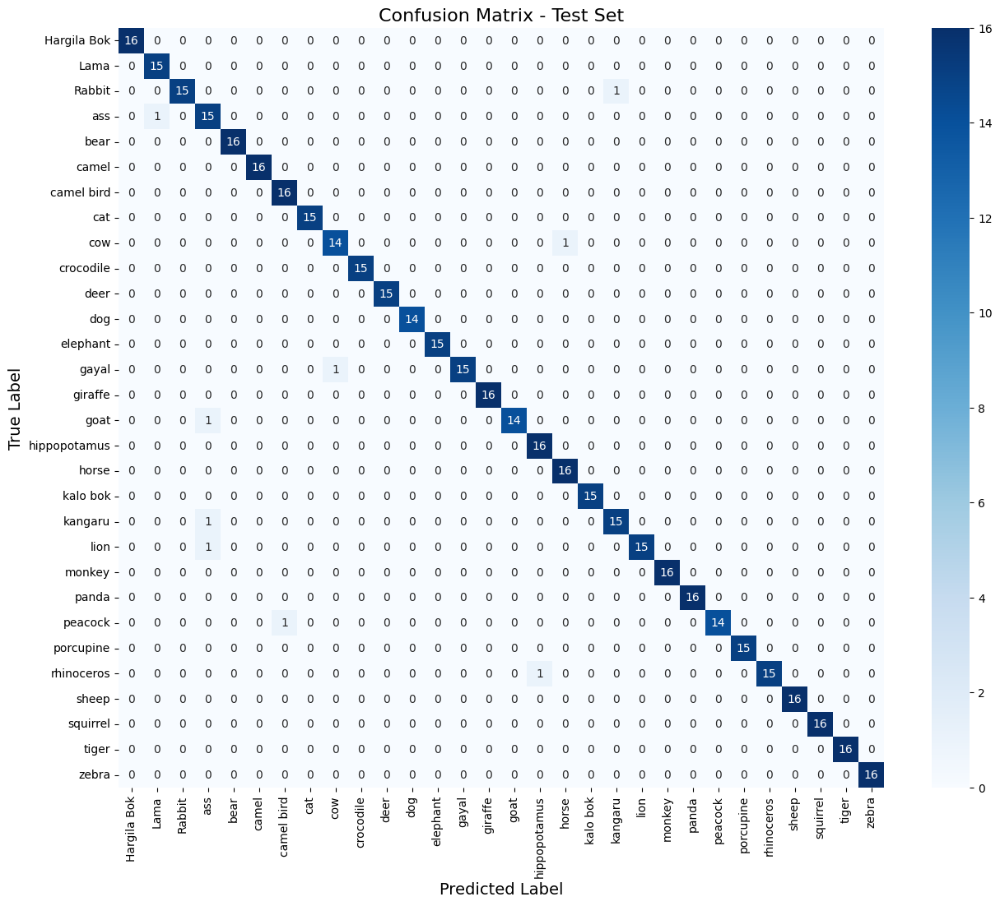

<Figure size 1500x1200 with 0 Axes>

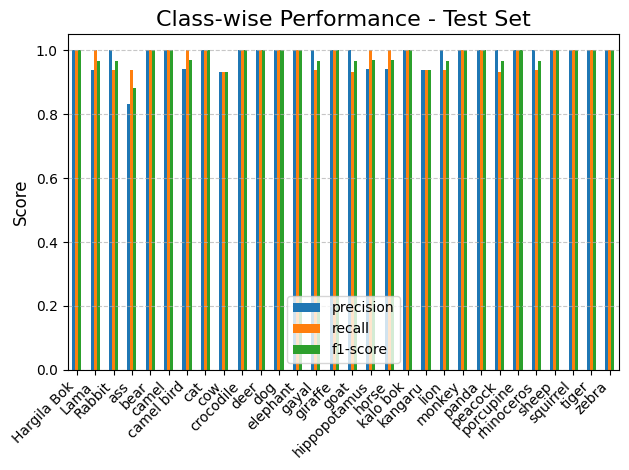

In [40]:
def evaluate_model(model, generator, dataset_name=""):
    # Get true labels and predictions
    y_true = generator.classes
    y_pred_probs = model.predict(generator)
    y_pred = np.argmax(y_pred_probs, axis=1)
    
    # Classification Report
    print(f"\n📊 Classification Report for {dataset_name} Set:")
    print(classification_report(y_true, y_pred, 
                              target_names=list(generator.class_indices.keys()),
                              digits=4))
    
    # Confusion Matrix
    plt.figure(figsize=(15, 12))
    cm = confusion_matrix(y_true, y_pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
               xticklabels=generator.class_indices.keys(),
               yticklabels=generator.class_indices.keys())
    plt.title(f'Confusion Matrix - {dataset_name} Set', fontsize=16)
    plt.xlabel('Predicted Label', fontsize=14)
    plt.ylabel('True Label', fontsize=14)
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.show()
    
    # Class-wise Performance
    report = classification_report(y_true, y_pred,
                                 target_names=list(generator.class_indices.keys()),
                                 output_dict=True)
    df = pd.DataFrame(report).transpose().iloc[:-3, :]
    
    plt.figure(figsize=(15, 12))
    df[['precision', 'recall', 'f1-score']].plot(kind='bar')
    plt.title(f'Class-wise Performance - {dataset_name} Set', fontsize=16)
    plt.ylabel('Score', fontsize=12)
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.grid(True, axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()


# Evaluate on Validation and Test Sets
evaluate_model(model, val_generator, "Validation")
evaluate_model(model, test_generator, "Test")


🔮 Sample Validation Predictions:
1/1 ━━━━━━━━━━━━━━━━━━━━ 16s 16s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


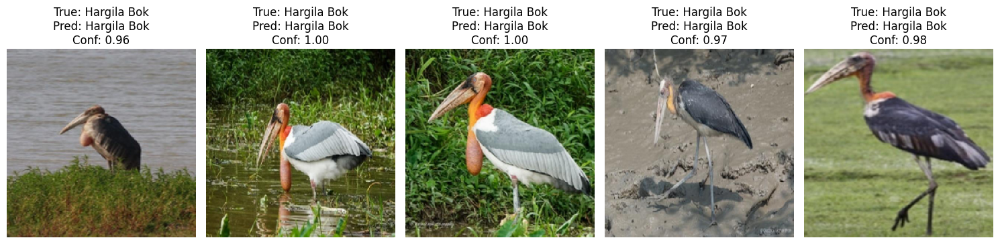


🔮 Sample Test Predictions:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


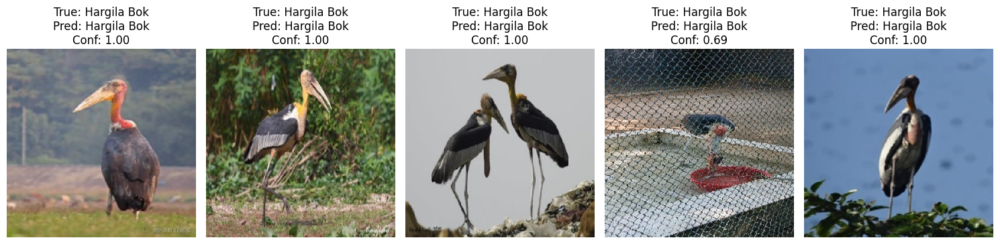

In [33]:
# Sample Predictions Visualization
def visualize_predictions(model, generator, num_samples=5):
    generator.reset()
    images, labels = next(generator)
    
    # Create inverse mapping for class indices
    class_indices_inv = {v: k for k, v in generator.class_indices.items()}
    
    plt.figure(figsize=(15, 8))
    for i in range(min(num_samples, len(images))):
        plt.subplot(1, num_samples, i+1)
        plt.imshow(images[i])
        
        true_class = class_indices_inv[labels[i]]
        pred_prob = model.predict(np.expand_dims(images[i], axis=0))[0]
        pred_class = class_indices_inv[np.argmax(pred_prob)]
        confidence = np.max(pred_prob)
        
        plt.title(f"True: {true_class}\nPred: {pred_class}\nConf: {confidence:.2f}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

print("\n🔮 Sample Validation Predictions:")
visualize_predictions(model, val_generator)

print("\n🔮 Sample Test Predictions:")
visualize_predictions(model, test_generator)

In [43]:
# Enhanced Visualization Functions
def plot_training_history(history):
    plt.figure(figsize=(18, 6))
    
    # Plot Accuracy
    plt.subplot(1, 3, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()
    
    # Plot Loss
    plt.subplot(1, 3, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()

    
    plt.tight_layout()
    plt.show()


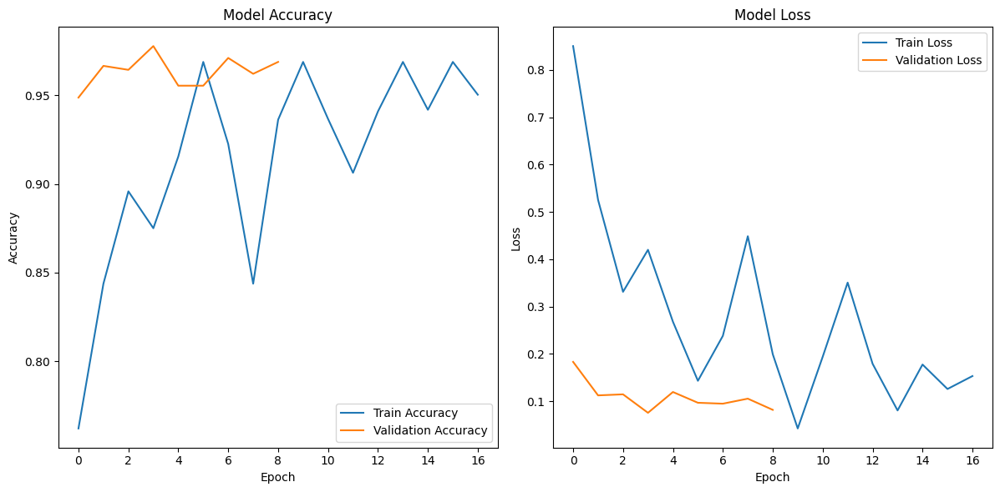

In [44]:
# Visualize Training History
plot_training_history(history)


Training Fold 1/5
Found 11511 validated image filenames belonging to 30 classes.
Found 2878 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 209s 501ms/step - accuracy: 0.5257 - loss: 1.8142 - val_accuracy: 0.9505 - val_loss: 0.1831
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 13s 36ms/step - accuracy: 0.8750 - loss: 0.4699

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 15s 41ms/step - accuracy: 0.8750 - loss: 0.4699 - val_accuracy: 1.0000 - val_loss: 0.0318
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 152s 415ms/step - accuracy: 0.8755 - loss: 0.3928 - val_accuracy: 0.9684 - val_loss: 0.1105
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 728us/step - accuracy: 0.8750 - loss: 0.4178 - val_accuracy: 1.0000 - val_loss: 0.0013
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 153s 417ms/step - accuracy: 0.9063 - loss: 0.2920 - val_accuracy: 0.9702 - val_loss: 0.0935
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 187us/step - accuracy: 0.9688 - loss: 0.1144 - val_accuracy: 1.0000 - val_loss: 0.0030
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 154s 421ms/step - accuracy: 0.9150 - loss: 0.2525 - val_accuracy: 0.9793 - val_loss: 0.0676
Epoch 8/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 771us/step - accuracy: 0.9062 - loss: 0.3410 - val_accuracy: 1.0000 - val_loss: 4.1306e-04
Epoch 9/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 154s 421ms/step - accuracy: 0.9312 - loss: 0.2220 -

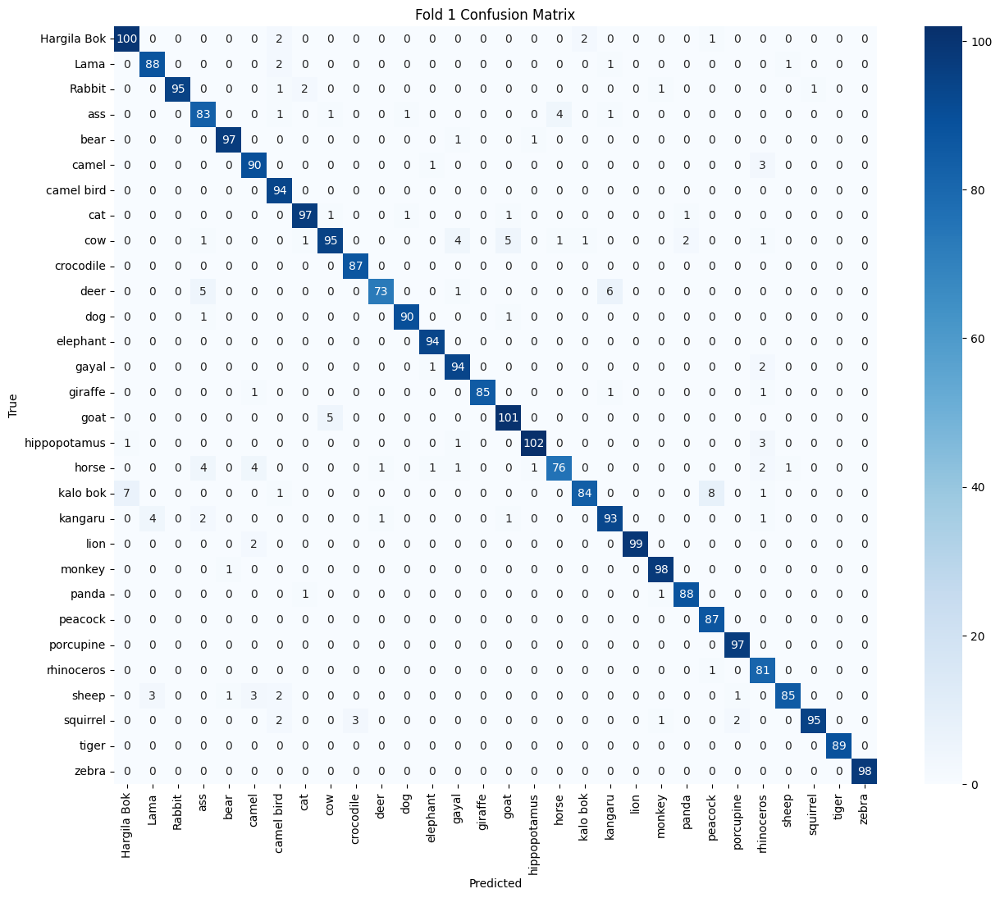


Training Fold 2/5
Found 11511 validated image filenames belonging to 30 classes.
Found 2878 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 203s 470ms/step - accuracy: 0.5308 - loss: 1.7588 - val_accuracy: 0.9515 - val_loss: 0.1843
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 15s 43ms/step - accuracy: 0.7500 - loss: 0.4975

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - accuracy: 0.7500 - loss: 0.4975 - val_accuracy: 1.0000 - val_loss: 0.0041
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 151s 414ms/step - accuracy: 0.8739 - loss: 0.4067 - val_accuracy: 0.9688 - val_loss: 0.1045
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 723us/step - accuracy: 0.9688 - loss: 0.1831 - val_accuracy: 1.0000 - val_loss: 0.0027
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 151s 412ms/step - accuracy: 0.9020 - loss: 0.3020 - val_accuracy: 0.9793 - val_loss: 0.0736
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 747us/step - accuracy: 0.9062 - loss: 0.2303 - val_accuracy: 1.0000 - val_loss: 3.7617e-04
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 154s 419ms/step - accuracy: 0.9190 - loss: 0.2492 - val_accuracy: 0.9824 - val_loss: 0.0614
Epoch 8/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 753us/step - accuracy: 0.9375 - loss: 0.0932 - val_accuracy: 1.0000 - val_loss: 2.0969e-04
Epoch 9/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 153s 419ms/step - accuracy: 0.9310 - loss: 0.211

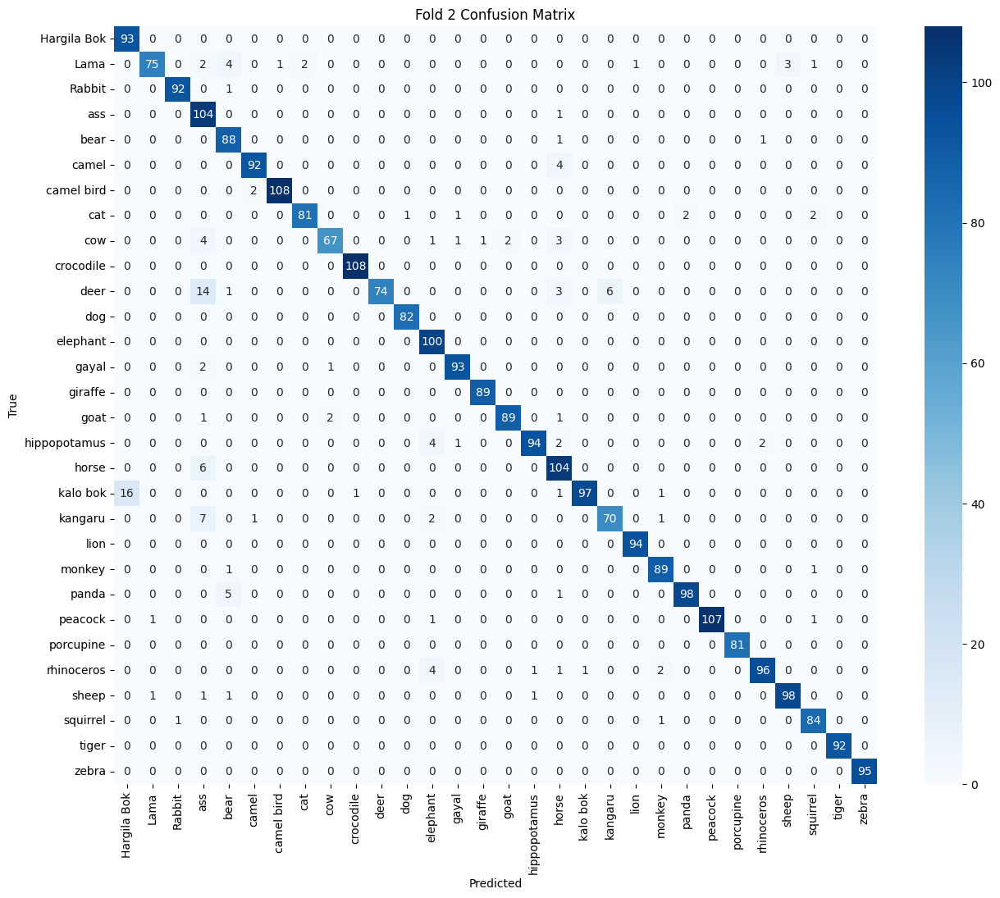


Training Fold 3/5
Found 11511 validated image filenames belonging to 30 classes.
Found 2878 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 201s 466ms/step - accuracy: 0.5325 - loss: 1.8069 - val_accuracy: 0.9540 - val_loss: 0.1791
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 12s 35ms/step - accuracy: 0.8438 - loss: 0.4535

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - accuracy: 0.8438 - loss: 0.4535 - val_accuracy: 1.0000 - val_loss: 0.0027
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 153s 419ms/step - accuracy: 0.8764 - loss: 0.3997 - val_accuracy: 0.9624 - val_loss: 0.1212
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 709us/step - accuracy: 0.9688 - loss: 0.1576 - val_accuracy: 1.0000 - val_loss: 5.3242e-04
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 151s 412ms/step - accuracy: 0.9100 - loss: 0.2896 - val_accuracy: 0.9754 - val_loss: 0.0857
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 673us/step - accuracy: 0.9688 - loss: 0.1165 - val_accuracy: 1.0000 - val_loss: 4.1164e-04
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 151s 413ms/step - accuracy: 0.9256 - loss: 0.2322 - val_accuracy: 0.9719 - val_loss: 0.0878
Epoch 8/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 718us/step - accuracy: 0.8125 - loss: 0.3170 - val_accuracy: 1.0000 - val_loss: 1.2500e-04
Epoch 9/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 149s 409ms/step - accuracy: 0.9241 - loss: 0

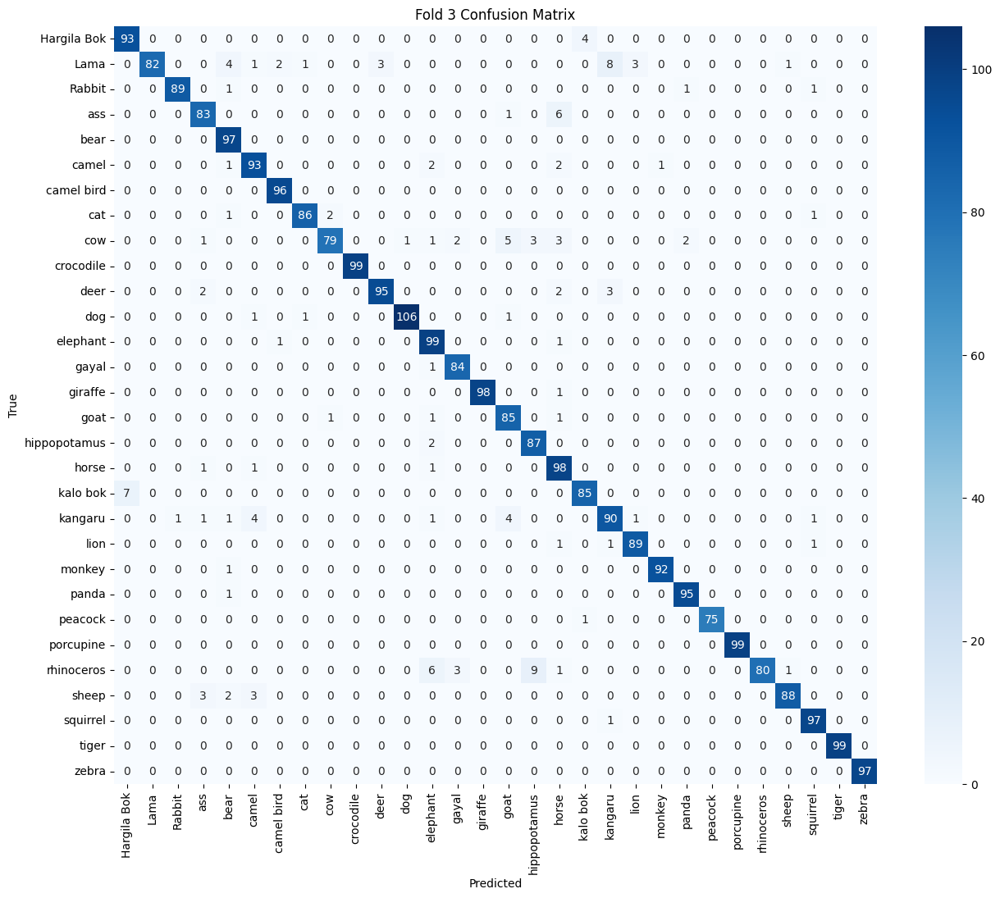


Training Fold 4/5
Found 11511 validated image filenames belonging to 30 classes.
Found 2878 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 199s 463ms/step - accuracy: 0.5295 - loss: 1.7966 - val_accuracy: 0.9544 - val_loss: 0.1717
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 16s 47ms/step - accuracy: 0.7500 - loss: 0.7251

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - accuracy: 0.7500 - loss: 0.7251 - val_accuracy: 1.0000 - val_loss: 0.0035
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 150s 410ms/step - accuracy: 0.8730 - loss: 0.4040 - val_accuracy: 0.9705 - val_loss: 0.1023
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 717us/step - accuracy: 0.8438 - loss: 0.3633 - val_accuracy: 1.0000 - val_loss: 0.0023
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 151s 413ms/step - accuracy: 0.9025 - loss: 0.3023 - val_accuracy: 0.9768 - val_loss: 0.0786
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 709us/step - accuracy: 0.9688 - loss: 0.0915 - val_accuracy: 1.0000 - val_loss: 2.3652e-04
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 150s 410ms/step - accuracy: 0.9177 - loss: 0.2554 - val_accuracy: 0.9814 - val_loss: 0.0620
Epoch 8/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 216us/step - accuracy: 0.9375 - loss: 0.1599 - val_accuracy: 1.0000 - val_loss: 9.1223e-04
Epoch 9/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 152s 416ms/step - accuracy: 0.9331 - loss: 0.213

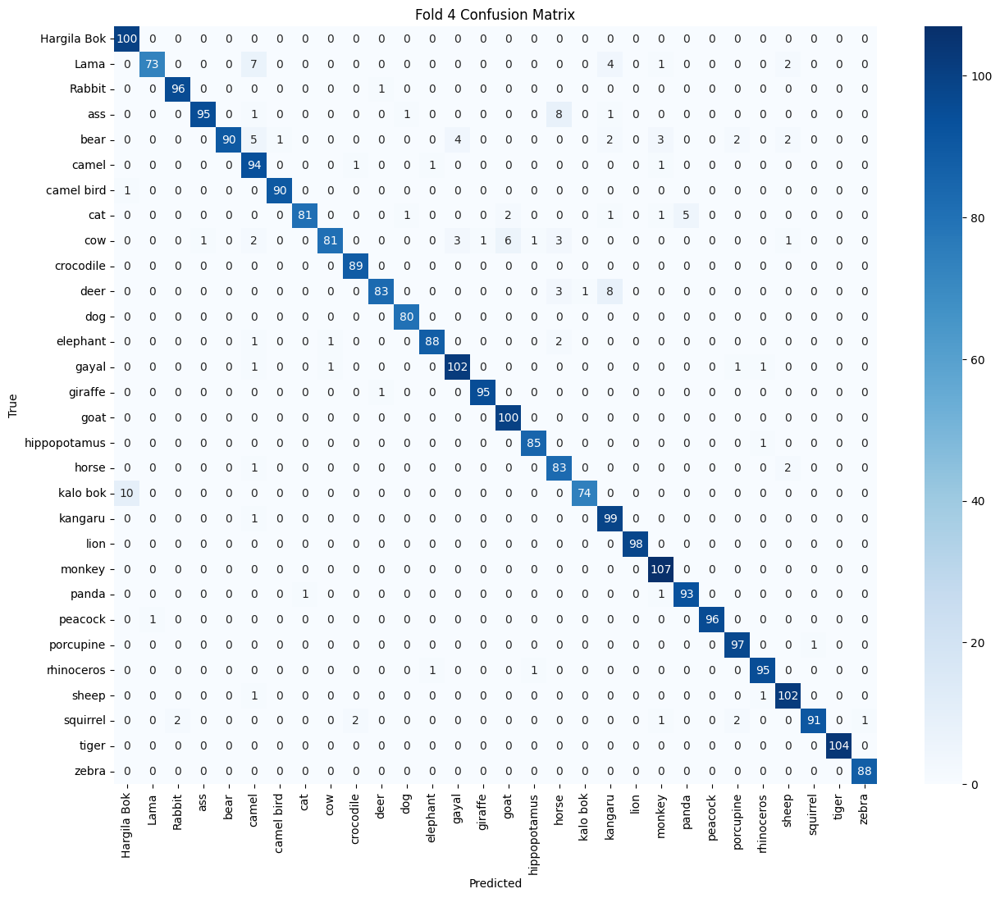


Training Fold 5/5
Found 11512 validated image filenames belonging to 30 classes.
Found 2877 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 211s 493ms/step - accuracy: 0.5356 - loss: 1.7622 - val_accuracy: 0.9494 - val_loss: 0.1789
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 15s 43ms/step - accuracy: 0.8125 - loss: 0.6765

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 15s 41ms/step - accuracy: 0.8125 - loss: 0.6765 - val_accuracy: 1.0000 - val_loss: 0.0050
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 152s 416ms/step - accuracy: 0.8797 - loss: 0.3898 - val_accuracy: 0.9666 - val_loss: 0.1092
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 700us/step - accuracy: 0.9062 - loss: 0.2592 - val_accuracy: 1.0000 - val_loss: 0.0048
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 152s 416ms/step - accuracy: 0.9053 - loss: 0.3052 - val_accuracy: 0.9733 - val_loss: 0.0818
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 775us/step - accuracy: 1.0000 - loss: 0.0975 - val_accuracy: 1.0000 - val_loss: 0.0011
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 155s 423ms/step - accuracy: 0.9222 - loss: 0.2533 - val_accuracy: 0.9740 - val_loss: 0.0758
Epoch 8/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 749us/step - accuracy: 0.9688 - loss: 0.1106 - val_accuracy: 1.0000 - val_loss: 5.6461e-04
Epoch 9/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 152s 416ms/step - accuracy: 0.9236 - loss: 0.2320 -

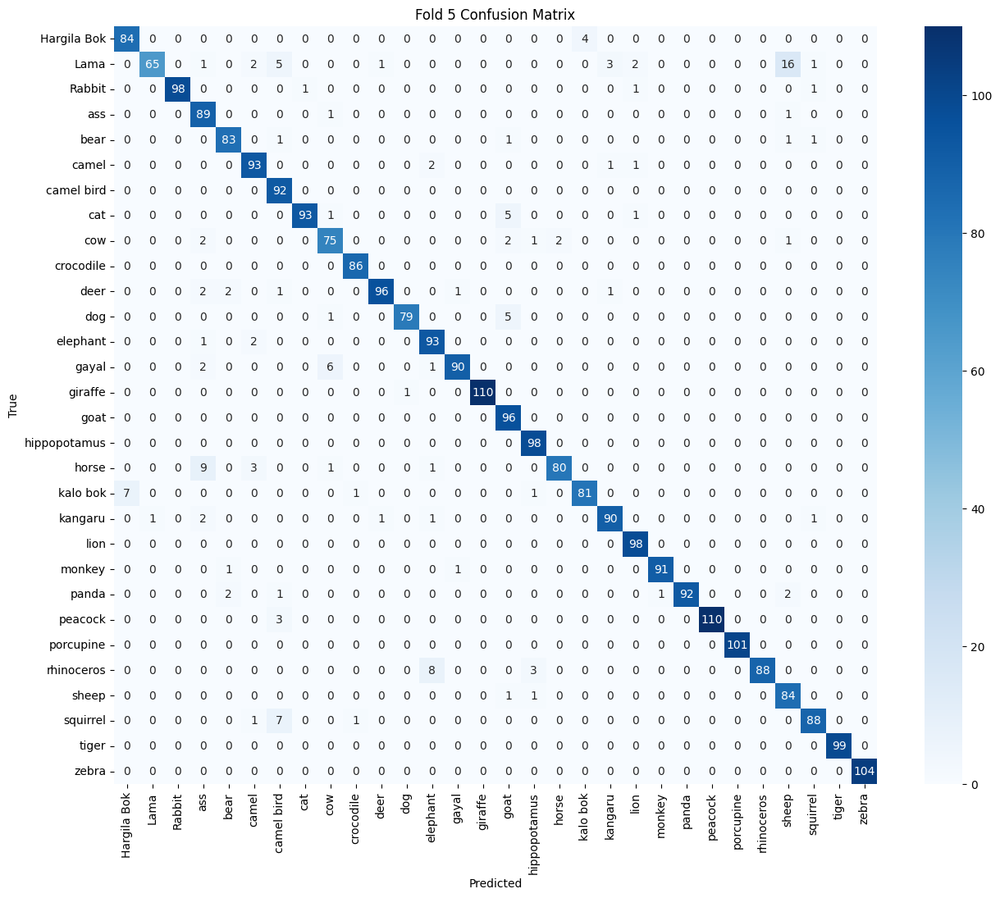


Cross-Validation Results:
   fold  val_loss  val_accuracy
0     1  0.181627      0.950313
1     2  0.181783      0.949965
2     3  0.178742      0.950313
3     4  0.167628      0.955177
4     5  0.177703      0.947515

Mean Metrics Across Folds:
val_loss        0.177497
val_accuracy    0.950657
dtype: float64


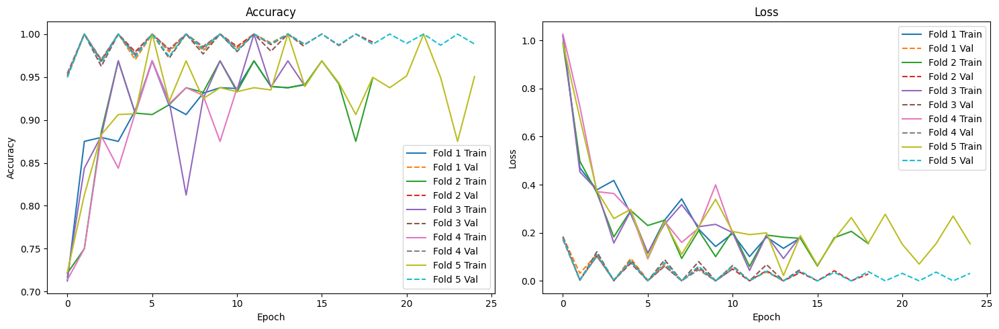


Evaluating on Test Set...
Found 468 images belonging to 30 classes.


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


15/15 ━━━━━━━━━━━━━━━━━━━━ 23s 887ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 28s 890ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 23s 859ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 24s 859ms/step

Ensemble Classification Report:
              precision    recall  f1-score   support

 Hargila Bok     0.9412    1.0000    0.9697        16
        Lama     0.9231    0.8000    0.8571        15
      Rabbit     1.0000    1.0000    1.0000        16
         ass     0.8235    0.8750    0.8485        16
        bear     0.9412    1.0000    0.9697        16
       camel     0.9412    1.0000    0.9697        16
  camel bird     0.8889    1.0000    0.9412        16
         cat     1.0000    1.0000    1.0000        15
         cow     0.9286    0.8667    0.8966        15
   crocodile     1.0000    1.0000    1.0000        15
        deer     1.0000    1.0000    1.0000        15
         dog     1.0000    1.0000    1.0000        14
    elephant     1.0000    1.0000    1.0000        15
   

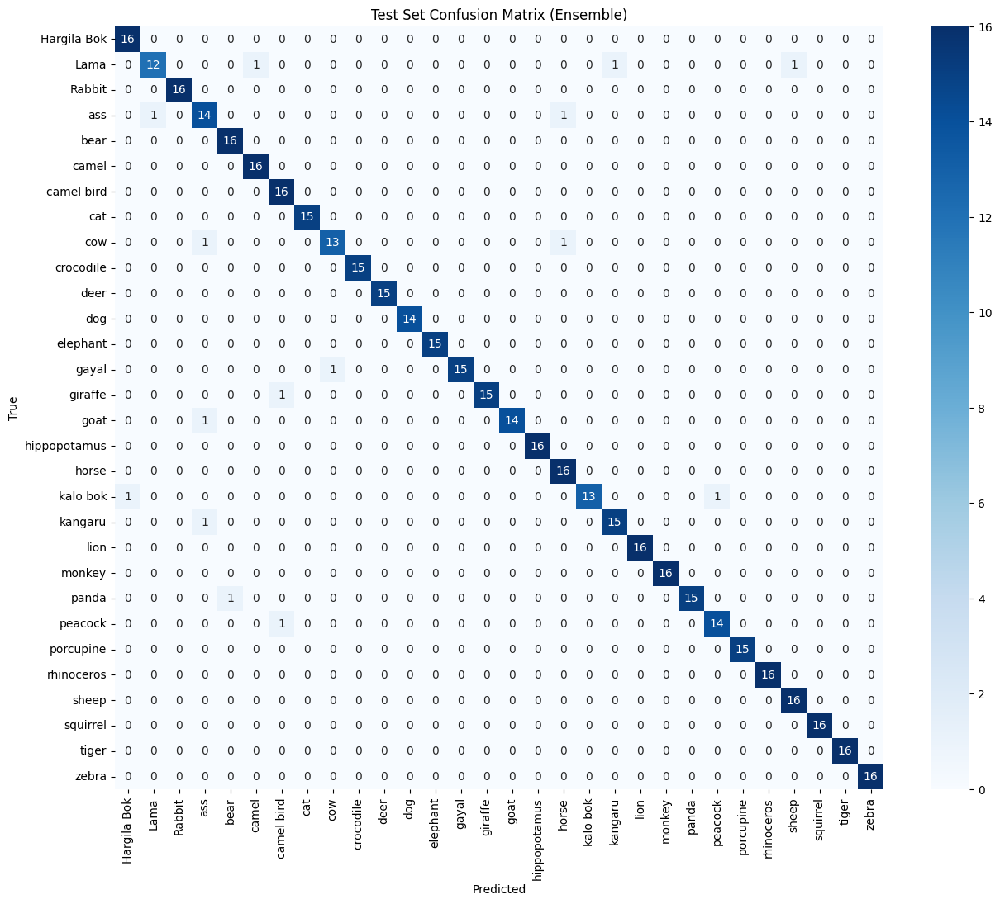


All models saved in /kaggle/working/


In [48]:
import tensorflow as tf
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.model_selection import KFold
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import os

# Configuration
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
EPOCHS = 50
NUM_CLASSES = 30
K_FOLDS = 5

# Kaggle Directory Setup
base_dir = "/kaggle/input/animal-classification-dataset/Animal Classification"
train_dir = "/kaggle/working/Animal Classification/train_augmented"
val_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/validation"
test_dir = "/kaggle/input/animal-classification-dataset/Animal Classification/test"

# Data Preparation for K-Fold
def get_file_paths_and_labels(directory):
    file_paths = []
    labels = []
    class_names = sorted(os.listdir(directory))
    class_indices = {name: i for i, name in enumerate(class_names)}
    
    for class_name in class_names:
        class_dir = os.path.join(directory, class_name)
        if os.path.isdir(class_dir):
            for fname in os.listdir(class_dir):
                if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
                    file_paths.append(os.path.join(class_dir, fname))
                    labels.append(class_name)  # Store class names instead of indices
    
    return np.array(file_paths), np.array(labels), class_names

file_paths, labels, class_names = get_file_paths_and_labels(train_dir)
kfold = KFold(n_splits=K_FOLDS, shuffle=True, random_state=42)

# Data Generator for K-Fold
def create_datagen():
    return tf.keras.preprocessing.image.ImageDataGenerator(
        rescale=1./255,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        brightness_range=[0.8, 1.2]
    )

# K-Fold Cross Validation
fold_results = []
all_histories = []
all_confusion_matrices = []

for fold, (train_idx, val_idx) in enumerate(kfold.split(file_paths, labels)):
    print(f"\n{'='*40}")
    print(f"Training Fold {fold+1}/{K_FOLDS}")
    print(f"{'='*40}")
    
    # Create dataframes for this fold
    train_df = pd.DataFrame({
        'filename': file_paths[train_idx],
        'class': labels[train_idx]  # Using class names
    })
    val_df = pd.DataFrame({
        'filename': file_paths[val_idx],
        'class': labels[val_idx]  # Using class names
    })
    
    # Create data generators
    train_datagen = create_datagen()
    val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)
    
    train_generator = train_datagen.flow_from_dataframe(
        dataframe=train_df,
        x_col='filename',
        y_col='class',
        target_size=IMG_SIZE,
        class_mode='sparse',
        batch_size=BATCH_SIZE,
        shuffle=True,
        classes=class_names  # Provide class names
    )
    
    val_generator = val_datagen.flow_from_dataframe(
        dataframe=val_df,
        x_col='filename',
        y_col='class',
        target_size=IMG_SIZE,
        class_mode='sparse',
        batch_size=BATCH_SIZE,
        shuffle=False,
        classes=class_names  # Provide class names
    )
    
    # Build Model
    base_model = DenseNet121(
        weights='imagenet',
        include_top=False,
        input_shape=(*IMG_SIZE, 3)
    )
    base_model.trainable = False

    model = models.Sequential([
        base_model,
        layers.GlobalAveragePooling2D(),
        layers.Dense(512, activation='relu'),
        layers.Dropout(0.5),
        layers.Dense(NUM_CLASSES, activation='softmax')
    ])
    
    model.compile(
        optimizer=Adam(learning_rate=0.001),
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy']
    )
    
    # Callbacks
    callbacks = [
        EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
        ModelCheckpoint(f'best_fold_{fold+1}.keras', save_best_only=True, monitor='val_accuracy')
    ]
    
    # Train
    history = model.fit(
        train_generator,
        steps_per_epoch=train_generator.samples // BATCH_SIZE,
        validation_data=val_generator,
        validation_steps=val_generator.samples // BATCH_SIZE,
        epochs=EPOCHS,
        callbacks=callbacks,
        verbose=1
    )
    all_histories.append(history.history)
    
    # Evaluate
    model = models.load_model(f'best_fold_{fold+1}.keras')
    val_results = model.evaluate(val_generator, verbose=0)
    
    # Store metrics
    fold_results.append({
        'fold': fold+1,
        'val_loss': val_results[0],
        'val_accuracy': val_results[1]
    })
    
    # Confusion matrix
    y_pred = model.predict(val_generator)
    y_pred_classes = np.argmax(y_pred, axis=1)
    cm = confusion_matrix(val_generator.classes, y_pred_classes)
    all_confusion_matrices.append(cm)
    
    # Plot confusion matrix
    plt.figure(figsize=(15, 12))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,
                yticklabels=class_names)
    plt.title(f'Fold {fold+1} Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.show()

# K-Fold Results Analysis
results_df = pd.DataFrame(fold_results)
print("\nCross-Validation Results:")
print(results_df)
print("\nMean Metrics Across Folds:")
print(results_df.mean()[1:])

# Plot training histories
plt.figure(figsize=(15, 5))
for i, history in enumerate(all_histories):
    plt.subplot(1, 2, 1)
    plt.plot(history['accuracy'], label=f'Fold {i+1} Train')
    plt.plot(history['val_accuracy'], '--', label=f'Fold {i+1} Val')
    plt.title('Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(history['loss'], label=f'Fold {i+1} Train')
    plt.plot(history['val_loss'], '--', label=f'Fold {i+1} Val')
    plt.title('Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()

plt.tight_layout()
plt.show()

# Final Evaluation on Test Set
print("\nEvaluating on Test Set...")
test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='sparse',
    shuffle=False
)

# Ensemble predictions from all folds
all_test_preds = []
for fold in range(K_FOLDS):
    model = models.load_model(f'best_fold_{fold+1}.keras')
    preds = model.predict(test_generator)
    all_test_preds.append(preds)
    test_generator.reset()

# Average predictions
ensemble_preds = np.mean(all_test_preds, axis=0)
y_pred_classes = np.argmax(ensemble_preds, axis=1)
y_true = test_generator.classes

# Classification report
print("\nEnsemble Classification Report:")
print(classification_report(y_true, y_pred_classes, target_names=class_names, digits=4))

# Confusion matrix
plt.figure(figsize=(15, 12))
cm = confusion_matrix(y_true, y_pred_classes)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_names,
            yticklabels=class_names)
plt.title('Test Set Confusion Matrix (Ensemble)')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

# Save all models
for fold in range(K_FOLDS):
    os.rename(f'best_fold_{fold+1}.keras', f'/kaggle/working/best_fold_{fold+1}.keras')

print("\nAll models saved in /kaggle/working/")

## **InceptionV3**

In [2]:
import tensorflow as tf
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
from sklearn.preprocessing import label_binarize
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import os
from itertools import cycle

# Configuration
IMG_SIZE = (299, 299)  # InceptionV3 requires 299x299
BATCH_SIZE = 32
EPOCHS = 50
NUM_CLASSES = 30

In [3]:
# Data Paths
train_dir = '/kaggle/working/Animal Classification/train_augmented'
val_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/validation'
test_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/test'

# Data Generators with Correct Class Mode
def create_generators():
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=30,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest'
    )

    val_test_datagen = ImageDataGenerator(rescale=1./255)

    train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        class_mode='categorical',  # Changed to categorical
        shuffle=True
    )

    val_generator = val_test_datagen.flow_from_directory(
        val_dir,
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        class_mode='categorical',  # Changed to categorical
        shuffle=False
    )

    test_generator = val_test_datagen.flow_from_directory(
        test_dir,
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        class_mode='categorical',  # Changed to categorical
        shuffle=False
    )
    
    return train_generator, val_generator, test_generator

train_gen, val_gen, test_gen = create_generators()
class_names = list(train_gen.class_indices.keys())

Found 14391 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.


In [4]:
# InceptionV3 Model Architecture
def build_inceptionv3():
    base_model = InceptionV3(
        weights='imagenet',
        include_top=False,
        input_shape=(*IMG_SIZE, 3)
    )
    
    base_model.trainable = False
    
    model = models.Sequential([
        base_model,
        layers.GlobalAveragePooling2D(),
        layers.Dense(1024, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.5),
        layers.Dense(NUM_CLASSES, activation='softmax')
    ])
    
    return model

model = build_inceptionv3()

# Compile with Proper Loss Function
model.compile(
    optimizer=Adam(learning_rate=0.0001),
    loss='categorical_crossentropy',  # Changed to categorical
    metrics=[
        'accuracy',
        tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall'),
        tf.keras.metrics.AUC(name='auc')
    ]
)

# Enhanced Callbacks
callbacks = [
    EarlyStopping(patience=7, monitor='val_auc', mode='max', restore_best_weights=True),
    ModelCheckpoint('best_inceptionv3_model.keras', 
                  save_best_only=True, 
                  monitor='val_auc',
                  mode='max'),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3)
]

# Model Training
history = model.fit(
    train_gen,
    steps_per_epoch=train_gen.samples // BATCH_SIZE,
    validation_data=val_gen,
    validation_steps=val_gen.samples // BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=callbacks,
    verbose=1
)

I0000 00:00:1747391649.712563      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1747391649.713196      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1747391670.972183     137 service.cc:148] XLA service 0x7b96540173b0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1747391670.973063     137 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1747391670.973091     137 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1747391672.969513     137 cuda_dnn.cc:529] Loaded cuDNN version 90300


  1/449 ━━━━━━━━━━━━━━━━━━━━ 3:39:12 29s/step - accuracy: 0.0000e+00 - auc: 0.4699 - loss: 4.7166 - precision: 0.0000e+00 - recall: 0.0000e+00

I0000 00:00:1747391683.771282     137 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


449/449 ━━━━━━━━━━━━━━━━━━━━ 336s 685ms/step - accuracy: 0.6645 - auc: 0.9281 - loss: 1.3595 - precision: 0.8316 - recall: 0.5784 - val_accuracy: 0.9710 - val_auc: 0.9999 - val_loss: 0.0976 - val_precision: 0.9818 - val_recall: 0.9621 - learning_rate: 1.0000e-04
Epoch 2/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 161us/step - accuracy: 0.9375 - auc: 0.9811 - loss: 0.4883 - precision: 0.9667 - recall: 0.9062 - learning_rate: 1.0000e-04
Epoch 3/50


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_auc` which is not available. Available metrics are: accuracy,auc,loss,precision,recall
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_auc available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/callback_list.py:96: UserWarning: Learning rate reduction is conditioned on metric `val_loss` which is not available. Available metrics are: accura

449/449 ━━━━━━━━━━━━━━━━━━━━ 292s 640ms/step - accuracy: 0.9220 - auc: 0.9966 - loss: 0.2661 - precision: 0.9478 - recall: 0.9020 - val_accuracy: 0.9777 - val_auc: 0.9999 - val_loss: 0.0823 - val_precision: 0.9775 - val_recall: 0.9688 - learning_rate: 1.0000e-04
Epoch 4/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 95us/step - accuracy: 0.9375 - auc: 0.9989 - loss: 0.2588 - precision: 0.9677 - recall: 0.9375 - learning_rate: 1.0000e-04
Epoch 5/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 287s 629ms/step - accuracy: 0.9374 - auc: 0.9980 - loss: 0.2018 - precision: 0.9546 - recall: 0.9225 - val_accuracy: 0.9844 - val_auc: 0.9988 - val_loss: 0.0651 - val_precision: 0.9888 - val_recall: 0.9821 - learning_rate: 1.0000e-04
Epoch 6/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 93us/step - accuracy: 0.9062 - auc: 0.9994 - loss: 0.2162 - precision: 0.9667 - recall: 0.9062 - learning_rate: 1.0000e-04
Epoch 7/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 287s 630ms/step - accuracy: 0.9474 - auc: 0.9985 - loss: 0.1624 - precision: 0.9610 - recal


 Validation Set Evaluation:
14/14 ━━━━━━━━━━━━━━━━━━━━ 8s 144ms/step

📊 Validation Classification Report:
              precision    recall  f1-score   support

 Hargila Bok     0.9375    1.0000    0.9677        15
        Lama     0.9375    1.0000    0.9677        15
      Rabbit     1.0000    1.0000    1.0000        15
         ass     0.9231    0.8000    0.8571        15
        bear     1.0000    1.0000    1.0000        15
       camel     1.0000    1.0000    1.0000        15
  camel bird     0.9375    1.0000    0.9677        15
         cat     1.0000    1.0000    1.0000        15
         cow     0.9333    0.9333    0.9333        15
   crocodile     1.0000    1.0000    1.0000        14
        deer     0.9375    1.0000    0.9677        15
         dog     1.0000    1.0000    1.0000        14
    elephant     0.9375    1.0000    0.9677        15
       gayal     0.9333    0.9333    0.9333        15
     giraffe     1.0000    0.9333    0.9655        15
        goat     1.0000    0

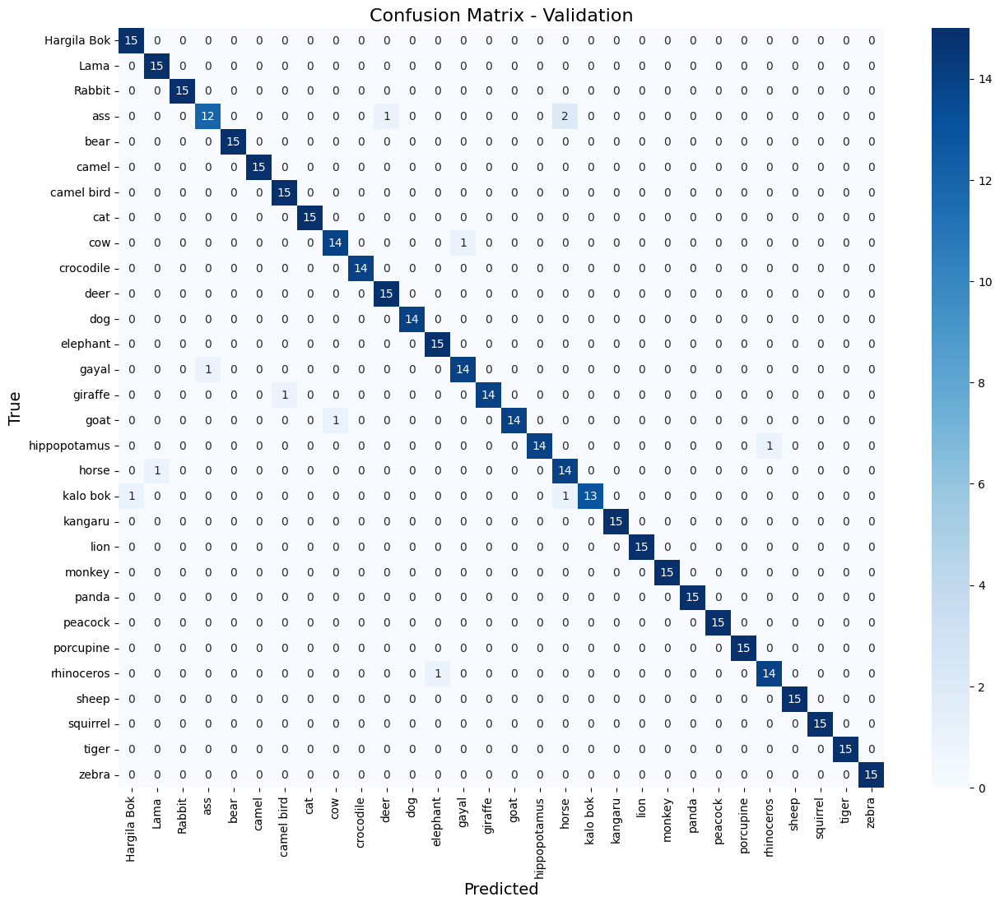

<Figure size 1500x600 with 0 Axes>

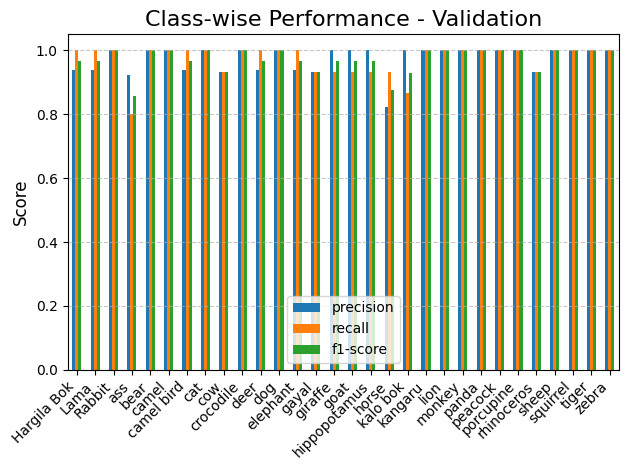

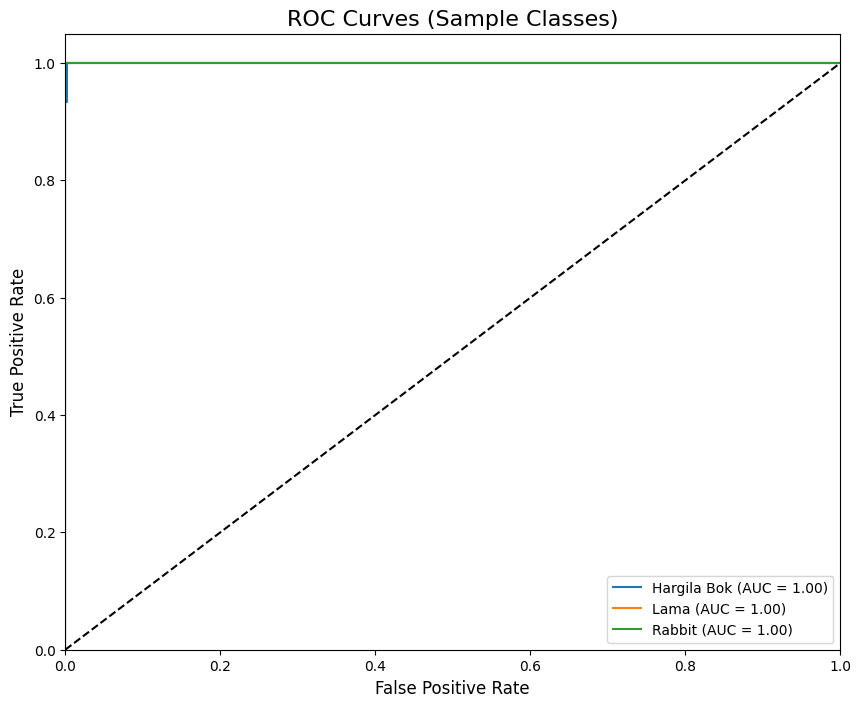


 Test Set Evaluation:
 1/15 ━━━━━━━━━━━━━━━━━━━━ 2s 179ms/step

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


15/15 ━━━━━━━━━━━━━━━━━━━━ 17s 1s/step 

📊 Test Classification Report:
              precision    recall  f1-score   support

 Hargila Bok     0.9375    0.9375    0.9375        16
        Lama     1.0000    0.9333    0.9655        15
      Rabbit     1.0000    1.0000    1.0000        16
         ass     0.8824    0.9375    0.9091        16
        bear     1.0000    1.0000    1.0000        16
       camel     0.9412    1.0000    0.9697        16
  camel bird     0.9412    1.0000    0.9697        16
         cat     1.0000    1.0000    1.0000        15
         cow     0.9333    0.9333    0.9333        15
   crocodile     1.0000    1.0000    1.0000        15
        deer     1.0000    1.0000    1.0000        15
         dog     1.0000    1.0000    1.0000        14
    elephant     1.0000    1.0000    1.0000        15
       gayal     1.0000    0.9375    0.9677        16
     giraffe     1.0000    0.9375    0.9677        16
        goat     1.0000    0.8667    0.9286        15
hippopotam

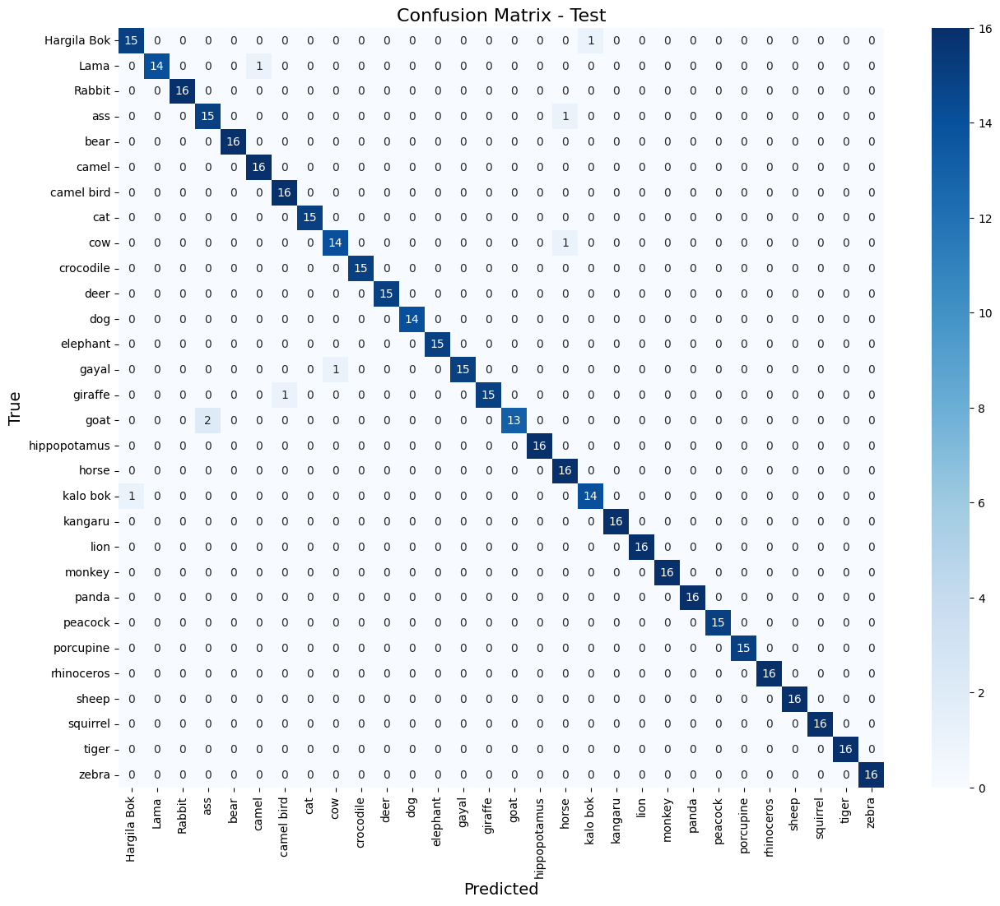

<Figure size 1500x600 with 0 Axes>

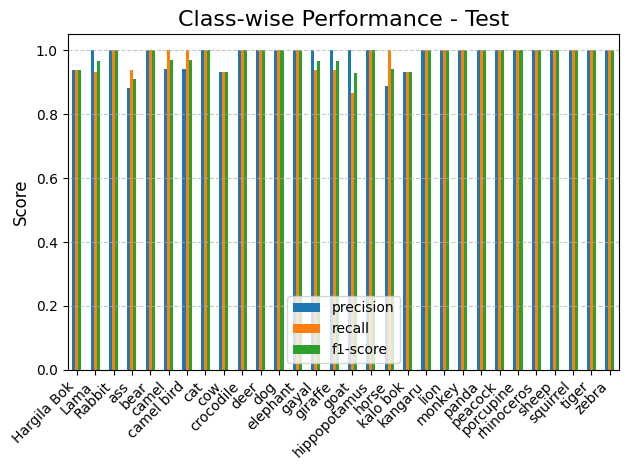

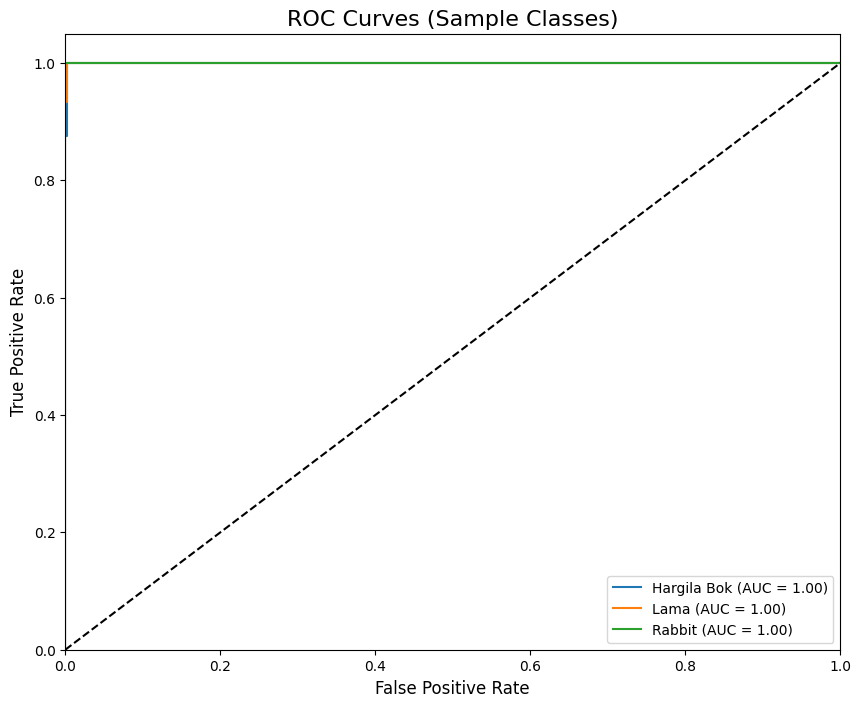

In [5]:
# Corrected Evaluation Function
def full_evaluation(model, generator, dataset_name):
    generator.reset()
    y_true = generator.classes  # Directly get class indices
    y_pred_probs = model.predict(generator)
    y_pred = np.argmax(y_pred_probs, axis=1)
    
    print(f"\n📊 {dataset_name} Classification Report:")
    print(classification_report(y_true, y_pred, 
                               target_names=class_names, 
                               digits=4))
    
    # Confusion Matrix
    plt.figure(figsize=(15, 12))
    cm = confusion_matrix(y_true, y_pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,
                yticklabels=class_names)
    plt.title(f'Confusion Matrix - {dataset_name}', fontsize=16)
    plt.xlabel('Predicted', fontsize=14)
    plt.ylabel('True', fontsize=14)
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.show()
    
    # Class-wise Metrics
    report = classification_report(y_true, y_pred,
                                 target_names=class_names,
                                 output_dict=True)
    df = pd.DataFrame(report).transpose().iloc[:-3, :]
    
    plt.figure(figsize=(15, 6))
    df[['precision', 'recall', 'f1-score']].plot(kind='bar')
    plt.title(f'Class-wise Performance - {dataset_name}', fontsize=16)
    plt.ylabel('Score', fontsize=12)
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()
    
    # ROC Curves for First 3 Classes
    y_true_bin = label_binarize(y_true, classes=np.arange(len(class_names)))
    y_pred_probs = y_pred_probs[:, :len(class_names)]  # Ensure shape matches
    
    plt.figure(figsize=(10, 8))
    colors = cycle(['#1f77b4', '#ff7f0e', '#2ca02c'])
    for i, color in zip(range(3), colors):
        fpr, tpr, _ = roc_curve(y_true_bin[:, i], y_pred_probs[:, i])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, color=color,
                 label=f'{class_names[i]} (AUC = {roc_auc:.2f})')
    
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12)
    plt.ylabel('True Positive Rate', fontsize=12)
    plt.title('ROC Curves (Sample Classes)', fontsize=16)
    plt.legend(loc="lower right")
    plt.show()
    
    return y_true, y_pred

# Run Evaluations
# print("\n🔍 Training Set Evaluation:")
# train_true, train_pred = full_evaluation(model, train_gen, "Training")

print("\n Validation Set Evaluation:")
val_true, val_pred = full_evaluation(model, val_gen, "Validation")

print("\n Test Set Evaluation:")
test_true, test_pred = full_evaluation(model, test_gen, "Test")



🎯 Sample Validation Predictions:
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


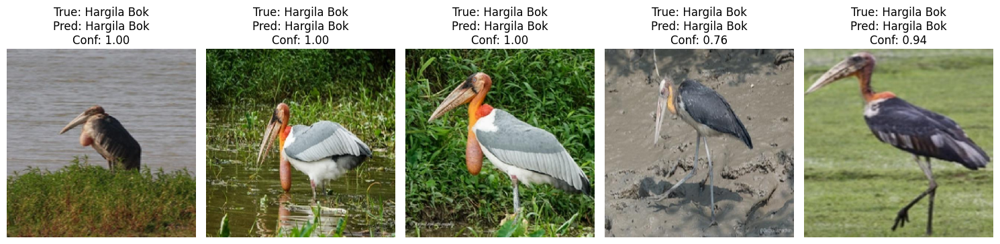

In [8]:
# Sample Predictions
def visualize_predictions(generator, num_samples=5):
    generator.reset()
    images, true_labels = next(generator)
    pred_probs = model.predict(images)
    pred_labels = np.argmax(pred_probs, axis=1)
    true_labels = np.argmax(true_labels, axis=1)
    
    plt.figure(figsize=(15, 8))
    for i in range(num_samples):
        plt.subplot(1, num_samples, i+1)
        plt.imshow(images[i])
        true_class = class_names[true_labels[i]]
        pred_class = class_names[pred_labels[i]]
        confidence = np.max(pred_probs[i])
        plt.title(f"True: {true_class}\nPred: {pred_class}\nConf: {confidence:.2f}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

print("\n🎯 Sample Validation Predictions:")
visualize_predictions(val_gen)

In [9]:
# Model Saving
model.save('/kaggle/working/animal_classifier_inceptionv3_model.keras')
print("\n✅ Model saved successfully!")


✅ Model saved successfully!


### **K-Cross Validation**

Found 468 images belonging to 30 classes.

Training Fold 1/5
Found 11512 validated image filenames belonging to 30 classes.
Found 2879 validated image filenames belonging to 30 classes.
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 277s 712ms/step - accuracy: 0.6213 - auc: 0.9159 - loss: 1.5164 - val_accuracy: 0.9572 - val_auc: 0.9997 - val_loss: 0.1530 - learning_rate: 1.0000e-04
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 44s 123ms/step - accuracy: 0.8438 - auc: 0.9943 - loss: 0.5032

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - accuracy: 0.8438 - auc: 0.9943 - loss: 0.5032 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 0.0041 - learning_rate: 1.0000e-04
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 241s 657ms/step - accuracy: 0.9091 - auc: 0.9950 - loss: 0.3149 - val_accuracy: 0.9709 - val_auc: 0.9997 - val_loss: 0.0881 - learning_rate: 1.0000e-04
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 420us/step - accuracy: 0.8750 - auc: 0.9989 - loss: 0.2847 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 4.3400e-04 - learning_rate: 1.0000e-04
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 241s 660ms/step - accuracy: 0.9331 - auc: 0.9970 - loss: 0.2269 - val_accuracy: 0.9775 - val_auc: 0.9999 - val_loss: 0.0645 - learning_rate: 1.0000e-04
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 424us/step - accuracy: 0.9688 - auc: 0.9999 - loss: 0.1133 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 2.7449e-04 - learning_rate: 1.0000e-04
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 243s 664m

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 276s 710ms/step - accuracy: 0.6243 - auc: 0.9118 - loss: 1.5612 - val_accuracy: 0.9547 - val_auc: 0.9991 - val_loss: 0.1765 - learning_rate: 1.0000e-04
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 43s 122ms/step - accuracy: 0.8125 - auc: 0.9941 - loss: 0.5490

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - accuracy: 0.8125 - auc: 0.9941 - loss: 0.5490 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 0.0078 - learning_rate: 1.0000e-04
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 237s 649ms/step - accuracy: 0.9174 - auc: 0.9954 - loss: 0.2924 - val_accuracy: 0.9698 - val_auc: 0.9991 - val_loss: 0.0976 - learning_rate: 1.0000e-04
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 405us/step - accuracy: 0.7812 - auc: 0.9977 - loss: 0.3822 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 0.0012 - learning_rate: 1.0000e-04
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 251s 688ms/step - accuracy: 0.9315 - auc: 0.9973 - loss: 0.2283 - val_accuracy: 0.9782 - val_auc: 0.9992 - val_loss: 0.0807 - learning_rate: 1.0000e-04
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 433us/step - accuracy: 1.0000 - auc: 1.0000 - loss: 0.0437 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 9.6340e-04 - learning_rate: 1.0000e-04
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 252s 689ms/st

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 270s 695ms/step - accuracy: 0.6129 - auc: 0.9127 - loss: 1.5612 - val_accuracy: 0.9522 - val_auc: 0.9994 - val_loss: 0.1698 - learning_rate: 1.0000e-04
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 43s 121ms/step - accuracy: 0.9062 - auc: 0.9985 - loss: 0.3130

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.9062 - auc: 0.9985 - loss: 0.3130 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 0.0088 - learning_rate: 1.0000e-04
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 242s 662ms/step - accuracy: 0.9077 - auc: 0.9958 - loss: 0.3155 - val_accuracy: 0.9628 - val_auc: 0.9991 - val_loss: 0.1088 - learning_rate: 1.0000e-04
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 818us/step - accuracy: 0.8750 - auc: 0.9813 - loss: 0.4776 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 2.7970e-04 - learning_rate: 1.0000e-04
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 242s 662ms/step - accuracy: 0.9339 - auc: 0.9972 - loss: 0.2165 - val_accuracy: 0.9751 - val_auc: 0.9996 - val_loss: 0.0761 - learning_rate: 1.0000e-04
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 400us/step - accuracy: 0.8438 - auc: 0.9811 - loss: 0.5599 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 5.7218e-04 - learning_rate: 1.0000e-04
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 260s 655ms/

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 269s 693ms/step - accuracy: 0.6310 - auc: 0.9174 - loss: 1.4988 - val_accuracy: 0.9505 - val_auc: 0.9993 - val_loss: 0.1778 - learning_rate: 1.0000e-04
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 44s 123ms/step - accuracy: 0.8750 - auc: 0.9981 - loss: 0.3459

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.8750 - auc: 0.9981 - loss: 0.3459 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 0.0050 - learning_rate: 1.0000e-04
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 244s 666ms/step - accuracy: 0.9128 - auc: 0.9957 - loss: 0.3065 - val_accuracy: 0.9719 - val_auc: 0.9995 - val_loss: 0.0921 - learning_rate: 1.0000e-04
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 408us/step - accuracy: 0.9688 - auc: 1.0000 - loss: 0.0854 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 6.4877e-04 - learning_rate: 1.0000e-04
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 237s 649ms/step - accuracy: 0.9287 - auc: 0.9969 - loss: 0.2364 - val_accuracy: 0.9824 - val_auc: 0.9996 - val_loss: 0.0652 - learning_rate: 1.0000e-04
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 398us/step - accuracy: 0.9688 - auc: 0.9999 - loss: 0.1032 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 1.1588e-04 - learning_rate: 1.0000e-04
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 241s 658ms

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


359/359 ━━━━━━━━━━━━━━━━━━━━ 269s 693ms/step - accuracy: 0.6202 - auc: 0.9131 - loss: 1.5559 - val_accuracy: 0.9617 - val_auc: 0.9989 - val_loss: 0.1500 - learning_rate: 1.0000e-04
Epoch 2/50
  1/359 ━━━━━━━━━━━━━━━━━━━━ 43s 122ms/step - accuracy: 0.9375 - auc: 0.9984 - loss: 0.2609

/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


359/359 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.9375 - auc: 0.9984 - loss: 0.2609 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 0.0111 - learning_rate: 1.0000e-04
Epoch 3/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 243s 666ms/step - accuracy: 0.9041 - auc: 0.9955 - loss: 0.3201 - val_accuracy: 0.9733 - val_auc: 0.9989 - val_loss: 0.1005 - learning_rate: 1.0000e-04
Epoch 4/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 426us/step - accuracy: 0.8750 - auc: 0.9806 - loss: 0.5340 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 8.5435e-04 - learning_rate: 1.0000e-04
Epoch 5/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 244s 669ms/step - accuracy: 0.9312 - auc: 0.9973 - loss: 0.2168 - val_accuracy: 0.9803 - val_auc: 0.9996 - val_loss: 0.0626 - learning_rate: 1.0000e-04
Epoch 6/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 0s 402us/step - accuracy: 0.9688 - auc: 0.9997 - loss: 0.1270 - val_accuracy: 1.0000 - val_auc: 1.0000 - val_loss: 3.7951e-04 - learning_rate: 1.0000e-04
Epoch 7/50
359/359 ━━━━━━━━━━━━━━━━━━━━ 245s 671ms

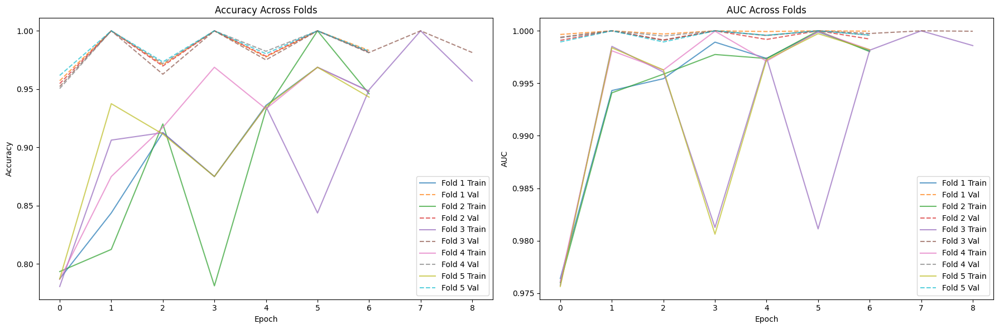


🔥 Final Ensemble Evaluation on Test Set


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


15/15 ━━━━━━━━━━━━━━━━━━━━ 15s 612ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 16s 584ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 16s 648ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 15s 587ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 16s 595ms/step

📊 Ensemble Classification Report:
              precision    recall  f1-score   support

 Hargila Bok     0.8824    0.9375    0.9091        16
        Lama     0.9333    0.9333    0.9333        15
      Rabbit     1.0000    1.0000    1.0000        16
         ass     0.8750    0.8750    0.8750        16
        bear     1.0000    1.0000    1.0000        16
       camel     0.9412    1.0000    0.9697        16
  camel bird     0.9412    1.0000    0.9697        16
         cat     1.0000    1.0000    1.0000        15
         cow     1.0000    1.0000    1.0000        15
   crocodile     1.0000    1.0000    1.0000        15
        deer     1.0000    1.0000    1.0000        15
         dog     1.0000    1.0000    1.0000        14
    elephant     1.0000    1.0000    1.0000        1

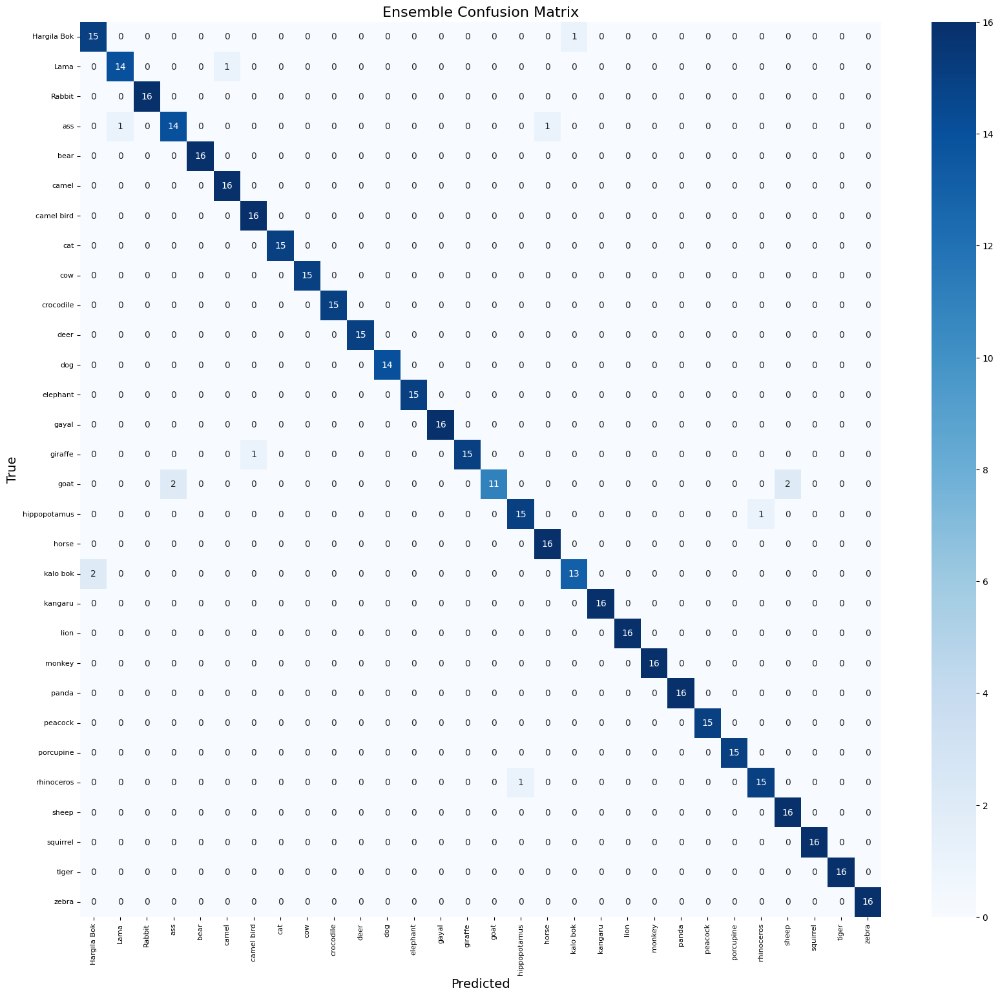

<Figure size 1500x600 with 0 Axes>

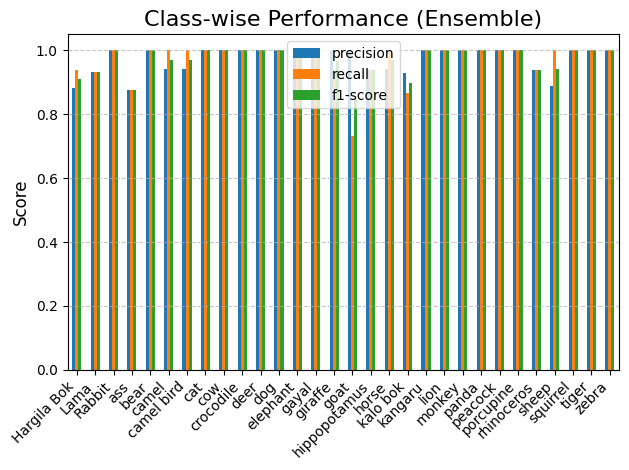

All fold models saved successfully!


In [10]:
import tensorflow as tf
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import KFold
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
from sklearn.preprocessing import label_binarize
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import os
from itertools import cycle

# Configuration
IMG_SIZE = (299, 299)  # InceptionV3 requires 299x299
BATCH_SIZE = 32
EPOCHS = 50
NUM_CLASSES = 30
K_FOLDS = 5

# Data Preparation
def get_file_paths_and_labels(directory):
    file_paths = []
    labels = []
    class_names = sorted(os.listdir(directory))
    
    for class_name in class_names:
        class_dir = os.path.join(directory, class_name)
        if os.path.isdir(class_dir):
            for fname in os.listdir(class_dir):
                if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
                    file_paths.append(os.path.join(class_dir, fname))
                    labels.append(class_name)
    
    return np.array(file_paths), np.array(labels), class_names

# Load all training data for K-fold
train_dir = '/kaggle/working/Animal Classification/train_augmented'
file_paths, labels, class_names = get_file_paths_and_labels(train_dir)
kfold = KFold(n_splits=K_FOLDS, shuffle=True, random_state=42)

# Test set generator (kept separate)
test_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/test'
test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

# K-fold Cross Validation
fold_history = []
all_confusion_matrices = []
best_models = []

for fold, (train_idx, val_idx) in enumerate(kfold.split(file_paths, labels)):
    print(f"\n{'='*40}")
    print(f"Training Fold {fold+1}/{K_FOLDS}")
    print(f"{'='*40}")
    
    # Create DataFrames
    train_df = pd.DataFrame({
        'filename': file_paths[train_idx],
        'class': labels[train_idx]
    })
    val_df = pd.DataFrame({
        'filename': file_paths[val_idx],
        'class': labels[val_idx]
    })
    
    # Create generators
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=30,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest'
    )
    
    val_datagen = ImageDataGenerator(rescale=1./255)
    
    train_generator = train_datagen.flow_from_dataframe(
        train_df,
        x_col='filename',
        y_col='class',
        target_size=IMG_SIZE,
        class_mode='categorical',
        batch_size=BATCH_SIZE,
        shuffle=True,
        classes=class_names
    )
    
    val_generator = val_datagen.flow_from_dataframe(
        val_df,
        x_col='filename',
        y_col='class',
        target_size=IMG_SIZE,
        class_mode='categorical',
        batch_size=BATCH_SIZE,
        shuffle=False,
        classes=class_names
    )
    
    # Build fresh model for each fold
    def build_model():
        base_model = InceptionV3(
            weights='imagenet',
            include_top=False,
            input_shape=(*IMG_SIZE, 3)
        )
        base_model.trainable = False
        
        model = models.Sequential([
            base_model,
            layers.GlobalAveragePooling2D(),
            layers.Dense(1024, activation='relu'),
            layers.BatchNormalization(),
            layers.Dropout(0.5),
            layers.Dense(NUM_CLASSES, activation='softmax')
        ])
        
        model.compile(
            optimizer=Adam(learning_rate=0.0001),
            loss='categorical_crossentropy',
            metrics=['accuracy', tf.keras.metrics.AUC(name='auc')]
        )
        return model
    
    model = build_model()
    
    # Callbacks
    callbacks = [
        EarlyStopping(patience=5, monitor='val_auc', mode='max', restore_best_weights=True),
        ModelCheckpoint(f'best_fold_{fold+1}.keras', save_best_only=True, monitor='val_auc'),
        ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3)
    ]
    
    # Train
    history = model.fit(
        train_generator,
        steps_per_epoch=train_generator.samples // BATCH_SIZE,
        validation_data=val_generator,
        validation_steps=val_generator.samples // BATCH_SIZE,
        epochs=EPOCHS,
        callbacks=callbacks,
        verbose=1
    )
    
    # Store history and best model
    fold_history.append(history.history)
    best_models.append(models.load_model(f'best_fold_{fold+1}.keras'))
    
    # Fold Evaluation
    val_pred = model.predict(val_generator)
    val_pred_classes = np.argmax(val_pred, axis=1)
    val_true = val_generator.classes
    
    # Confusion Matrix
    cm = confusion_matrix(val_true, val_pred_classes)
    all_confusion_matrices.append(cm)
    
    print(f"\nFold {fold+1} Classification Report:")
    print(classification_report(val_true, val_pred_classes, target_names=class_names, digits=4))

# K-fold Analysis
def plot_kfold_results(history_list):
    plt.figure(figsize=(18, 6))
    
    # Accuracy
    plt.subplot(1, 2, 1)
    for i, history in enumerate(history_list):
        plt.plot(history['accuracy'], label=f'Fold {i+1} Train', alpha=0.7)
        plt.plot(history['val_accuracy'], '--', label=f'Fold {i+1} Val', alpha=0.7)
    plt.title('Accuracy Across Folds')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()
    
    # AUC
    plt.subplot(1, 2, 2)
    for i, history in enumerate(history_list):
        plt.plot(history['auc'], label=f'Fold {i+1} Train', alpha=0.7)
        plt.plot(history['val_auc'], '--', label=f'Fold {i+1} Val', alpha=0.7)
    plt.title('AUC Across Folds')
    plt.ylabel('AUC')
    plt.xlabel('Epoch')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

plot_kfold_results(fold_history)

# Ensemble Evaluation on Test Set
def ensemble_predict(models, generator):
    all_preds = []
    for model in models:
        generator.reset()
        preds = model.predict(generator)
        all_preds.append(preds)
    return np.mean(all_preds, axis=0)

print("\n🔥 Final Ensemble Evaluation on Test Set")
test_preds = ensemble_predict(best_models, test_generator)
test_pred_classes = np.argmax(test_preds, axis=1)
test_true = test_generator.classes

# Classification Report
print("\n📊 Ensemble Classification Report:")
print(classification_report(test_true, test_pred_classes, target_names=class_names, digits=4))

# Confusion Matrix
plt.figure(figsize=(20, 18))
cm = confusion_matrix(test_true, test_pred_classes)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)
plt.title('Ensemble Confusion Matrix', fontsize=16)
plt.xlabel('Predicted', fontsize=14)
plt.ylabel('True', fontsize=14)
plt.xticks(rotation=90, fontsize=8)
plt.yticks(rotation=0, fontsize=8)
plt.show()

# Class-wise Performance
report = classification_report(test_true, test_pred_classes,
                               target_names=class_names, output_dict=True)
df = pd.DataFrame(report).transpose().iloc[:-3, :]

plt.figure(figsize=(15, 6))
df[['precision', 'recall', 'f1-score']].plot(kind='bar')
plt.title('Class-wise Performance (Ensemble)', fontsize=16)
plt.ylabel('Score', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Save all models
for i in range(K_FOLDS):
    best_models[i].save(f'/kaggle/working/inceptionv3_fold_{i+1}.keras')
print("All fold models saved successfully!")

## **VGG19**

In [12]:
# # Data Paths
# train_dir = '/kaggle/working/Animal Classification/train_augmented'
# val_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/validation'
# test_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/test'

import tensorflow as tf
from tensorflow.keras.applications import VGG19
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
from sklearn.preprocessing import label_binarize
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import os
from itertools import cycle

# Configuration
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
EPOCHS = 50

# Data Paths
train_dir = '/kaggle/working/Animal Classification/train_augmented'
val_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/validation'
test_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/test'

# Data Generators with Automatic Class Detection
def create_generators():
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest'
    )

    val_test_datagen = ImageDataGenerator(rescale=1./255)

    train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        class_mode='categorical',
        shuffle=True
    )

    val_generator = val_test_datagen.flow_from_directory(
        val_dir,
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        class_mode='categorical',
        shuffle=False
    )

    test_generator = val_test_datagen.flow_from_directory(
        test_dir,
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        class_mode='categorical',
        shuffle=False
    )
    
    return train_generator, val_generator, test_generator

train_gen, val_gen, test_gen = create_generators()
NUM_CLASSES = len(train_gen.class_indices)  # Dynamic class count
class_names = list(train_gen.class_indices.keys())

Found 14391 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.


In [13]:
# VGG19 Model with Dynamic Output Layer
def build_vgg19():
    base_model = VGG19(
        weights='imagenet',
        include_top=False,
        input_shape=(*IMG_SIZE, 3)
    )
    base_model.trainable = False
    
    model = models.Sequential([
        base_model,
        layers.Flatten(),
        layers.Dense(4096, activation='relu'),
        layers.Dropout(0.5),
        layers.Dense(4096, activation='relu'),
        layers.Dropout(0.5),
        layers.Dense(NUM_CLASSES, activation='softmax')  # Dynamic output
    ])
    
    return model

model = build_vgg19()

# Compile with Correct Loss
model.compile(
    optimizer=Adam(learning_rate=0.0001),
    loss='categorical_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall'),
        tf.keras.metrics.AUC(name='auc')
    ]
)

# Callbacks (Same as Before)
callbacks = [
    EarlyStopping(patience=5, monitor='val_auc', mode='max', restore_best_weights=True),
    ModelCheckpoint('best_vgg19_model.keras', save_best_only=True, monitor='val_auc', mode='max'),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3)
]

# Training
history = model.fit(
    train_gen,
    steps_per_epoch=train_gen.samples // BATCH_SIZE,
    validation_data=val_gen,
    validation_steps=val_gen.samples // BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=callbacks,
    verbose=1
)

Epoch 1/50
 19/449 ━━━━━━━━━━━━━━━━━━━━ 2:36 365ms/step - accuracy: 0.0317 - auc: 0.5100 - loss: 4.1981 - precision: 0.0293 - recall: 0.0022

2025-05-16 20:05:19.619657: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng12{k11=0} for conv (f32[23,64,224,224]{3,2,1,0}, u8[0]{0}) custom-call(f32[23,64,224,224]{3,2,1,0}, f32[64,64,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kRelu","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]} is taking a while...
2025-05-16 20:05:19.721827: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.102284382s
Trying algorithm eng12{k11=0} for conv (f32[23,64,224,224]{3,2,1,0}, u8[0]{0}) custom-call(f32[23,64,224,224]{3,2,1,0}, f32[64,64,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward",

449/449 ━━━━━━━━━━━━━━━━━━━━ 202s 431ms/step - accuracy: 0.1187 - auc: 0.6523 - loss: 3.3804 - precision: 0.4050 - recall: 0.0126 - val_accuracy: 0.4955 - val_auc: 0.9351 - val_loss: 1.7828 - val_precision: 0.9189 - val_recall: 0.2277 - learning_rate: 1.0000e-04
Epoch 2/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 90us/step - accuracy: 0.2500 - auc: 0.8266 - loss: 2.5285 - precision: 1.0000 - recall: 0.0625 - learning_rate: 1.0000e-04
Epoch 3/50


/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_auc` which is not available. Available metrics are: accuracy,auc,loss,precision,recall
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_auc available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/callback_list.py:96: UserWarning: Learning rate reduction is conditioned on metric `val_loss` which is not available. Available metrics are: accuracy,auc,loss,precision,recall,learning_rate.
  callback.on_epoch_end(epoch, logs)


449/449 ━━━━━━━━━━━━━━━━━━━━ 181s 396ms/step - accuracy: 0.3745 - auc: 0.8918 - loss: 2.1511 - precision: 0.7901 - recall: 0.1543 - val_accuracy: 0.6429 - val_auc: 0.9605 - val_loss: 1.3061 - val_precision: 0.8585 - val_recall: 0.4062 - learning_rate: 1.0000e-04
Epoch 4/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 75us/step - accuracy: 0.4348 - auc: 0.9409 - loss: 1.7149 - precision: 1.0000 - recall: 0.2609 - learning_rate: 1.0000e-04
Epoch 5/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 182s 399ms/step - accuracy: 0.4805 - auc: 0.9304 - loss: 1.7544 - precision: 0.7881 - recall: 0.2792 - val_accuracy: 0.6629 - val_auc: 0.9661 - val_loss: 1.1474 - val_precision: 0.8939 - val_recall: 0.5268 - learning_rate: 1.0000e-04
Epoch 6/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 74us/step - accuracy: 0.5312 - auc: 0.9595 - loss: 1.4687 - precision: 0.7857 - recall: 0.3438 - learning_rate: 1.0000e-04
Epoch 7/50
449/449 ━━━━━━━━━━━━━━━━━━━━ 180s 394ms/step - accuracy: 0.5311 - auc: 0.9490 - loss: 1.5347 - precision: 0.7943 - recal

In [14]:
# Evaluation Functions
def plot_training_history(history):
    plt.figure(figsize=(18, 6))
    
    # Accuracy
    plt.subplot(1, 3, 1)
    plt.plot(history.history['accuracy'], label='Train')
    plt.plot(history.history['val_accuracy'], label='Validation')
    plt.title('Accuracy Evolution')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()
    
    # Loss
    plt.subplot(1, 3, 2)
    plt.plot(history.history['loss'], label='Train')
    plt.plot(history.history['val_loss'], label='Validation')
    plt.title('Loss Evolution')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()
    
    # AUC
    plt.subplot(1, 3, 3)
    plt.plot(history.history['auc'], label='Train')
    plt.plot(history.history['val_auc'], label='Validation')
    plt.title('AUC Evolution')
    plt.ylabel('AUC')
    plt.xlabel('Epoch')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

def plot_confusion_matrix(y_true, y_pred, classes):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(20, 18))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=classes, 
                yticklabels=classes)
    plt.title('Confusion Matrix', fontsize=16)
    plt.xlabel('Predicted Labels', fontsize=14)
    plt.ylabel('True Labels', fontsize=14)
    plt.xticks(rotation=90, fontsize=8)
    plt.yticks(rotation=0, fontsize=8)
    plt.show()

def plot_class_performance(y_true, y_pred, classes):
    report = classification_report(y_true, y_pred, 
                                 target_names=classes, 
                                 output_dict=True)
    df = pd.DataFrame(report).transpose().iloc[:-3, :]
    
    plt.figure(figsize=(15, 6))
    df[['precision', 'recall', 'f1-score']].plot(kind='bar')
    plt.title('Class-wise Performance Metrics', fontsize=16)
    plt.ylabel('Score', fontsize=12)
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

def plot_roc_curves(y_true, y_pred_probs, classes, n_classes=3):
    y_true_bin = label_binarize(y_true, classes=np.arange(len(classes)))
    
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    
    plt.figure(figsize=(10, 8))
    colors = cycle(['#1f77b4', '#ff7f0e', '#2ca02c'])
    for i, color in zip(range(n_classes), colors):
        fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_pred_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])
        plt.plot(fpr[i], tpr[i], color=color,
                 label=f'{classes[i]} (AUC = {roc_auc[i]:.2f})')
    
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12)
    plt.ylabel('True Positive Rate', fontsize=12)
    plt.title('ROC Curves (Sample Classes)', fontsize=16)
    plt.legend(loc="lower right")
    plt.show()


🧪 Validation Set Evaluation:
14/14 ━━━━━━━━━━━━━━━━━━━━ 4s 244ms/step

📊 Validation Classification Report:
              precision    recall  f1-score   support

 Hargila Bok     0.8571    0.8000    0.8276        15
        Lama     0.8333    0.6667    0.7407        15
      Rabbit     0.8571    0.8000    0.8276        15
         ass     1.0000    0.8000    0.8889        15
        bear     0.6667    0.6667    0.6667        15
       camel     0.6842    0.8667    0.7647        15
  camel bird     0.9231    0.8000    0.8571        15
         cat     0.8000    0.5333    0.6400        15
         cow     0.8571    0.8000    0.8276        15
   crocodile     0.7778    1.0000    0.8750        14
        deer     1.0000    0.9333    0.9655        15
         dog     0.8125    0.9286    0.8667        14
    elephant     0.7778    0.9333    0.8485        15
       gayal     1.0000    0.8000    0.8889        15
     giraffe     0.8750    0.9333    0.9032        15
        goat     0.8750    

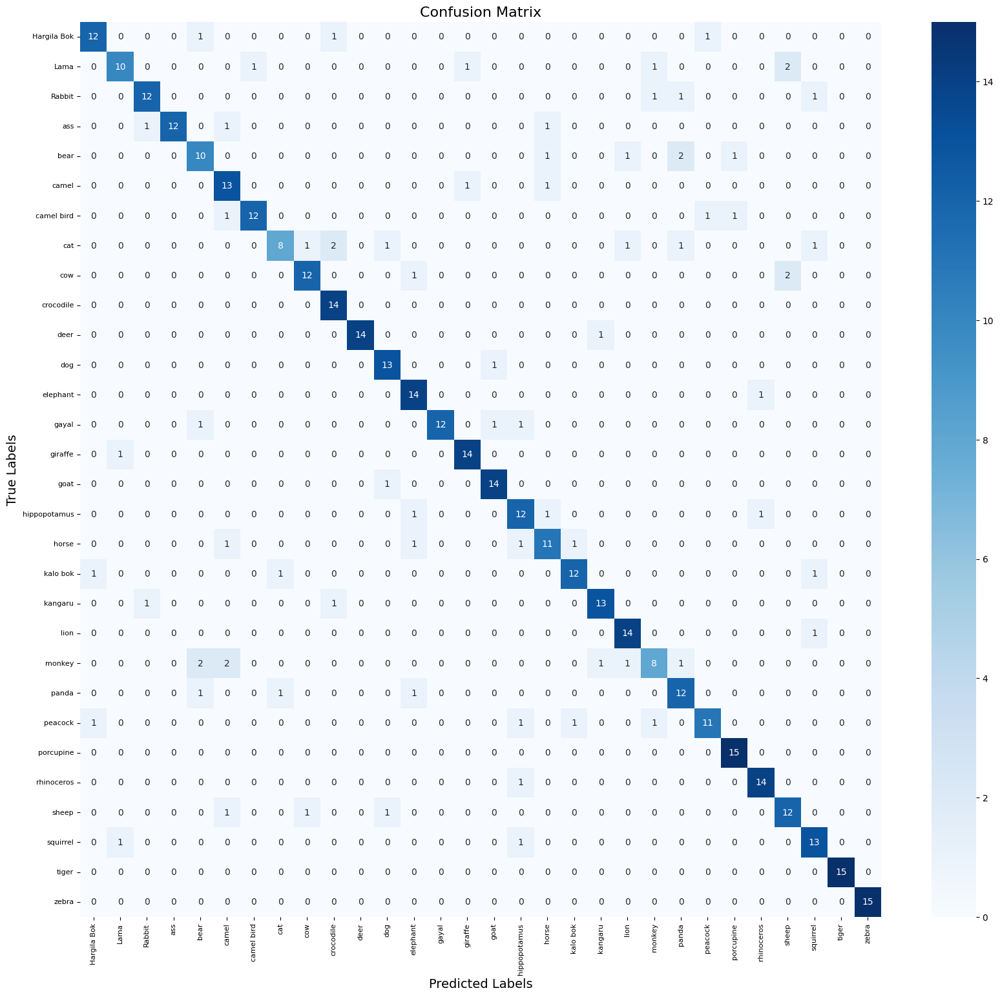

<Figure size 1500x600 with 0 Axes>

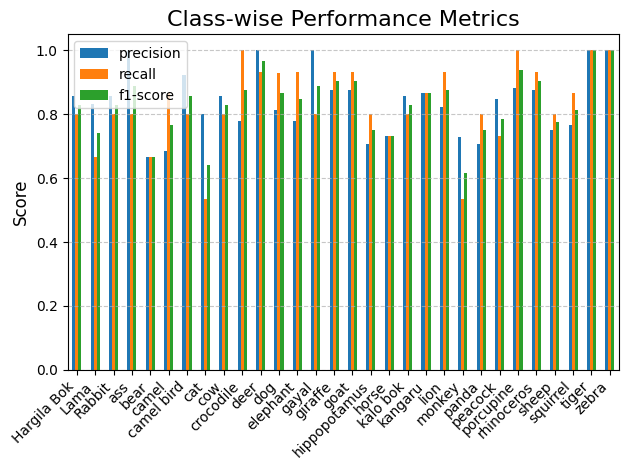

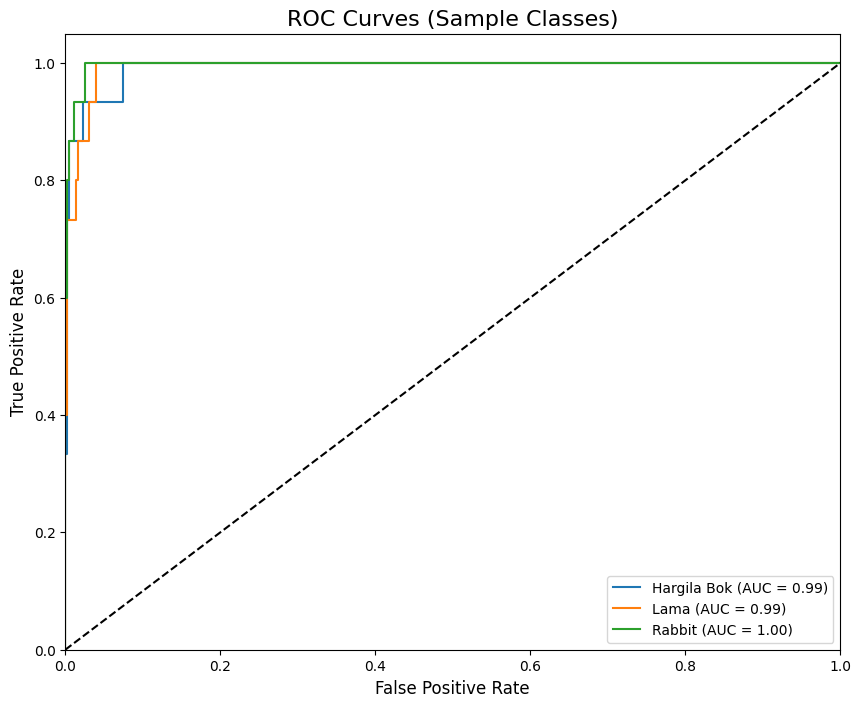


🧪 Test Set Evaluation:
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 124ms/step

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


15/15 ━━━━━━━━━━━━━━━━━━━━ 15s 1s/step 

📊 Test Classification Report:
              precision    recall  f1-score   support

 Hargila Bok     1.0000    0.9375    0.9677        16
        Lama     0.7692    0.6667    0.7143        15
      Rabbit     0.8333    0.9375    0.8824        16
         ass     0.7222    0.8125    0.7647        16
        bear     0.8235    0.8750    0.8485        16
       camel     0.6667    0.8750    0.7568        16
  camel bird     0.9286    0.8125    0.8667        16
         cat     1.0000    0.9333    0.9655        15
         cow     0.8000    0.5333    0.6400        15
   crocodile     0.8235    0.9333    0.8750        15
        deer     0.8667    0.8667    0.8667        15
         dog     0.5789    0.7857    0.6667        14
    elephant     0.7778    0.9333    0.8485        15
       gayal     0.8182    0.5625    0.6667        16
     giraffe     0.8889    1.0000    0.9412        16
        goat     0.7059    0.8000    0.7500        15
hippopotam

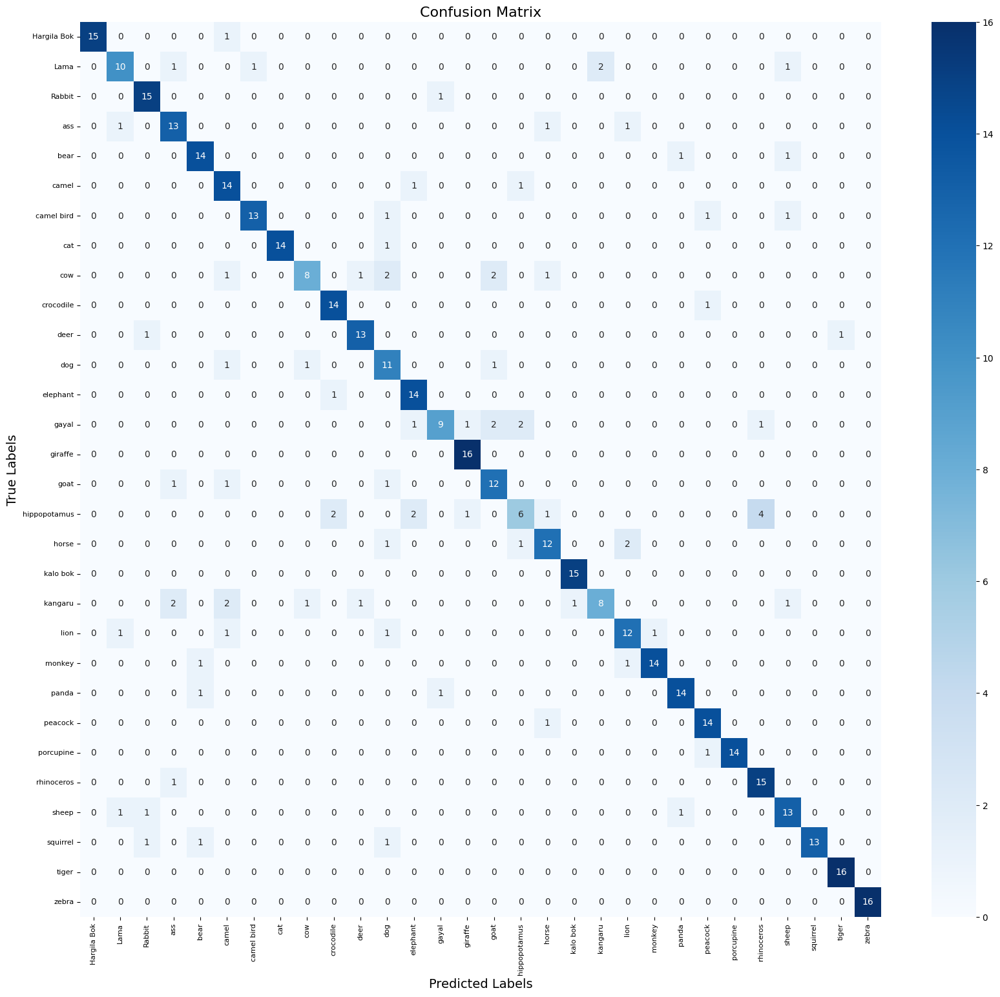

<Figure size 1500x600 with 0 Axes>

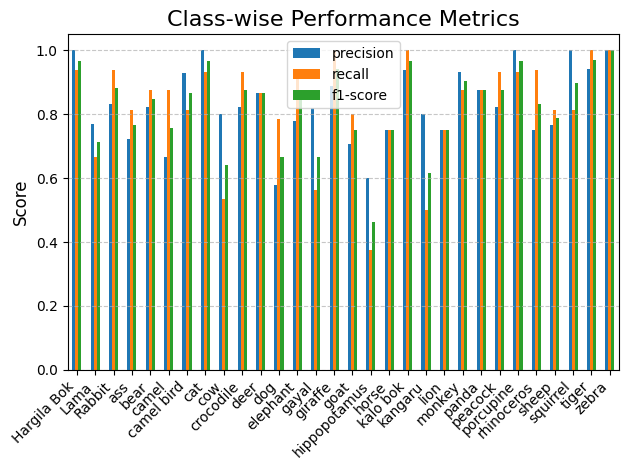

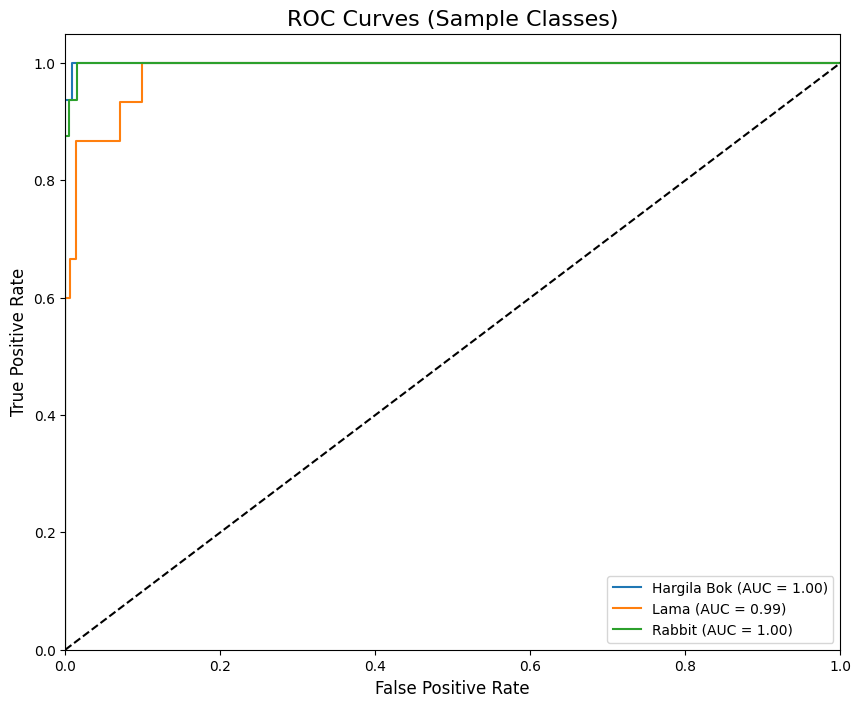

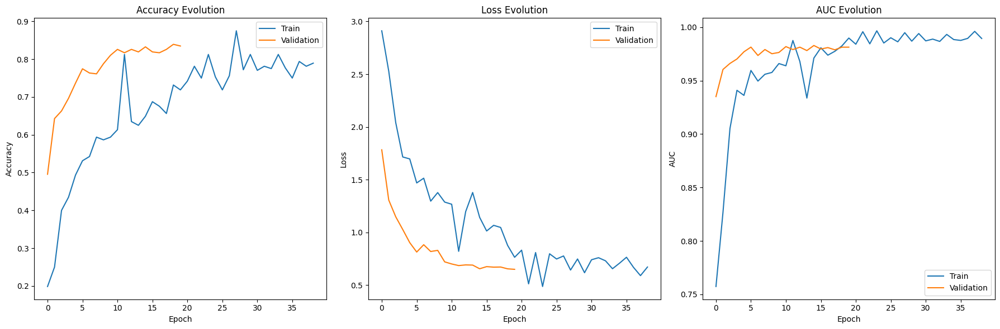

In [15]:
# Full Evaluation Pipeline
def full_evaluation(model, generator, dataset_name):
    generator.reset()
    y_true = generator.classes
    y_pred_probs = model.predict(generator)
    y_pred = np.argmax(y_pred_probs, axis=1)
    
    print(f"\n📊 {dataset_name} Classification Report:")
    print(classification_report(y_true, y_pred, 
                               target_names=class_names, 
                               digits=4))
    
    plot_confusion_matrix(y_true, y_pred, class_names)
    plot_class_performance(y_true, y_pred, class_names)
    plot_roc_curves(y_true, y_pred_probs, class_names)
    
    return y_true, y_pred

# Run Evaluations


print("\n🧪 Validation Set Evaluation:")
val_true, val_pred = full_evaluation(model, val_gen, "Validation")

print("\n🧪 Test Set Evaluation:")
test_true, test_pred = full_evaluation(model, test_gen, "Test")

# Training History Visualization
plot_training_history(history)


## **ViT-B/16 Model**

In [2]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Configuration
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
EPOCHS = 30
NUM_CLASSES = 30
PATCH_SIZE = 16
NUM_PATCHES = (IMG_SIZE[0] // PATCH_SIZE) ** 2
PROJECTION_DIM = 768
NUM_HEADS = 12
NUM_LAYERS = 12
MLP_UNITS = [3072, 768]  # Transformer MLP size

# Data Paths
train_dir = '/kaggle/working/Animal Classification/train_augmented'
val_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/validation'
test_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/test'

# Data Generators
def create_generators():
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True
    )

    val_test_datagen = ImageDataGenerator(rescale=1./255)

    train_gen = train_datagen.flow_from_directory(
        train_dir,
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        class_mode='categorical',
        shuffle=True
    )

    val_gen = val_test_datagen.flow_from_directory(
        val_dir,
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        class_mode='categorical',
        shuffle=False
    )

    test_gen = val_test_datagen.flow_from_directory(
        test_dir,
        target_size=IMG_SIZE,
        batch_size=BATCH_SIZE,
        class_mode='categorical',
        shuffle=False
    )
    
    return train_gen, val_gen, test_gen

train_gen, val_gen, test_gen = create_generators()
class_names = list(train_gen.class_indices.keys())


Found 14388 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.


In [3]:
# Vision Transformer Components
def mlp(x, hidden_units, dropout_rate):
    for units in hidden_units:
        x = layers.Dense(units, activation=tf.nn.gelu)(x)
        x = layers.Dropout(dropout_rate)(x)
    return x

class Patches(layers.Layer):
    def call(self, images):
        batch_size = tf.shape(images)[0]
        patches = tf.image.extract_patches(
            images=images,
            sizes=[1, PATCH_SIZE, PATCH_SIZE, 1],
            strides=[1, PATCH_SIZE, PATCH_SIZE, 1],
            rates=[1, 1, 1, 1],
            padding="VALID",
        )
        return tf.reshape(patches, [batch_size, -1, PATCH_SIZE * PATCH_SIZE * 3])

class PatchEncoder(layers.Layer):
    def __init__(self, num_patches, projection_dim):
        super().__init__()
        self.num_patches = num_patches
        self.projection = layers.Dense(units=projection_dim)
        self.position_embedding = layers.Embedding(
            input_dim=num_patches, output_dim=projection_dim
        )
    
    def call(self, patch):
        positions = tf.range(start=0, limit=self.num_patches, delta=1)
        encoded = self.projection(patch) + self.position_embedding(positions)
        return encoded

# ViT-B/16 Model Architecture
def create_vit_model():
    inputs = layers.Input(shape=(IMG_SIZE[0], IMG_SIZE[1], 3))
    
    # Create patches
    patches = Patches()(inputs)
    
    # Encode patches
    encoded_patches = PatchEncoder(NUM_PATCHES, PROJECTION_DIM)(patches)

    # Transformer blocks
    for _ in range(NUM_LAYERS):
        # Layer normalization 1
        x1 = layers.LayerNormalization(epsilon=1e-6)(encoded_patches)
        
        # Multi-head attention
        attention_output = layers.MultiHeadAttention(
            num_heads=NUM_HEADS, key_dim=PROJECTION_DIM//NUM_HEADS, dropout=0.1
        )(x1, x1)
        
        # Skip connection 1
        x2 = layers.Add()([attention_output, encoded_patches])
        
        # Layer normalization 2
        x3 = layers.LayerNormalization(epsilon=1e-6)(x2)
        
        # MLP
        x3 = mlp(x3, hidden_units=MLP_UNITS, dropout_rate=0.1)
        
        # Skip connection 2
        encoded_patches = layers.Add()([x3, x2])

    # Final layer normalization and classification head
    representation = layers.LayerNormalization(epsilon=1e-6)(encoded_patches)
    representation = layers.Flatten()(representation)
    representation = layers.Dropout(0.5)(representation)
    outputs = layers.Dense(NUM_CLASSES, activation="softmax")(representation)
    
    return models.Model(inputs=inputs, outputs=outputs)

model = create_vit_model()

# Model Compilation
model.compile(
    optimizer=Adam(learning_rate=3e-4),
    loss='categorical_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall'),
        tf.keras.metrics.AUC(name='auc')
    ]
)

# Callbacks
callbacks = [
    EarlyStopping(patience=5, monitor='val_auc', mode='max', restore_best_weights=True),
    ModelCheckpoint('best_vit_model.keras', 
                  save_best_only=True, 
                  monitor='val_auc',
                  mode='max'),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3)
]

# Training
history = model.fit(
    train_gen,
    steps_per_epoch=train_gen.samples // BATCH_SIZE,
    validation_data=val_gen,
    validation_steps=val_gen.samples // BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=callbacks,
    verbose=1
)

I0000 00:00:1747504137.075333      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1747504137.076014      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


Epoch 1/30


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1747504189.880208     120 service.cc:148] XLA service 0x7c0f1c015880 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1747504189.881229     120 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1747504189.881253     120 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1747504194.396741     120 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1747504222.507387     120 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of th

449/449 ━━━━━━━━━━━━━━━━━━━━ 760s 2s/step - accuracy: 0.0493 - auc: 0.5283 - loss: 11.9719 - precision: 0.0519 - recall: 0.0220 - val_accuracy: 0.1786 - val_auc: 0.6940 - val_loss: 3.3973 - val_precision: 0.4355 - val_recall: 0.0603 - learning_rate: 3.0000e-04
Epoch 2/30
449/449 ━━━━━━━━━━━━━━━━━━━━ 2s 186us/step - accuracy: 0.1562 - auc: 0.6933 - loss: 3.7511 - precision: 0.1667 - recall: 0.0312 - learning_rate: 3.0000e-04
Epoch 3/30


/usr/lib/python3.11/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_auc` which is not available. Available metrics are: accuracy,auc,loss,precision,recall
  current = self.get_monitor_value(logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_auc available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)
/usr/local/lib/python3.11/dist-packages/keras/src/callbacks/callback_list.py:96: UserWarning: Learning rate reduction is conditioned on metric `val_loss` which is not available. Available metrics are: accura

449/449 ━━━━━━━━━━━━━━━━━━━━ 660s 1s/step - accuracy: 0.1525 - auc: 0.7023 - loss: 3.6492 - precision: 0.2985 - recall: 0.0681 - val_accuracy: 0.2879 - val_auc: 0.8307 - val_loss: 2.6350 - val_precision: 0.5385 - val_recall: 0.1250 - learning_rate: 3.0000e-04
Epoch 4/30
449/449 ━━━━━━━━━━━━━━━━━━━━ 1s 118us/step - accuracy: 0.1250 - auc: 0.7368 - loss: 3.3098 - precision: 0.5000 - recall: 0.0625 - learning_rate: 3.0000e-04
Epoch 5/30
449/449 ━━━━━━━━━━━━━━━━━━━━ 662s 1s/step - accuracy: 0.2555 - auc: 0.8181 - loss: 2.7671 - precision: 0.4800 - recall: 0.1273 - val_accuracy: 0.3460 - val_auc: 0.8748 - val_loss: 2.2794 - val_precision: 0.6370 - val_recall: 0.1920 - learning_rate: 3.0000e-04
Epoch 6/30
449/449 ━━━━━━━━━━━━━━━━━━━━ 1s 115us/step - accuracy: 0.2500 - auc: 0.8540 - loss: 2.5793 - precision: 0.3000 - recall: 0.0938 - learning_rate: 3.0000e-04
Epoch 7/30
449/449 ━━━━━━━━━━━━━━━━━━━━ 661s 1s/step - accuracy: 0.3575 - auc: 0.8771 - loss: 2.2968 - precision: 0.5748 - recall: 0.19


🧪 Validation Set Evaluation:
14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 369ms/step

📊 Validation Classification Report:
              precision    recall  f1-score   support

 Hargila Bok     0.6667    0.2667    0.3810        15
        Lama     0.3000    0.2000    0.2400        15
      Rabbit     0.5714    0.5333    0.5517        15
         ass     0.4615    0.4000    0.4286        15
        bear     0.5000    0.1333    0.2105        15
       camel     0.2778    0.3333    0.3030        15
  camel bird     0.7500    0.2000    0.3158        15
         cat     0.6250    0.3333    0.4348        15
         cow     0.6000    0.4000    0.4800        15
   crocodile     0.3750    0.6429    0.4737        14
        deer     0.2353    0.2667    0.2500        15
         dog     0.4444    0.5714    0.5000        14
    elephant     0.2000    0.1333    0.1600        15
       gayal     0.3171    0.8667    0.4643        15
     giraffe     0.5385    0.4667    0.5000        15
        goat     0.7222    

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


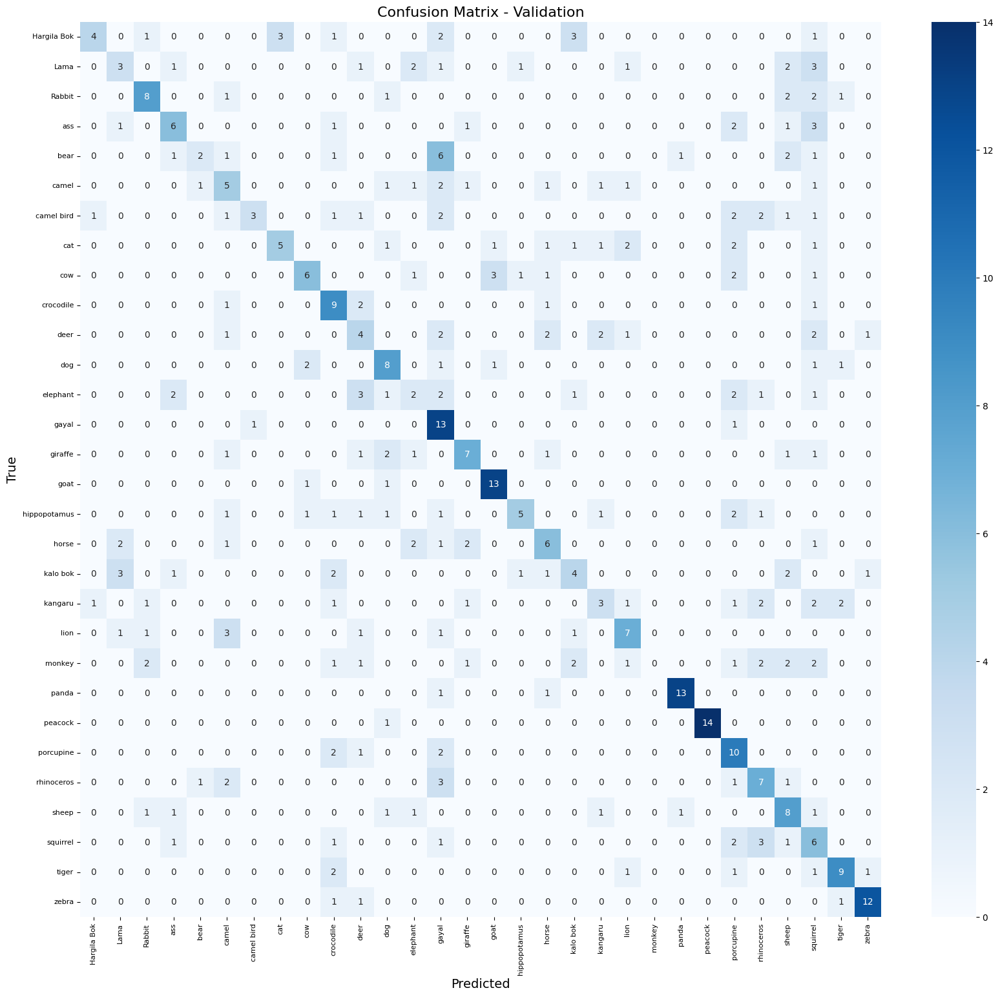

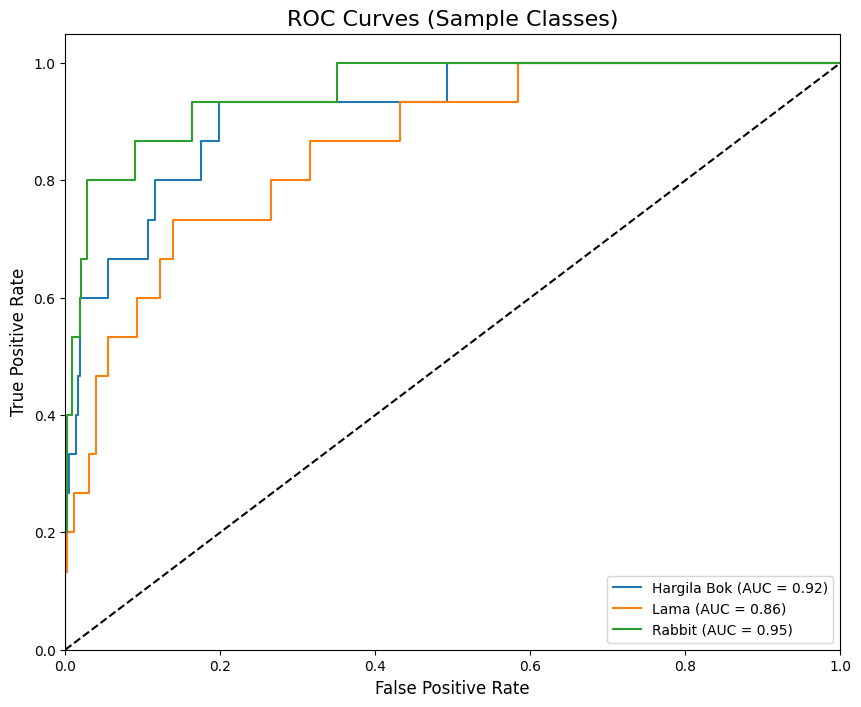


🧪 Test Set Evaluation:
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 374ms/step

📊 Test Classification Report:
              precision    recall  f1-score   support

 Hargila Bok     0.7000    0.4375    0.5385        16
        Lama     0.1429    0.0667    0.0909        15
      Rabbit     0.6875    0.6875    0.6875        16
         ass     0.5000    0.3125    0.3846        16
        bear     0.4615    0.3750    0.4138        16
       camel     0.4211    0.5000    0.4571        16
  camel bird     0.5714    0.2500    0.3478        16
         cat     0.2500    0.1333    0.1739        15
         cow     0.4286    0.2000    0.2727        15
   crocodile     0.2000    0.4000    0.2667        15
        deer     0.3333    0.2667    0.2963        15
         dog     0.4167    0.7143    0.5263        14
    elephant     0.3571    0.3333    0.3448        15
       gayal     0.3750    0.5625    0.4500        16
     giraffe     0.4737    0.5625    0.5143        16
        goat     0.5625    0.6000    0.

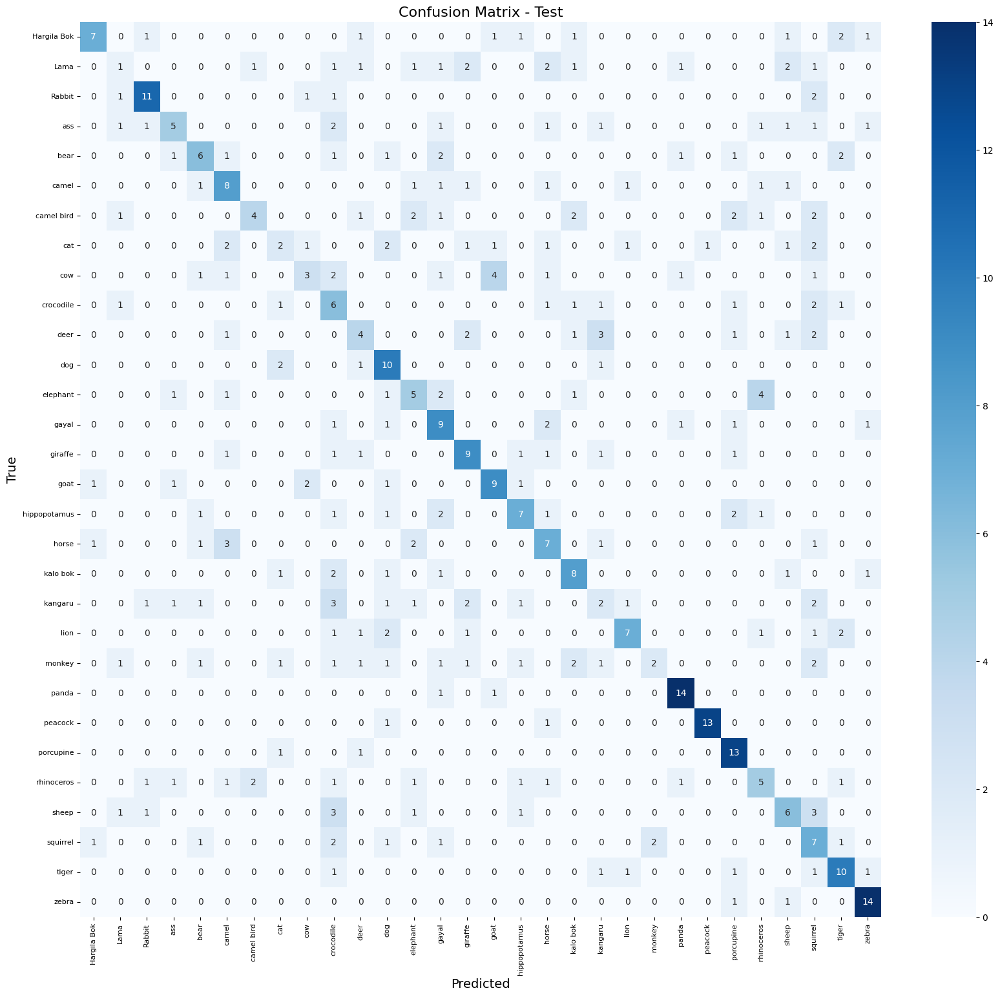

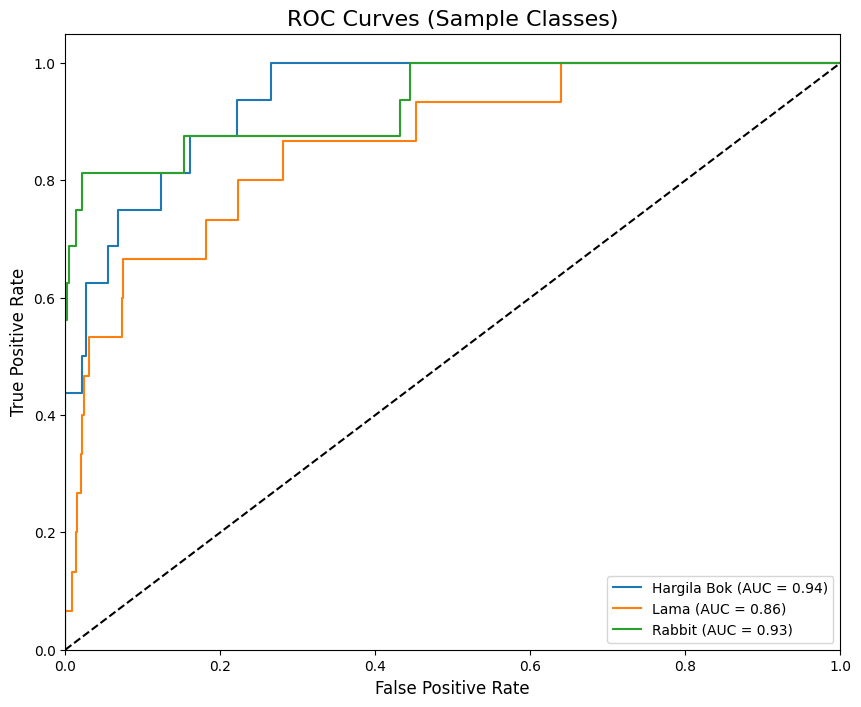

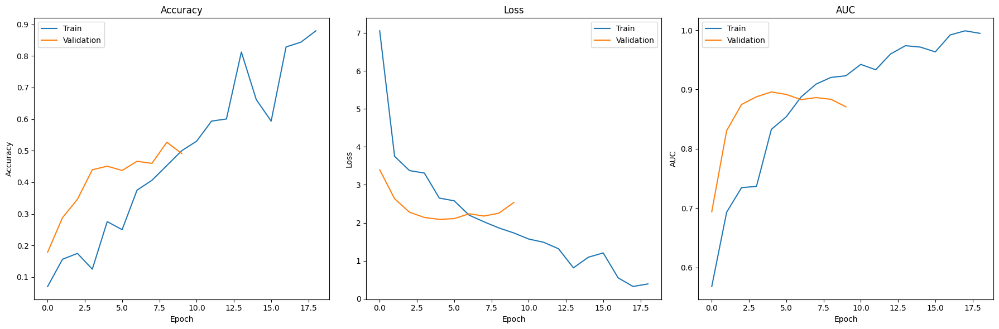


✅ Model saved successfully!


In [8]:
# Evaluation Functions (Fixed)
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
from sklearn.preprocessing import label_binarize
from itertools import cycle

def plot_training_history(history):
    plt.figure(figsize=(18, 6))
    
    plt.subplot(1, 3, 1)
    plt.plot(history.history['accuracy'], label='Train')
    plt.plot(history.history['val_accuracy'], label='Validation')
    plt.title('Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()
    
    plt.subplot(1, 3, 2)
    plt.plot(history.history['loss'], label='Train')
    plt.plot(history.history['val_loss'], label='Validation')
    plt.title('Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()
    
    plt.subplot(1, 3, 3)
    plt.plot(history.history['auc'], label='Train')
    plt.plot(history.history['val_auc'], label='Validation')
    plt.title('AUC')
    plt.ylabel('AUC')
    plt.xlabel('Epoch')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

def evaluate_model(model, generator, dataset_name):
    generator.reset()
    # Get true labels directly from generator classes
    y_true = generator.classes[:generator.samples]
    
    # Predict probabilities
    y_pred_probs = model.predict(generator, verbose=1)
    y_pred = np.argmax(y_pred_probs, axis=1)
    
    # Classification report
    print(f"\n📊 {dataset_name} Classification Report:")
    print(classification_report(y_true, y_pred, target_names=class_names, digits=4))
    
    # Confusion matrix
    plt.figure(figsize=(20, 18))
    cm = confusion_matrix(y_true, y_pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f'Confusion Matrix - {dataset_name}', fontsize=16)
    plt.xlabel('Predicted', fontsize=14)
    plt.ylabel('True', fontsize=14)
    plt.xticks(rotation=90, fontsize=8)
    plt.yticks(rotation=0, fontsize=8)
    plt.show()
    
    # ROC curves for first 3 classes
    y_true_bin = label_binarize(y_true, classes=np.arange(NUM_CLASSES))
    plt.figure(figsize=(10, 8))
    colors = cycle(['#1f77b4', '#ff7f0e', '#2ca02c'])
    for i, color in zip(range(3), colors):
        fpr, tpr, _ = roc_curve(y_true_bin[:, i], y_pred_probs[:, i])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, color=color, 
                 label=f'{class_names[i]} (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12)
    plt.ylabel('True Positive Rate', fontsize=12)
    plt.title('ROC Curves (Sample Classes)', fontsize=16)
    plt.legend(loc="lower right")
    plt.show()

# Run Evaluations
# print("\n🔍 Training Set Evaluation:")
# evaluate_model(model, train_gen, "Training")

print("\n🧪 Validation Set Evaluation:")
evaluate_model(model, val_gen, "Validation")

print("\n🧪 Test Set Evaluation:")
evaluate_model(model, test_gen, "Test")

# Plot training history
plot_training_history(history)

# Save Model
model.save('/kaggle/working/animal_classifier_vitb16.keras')
print("\n✅ Model saved successfully!")

# **Ensemble Model**

In [17]:
import tensorflow as tf
import numpy as np
import os
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Load pre-trained models
model_eff = tf.keras.models.load_model('/kaggle/input/animal-model/animal-model/EfficientNetV2B0.keras')
model_mob = tf.keras.models.load_model('/kaggle/input/animal-model/animal-model/animal_classifier_mobilenet.keras')
model_den = tf.keras.models.load_model('/kaggle/input/animal-model/animal-model/best_densenet_model1.keras')

/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 249 variables whereas the saved optimizer has 500 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))
/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'adam', because it has 10 variables whereas the saved optimizer has 14 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [19]:
def create_generators(directory, eff_size=(512,512), mob_size=(224,224)):
    """Create generators for different model architectures"""
    return {
        'eff_gen': ImageDataGenerator(rescale=1./255).flow_from_directory(
            directory,
            target_size=eff_size,
            batch_size=64,
            class_mode='categorical',
            shuffle=False
        ),
        'mob_gen': ImageDataGenerator(rescale=1./255).flow_from_directory(
            directory,
            target_size=mob_size,
            batch_size=32,
            class_mode='categorical',
            shuffle=False
        )
    }

# Create generators for validation and test
val_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/validation'
test_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/test'

val_gens = create_generators(val_dir)
test_gens = create_generators(test_dir)


Found 448 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.
Found 468 images belonging to 30 classes.


In [3]:

def evaluate_ensemble(models, gens, dataset_name):
    """Evaluate ensemble performance on a dataset"""
    # Get predictions
    eff_preds = models['eff'].predict(gens['eff_gen'])
    mob_preds = models['mob'].predict(gens['mob_gen'])
    den_preds = models['den'].predict(gens['mob_gen'])  # Same generator as MobileNet
    
    # Ensemble predictions
    ensemble_preds = (eff_preds + mob_preds + den_preds) / 3
    ensemble_labels = np.argmax(ensemble_preds, axis=1)
    
    # Get true labels
    true_labels = gens['mob_gen'].classes
    class_names = list(gens['mob_gen'].class_indices.keys())
    
    # Calculate metrics
    accuracy = accuracy_score(true_labels, ensemble_labels)
    report = classification_report(true_labels, ensemble_labels, target_names=class_names, output_dict=True)
    
    return {
        'accuracy': accuracy,
        'report': report,
        'true_labels': true_labels,
        'pred_labels': ensemble_labels,
        'class_names': class_names
    }

# Evaluate on both validation and test
results = {
    'validation': evaluate_ensemble({'eff': model_eff, 'mob': model_mob, 'den': model_den}, val_gens, 'Validation'),
    'test': evaluate_ensemble({'eff': model_eff, 'mob': model_mob, 'den': model_den}, test_gens, 'Test')
}

# Print results
for dataset in ['validation', 'test']:
    print(f"\n=== {dataset.capitalize()} Results ===")
    print(f"Accuracy: {results[dataset]['accuracy']*100:.2f}%")
    print("\nClassification Report:")
    print(classification_report(results[dataset]['true_labels'], 
                               results[dataset]['pred_labels'],
                               target_names=results[dataset]['class_names']))


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1747991345.413198     100 service.cc:148] XLA service 0x7afe640030a0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1747991345.414095     100 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1747991345.414116     100 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1747991346.337248     100 cuda_dnn.cc:529] Loaded cuDNN version 90300
2025-05-23 09:09:17.732891: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f16[64,64,64,192]{3,2,

2/7 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

I0000 00:00:1747991364.419267     100 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


7/7 ━━━━━━━━━━━━━━━━━━━━ 29s 727ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 20s 107ms/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


8/8 ━━━━━━━━━━━━━━━━━━━━ 19s 3s/step 
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 346ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 20s 1s/step 

=== Validation Results ===
Accuracy: 98.44%

Classification Report:
              precision    recall  f1-score   support

 Hargila Bok       0.94      1.00      0.97        15
        Lama       1.00      0.93      0.97        15
      Rabbit       1.00      1.00      1.00        15
         ass       1.00      1.00      1.00        15
        bear       0.93      0.93      0.93        15
       camel       0.94      1.00      0.97        15
  camel bird       1.00      1.00      1.00        15
         cat       1.00      1.00      1.00        15
         cow       1.00      0.93      0.97        15
   crocodile       1.00      1.00      1.00        14
        deer       1.00      1.00      1.00        15
         dog       0.93      1.00      0.97        14
    elephant       0.94      1.00      0.97        15
       gayal       0.94      1.00      0.97        15
 

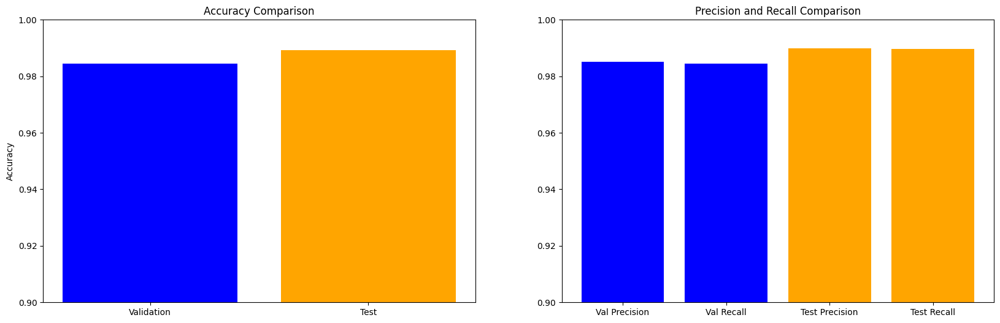

In [4]:
# Visualization functions
def plot_combined_metrics(results):
    """Plot comparative metrics between validation and test"""
    fig, ax = plt.subplots(1, 2, figsize=(20, 6))
    
    # Accuracy comparison
    accuracies = [results['validation']['accuracy'], results['test']['accuracy']]
    ax[0].bar(['Validation', 'Test'], accuracies, color=['blue', 'orange'])
    ax[0].set_ylim(0.9, 1.0)
    ax[0].set_title('Accuracy Comparison')
    ax[0].set_ylabel('Accuracy')
    
    # Precision-Recall comparison
    val_precision = results['validation']['report']['macro avg']['precision']
    val_recall = results['validation']['report']['macro avg']['recall']
    test_precision = results['test']['report']['macro avg']['precision']
    test_recall = results['test']['report']['macro avg']['recall']
    
    ax[1].bar(['Val Precision', 'Val Recall', 'Test Precision', 'Test Recall'],
             [val_precision, val_recall, test_precision, test_recall],
             color=['blue', 'blue', 'orange', 'orange'])
    ax[1].set_ylim(0.9, 1.0)
    ax[1].set_title('Precision and Recall Comparison')
    plt.show()

def plot_confusion_matrices(results):
    """Plot confusion matrices side by side"""
    fig, ax = plt.subplots(1, 2, figsize=(25, 10))
    
    for i, dataset in enumerate(['validation', 'test']):
        cm = confusion_matrix(results[dataset]['true_labels'], results[dataset]['pred_labels'])
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax[i],
                   xticklabels=results[dataset]['class_names'],
                   yticklabels=results[dataset]['class_names'])
        ax[i].set_title(f'{dataset.capitalize()} Confusion Matrix')
        ax[i].set_xlabel('Predicted')
        ax[i].set_ylabel('True')
    
    plt.tight_layout()
    plt.show()

def plot_class_accuracies(results):
    """Plot class-wise accuracies for both datasets"""
    fig, ax = plt.subplots(figsize=(20, 8))
    
    # Calculate class accuracies
    for dataset in ['validation', 'test']:
        class_acc = {}
        for i, class_name in enumerate(results[dataset]['class_names']):
            mask = results[dataset]['true_labels'] == i
            class_acc[class_name] = np.mean(results[dataset]['pred_labels'][mask] == i)
        
        x = np.arange(len(class_acc))
        width = 0.35
        ax.bar(x - width/2 if dataset == 'validation' else x + width/2,
              class_acc.values(),
              width=width,
              label=dataset.capitalize())
    
    ax.set_xticks(x)
    ax.set_xticklabels(results['test']['class_names'], rotation=90)
    ax.set_ylabel('Accuracy')
    ax.set_title('Class-wise Accuracy Comparison')
    ax.legend()
    plt.show()

# Generate all visualizations
plot_combined_metrics(results)

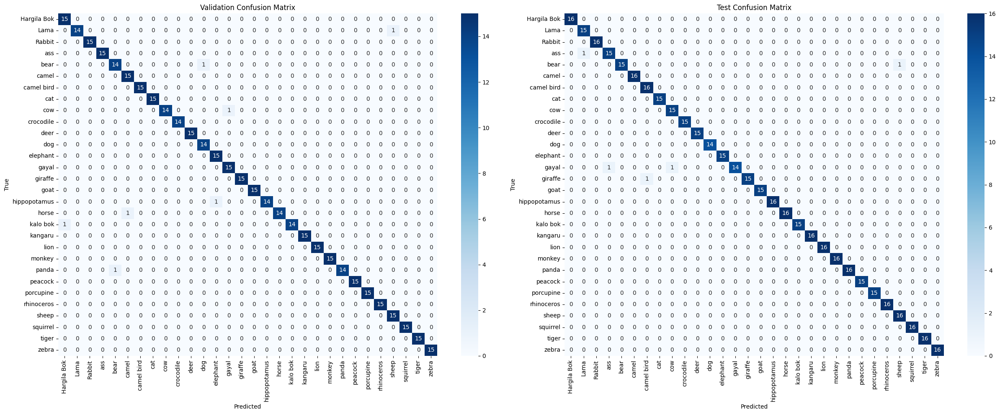

In [5]:

plot_confusion_matrices(results)

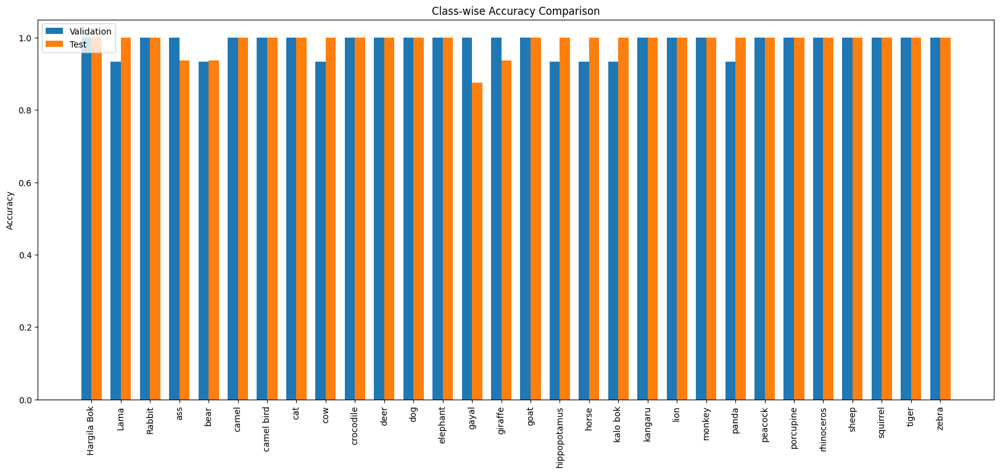

In [13]:
plot_class_accuracies(results)

7/7 ━━━━━━━━━━━━━━━━━━━━ 4s 603ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 102ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 101ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 4s 530ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 99ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step


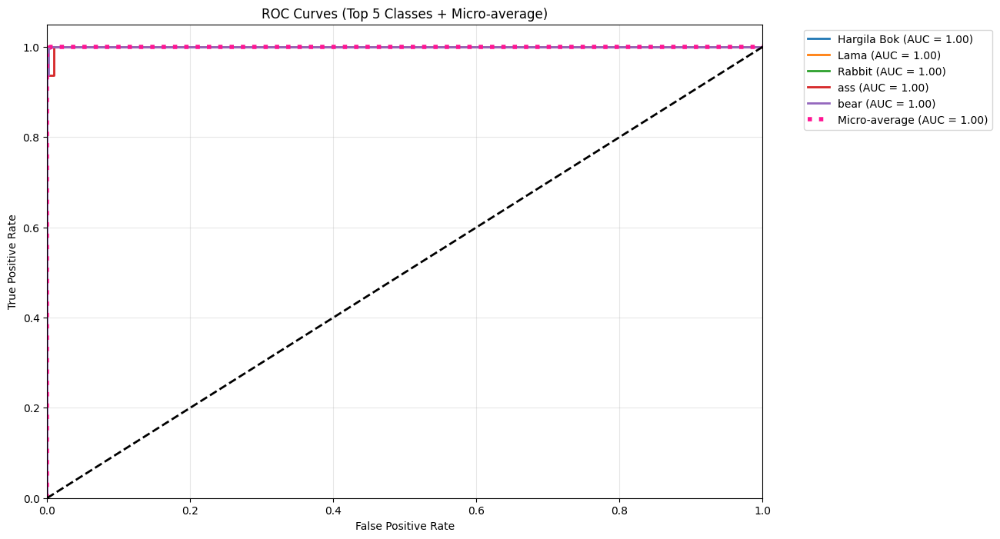

Micro-average AUC: 1.000
Macro-average AUC: 1.000
Class AUC Range: 0.999 - 1.000


In [23]:
# Add these imports at the top
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc
from itertools import cycle

# Add this function after your existing visualization functions
def plot_roc_curves(results, n_classes=5):
    """Generate ROC curves for test set predictions"""
    # Extract data from results
    y_true = results['test']['true_labels']
    y_pred_proba = results['test']['pred_probs']
    class_names = results['test']['class_names']
    n_classes_total = len(class_names)

    # Binarize the true labels
    y_true_bin = label_binarize(y_true, classes=np.arange(n_classes_total))

    # Compute ROC metrics
    fpr, tpr, roc_auc = {}, {}, {}
    
    # Individual classes
    for i in range(n_classes_total):
        fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_pred_proba[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Micro-average
    fpr["micro"], tpr["micro"], _ = roc_curve(y_true_bin.ravel(), y_pred_proba.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    # Plot configuration
    plt.figure(figsize=(12, 8))
    colors = cycle(['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd'])
    
    # Plot first N classes
    for i, color in zip(range(n_classes), colors):
        plt.plot(fpr[i], tpr[i], color=color, lw=2,
                 label=f'{class_names[i]} (AUC = {roc_auc[i]:.2f})')

    # Plot micro-average
    plt.plot(fpr["micro"], tpr["micro"],
             label=f'Micro-average (AUC = {roc_auc["micro"]:.2f})',
             color='deeppink', linestyle=':', linewidth=4)

    # Plot random chance line
    plt.plot([0, 1], [0, 1], 'k--', lw=2)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curves (Top {n_classes} Classes + Micro-average)')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, alpha=0.3)
    plt.show()

    # Print AUC statistics
    print(f"Micro-average AUC: {roc_auc['micro']:.3f}")
    print(f"Macro-average AUC: {np.mean([roc_auc[i] for i in range(n_classes_total)]):.3f}")
    print(f"Class AUC Range: {min(roc_auc.values()):.3f} - {max(roc_auc.values()):.3f}")

# Update the evaluate_ensemble function
def evaluate_ensemble(models, gens, dataset_name):
    """Evaluate ensemble performance on a dataset"""
    # Get predictions
    eff_preds = models['eff'].predict(gens['eff_gen'])
    mob_preds = models['mob'].predict(gens['mob_gen'])
    den_preds = models['den'].predict(gens['mob_gen'])  # Same generator as MobileNet
    
    # Ensemble predictions
    ensemble_preds = (eff_preds + mob_preds + den_preds) / 3
    ensemble_labels = np.argmax(ensemble_preds, axis=1)
    
    # Get true labels
    true_labels = gens['mob_gen'].classes
    class_names = list(gens['mob_gen'].class_indices.keys())
    
    # Calculate metrics
    accuracy = accuracy_score(true_labels, ensemble_labels)
    report = classification_report(true_labels, ensemble_labels, 
                                  target_names=class_names, output_dict=True)
    
    return {
        'accuracy': accuracy,
        'report': report,
        'true_labels': true_labels,
        'pred_labels': ensemble_labels,
        'pred_probs': ensemble_preds,  # Add probability predictions
        'class_names': class_names
    }

# Re-evaluate after updating the function
results = {
    'validation': evaluate_ensemble({'eff': model_eff, 'mob': model_mob, 'den': model_den}, val_gens, 'Validation'),
    'test': evaluate_ensemble({'eff': model_eff, 'mob': model_mob, 'den': model_den}, test_gens, 'Test')
}

# Now run ROC curve code
plot_roc_curves(results, n_classes=5)  # Show top 5 classes

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


7/7 ━━━━━━━━━━━━━━━━━━━━ 13s 540ms/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


8/8 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step 


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step
 2/15 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step 

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


15/15 ━━━━━━━━━━━━━━━━━━━━ 4s 244ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 13s 100ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 13s 900ms/step


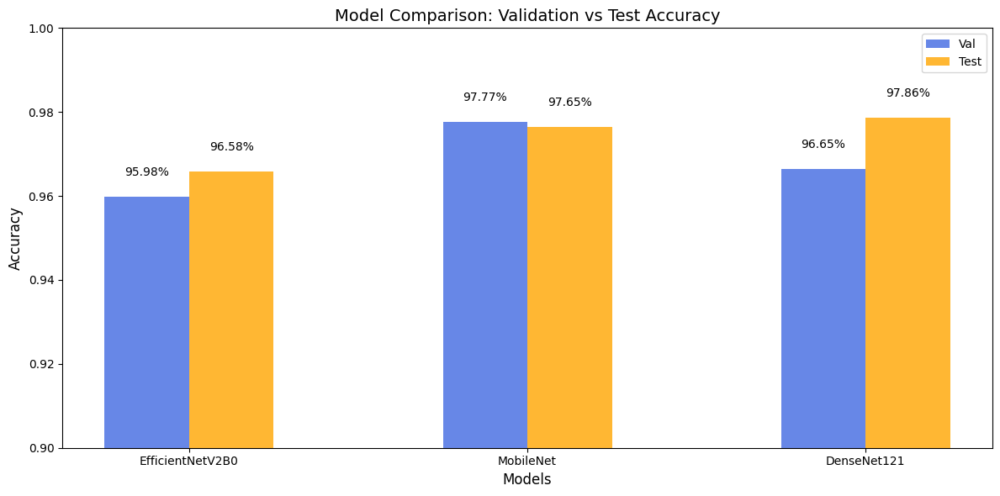

In [20]:
# Get individual model accuracies
def get_model_metrics(model, gen, is_effnet=False):
    """Helper function to get model accuracy"""
    if is_effnet:
        generator = gen['eff_gen']
    else:
        generator = gen['mob_gen']
        
    preds = model.predict(generator)
    return accuracy_score(generator.classes, np.argmax(preds, axis=1))

# Collect metrics
model_metrics = {
    'EfficientNetV2B0': {
        'val': get_model_metrics(model_eff, val_gens, is_effnet=True),
        'test': get_model_metrics(model_eff, test_gens, is_effnet=True)
    },
    'MobileNet': {
        'val': get_model_metrics(model_mob, val_gens),
        'test': get_model_metrics(model_mob, test_gens)
    },
    'DenseNet121': {
        'val': get_model_metrics(model_den, val_gens),
        'test': get_model_metrics(model_den, test_gens)
    }
}

# Visualization
plt.figure(figsize=(12, 6))
bar_width = 0.25
index = np.arange(len(model_metrics))
opacity = 0.8

# Create bars
for i, (model_name, metrics) in enumerate(model_metrics.items()):
    plt.bar(index[i] - bar_width/2, metrics['val'], bar_width,
           alpha=opacity, color='royalblue', label='Val' if i ==0 else "")
    plt.bar(index[i] + bar_width/2, metrics['test'], bar_width,
           alpha=opacity, color='orange', label='Test' if i ==0 else "")

# Formatting
plt.xlabel('Models', fontsize=12)
plt.ylabel('Accuracy', fontsize=12)
plt.title('Model Comparison: Validation vs Test Accuracy', fontsize=14)
plt.xticks(index, model_metrics.keys())
plt.ylim(0.9, 1.0)
plt.legend(loc='upper right')

# Add value labels
for i, model_name in enumerate(model_metrics.keys()):
    val_acc = model_metrics[model_name]['val']
    test_acc = model_metrics[model_name]['test']
    plt.text(index[i] - bar_width/2, val_acc + 0.005, f'{val_acc:.2%}', 
            ha='center', color='black')
    plt.text(index[i] + bar_width/2, test_acc + 0.005, f'{test_acc:.2%}', 
            ha='center', color='black')

plt.tight_layout()
plt.show()

In [10]:
import tensorflow as tf
from tensorflow.keras import Model, layers

class EnsembleModel(Model):
    """Custom model class that properly handles the ensemble logic"""
    def __init__(self, model_eff, model_mob, model_den):
        super(EnsembleModel, self).__init__()
        self.model_eff = model_eff
        self.model_mob = model_mob
        self.model_den = model_den
        self.resize_512 = layers.Resizing(512, 512)
        self.resize_224 = layers.Resizing(224, 224)

    def call(self, inputs):
        # Process inputs for different model requirements
        eff_input = self.resize_512(inputs)
        mob_input = self.resize_224(inputs)
        
        # Get predictions
        eff_pred = self.model_eff(eff_input)
        mob_pred = self.model_mob(mob_input)
        den_pred = self.model_den(mob_input)
        
        # Average predictions
        return (eff_pred + mob_pred + den_pred) / 3

    def get_config(self):
        # Required for proper serialization
        return {
            'model_eff': self.model_eff,
            'model_mob': self.model_mob,
            'model_den': self.model_den
        }

    @classmethod
    def from_config(cls, config):
        return cls(**config)

# Create and save the ensemble
def save_ensemble():
    # Create ensemble instance
    ensemble = EnsembleModel(model_eff, model_mob, model_den)
    
    # Build with sample input
    input_shape = (224, 224, 3)  # Standard input size
    ensemble.build(input_shape=(None, *input_shape))
    
    # Save using Keras format
    ensemble.save('ensemble_model.keras', save_format='keras')
    print("Ensemble model saved successfully as ensemble_model.keras")

# Execute saving
save_ensemble()

# Verification code
def verify_saved_model():
    try:
        # Load with custom object scope
        loaded = tf.keras.models.load_model(
            'ensemble_model.keras',
            custom_objects={'EnsembleModel': EnsembleModel}
        )
        
        # Test prediction with dummy input
        dummy_input = tf.random.normal((1, 224, 224, 3))
        prediction = loaded(dummy_input)
        print("\nVerification successful!")
        print(f"Output shape: {prediction.shape}")
        print(f"Sample predictions: {prediction[0][:5]}")
        
    except Exception as e:
        print("\nError loading model:")
        print(str(e))

verify_saved_model()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/layer.py:391: UserWarning: `build()` was called on layer 'ensemble_model', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(


Ensemble model saved successfully as ensemble_model.keras


/usr/local/lib/python3.11/dist-packages/keras/src/saving/serialization_lib.py:730: UserWarning: Model 'ensemble_model_1' had a build config, but the model cannot be built automatically in `build_from_config(config)`. You should implement `def build_from_config(self, config)`, and you might also want to implement the method  that generates the config at saving time, `def get_build_config(self)`. The method `build_from_config()` is meant to create the state of the model (i.e. its variables) upon deserialization.
  instance.build_from_config(build_config)



Error loading model:
Exception encountered when calling EnsembleModel.call().

'TrackedDict' object is not callable

Arguments received by EnsembleModel.call():
  • inputs=tf.Tensor(shape=(1, 224, 224, 3), dtype=float32)


In [36]:
from tensorflow.keras.preprocessing import image
import numpy as np

# Define image sizes for each model
eff_size = (512, 512)
mob_size = (224, 224)

# Load class names (assuming same as from training/validation generators)
class_names = list(val_gens['mob_gen'].class_indices.keys())  # Based on MobileNet generator

def load_and_preprocess_image(img_path, target_size):
    """Load and preprocess an image."""
    img = image.load_img(img_path, target_size=target_size)
    img_array = image.img_to_array(img)
    img_array = img_array / 255.0  # Rescale
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    return img_array

def predict_image_class(img_path):
    """Predict class of an image using ensemble of three models."""
    # Preprocess for each model
    img_eff = load_and_preprocess_image(img_path, eff_size)
    img_mob = load_and_preprocess_image(img_path, mob_size)
    
    # Predict
    pred_eff = model_eff.predict(img_eff)
    pred_mob = model_mob.predict(img_mob)
    pred_den = model_den.predict(img_mob)  # Same input as MobileNet

    # Ensemble: average predictions
    ensemble_pred = (pred_eff + pred_mob + pred_den) / 3.0
    predicted_class_index = np.argmax(ensemble_pred, axis=1)[0]
    predicted_class = class_names[predicted_class_index]

    print(f"Predicted Class: {predicted_class}")
    return predicted_class

# Example usage:
image_path = '/kaggle/input/image-classification-64-classes-animal/image/cat/00002-3984659588.png'  # Replace with your image path
predict_image_class(image_path)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Predicted Class: cat


'cat'

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Predicted Class: cat
Confidence: 100.00%


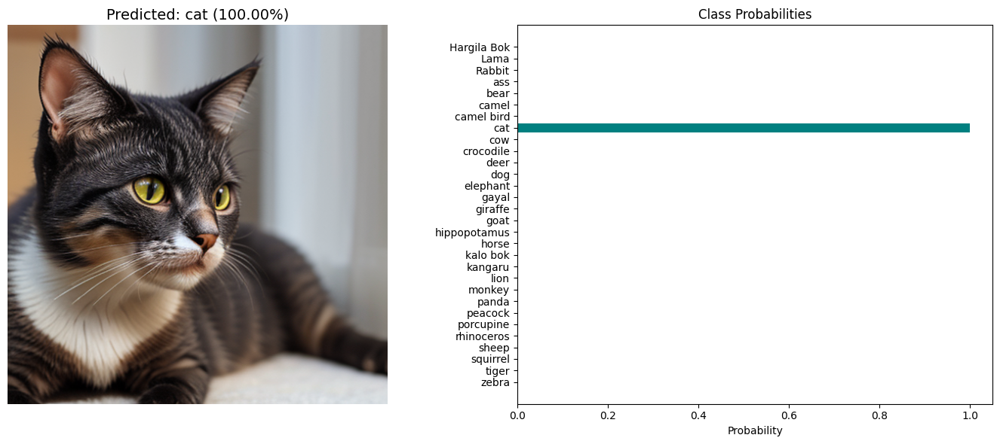

In [38]:
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

# Define model input sizes
eff_size = (512, 512)
mob_size = (224, 224)

# Get class names from validation generator
class_names = list(val_gens['mob_gen'].class_indices.keys())

def load_and_preprocess_image(img_path, target_size):
    """Load and preprocess an image."""
    img = image.load_img(img_path, target_size=target_size)
    img_array = image.img_to_array(img)
    img_array = img_array / 255.0
    img_array = np.expand_dims(img_array, axis=0)
    return img, img_array

def predict_and_visualize(img_path):
    """Predict and visualize ensemble model output on a single image."""
    # Load & preprocess images
    orig_img_eff, img_eff = load_and_preprocess_image(img_path, eff_size)
    _, img_mob = load_and_preprocess_image(img_path, mob_size)

    # Predict using all models
    pred_eff = model_eff.predict(img_eff)[0]
    pred_mob = model_mob.predict(img_mob)[0]
    pred_den = model_den.predict(img_mob)[0]

    # Average predictions
    ensemble_pred = (pred_eff + pred_mob + pred_den) / 3.0
    predicted_index = np.argmax(ensemble_pred)
    predicted_class = class_names[predicted_index]
    confidence = ensemble_pred[predicted_index]

    # Print result
    print(f"Predicted Class: {predicted_class}")
    print(f"Confidence: {confidence * 100:.2f}%")

    # Plotting
    plt.figure(figsize=(14, 6))

    # Show original image
    plt.subplot(1, 2, 1)
    plt.imshow(np.array(orig_img_eff).astype("uint8"))  # FIXED line
    plt.axis('off')
    plt.title(f"Predicted: {predicted_class} ({confidence * 100:.2f}%)", fontsize=14)

    # Class probabilities bar chart
    plt.subplot(1, 2, 2)
    y_pos = np.arange(len(class_names))
    plt.barh(y_pos, ensemble_pred, color='teal')
    plt.yticks(y_pos, class_names)
    plt.xlabel("Probability")
    plt.title("Class Probabilities")
    plt.gca().invert_yaxis()

    plt.tight_layout()
    plt.show()

# Example usage
image_path = '/kaggle/input/image-classification-64-classes-animal/image/cat/00002-3984659588.png'
predict_and_visualize(image_path)


In [ ]:
import tensorflow as tf
import numpy as np
import os
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Load pre-trained models
model_eff = tf.keras.models.load_model('/kaggle/input/animal-model/animal-model/EfficientNetV2B0.keras')
model_mob = tf.keras.models.load_model('/kaggle/input/animal-model/animal-model/animal_classifier_mobilenet.keras')
model_den = tf.keras.models.load_model('/kaggle/input/animal-model/animal-model/best_densenet_model1.keras')

def create_generators(directory, eff_size=(512,512), mob_size=(224,224)):
    """Create generators for different model architectures"""
    return {
        'eff_gen': ImageDataGenerator(rescale=1./255).flow_from_directory(
            directory,
            target_size=eff_size,
            batch_size=64,
            class_mode='categorical',
            shuffle=False
        ),
        'mob_gen': ImageDataGenerator(rescale=1./255).flow_from_directory(
            directory,
            target_size=mob_size,
            batch_size=32,
            class_mode='categorical',
            shuffle=False
        )
    }

# Create generators for validation and test
val_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/validation'
test_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/test'

val_gens = create_generators(val_dir)
test_gens = create_generators(test_dir)


def evaluate_ensemble(models, gens, dataset_name):
    """Evaluate ensemble performance on a dataset"""
    # Get predictions
    eff_preds = models['eff'].predict(gens['eff_gen'])
    mob_preds = models['mob'].predict(gens['mob_gen'])
    den_preds = models['den'].predict(gens['mob_gen'])  # Same generator as MobileNet
    
    # Ensemble predictions
    ensemble_preds = (eff_preds + mob_preds + den_preds) / 3
    ensemble_labels = np.argmax(ensemble_preds, axis=1)
    
    # Get true labels
    true_labels = gens['mob_gen'].classes
    class_names = list(gens['mob_gen'].class_indices.keys())
    
    # Calculate metrics
    accuracy = accuracy_score(true_labels, ensemble_labels)
    report = classification_report(true_labels, ensemble_labels, target_names=class_names, output_dict=True)
    
    return {
        'accuracy': accuracy,
        'report': report,
        'true_labels': true_labels,
        'pred_labels': ensemble_labels,
        'class_names': class_names
    }

# Evaluate on both validation and test
results = {
    'validation': evaluate_ensemble({'eff': model_eff, 'mob': model_mob, 'den': model_den}, val_gens, 'Validation'),
    'test': evaluate_ensemble({'eff': model_eff, 'mob': model_mob, 'den': model_den}, test_gens, 'Test')
}

# Print results
for dataset in ['validation', 'test']:
    print(f"\n=== {dataset.capitalize()} Results ===")
    print(f"Accuracy: {results[dataset]['accuracy']*100:.2f}%")
    print("\nClassification Report:")
    print(classification_report(results[dataset]['true_labels'], 
                               results[dataset]['pred_labels'],
                               target_names=results[dataset]['class_names']))


2025-05-28 18:31:00.229832: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1748457060.702696      31 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1748457060.823672      31 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
I0000 00:00:1748457080.697221      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1748457080.697896      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability:

In [7]:
import tensorflow as tf
import numpy as np
import os
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import EfficientNetV2B0, MobileNetV2, DenseNet121
from tensorflow.keras.models import Model
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout, Input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

# Dataset directories
train_dir = '/kaggle/working/Animal Classification/train_augmented'
val_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/validation'
test_dir = '/kaggle/input/animal-classification-dataset/Animal Classification/test'

# Data generators
train_datagen = ImageDataGenerator(rescale=1./255)
val_test_datagen = ImageDataGenerator(rescale=1./255)

train_gen_eff = train_datagen.flow_from_directory(train_dir, target_size=(512, 512), batch_size=32, class_mode='categorical')
val_gen_eff = val_test_datagen.flow_from_directory(val_dir, target_size=(512, 512), batch_size=32, class_mode='categorical', shuffle=False)
test_gen_eff = val_test_datagen.flow_from_directory(test_dir, target_size=(512, 512), batch_size=32, class_mode='categorical', shuffle=False)

train_gen_mob = train_datagen.flow_from_directory(train_dir, target_size=(224, 224), batch_size=32, class_mode='categorical')
val_gen_mob = val_test_datagen.flow_from_directory(val_dir, target_size=(224, 224), batch_size=32, class_mode='categorical', shuffle=False)
test_gen_mob = val_test_datagen.flow_from_directory(test_dir, target_size=(224, 224), batch_size=32, class_mode='categorical', shuffle=False)

num_classes = train_gen_eff.num_classes

# Function to build model
def build_model(base_model, input_shape):
    inputs = Input(shape=input_shape)
    x = base_model(include_top=False, input_tensor=inputs, weights='imagenet')
    x = GlobalAveragePooling2D()(x.output)
    x = Dropout(0.3)(x)
    outputs = Dense(num_classes, activation='softmax')(x)
    return Model(inputs, outputs)

# Build models
model_eff = build_model(EfficientNetV2B0, (512, 512, 3))
model_mob = build_model(MobileNetV2, (224, 224, 3))
model_den = build_model(DenseNet121, (224, 224, 3))

# Compile
for model in [model_eff, model_mob, model_den]:
    model.compile(optimizer=Adam(learning_rate=1e-4), loss='categorical_crossentropy', metrics=['accuracy'])

# Early stopping
es = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Train all models for 20 epochs
model_eff.fit(train_gen_eff, epochs=50, validation_data=val_gen_eff, callbacks=[es])
model_mob.fit(train_gen_mob, epochs=50, validation_data=val_gen_mob, callbacks=[es])
model_den.fit(train_gen_mob, epochs=50, validation_data=val_gen_mob, callbacks=[es])  # same size as MobileNet

# Evaluation function
def evaluate_ensemble(models, gens):
    eff_preds = models['eff'].predict(gens['eff'])
    mob_preds = models['mob'].predict(gens['mob'])
    den_preds = models['den'].predict(gens['mob'])  # same size as MobileNet
    
    ensemble_preds = (eff_preds + mob_preds + den_preds) / 3
    ensemble_labels = np.argmax(ensemble_preds, axis=1)
    
    true_labels = gens['mob'].classes
    class_names = list(gens['mob'].class_indices.keys())
    
    acc = accuracy_score(true_labels, ensemble_labels)
    report = classification_report(true_labels, ensemble_labels, target_names=class_names, output_dict=True)
    
    return {
        'accuracy': acc,
        'report': report,
        'true_labels': true_labels,
        'pred_labels': ensemble_labels,
        'class_names': class_names
    }

# Evaluate on validation and test sets
results = {
    'validation': evaluate_ensemble({'eff': model_eff, 'mob': model_mob, 'den': model_den}, {'eff': val_gen_eff, 'mob': val_gen_mob}),
    'test': evaluate_ensemble({'eff': model_eff, 'mob': model_mob, 'den': model_den}, {'eff': test_gen_eff, 'mob': test_gen_mob})
}

# Show results
for dataset in ['validation', 'test']:
    print(f"\n=== {dataset.capitalize()} Results ===")
    print(f"Accuracy: {results[dataset]['accuracy']*100:.2f}%")
    print("\nClassification Report:")
    print(classification_report(results[dataset]['true_labels'], 
                               results[dataset]['pred_labels'],
                               target_names=results[dataset]['class_names']))


Found 14389 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.
Found 14389 images belonging to 30 classes.
Found 448 images belonging to 30 classes.
Found 468 images belonging to 30 classes.


/tmp/ipykernel_31/3721156586.py:36: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  x = base_model(include_top=False, input_tensor=inputs, weights='imagenet')


Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


450/450 ━━━━━━━━━━━━━━━━━━━━ 379s 634ms/step - accuracy: 0.4279 - loss: 2.2816 - val_accuracy: 0.5290 - val_loss: 1.6690
Epoch 2/50
450/450 ━━━━━━━━━━━━━━━━━━━━ 247s 544ms/step - accuracy: 0.9610 - loss: 0.2008 - val_accuracy: 0.7812 - val_loss: 0.7430
Epoch 3/50
450/450 ━━━━━━━━━━━━━━━━━━━━ 246s 543ms/step - accuracy: 0.9895 - loss: 0.0580 - val_accuracy: 0.1362 - val_loss: 3.4526
Epoch 4/50
450/450 ━━━━━━━━━━━━━━━━━━━━ 246s 542ms/step - accuracy: 0.9934 - loss: 0.0348 - val_accuracy: 0.4353 - val_loss: 2.0738
Epoch 5/50
450/450 ━━━━━━━━━━━━━━━━━━━━ 246s 543ms/step - accuracy: 0.9957 - loss: 0.0229 - val_accuracy: 0.8951 - val_loss: 0.3494
Epoch 6/50
450/450 ━━━━━━━━━━━━━━━━━━━━ 246s 542ms/step - accuracy: 0.9964 - loss: 0.0186 - val_accuracy: 0.8237 - val_loss: 0.6244
Epoch 7/50
450/450 ━━━━━━━━━━━━━━━━━━━━ 246s 543ms/step - accuracy: 0.9978 - loss: 0.0149 - val_accuracy: 0.6674 - val_loss: 1.2679
Epoch 8/50
450/450 ━━━━━━━━━━━━━━━━━━━━ 246s 543ms/step - accuracy: 0.9978 - loss: 0.01

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


15/15 ━━━━━━━━━━━━━━━━━━━━ 11s 733ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 4s 310ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 12s 827ms/step

=== Validation Results ===
Accuracy: 97.77%

Classification Report:
              precision    recall  f1-score   support

 Hargila Bok       0.94      1.00      0.97        15
        Lama       1.00      1.00      1.00        15
      Rabbit       1.00      1.00      1.00        15
         ass       1.00      1.00      1.00        15
        bear       1.00      0.93      0.97        15
       camel       0.88      1.00      0.94        15
  camel bird       0.93      0.93      0.93        15
         cat       1.00      1.00      1.00        15
         cow       1.00      0.87      0.93        15
   crocodile       1.00      1.00      1.00        14
        deer       0.94      1.00      0.97        15
         dog       0.93      1.00      0.97        14
    elephant       1.00      1.00      1.00        15
       gayal       1.00      0.93      0.97      